In [30]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import os,sys, gc
import keras


dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import clean_LC,generate_representation
from evaluation import calculate_metrics, evaluate_metadata, evaluate_metadata_raw


folder = "../../KOI_Data/"
folder_lc = "/work/work_teamEXOPLANET/KOI_LC/"

In [31]:
def impute_on_pandas(df):
    return df.fillna(df.median(),inplace=False)

df_meta = pd.read_csv(folder+"/kepler_dataset.csv")
all_labels = df_meta["NExScI Disposition"]
mask_conf = (all_labels=="CONFIRMED").values
mask_fp = (all_labels=="FALSE POSITIVE").values
mask_cand = (all_labels=="CANDIDATE").values

metadata_used = ["Period", "Duration", "Time of Transit Epoch", "r/R", "a/R",
                 "Inclination", "Limb Darkening Coeff1", "Limb Darkening Coeff2",
                 "Teq", "Fitted Stellar Density",
                "Teff","Stellar Radius", "Stellar Mass"]
#dividir duration por 24??
df_meta["Duration"] = df_meta["Duration"]/24

time_kepler = np.load(folder_lc+"npy/KOI_LC_time.npy")
#df_meta["Time of Transit Epoch"] = df_meta["Time of Transit Epoch"]- time_kepler[:,0] #modificacion

df_meta_obj = df_meta[metadata_used]
mask_nan = pd.isna(df_meta_obj)

df_meta_obj = impute_on_pandas(df_meta_obj)

df_meta_obj.head()

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Limb Darkening Coeff1,Limb Darkening Coeff2,Teq,Fitted Stellar Density,Teff,Stellar Radius,Stellar Mass
0,8.884923,0.086252,169.991686,0.114,36.466,89.89,0.497,0.204,770.0,11.62061,5332.0,0.843,0.821
1,5.092465,0.152458,357.535940,0.014,10.670,89.14,0.551,0.165,844.0,0.88510,5037.0,0.751,0.727
2,275.073650,0.140417,315.248600,0.014,512.000,89.93,0.437,0.243,303.0,33.55994,5604.0,1.187,0.864
3,8.460439,0.197288,133.774490,0.478,14.087,85.68,0.299,0.306,804.0,0.73874,5951.0,0.702,0.796
4,21.761298,0.051792,166.540438,0.032,137.070,89.95,0.627,0.108,486.0,102.86534,4859.0,0.720,0.781


In [32]:
df_sets = pd.read_csv(folder+"/koi_sets.csv") 
mask_train = (df_sets["Set"] == "Train").values
mask_test = (df_sets["Set"] == "Test").values
mask_unlabeled = (df_sets["Set"] == "Unlabeled").values

mask_train_conf = mask_train & mask_conf
mask_test_conf = mask_test & mask_conf

In [33]:
Y_train = df_meta_obj.values[mask_train_conf]
Y_test = df_meta_obj.values[mask_test_conf]
Y_train.shape

(1610, 13)

In [34]:
#pre-process: scale metadata
from sklearn.preprocessing import StandardScaler, RobustScaler
#scaler_meta = RobustScaler()
scaler_meta = StandardScaler()

Ystd_train = scaler_meta.fit_transform(Y_train)
Ystd_test = scaler_meta.transform(Y_test)

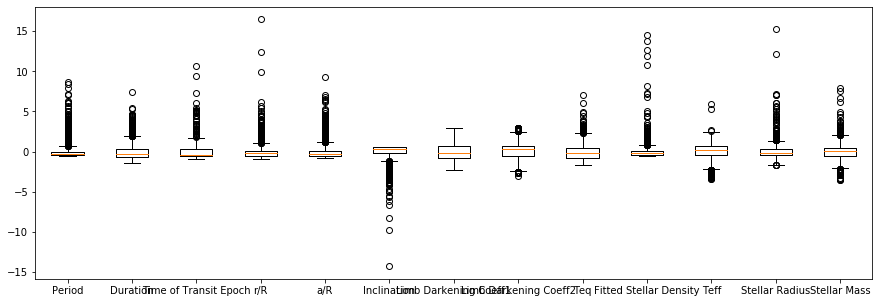

,Period,Duration,Time of Transit Epoch,r/R,a/R,Inclination,Limb Darkening Coeff1,Limb Darkening Coeff2,Teq,Fitted Stellar Density,Teff,Stellar Radius,Stellar Mass
count,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03,1.610000e+03
mean,-3.054837e-17,7.499867e-16,5.907007e-15,-1.612582e-15,1.519764e-15,-6.772423e-14,-2.639779e-15,2.343305e-14,2.427320e-17,6.172502e-16,2.711427e-16,-2.270130e-15,3.242375e-15
std,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00,1.000311e+00
min,-5.908227e-01,-1.450501e+00,-8.906004e-01,-8.851677e-01,-8.407552e-01,-1.431460e+01,-2.258535e+00,-3.089904e+00,-1.728111e+00,-5.335584e-01,-3.395382e+00,-1.703084e+00,-3.525412e+00
25%,-4.821600e-01,-6.703882e-01,-5.516610e-01,-5.040630e-01,-5.662212e-01,-1.426957e-01,-8.013483e-01,-5.591437e-01,-7.441942e-01,-4.219073e-01,-4.824721e-01,-4.884028e-01,-5.372881e-01
50%,-3.365976e-01,-2.669818e-01,-4.050554e-01,-2.076482e-01,-3.274285e-01,3.226130e-01,-1.761280e-01,2.596318e-01,-1.479202e-01,-2.298973e-01,1.926621e-01,-1.801033e-01,9.894913e-03
75%,-1.750069e-03,3.716218e-01,3.663228e-01,1.311116e-01,1.281076e-01,5.689991e-01,7.206023e-01,7.062367e-01,4.921406e-01,8.804824e-02,6.795483e-01,2.726248e-01,5.044431e-01
max,8.616681e+00,7.401561e+00,1.070401e+01,1.647627e+01,9.296306e+00,6.317726e-01,2.932537e+00,2.983921e+00,7.011231e+00,1.447999e+01,5.973887e+00,1.529320e+01,7.896348e+00


In [35]:
### boxplot de las variables..
plt.figure(figsize=(15,5))
plt.boxplot(Ystd_train)
plt.xticks(np.arange(len(metadata_used))+1,metadata_used)
plt.show()
aux_df = pd.DataFrame(Ystd_train)
aux_df.columns = metadata_used
aux_df.describe()

### Read light curves processed (detrended)

(8054, 71427)


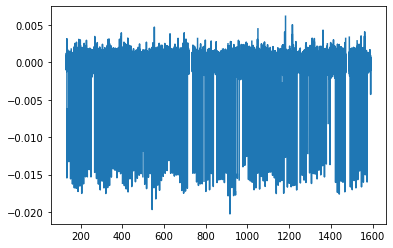

In [7]:
time_kepler = np.load(folder_lc+"npy/KOI_LC_time.npy")
#lc_kepler = np.load(folder_lc+"npy/KOI_LC_init.npy" )
process_lc = np.load(folder_lc+'/cleaned/LC_kepler_processed.npy')
N, T = time_kepler.shape
print((N,T))

plt.plot(time_kepler[0],process_lc[0])
plt.show()

time_kepler = time_kepler[mask_conf]
process_lc = process_lc[mask_conf]
N, T = time_kepler.shape
print((N,T))

In [8]:
#borrar nans... arreglo variable
coupled_lc = []
coupled_time = []
delta_time = []
for i in range(N):
    mask_nan_aux = np.isnan(process_lc[i])
    coupled_lc.append(process_lc[i][~mask_nan_aux])
    
    time = time_kepler[i][~mask_nan_aux]
    # calculate delta time --> this could be done after padding is done..
    delta_time.append(np.hstack([[0],np.diff(time)]))
    coupled_time.append(time)
    
coupled_lc = np.asarray(coupled_lc)
coupled_time = np.asarray(coupled_time)
delta_time = np.asarray(delta_time)
coupled_time

array([array([ 131.5127147,  131.5331494,  131.553584 , ..., 1590.9606391,
       1590.9810737, 1591.0015084]),
       array([ 352.3965737,  352.4374395,  352.4578724, ..., 1590.9606362,
       1590.9810707, 1591.0015055]),
       array([ 131.5944506,  131.6148853,  131.6353198, ..., 1590.9606445,
       1590.9810791, 1591.0015138]),
       ...,
       array([ 131.5119643,  131.5323986,  131.5528328, ..., 1590.9604946,
       1590.9809286, 1591.0013629]),
       array([ 131.5119643,  131.5323986,  131.5528328, ..., 1590.9604946,
       1590.9809286, 1591.0013629]),
       array([ 131.5119548,  131.532389 ,  131.5528232, ..., 1590.9604892,
       1590.9809233, 1591.0013576])], dtype=object)

#pre-process seleccionado

coupled_lc_scaled = []
for i in range(coupled_lc.shape[0]):
    std_i = coupled_lc[i].std(keepdims=True) #o std de todo
    
    coupled_lc_scaled.append( coupled_lc[i]/std_i )
coupled_lc_scaled = np.asarray(coupled_lc_scaled)
coupled_lc_scaled.shape

In [9]:
coupled_lc_scaled = coupled_lc

In [10]:
### data augm

flip_coupled_lc_scaled = []
flip_delta_time = []
flip_time = []
for i in range(coupled_lc.shape[0]):    
    flip_coupled_lc_scaled.append( coupled_lc_scaled[i][::-1] )
    flip_delta_time.append(  np.hstack([[0], delta_time[i][1:][::-1]]) )
    flip_time.append( coupled_time[i][0] + np.cumsum(flip_delta_time[-1]))
    
flip_coupled_lc_scaled = np.asarray(flip_coupled_lc_scaled)
flip_delta_time = np.asarray(flip_delta_time)
flip_time = np.asarray(flip_time)

delta_time = np.concatenate([delta_time, flip_delta_time])
coupled_lc_scaled = np.concatenate([coupled_lc_scaled, flip_coupled_lc_scaled])
coupled_time = np.concatenate([coupled_time, flip_time])

del flip_delta_time, flip_coupled_lc_scaled, flip_time
gc.collect()
coupled_lc_scaled.shape

(16108,)

### Folded

In [11]:
from fold import *

In [12]:
def folded_exampl(n):
    per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[mask_conf][n]
    
    t = coupled_time[n][:]
    y = coupled_lc_scaled[n][:]

    #mask_nan = np.isnan(y)
    #t = t[~mask_nan]
    #y = y[~mask_nan]

    plt.plot(t, y, '.-')
    plt.show()

    t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)

    plt.figure(figsize=(10,5))
    plt.plot(t_fold, val_fold, '.-')
    plt.title("folded")
    plt.show()

    plt.plot(t_fold)
    plt.show()
    
    t_glo = global_view(t_fold, val_fold, period=per, num_bins=1000, bin_width_factor=1 / 1000)
    
    plt.figure(figsize=(10,5))
    plt.plot(t_glo, '.-')
    plt.title("global view")
    plt.show()
    
    t_loc = local_view(t_fold, val_fold, period = per, duration=dur, num_bins=201, 
                       bin_width_factor=0.16,  num_durations=4)
    
    plt.figure(figsize=(10,5))
    plt.plot(t_loc, '.-')
    plt.title("local view")
    plt.show()

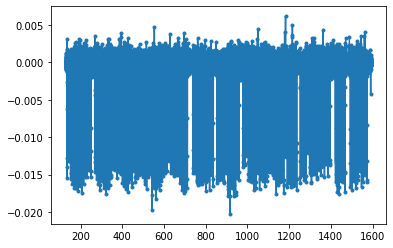

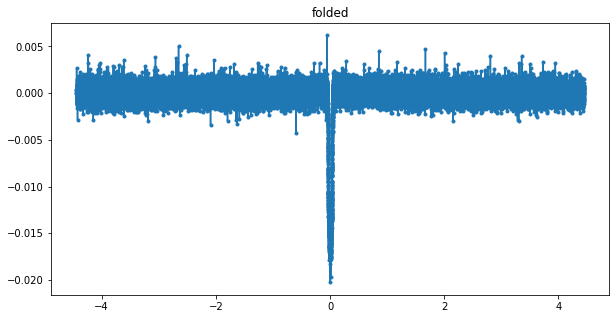

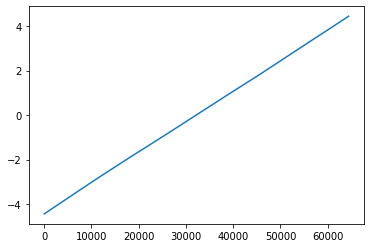

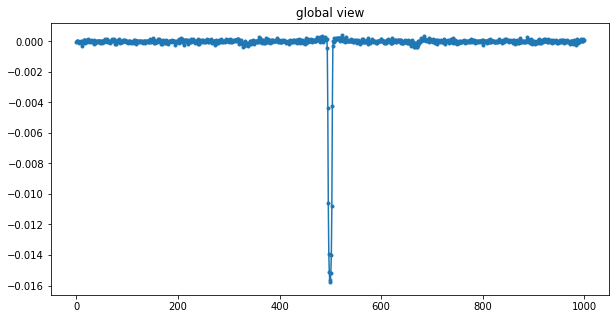

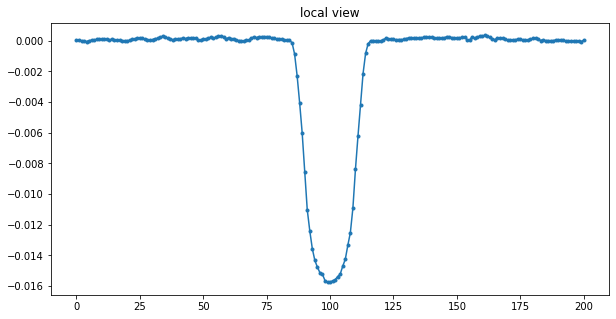

In [14]:
folded_exampl(0)

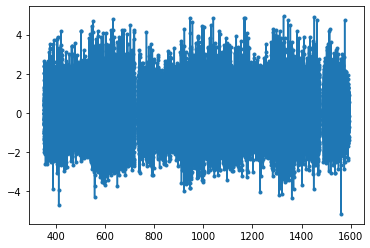

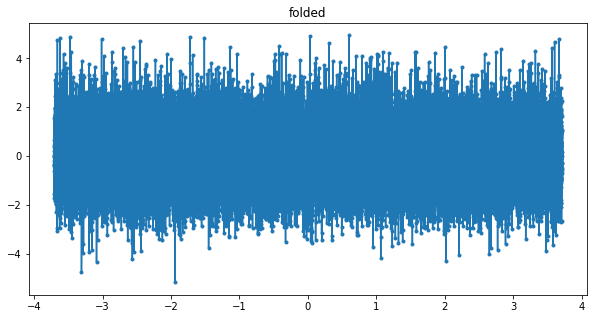

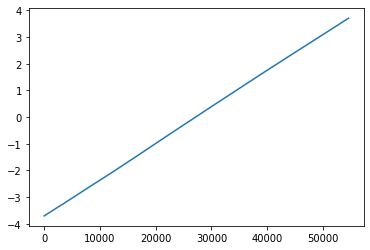

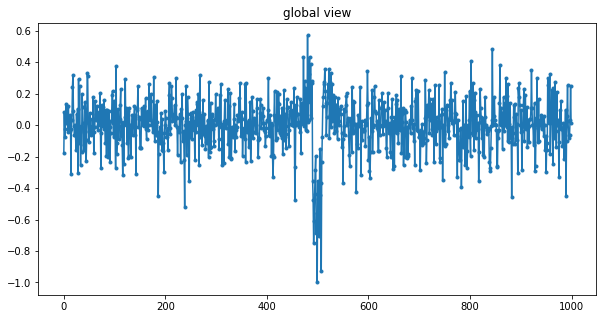

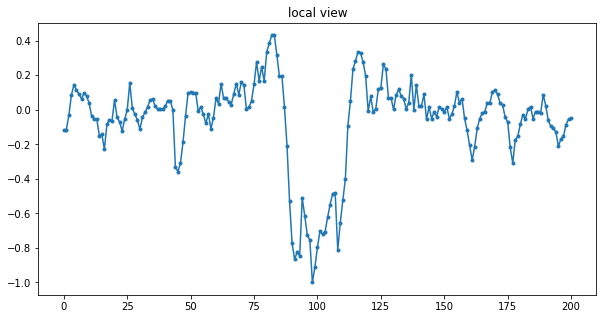

In [60]:
folded_exampl(5)

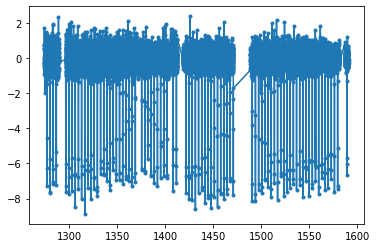

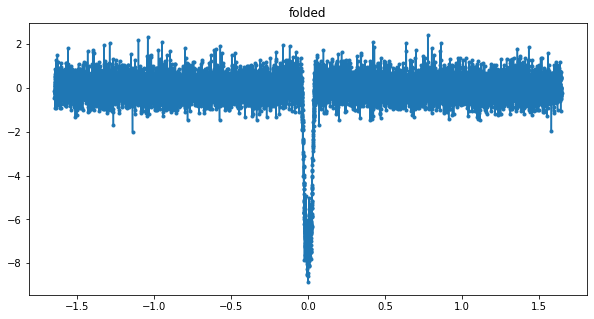

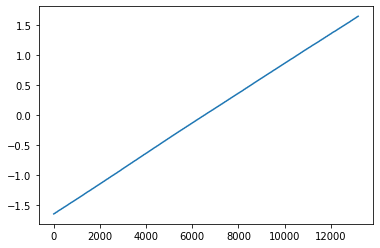

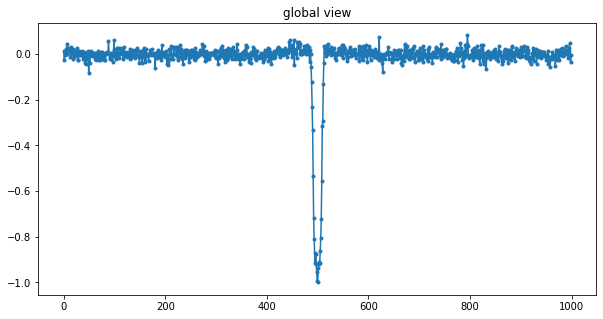

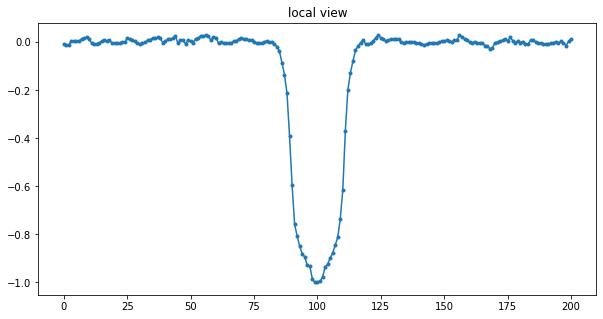

In [61]:
folded_exampl(9)

Dis score 0.999000, not transit flag 0.0 sec flag 0.0


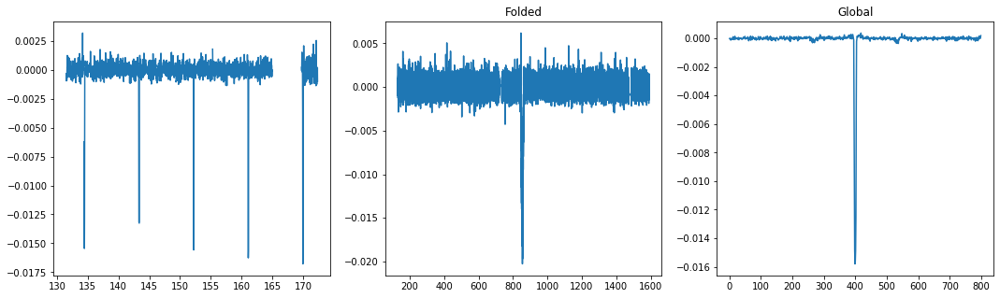

Max power:  0.016510416929092928
Second Max:  0.01629895050451847


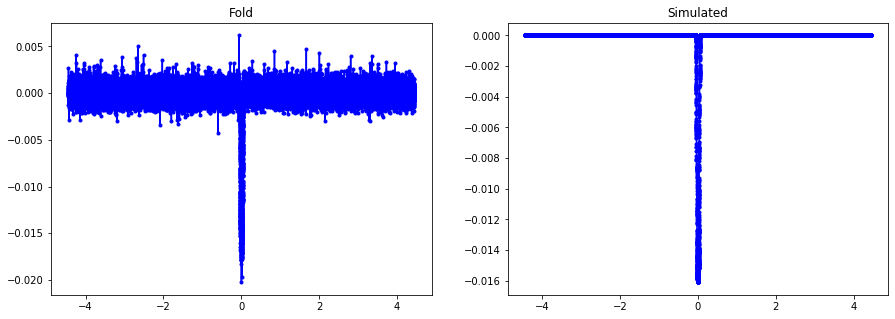

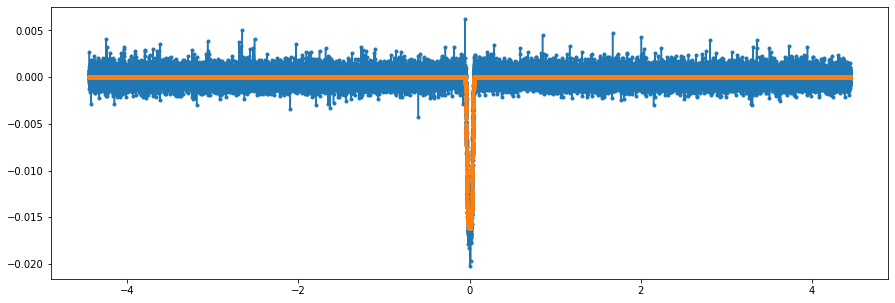

error en fold=  0.44638464955946544


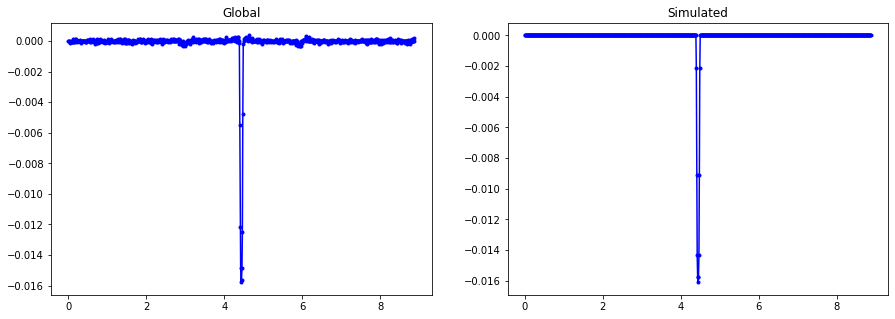

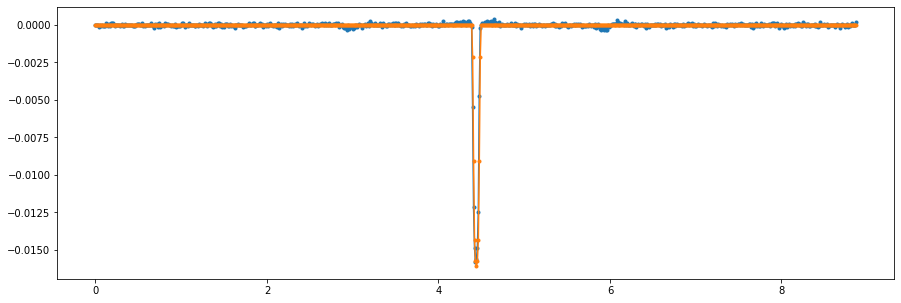

error en global=  0.2042885193562151
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


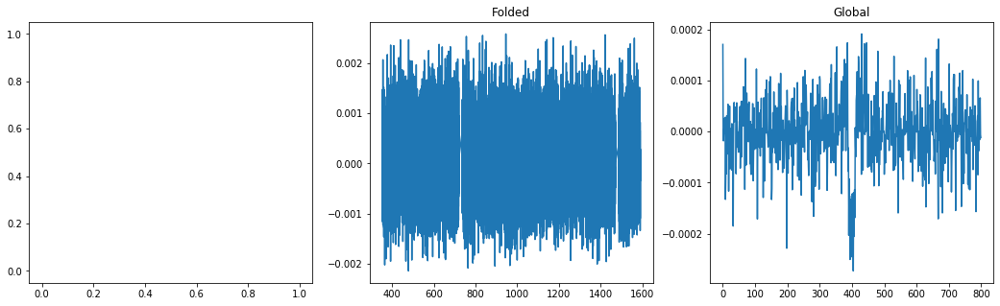

Max power:  0.0006483682012974057
Second Max:  0.0006326643548913594


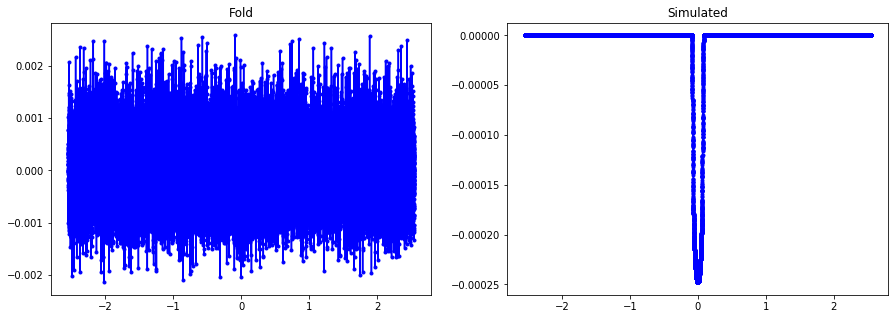

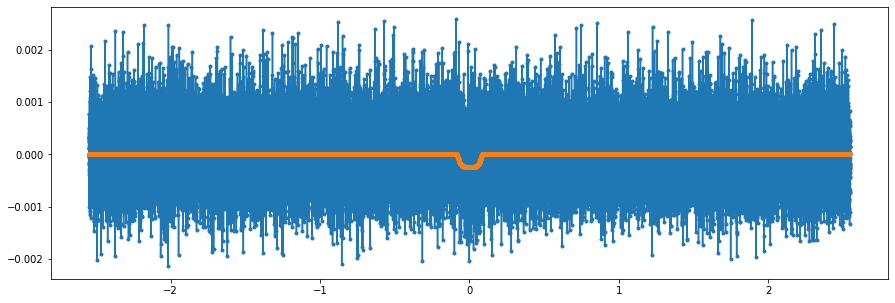

error en fold=  0.9991862642357472


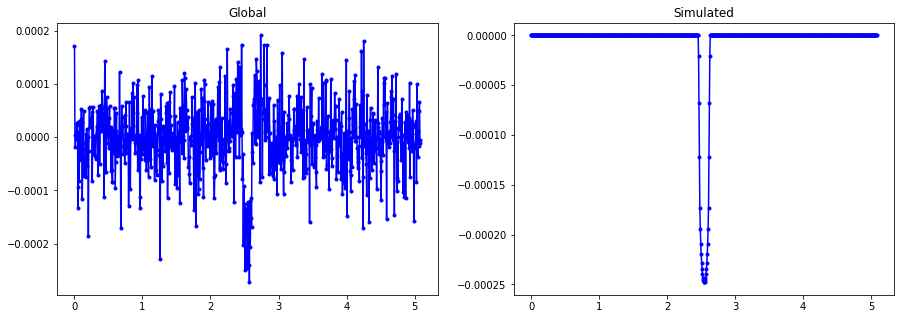

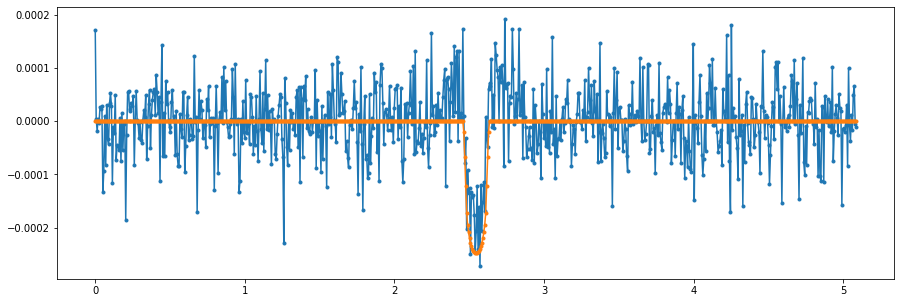

error en global=  0.9282012460516169
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


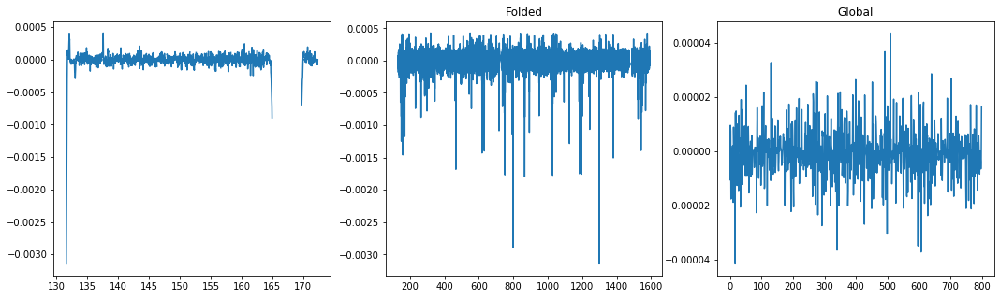

Max power:  0.002051330453735966
Second Max:  0.0020182015651735333


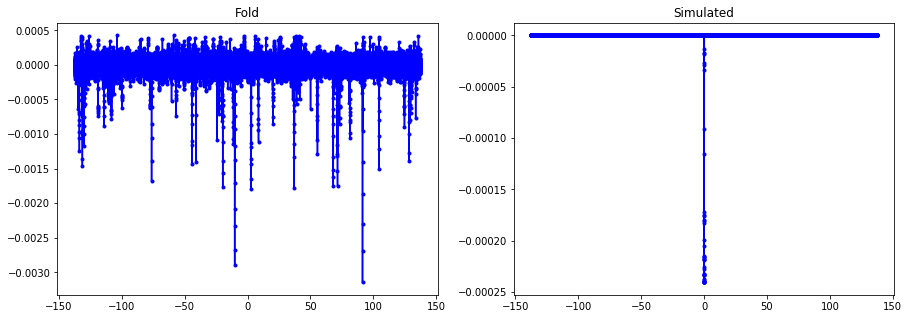

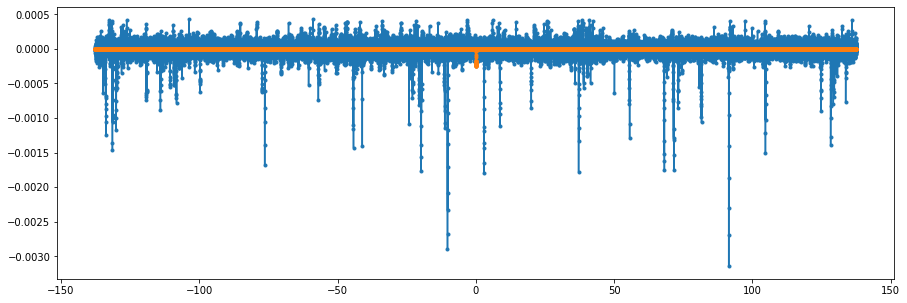

error en fold=  1.0009912711640052


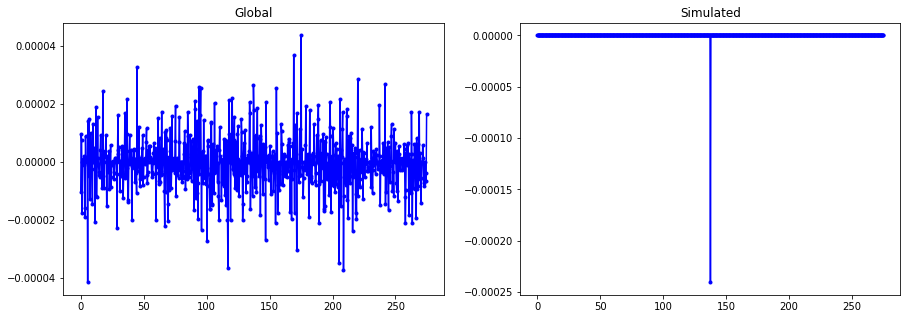

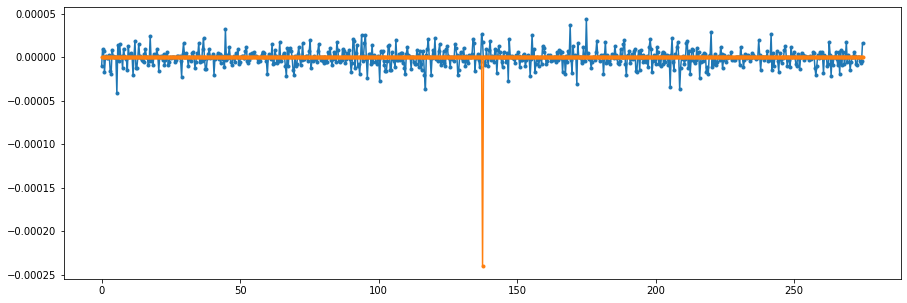

error en global=  1.4039903819222552
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


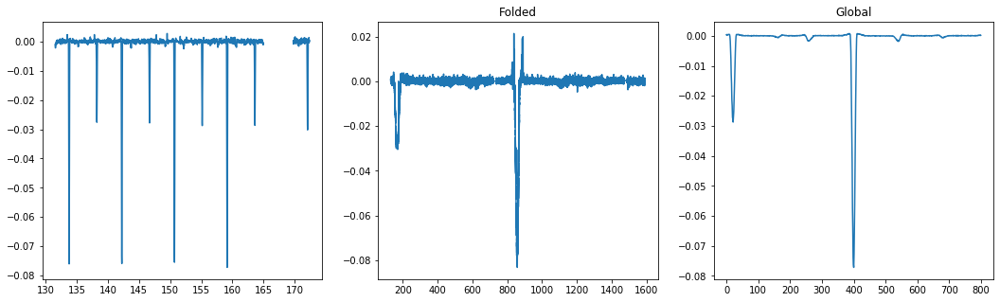

Max power:  0.051056663520437605
Second Max:  0.04993643100910115


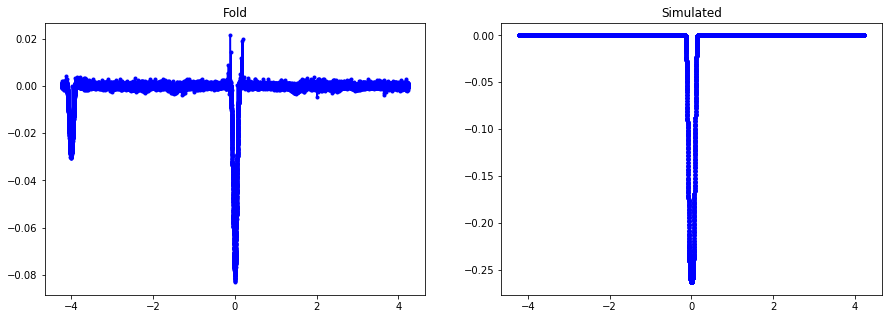

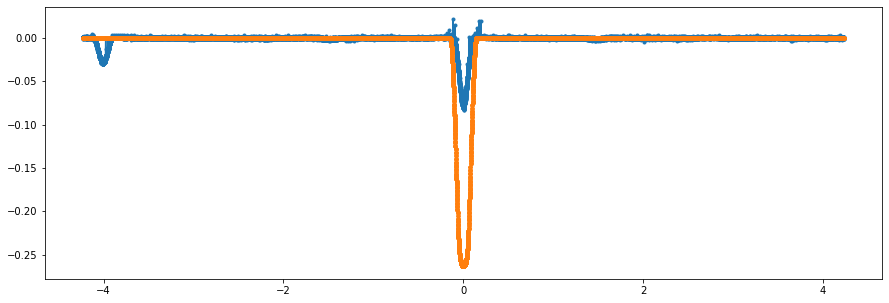

error en fold=  3.4103407221758504


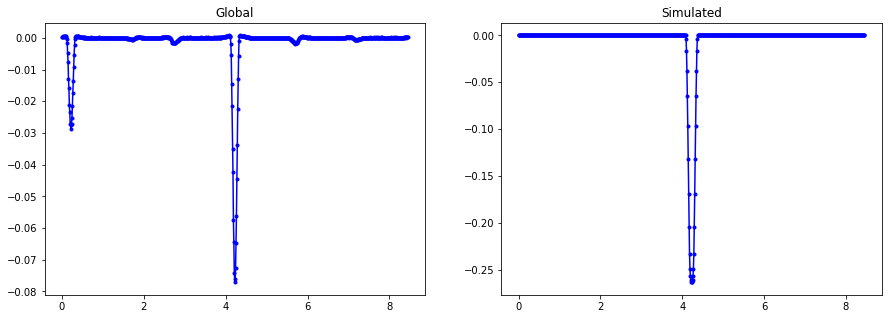

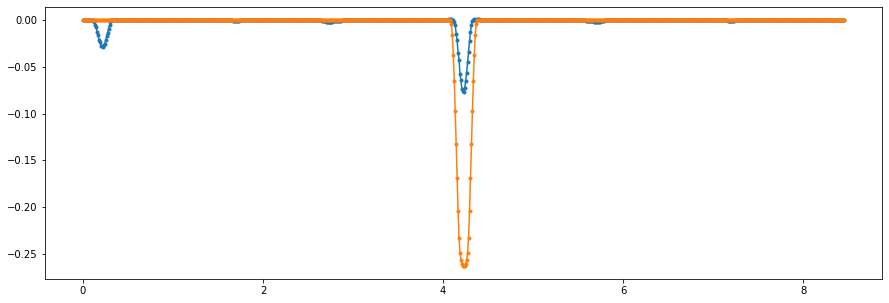

error en global=  3.4284044643467526
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


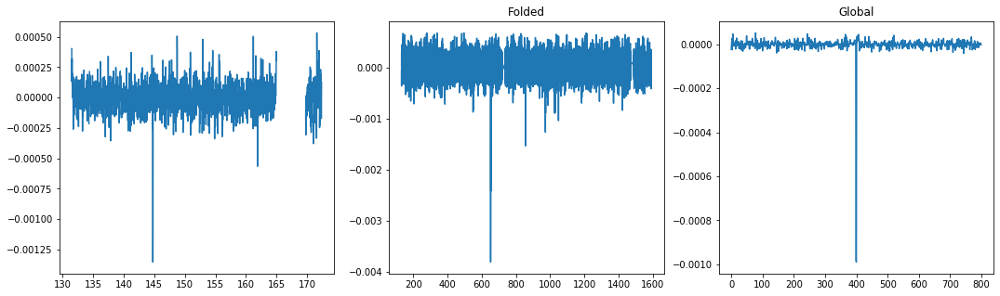

Max power:  0.0017397497971179195
Second Max:  0.0017266899322505656


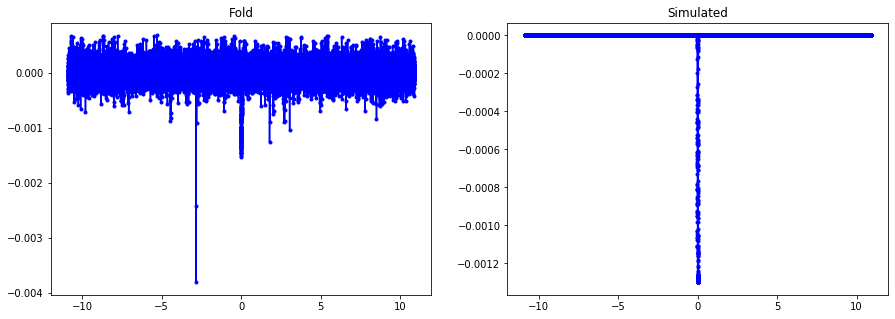

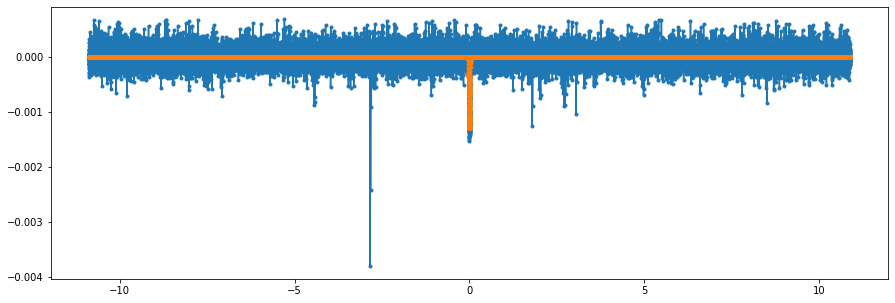

error en fold=  0.9295480041285176


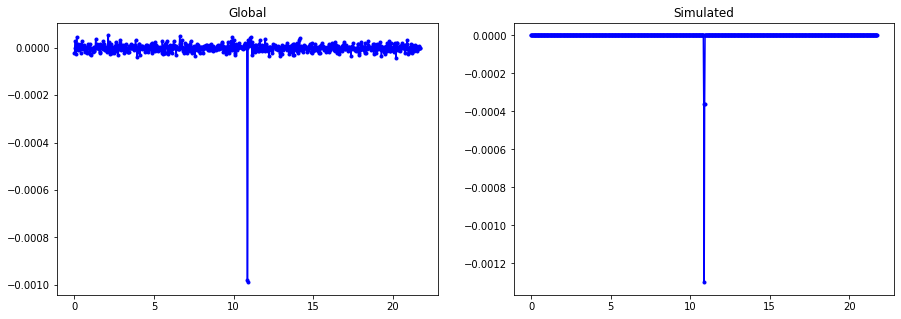

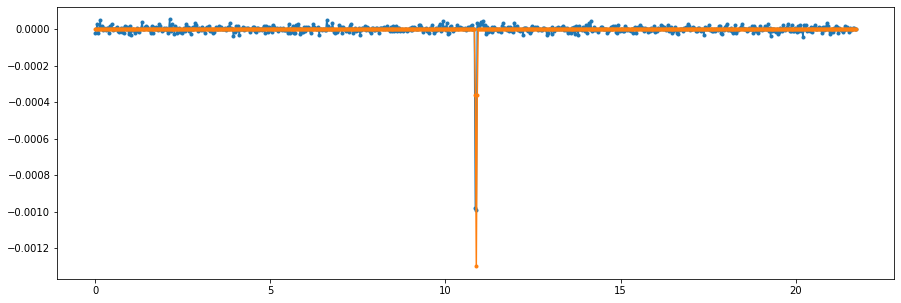

error en global=  0.6105672373013191
----------------------------------------------------------------
Dis score 0.711000, not transit flag 0.0 sec flag 0.0


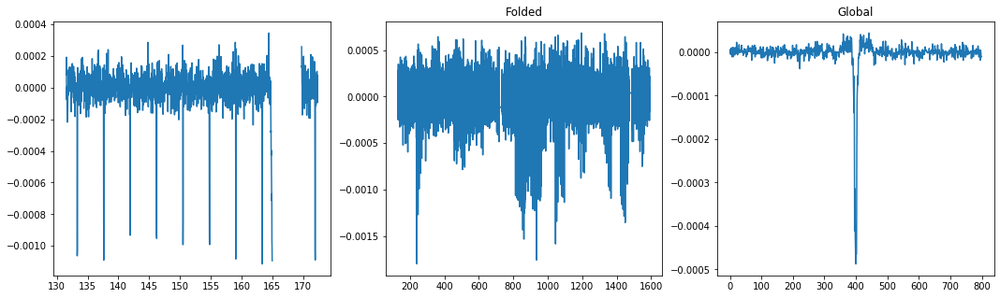

Max power:  0.009539617797954982
Second Max:  0.009181027667659335


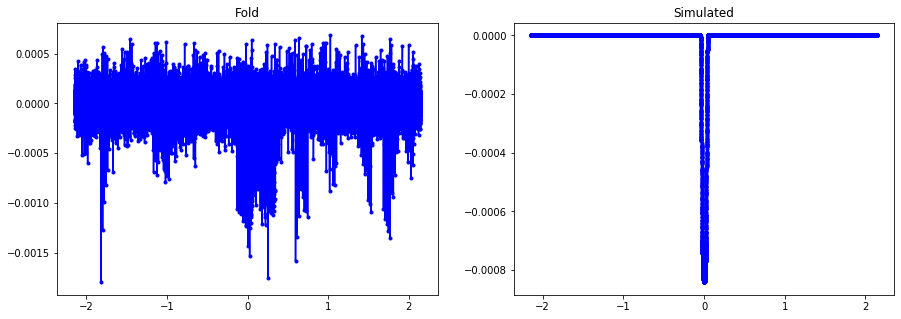

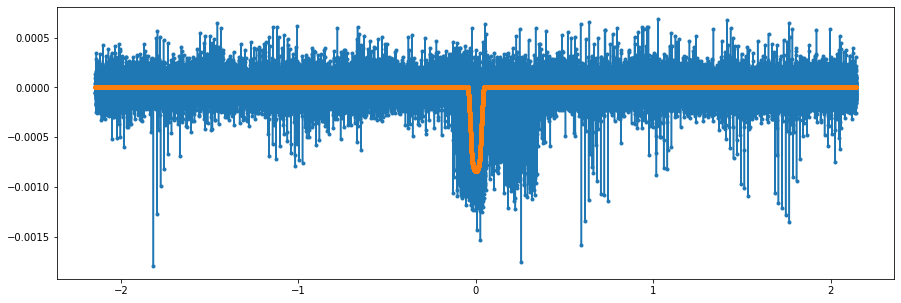

error en fold=  0.9683772505803664


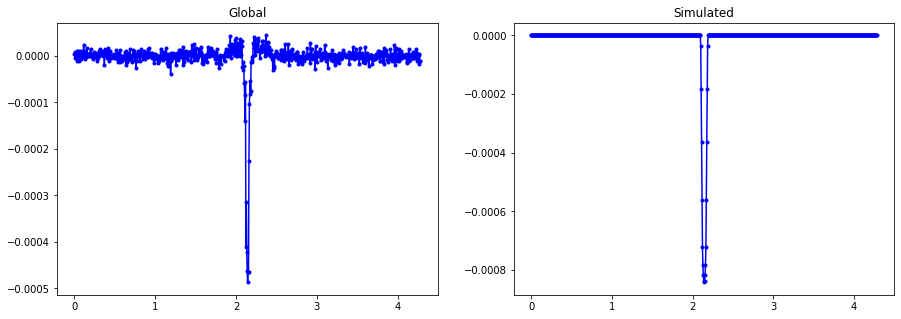

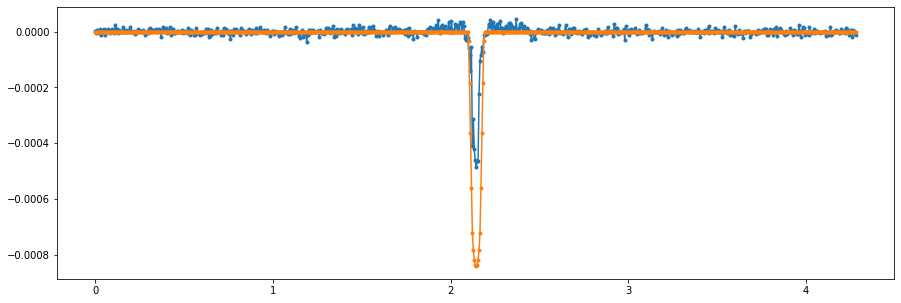

error en global=  1.2683586167627239
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


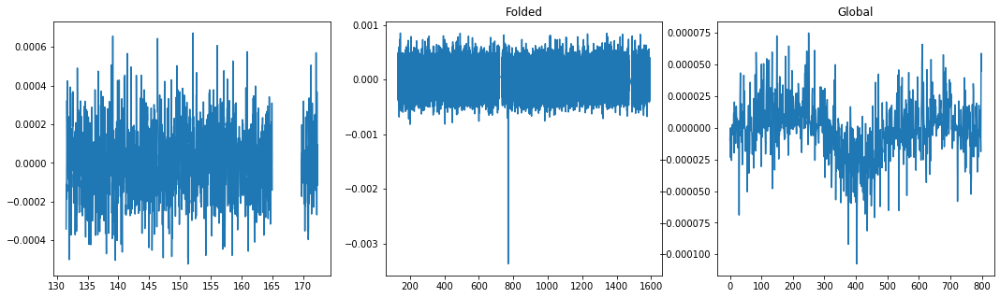

Max power:  0.005524835877858315
Second Max:  0.004967826138864129
ERROR, CURVA ELIMINADO DE INMEDIATO
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


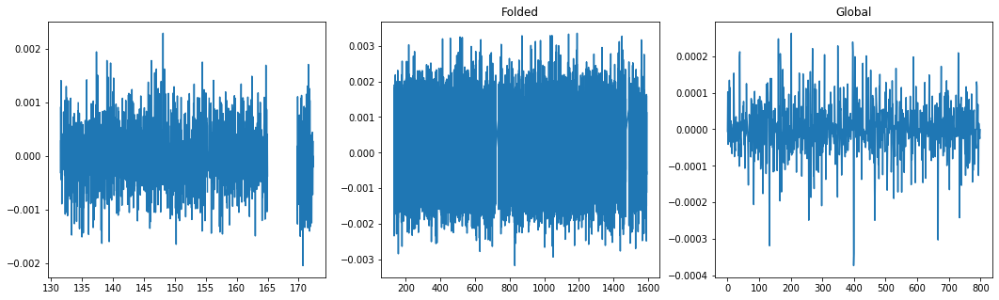

Max power:  0.0006349190499272646
Second Max:  0.0005906376869540984


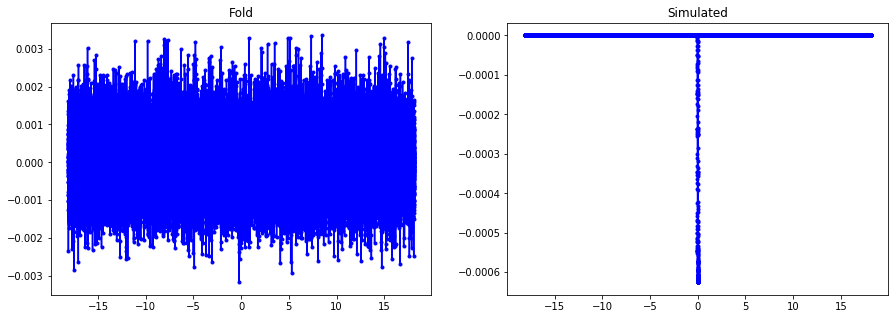

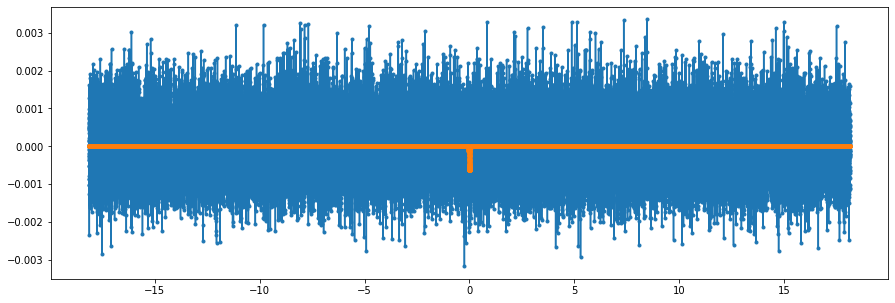

error en fold=  0.9996453766935064


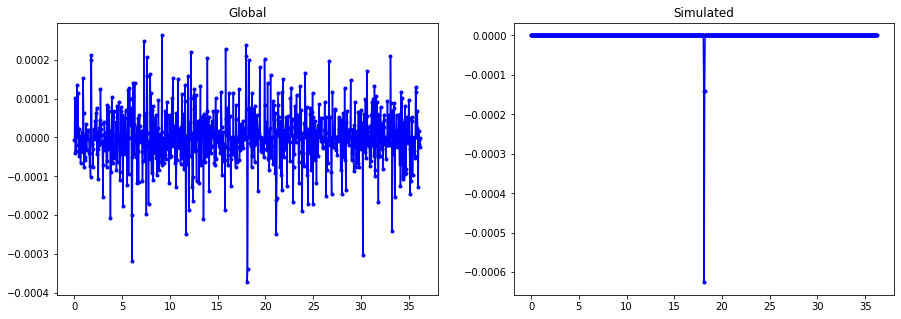

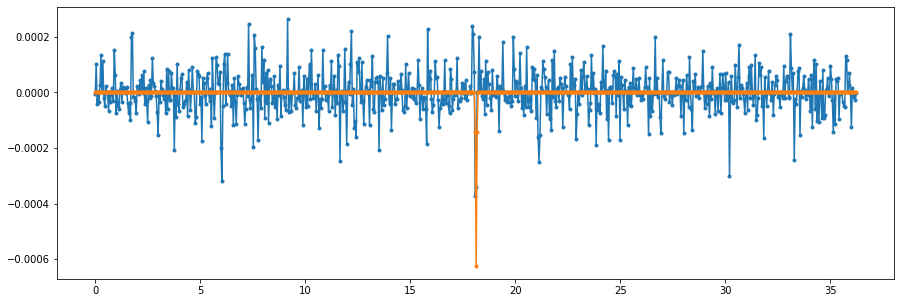

error en global=  0.988999408832105
----------------------------------------------------------------
Dis score 0.990000, not transit flag 0.0 sec flag 0.0


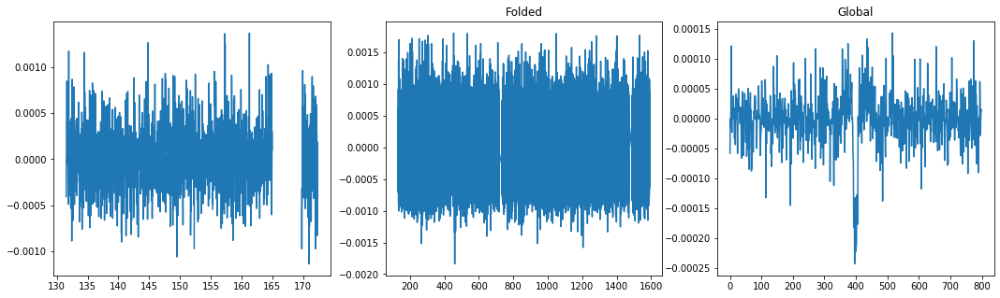

Max power:  0.000673595000444699
Second Max:  0.0006616936664212259


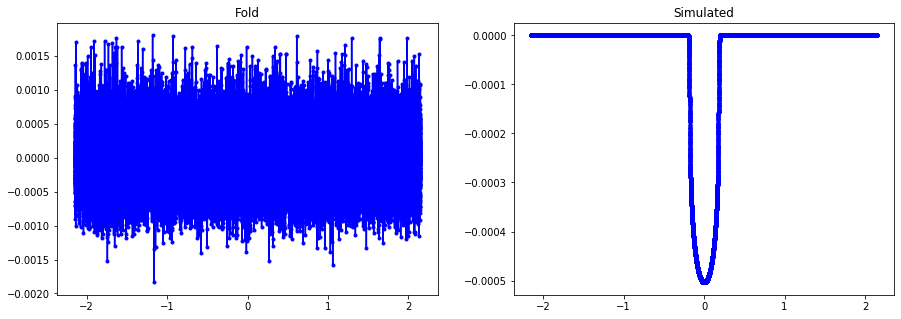

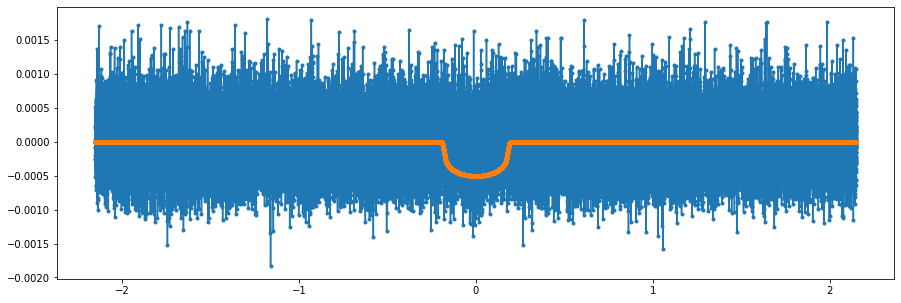

error en fold=  1.0575111346489647


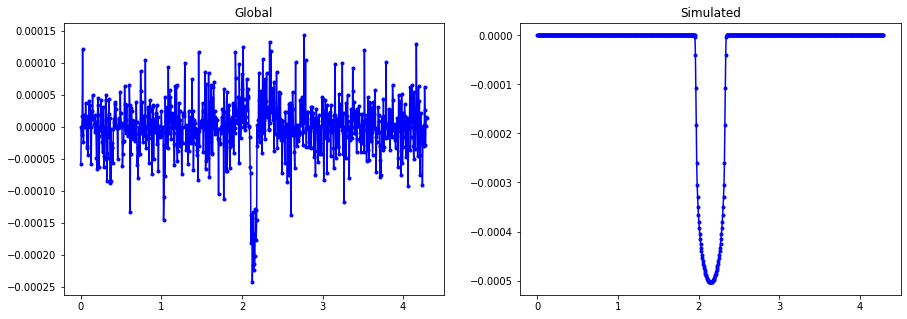

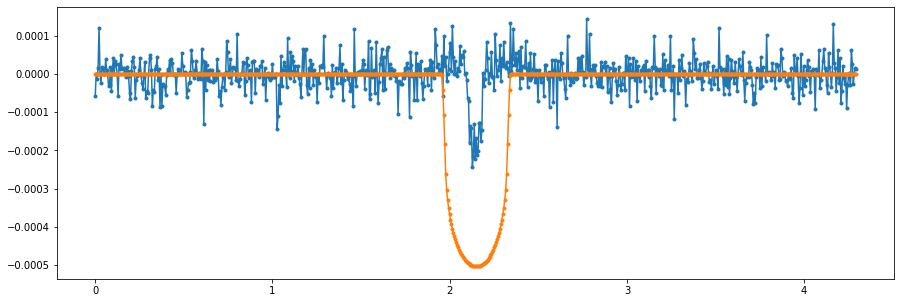

error en global=  2.8819803575075205
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


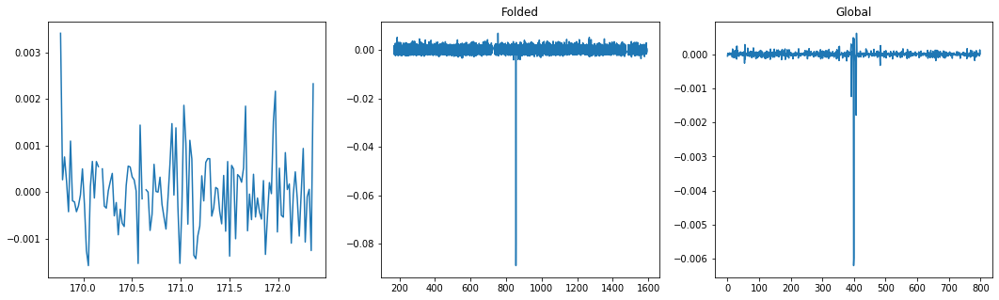

Max power:  0.002441208876449781
Second Max:  0.002425719489599352


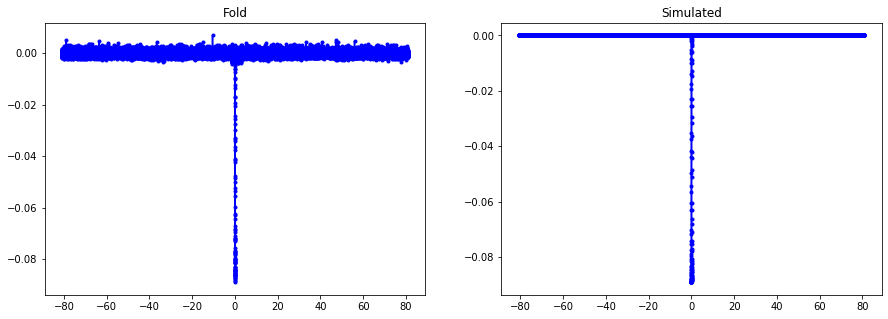

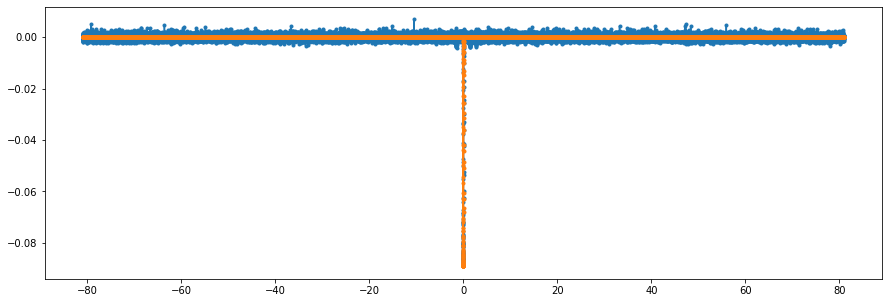

error en fold=  0.2879796961283174


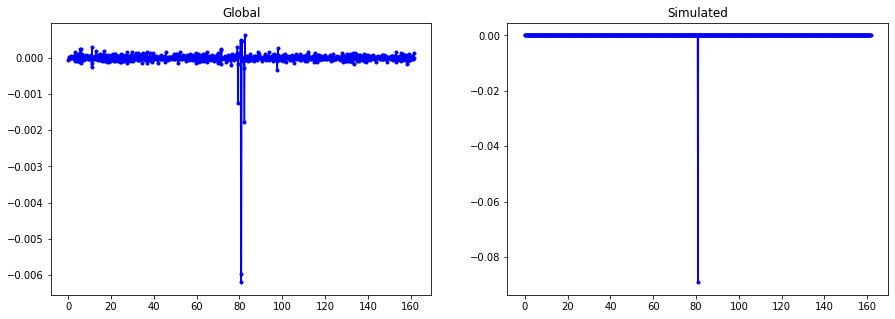

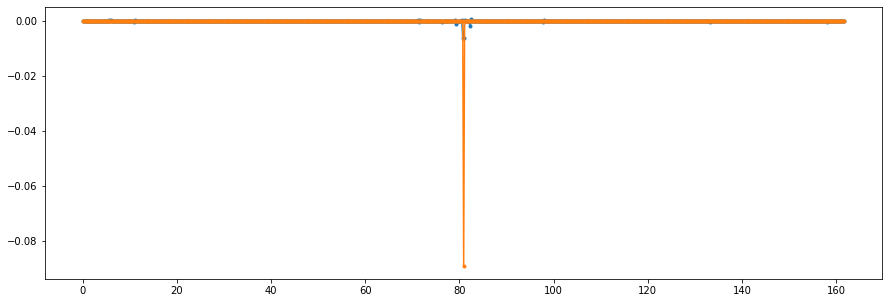

error en global=  9.159089939596289
----------------------------------------------------------------
Dis score 0.848000, not transit flag 0.0 sec flag 0.0


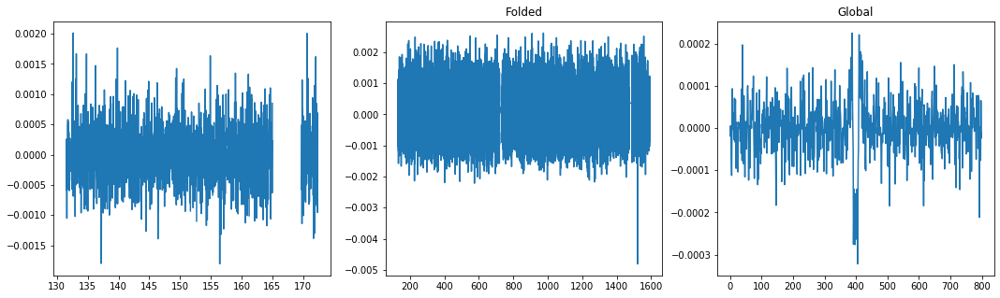

Max power:  0.0007378330366658631
Second Max:  0.0007249314177854141


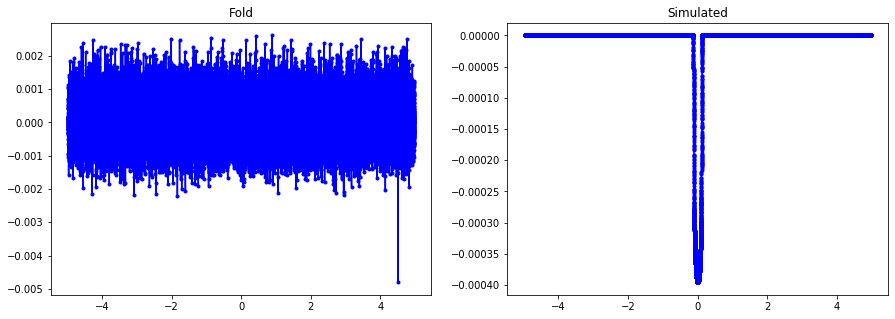

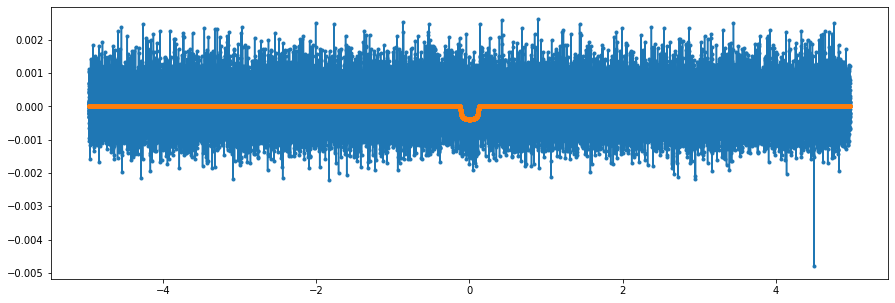

error en fold=  1.000027541625103


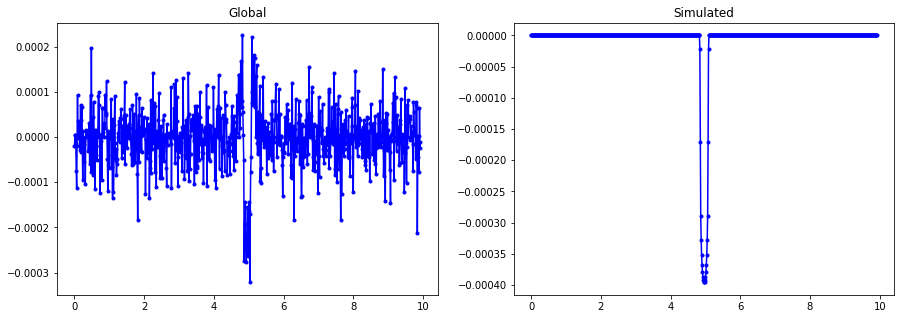

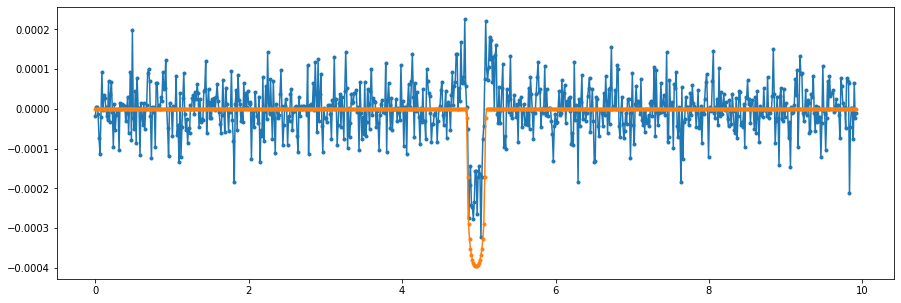

error en global=  0.990411410777066
----------------------------------------------------------------
Dis score 0.961000, not transit flag 0.0 sec flag 0.0


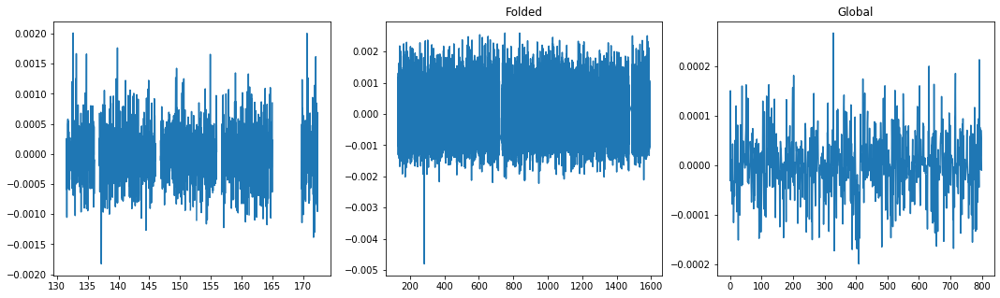

Max power:  0.0005774585565079943
Second Max:  0.0005181965807383869


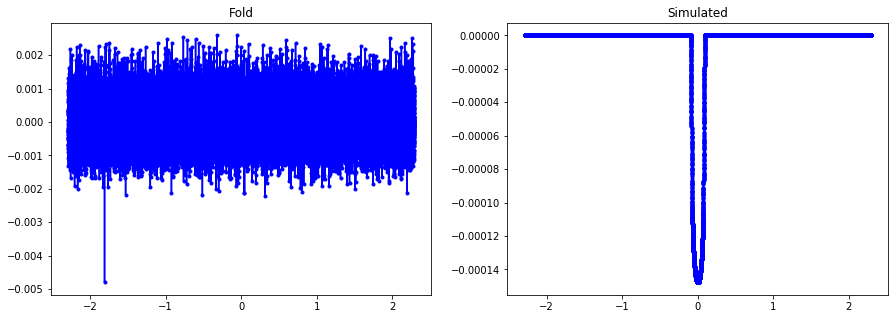

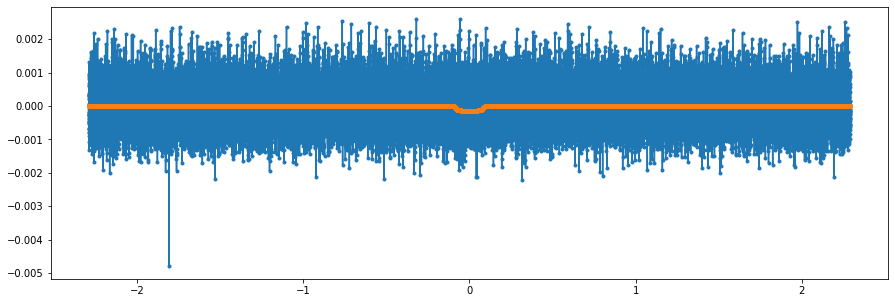

error en fold=  1.0002719013583765


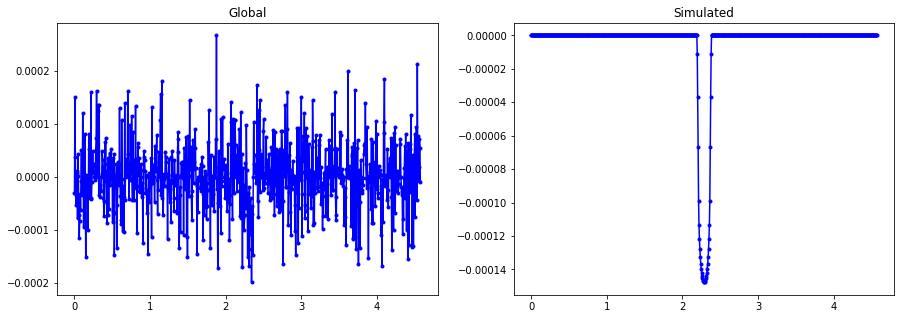

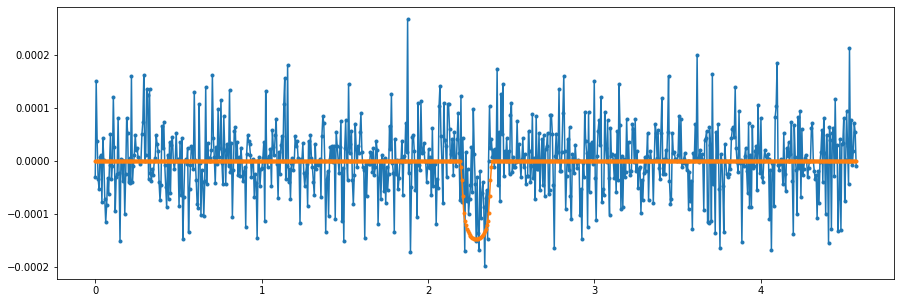

error en global=  1.0092594723826134
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


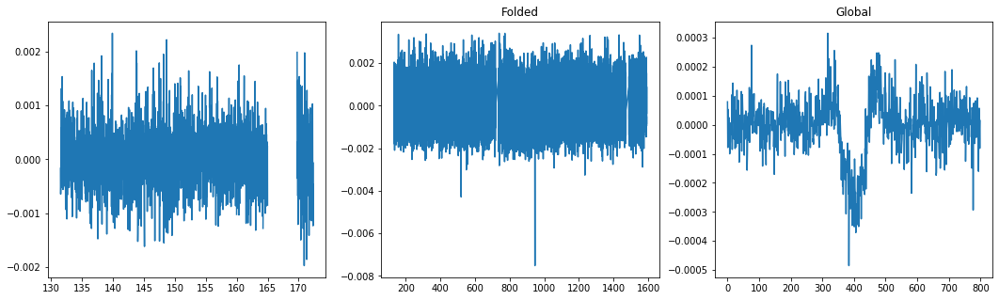

Max power:  0.003257302520518171
Second Max:  0.003067494249560734


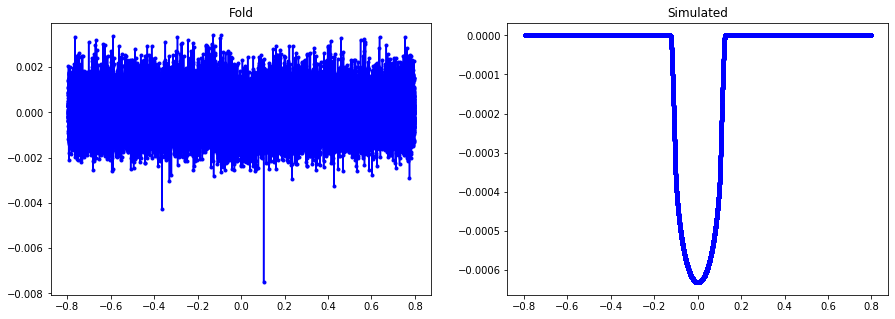

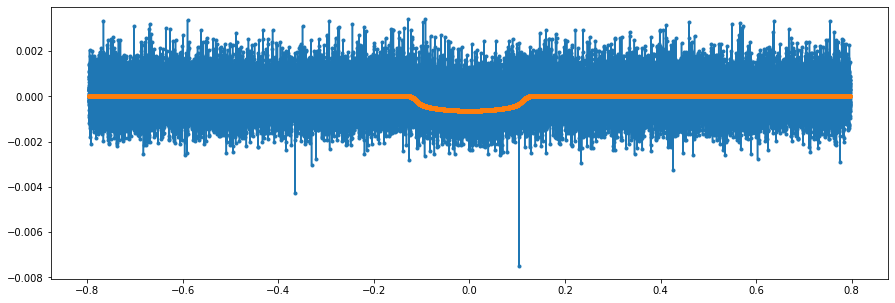

error en fold=  1.0194307703831524


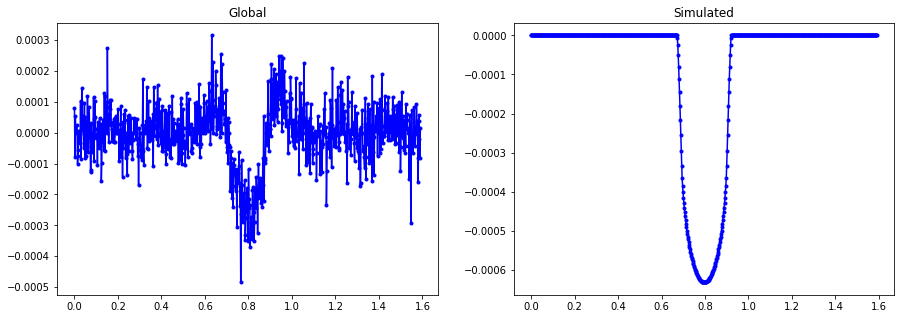

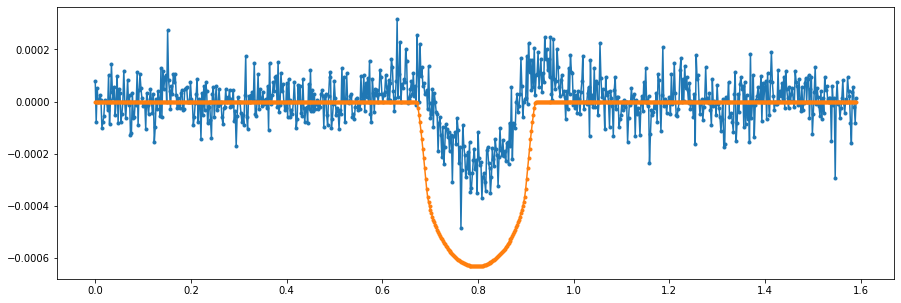

error en global=  1.6806708172322022
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


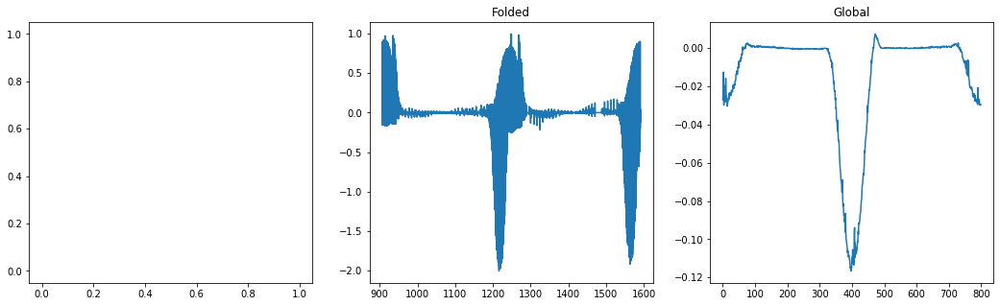

Max power:  0.05503674569438178
Second Max:  0.05332028598246893


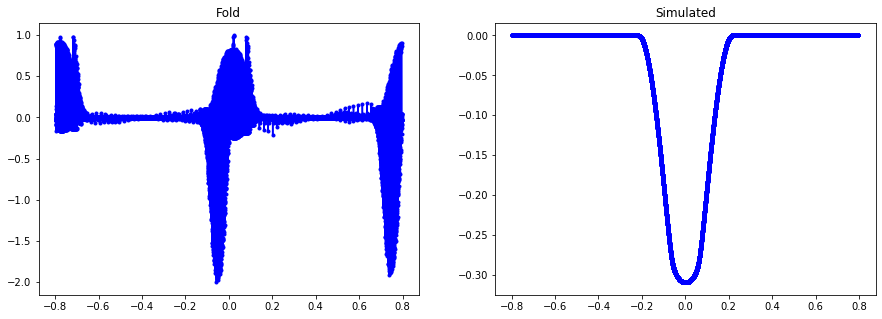

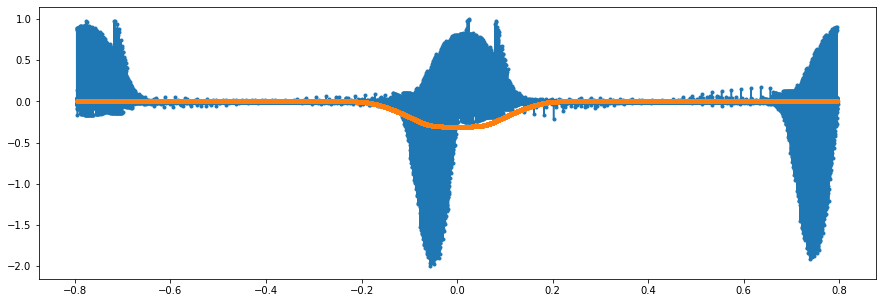

error en fold=  1.0744918490873367


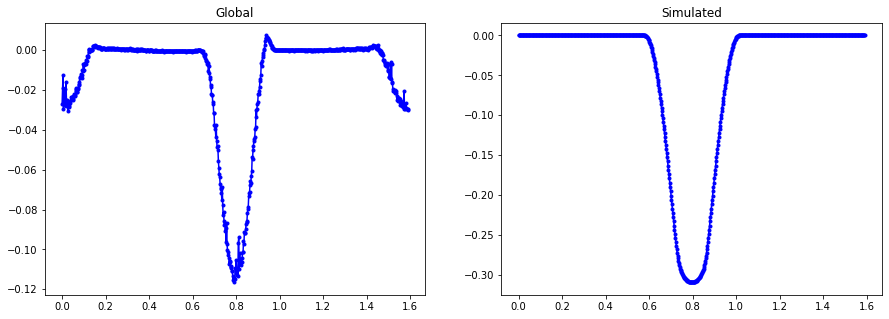

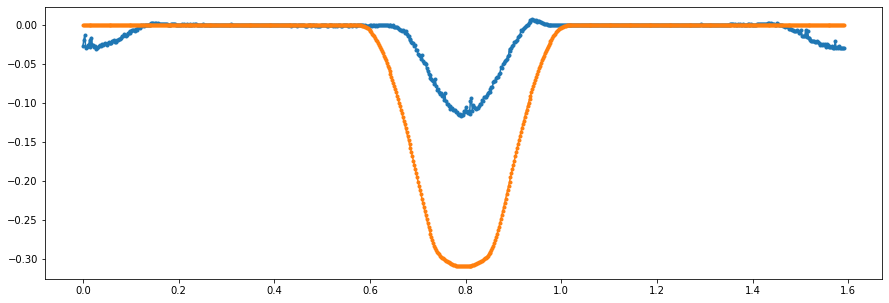

error en global=  2.704668578156006
----------------------------------------------------------------
Dis score 0.014000, not transit flag 0.0 sec flag 0.0


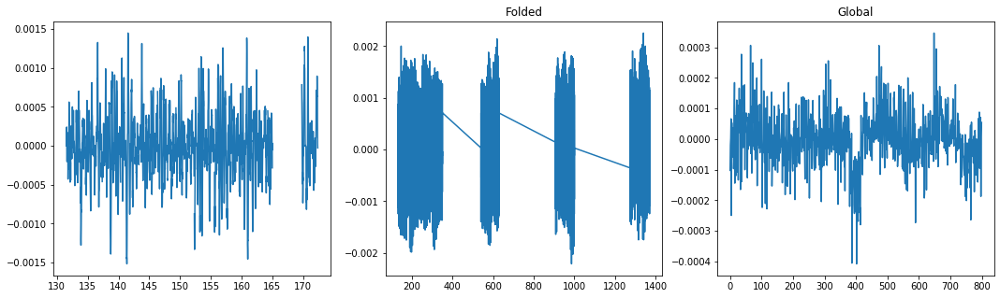

Max power:  0.019372655732853735
Second Max:  0.01662269214289748


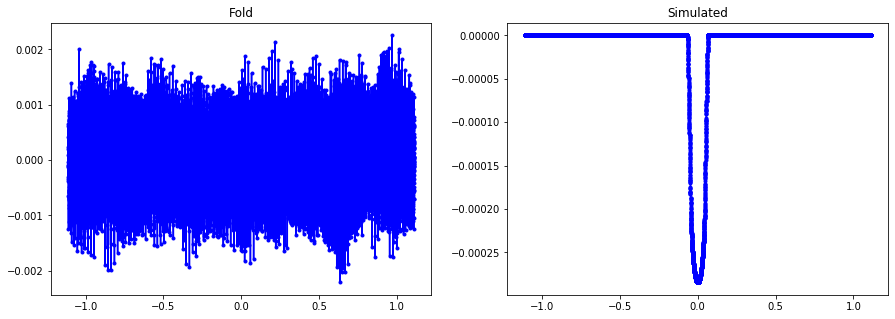

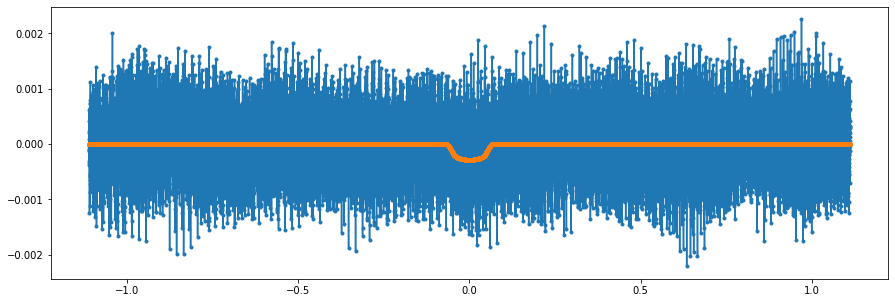

error en fold=  0.9979567694515884


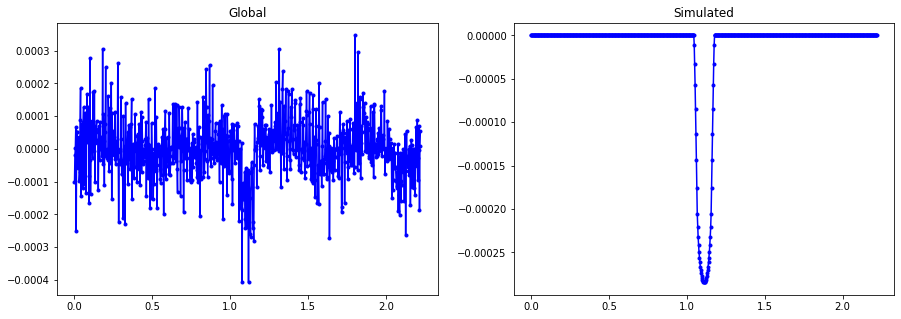

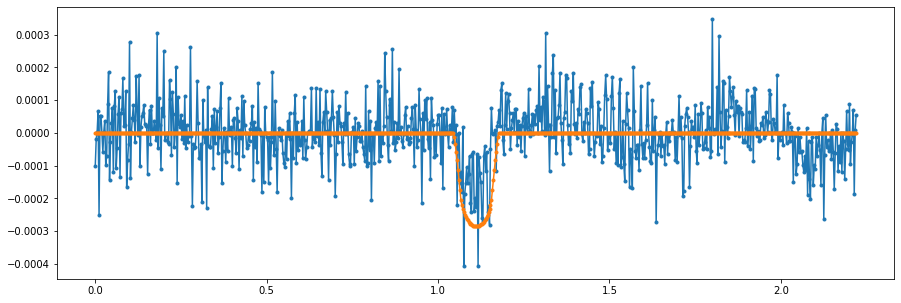

error en global=  0.9727630963007529
----------------------------------------------------------------
Dis score 0.004000, not transit flag 0.0 sec flag 1.0


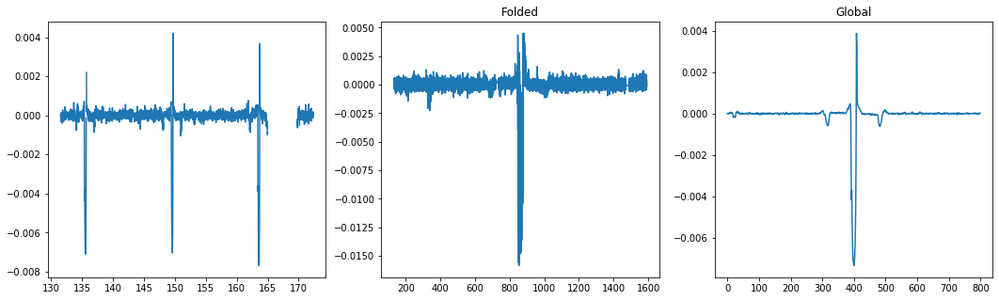

Max power:  0.03315671060789116
Second Max:  0.033012361738906974


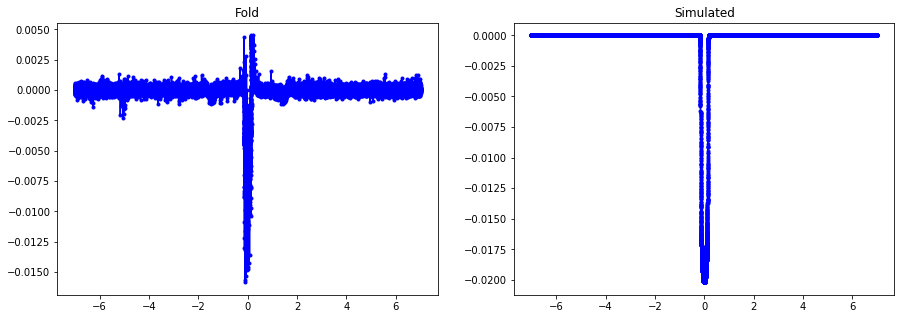

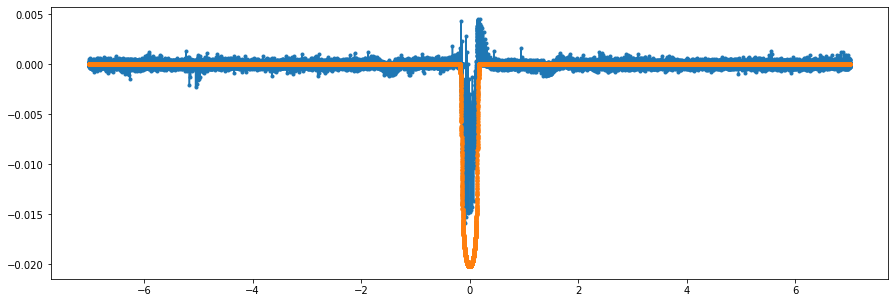

error en fold=  2.0555799215218338


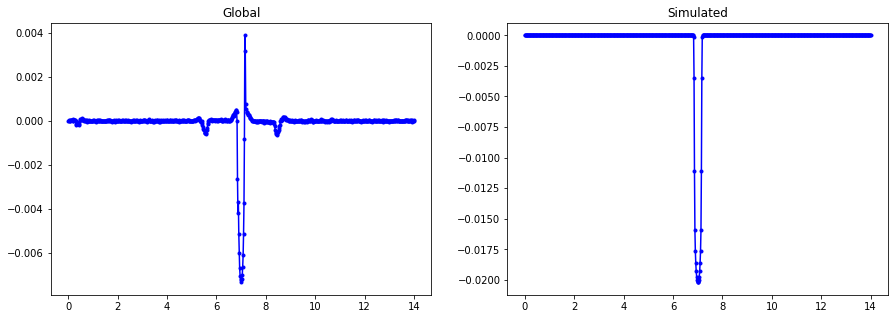

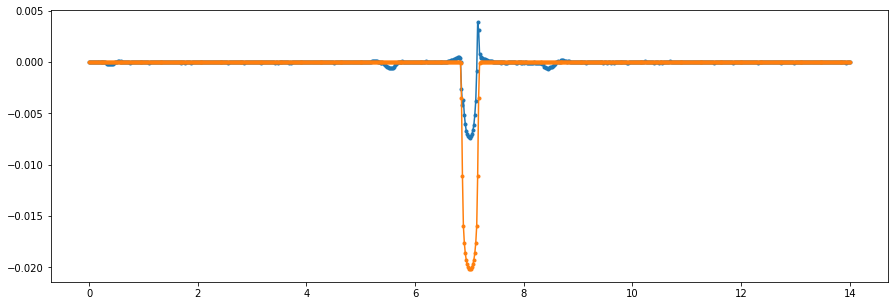

error en global=  2.1915212441045235
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


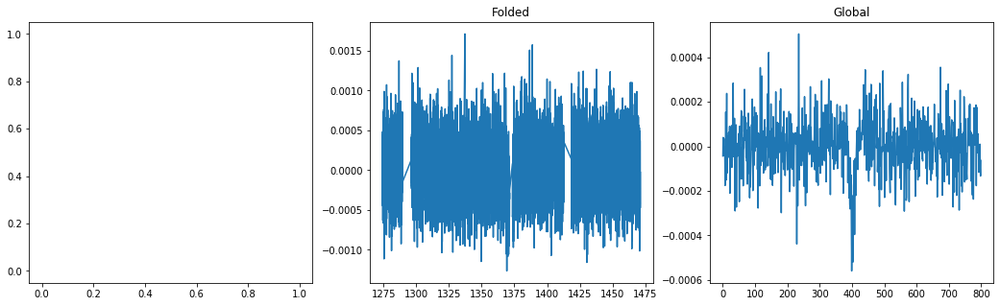

Max power:  0.003098188177176645
Second Max:  0.002922742996738641


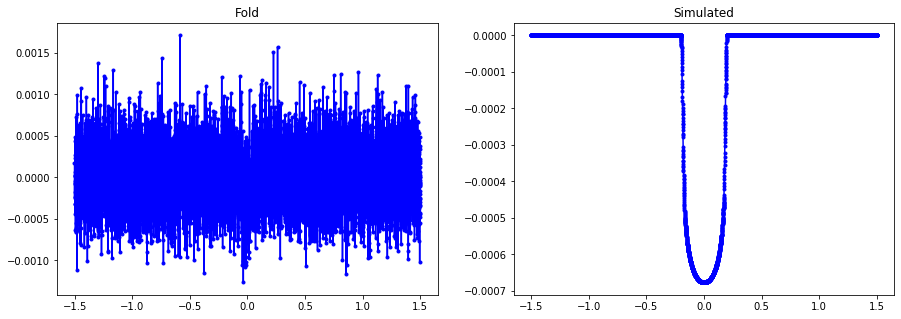

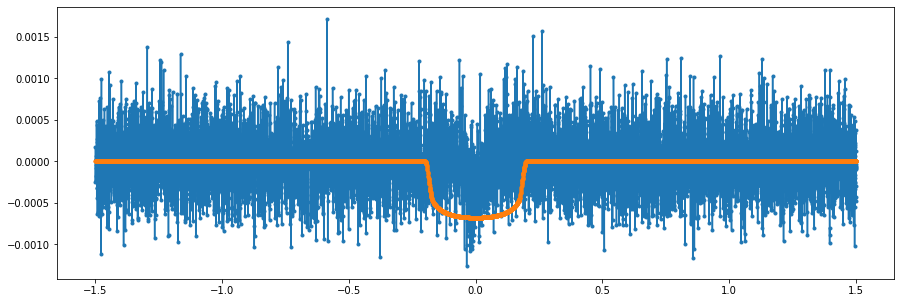

error en fold=  1.1664809402271534


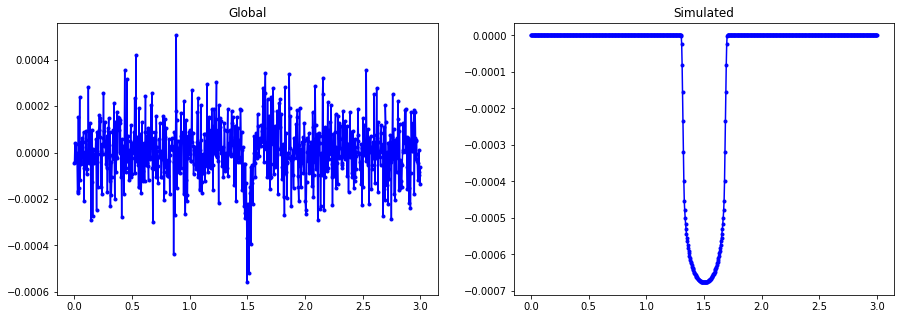

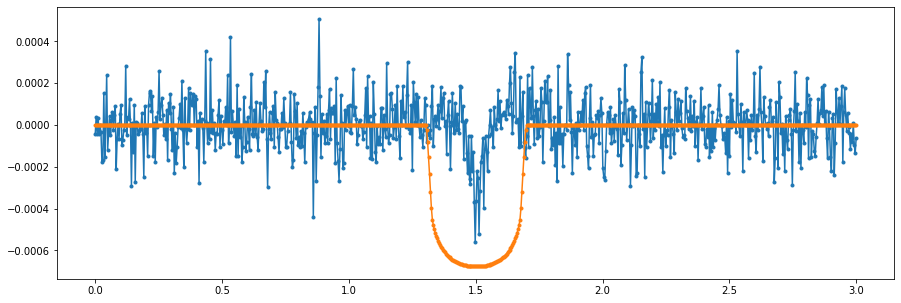

error en global=  1.9451875292319118
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


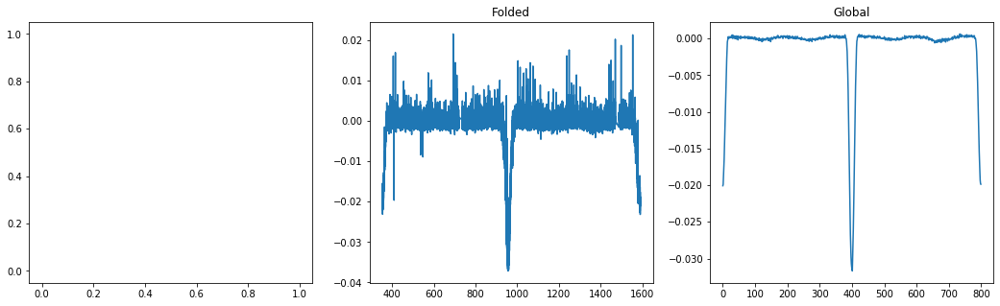

Max power:  0.11461868218600141
Second Max:  0.11410389245458238


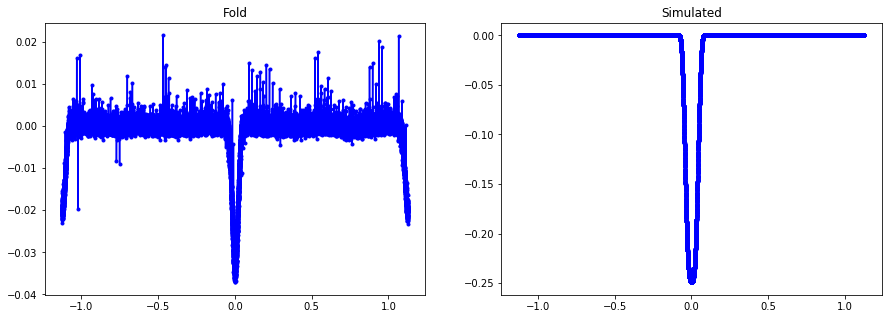

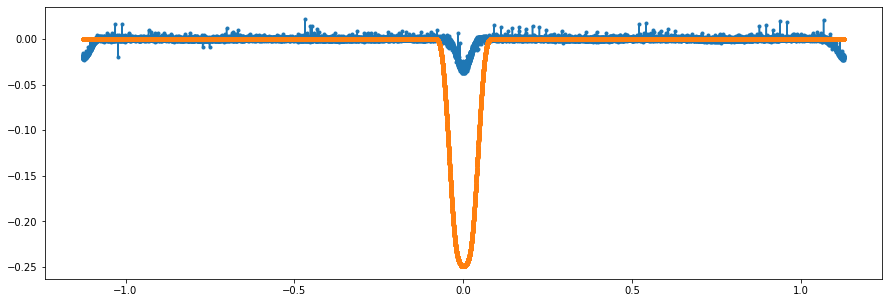

error en fold=  8.534093657938273


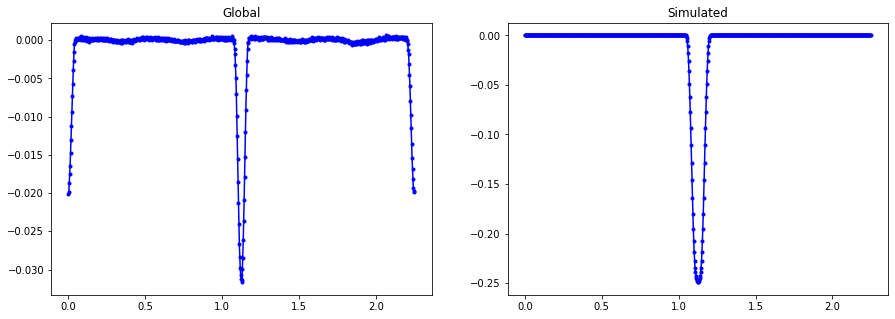

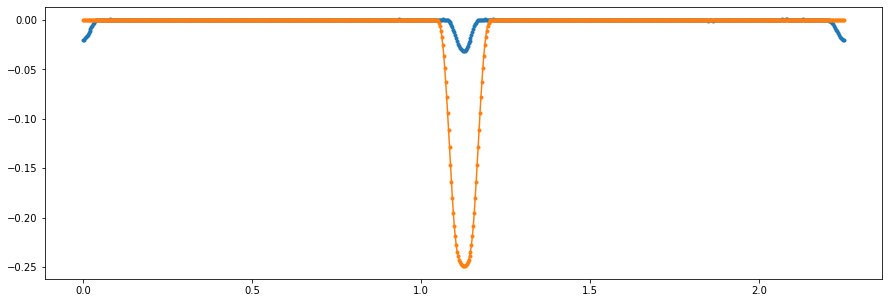

error en global=  8.781262319637575
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


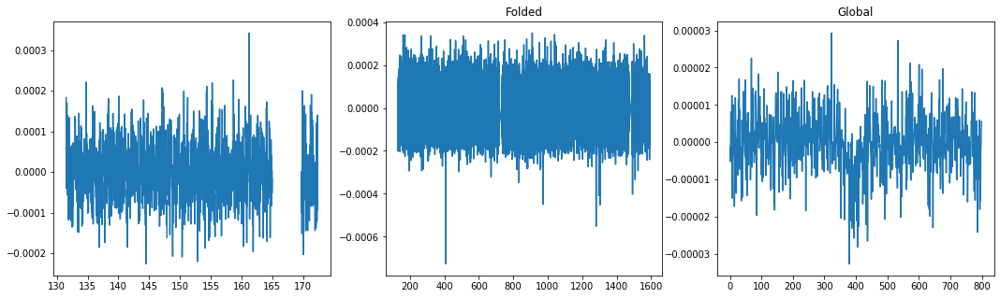

Max power:  0.0012081670513617389
Second Max:  0.0011419504862556543


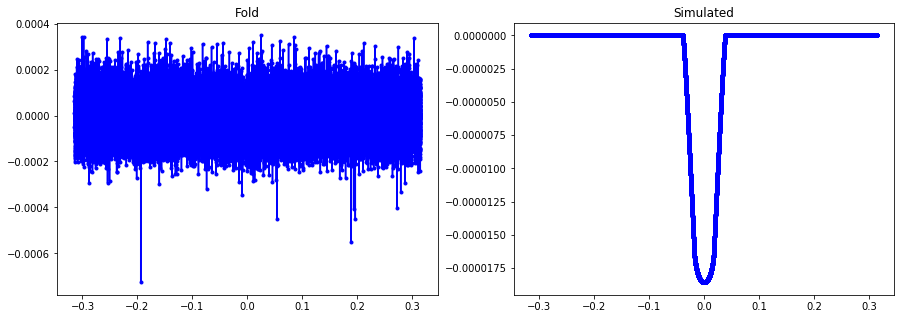

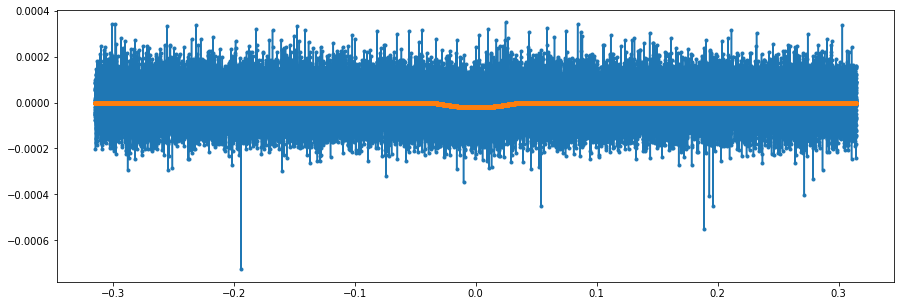

error en fold=  0.9992929381980348


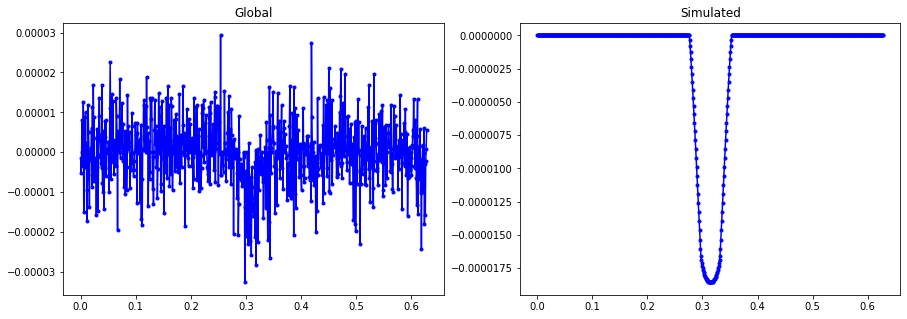

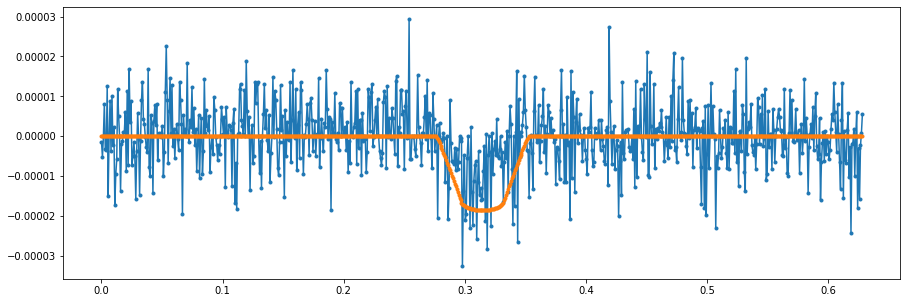

error en global=  1.0028936037938443
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


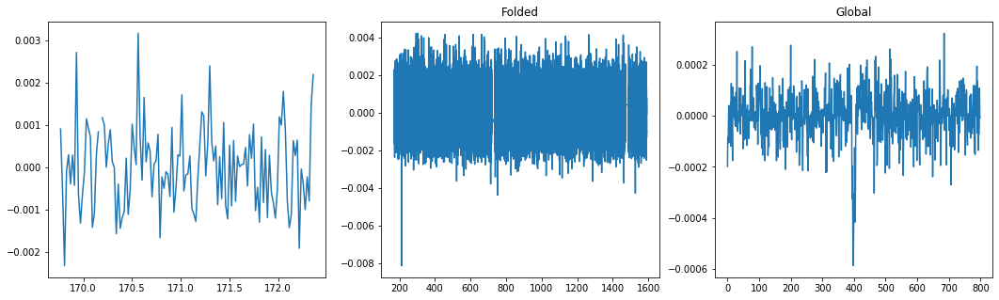

Max power:  0.0006973997199550417
Second Max:  0.000676699120527924


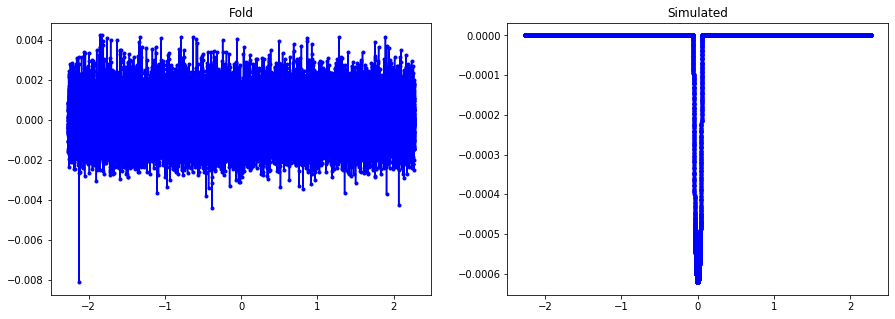

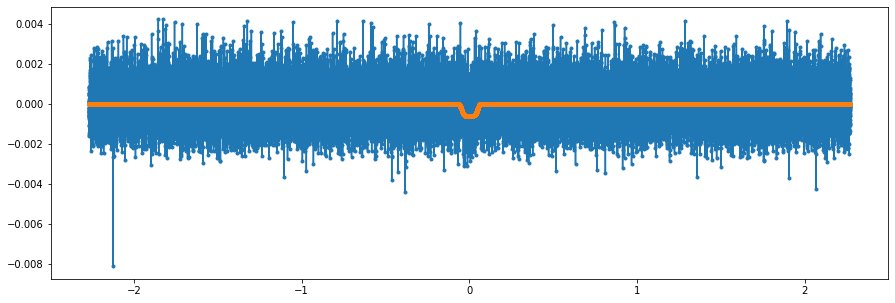

error en fold=  1.000463899095241


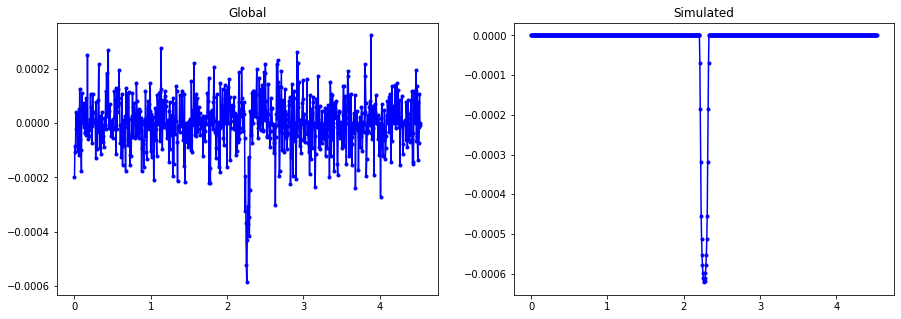

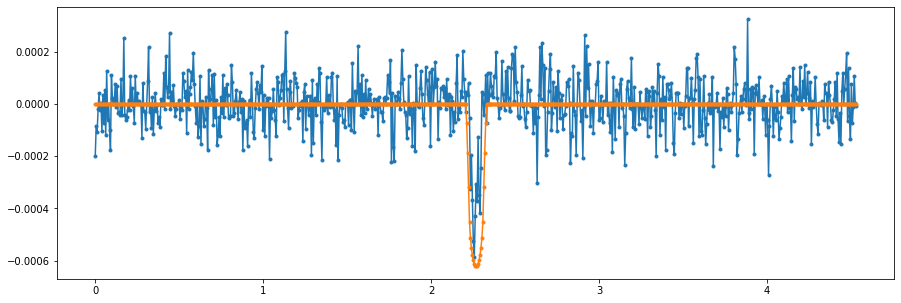

error en global=  1.0126559515583777
----------------------------------------------------------------
Dis score 0.858000, not transit flag 0.0 sec flag 0.0


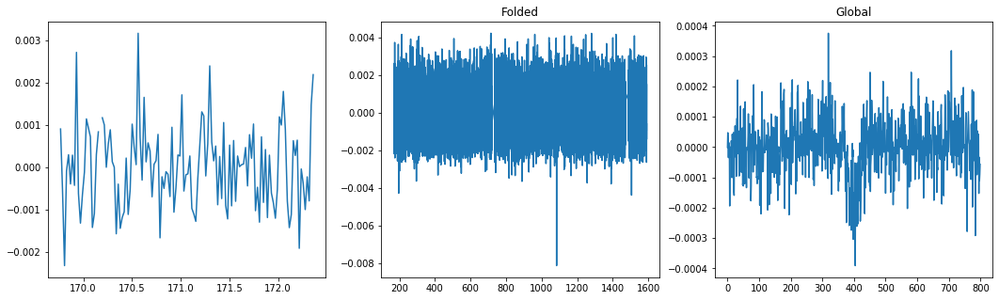

Max power:  0.0007223172441119813
Second Max:  0.0006991935155170176


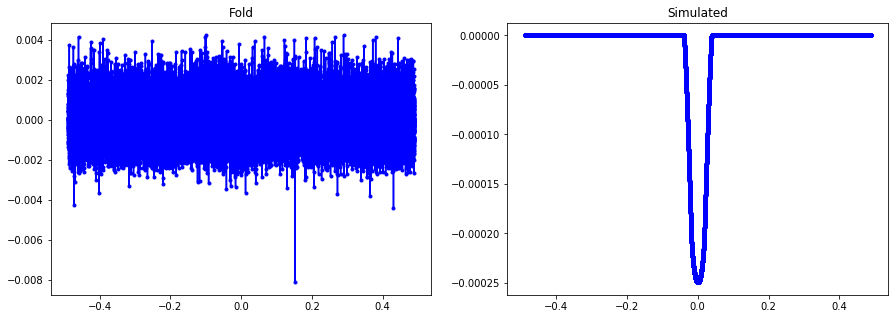

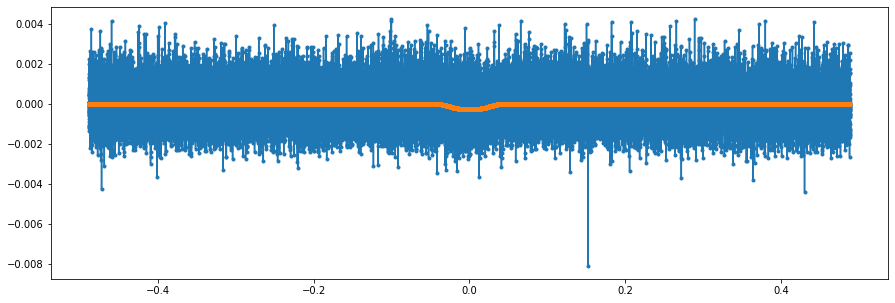

error en fold=  0.9991687213150645


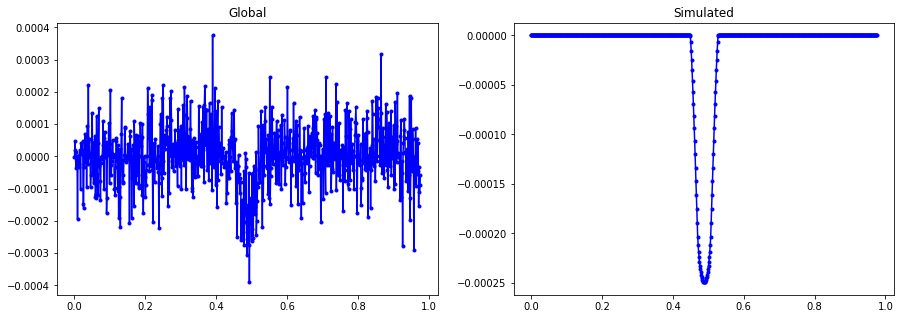

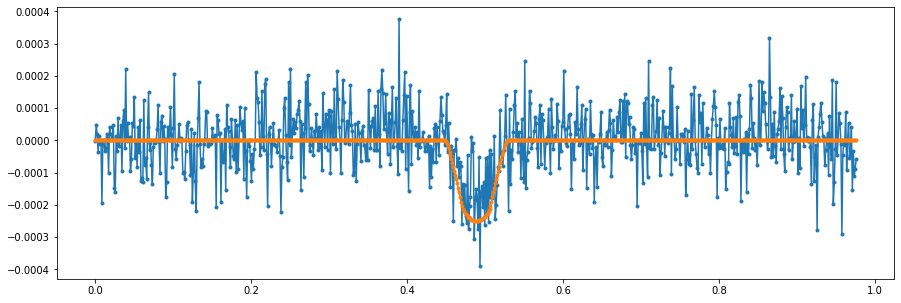

error en global=  0.9375926838519824
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


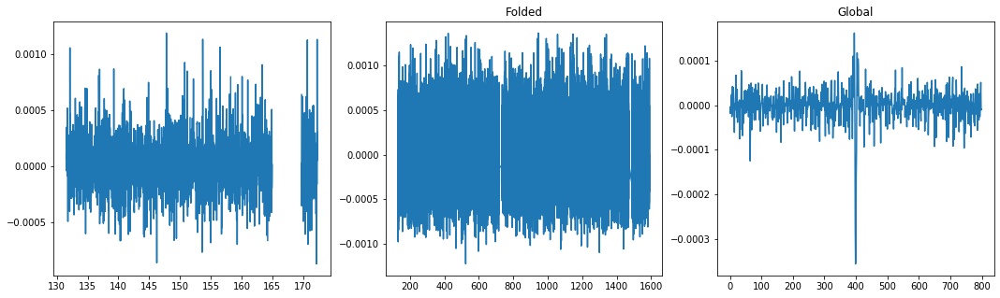

Max power:  0.0005622141717663724
Second Max:  0.0005486423038180128


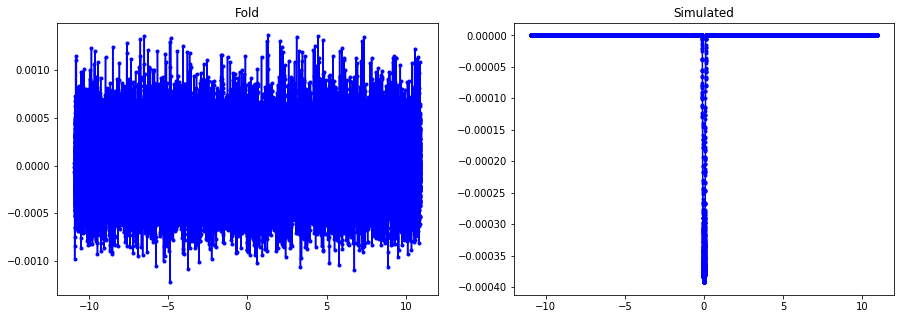

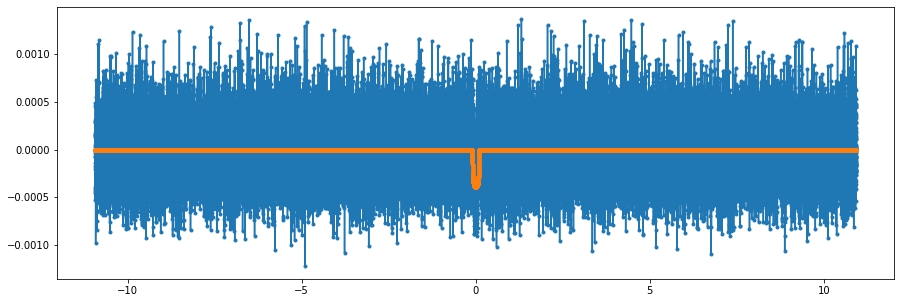

error en fold=  1.0001627884596702


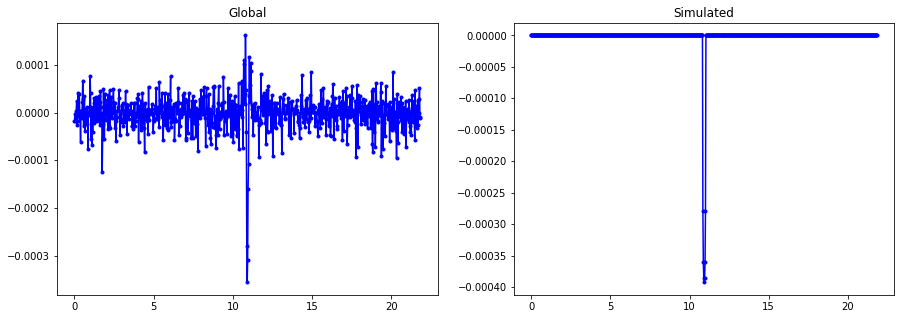

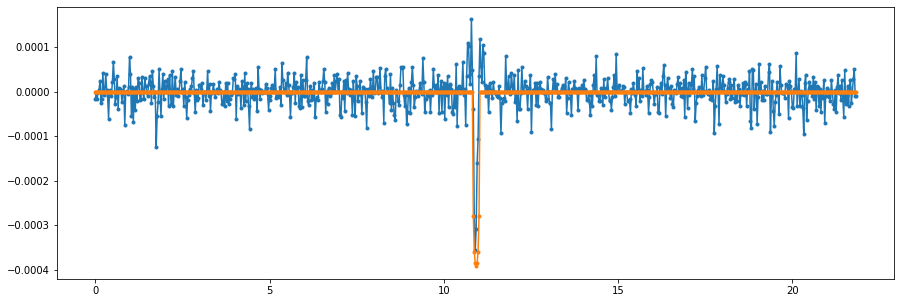

error en global=  0.9753380512458196
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


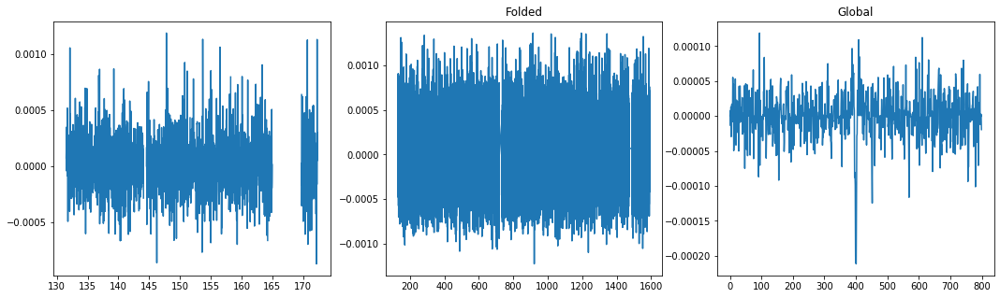

Max power:  0.000592789731325464
Second Max:  0.0005792636358461906


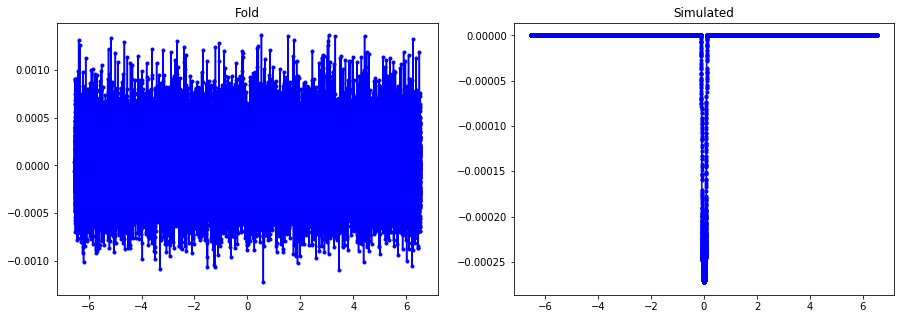

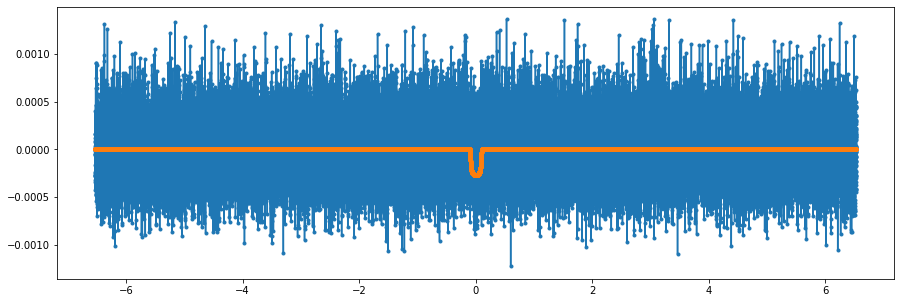

error en fold=  1.0013391623783914


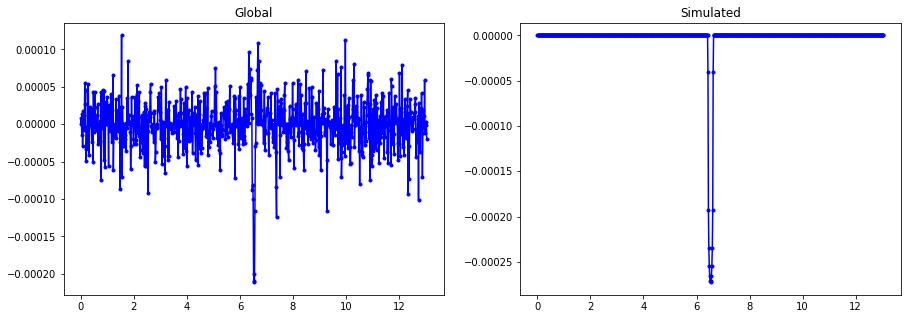

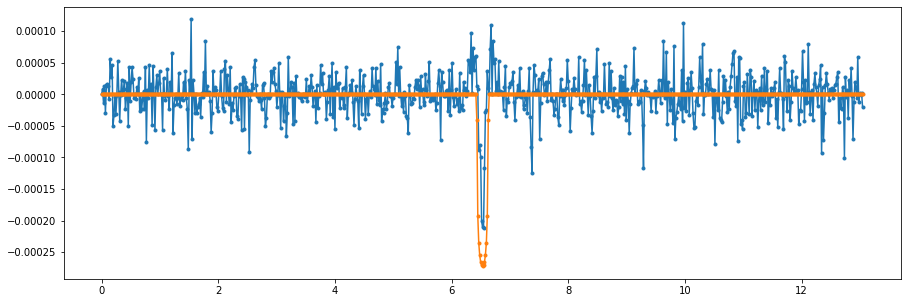

error en global=  1.074455923802347
----------------------------------------------------------------
Dis score 0.149000, not transit flag 0.0 sec flag 1.0


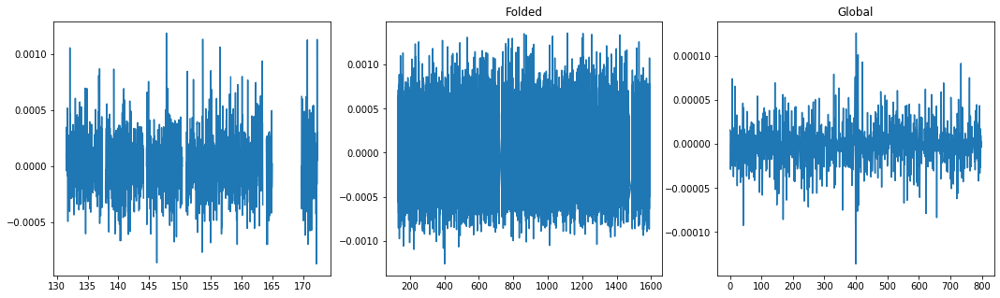

Max power:  0.00047744726916401875
Second Max:  0.00046655017553050976


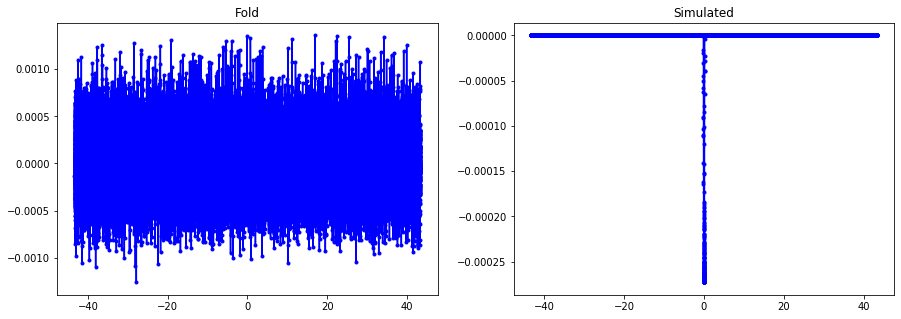

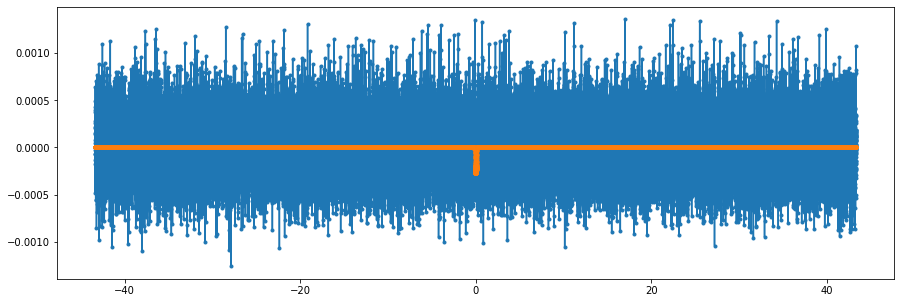

error en fold=  1.0006466778489416


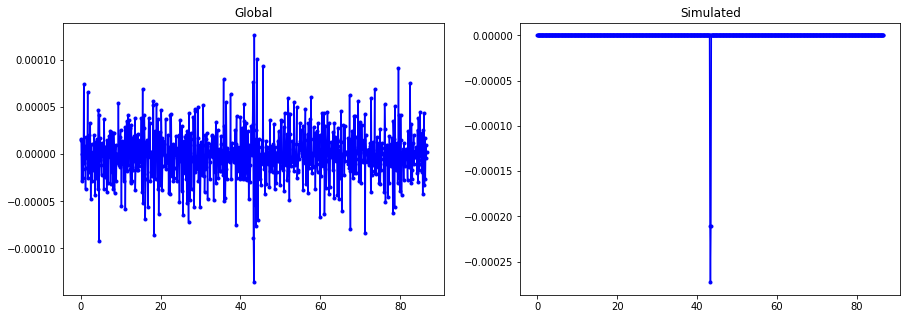

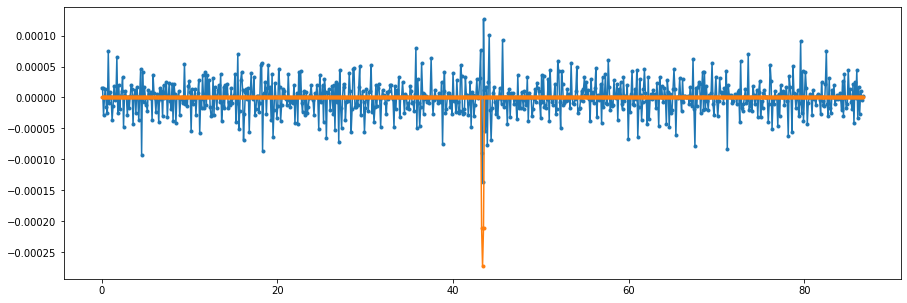

error en global=  1.0867464090515124
----------------------------------------------------------------
Dis score 0.985000, not transit flag 0.0 sec flag 0.0


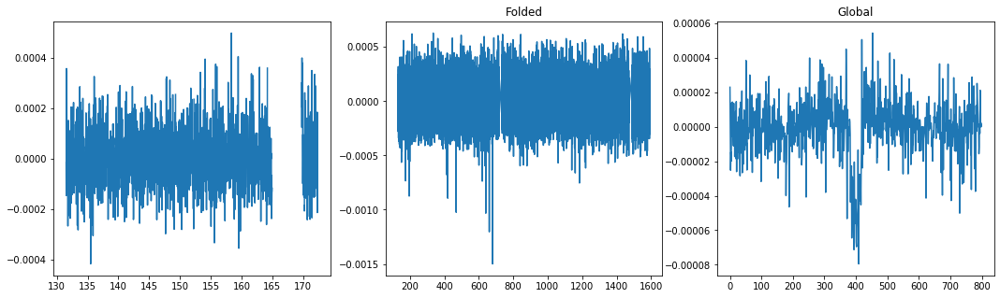

Max power:  0.0014737514025295764
Second Max:  0.001309893500739023


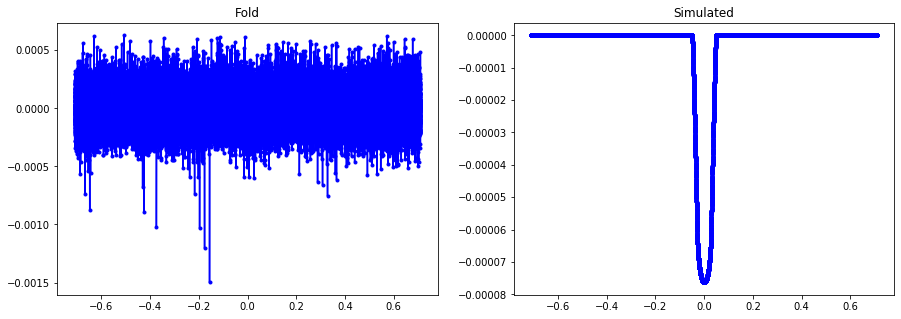

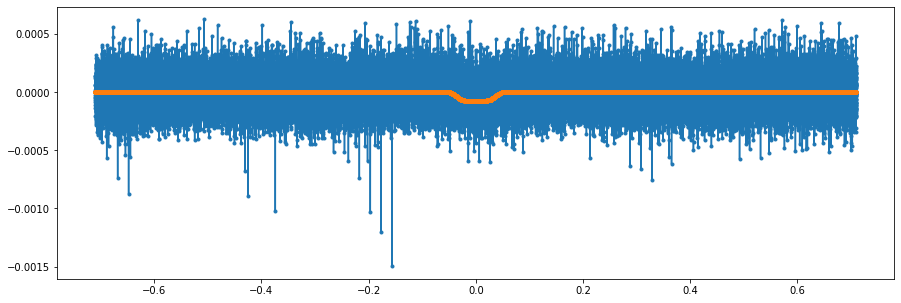

error en fold=  0.9995172843966929


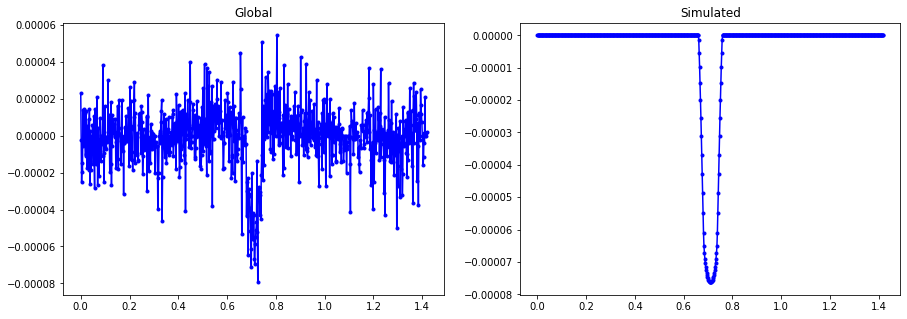

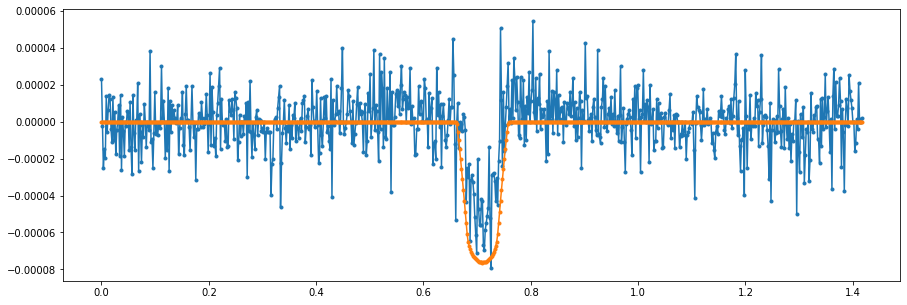

error en global=  0.9512728938778715
----------------------------------------------------------------
Dis score 0.970000, not transit flag 0.0 sec flag 0.0


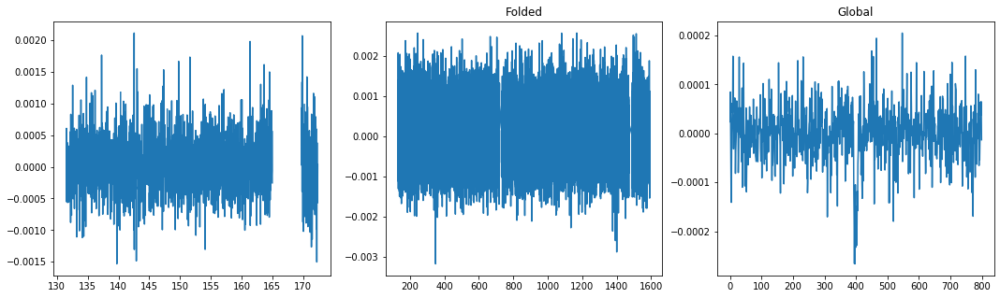

Max power:  0.0007604806026128576
Second Max:  0.000689348417838801


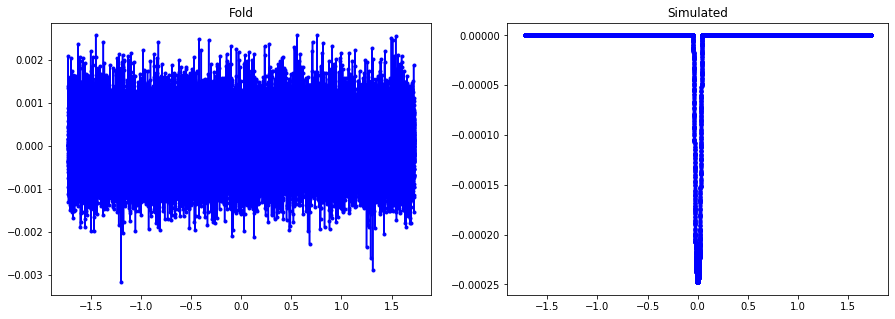

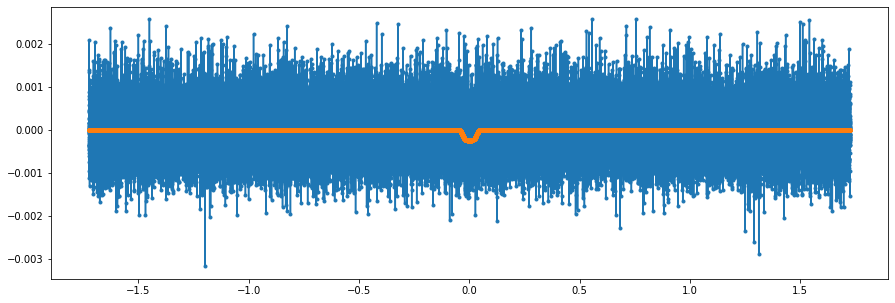

error en fold=  0.9993836436447503


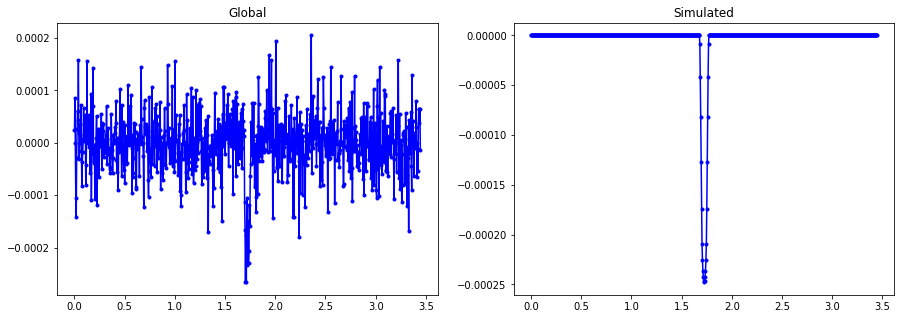

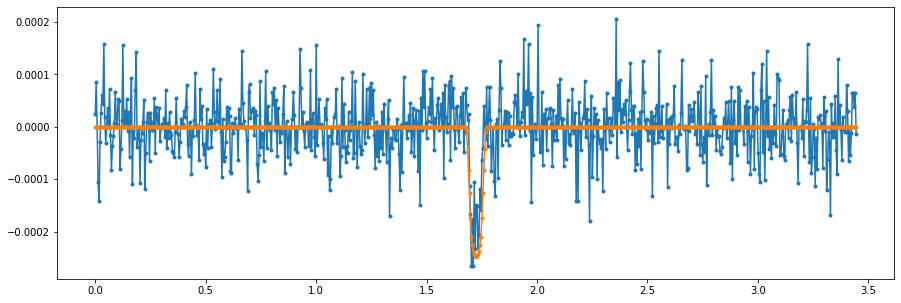

error en global=  0.9330292493190696
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


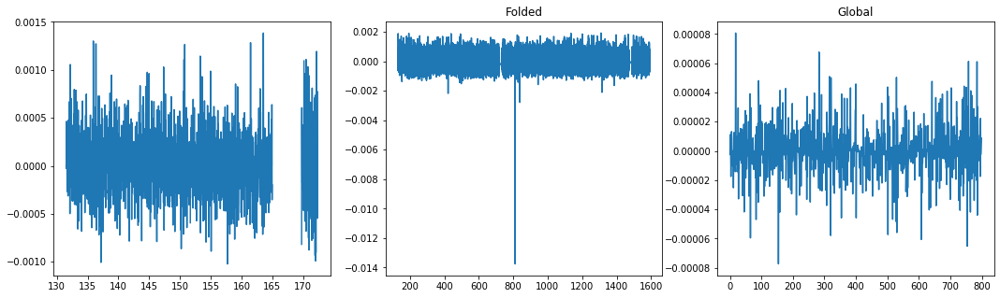

Max power:  0.0005958758330128643
Second Max:  0.0005660973721942402


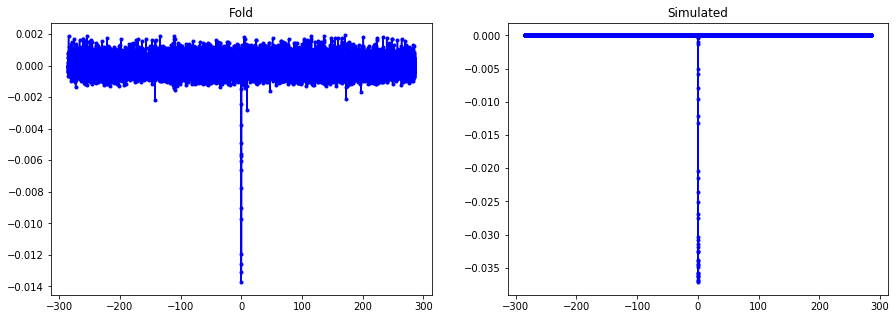

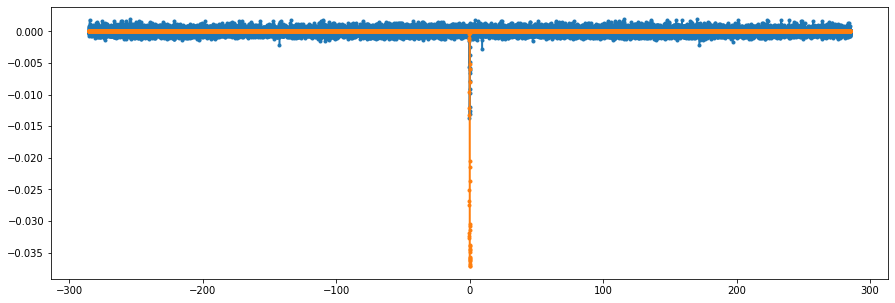

error en fold=  1.7113432013866192


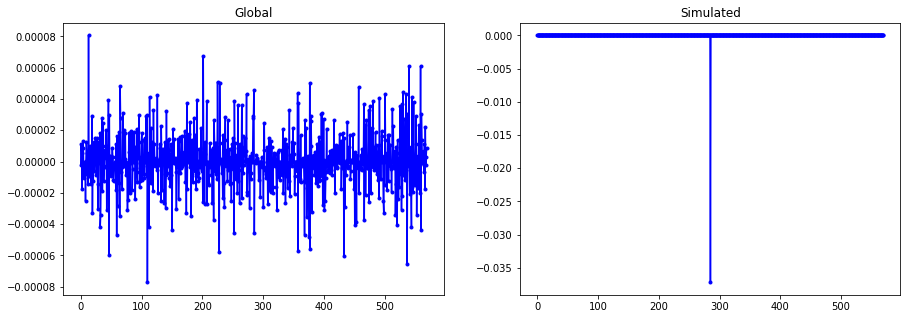

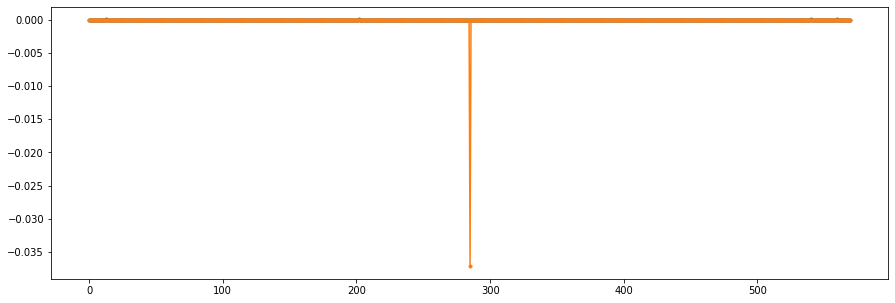

error en global=  74.36641246849636
----------------------------------------------------------------
Dis score 0.246000, not transit flag 0.0 sec flag 0.0


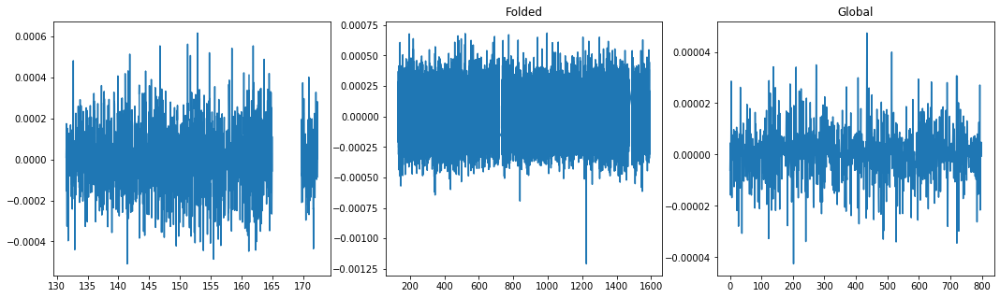

Max power:  0.0008358350225536555
Second Max:  0.0008264304089212532


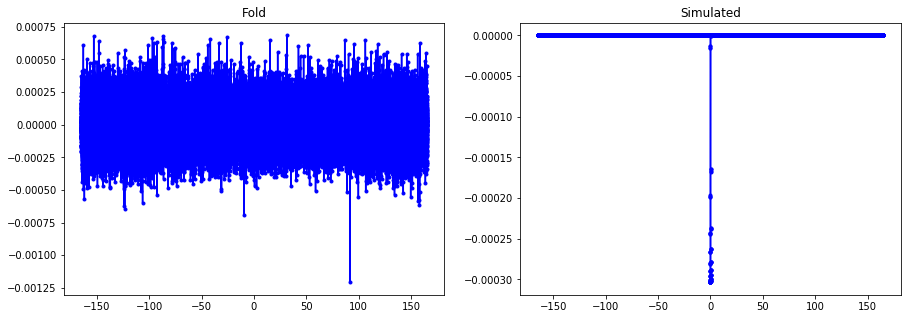

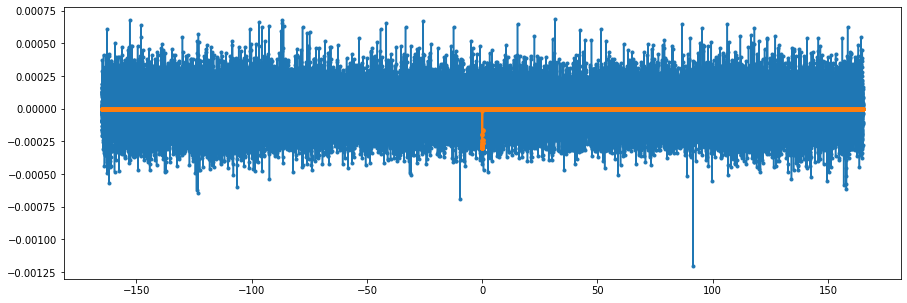

error en fold=  1.000991816129687


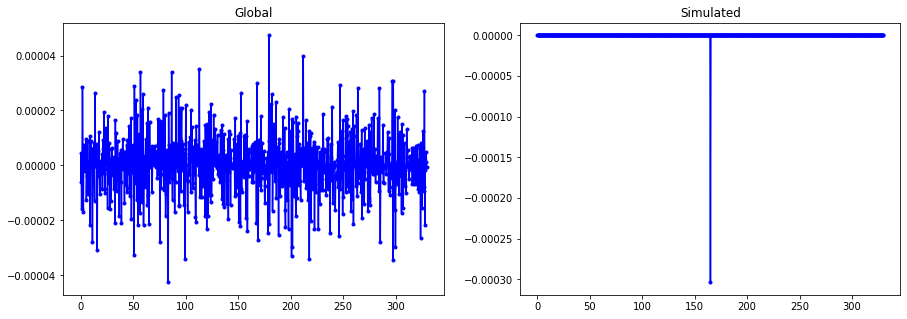

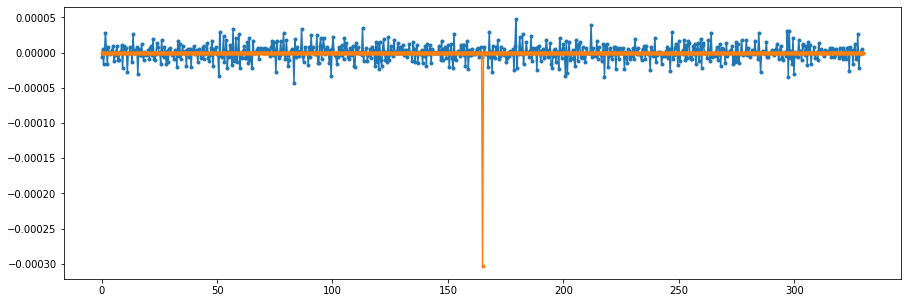

error en global=  1.3859032540467908
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


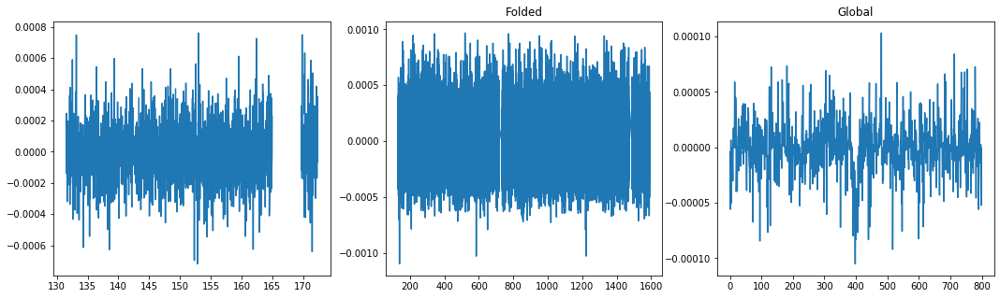

Max power:  0.0005563542704252627
Second Max:  0.0005324778598493305


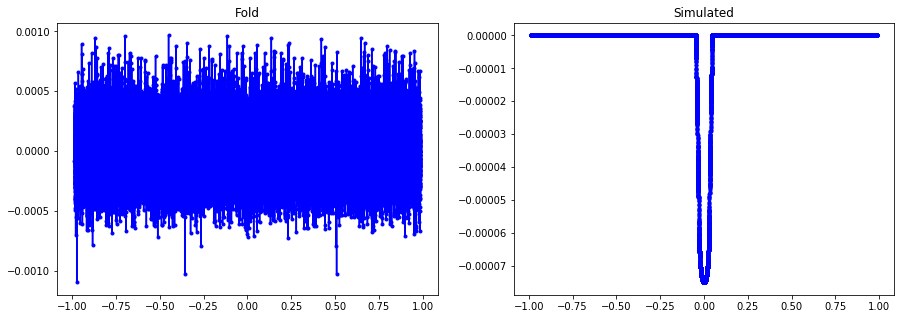

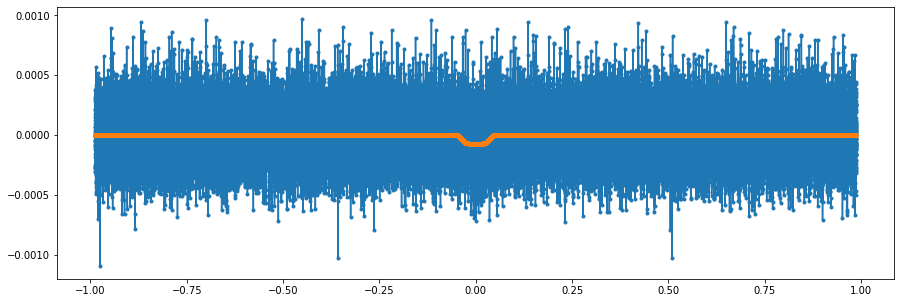

error en fold=  0.9991287192286171


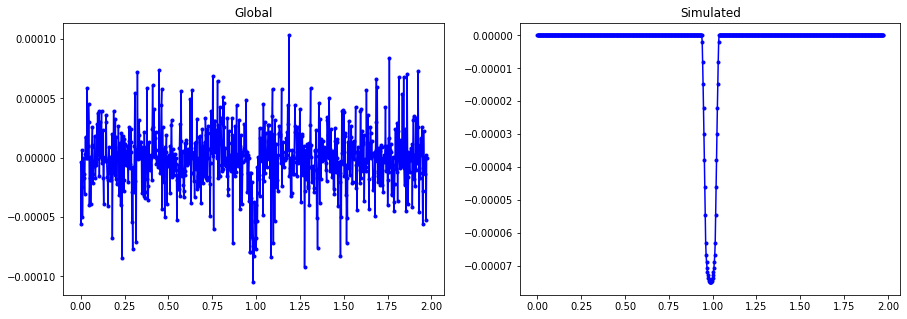

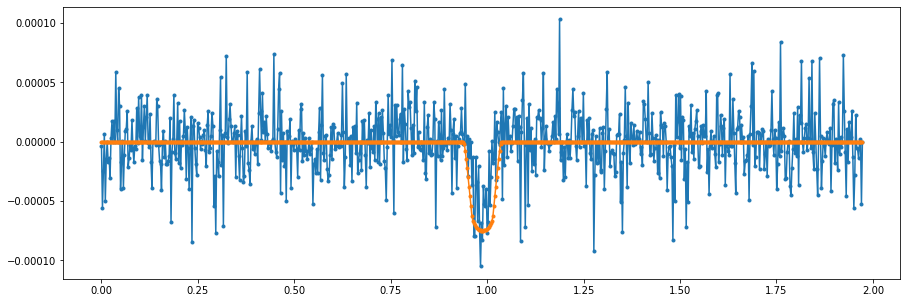

error en global=  0.9732598326710903
----------------------------------------------------------------
Dis score 0.956000, not transit flag 0.0 sec flag 0.0


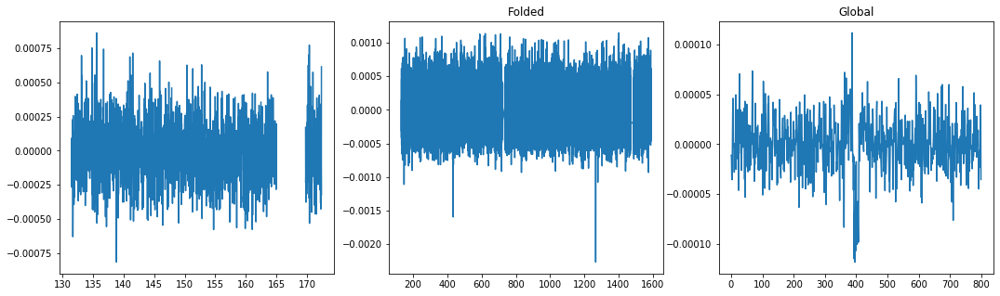

Max power:  0.0005280760698586055
Second Max:  0.0004909929882184777


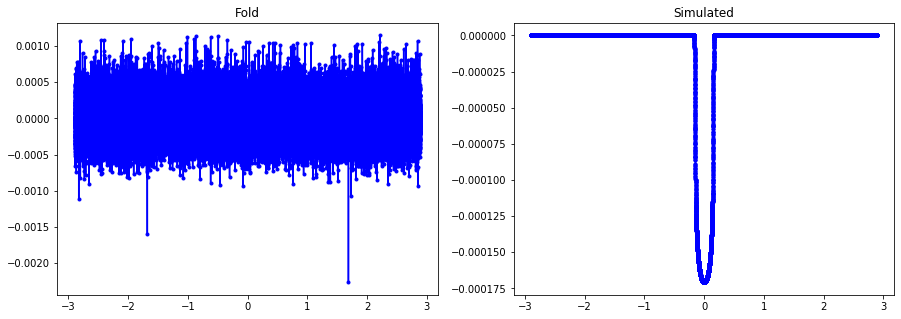

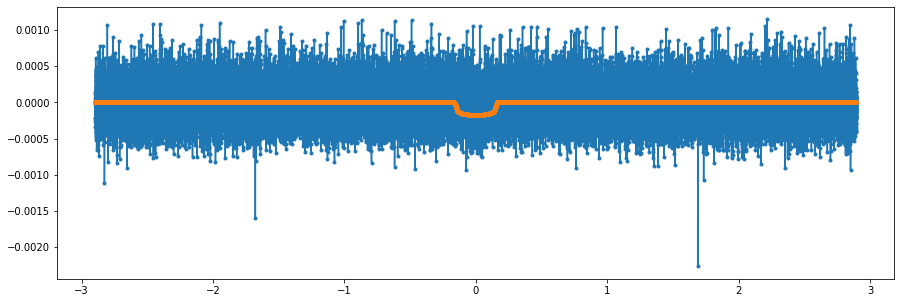

error en fold=  1.00948677103984


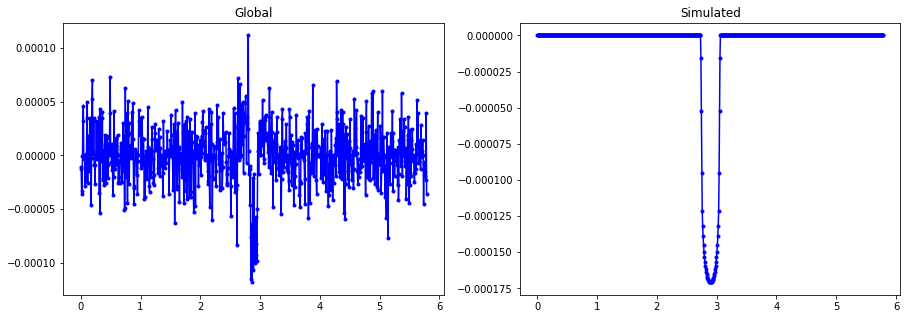

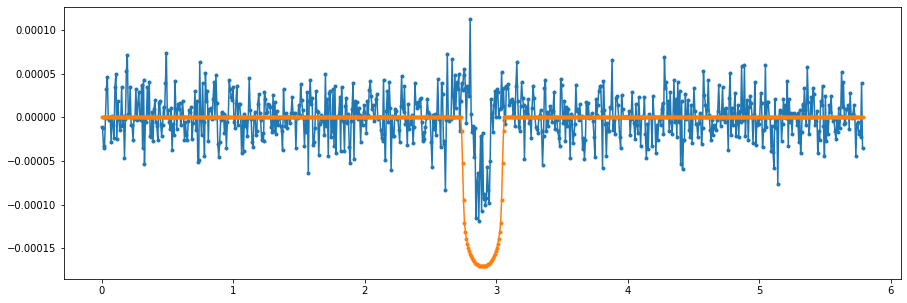

error en global=  1.4925787049962898
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


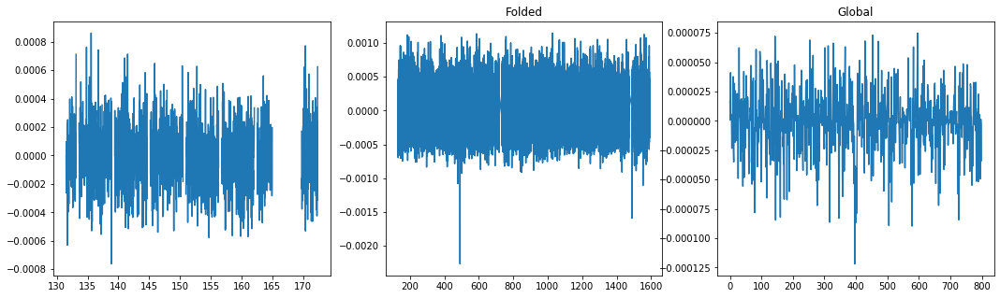

Max power:  0.0005904588940376077
Second Max:  0.0005654666145207282


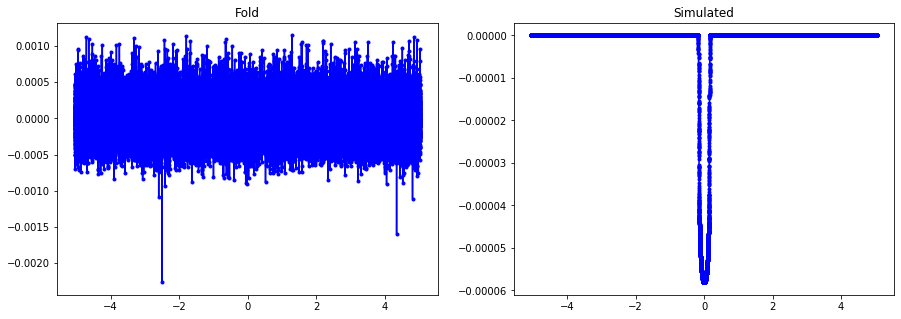

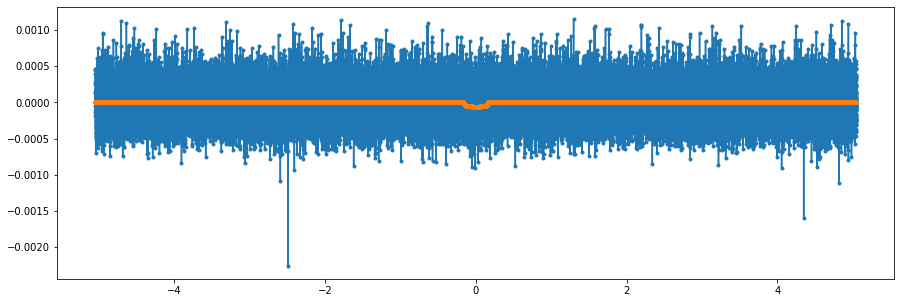

error en fold=  1.0002083422611525


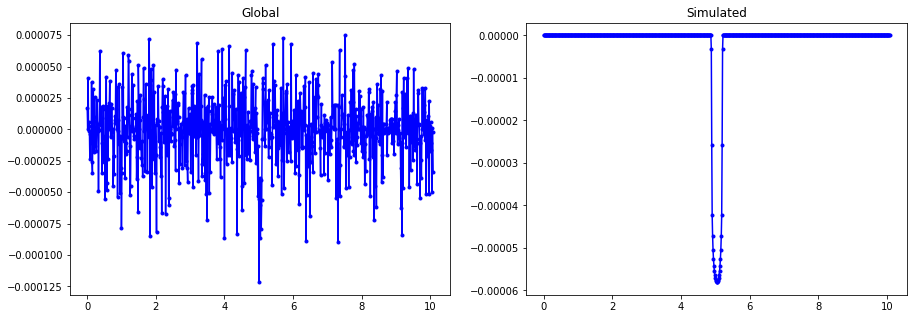

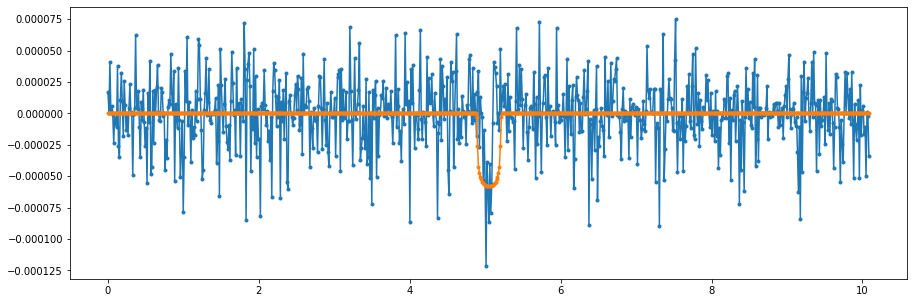

error en global=  1.0131505148243862
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


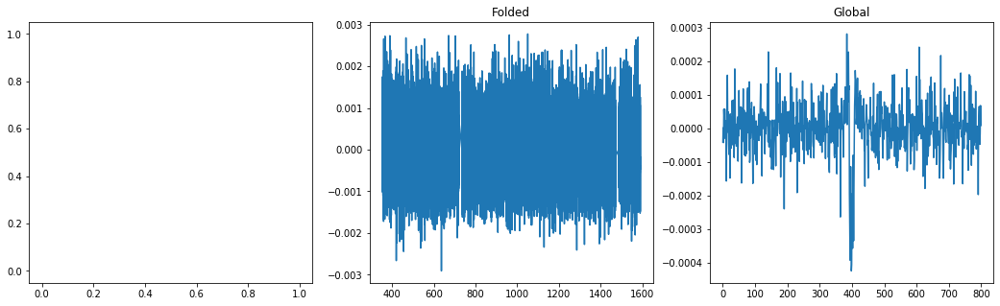

Max power:  0.0012575231089733134
Second Max:  0.0012544349632573387


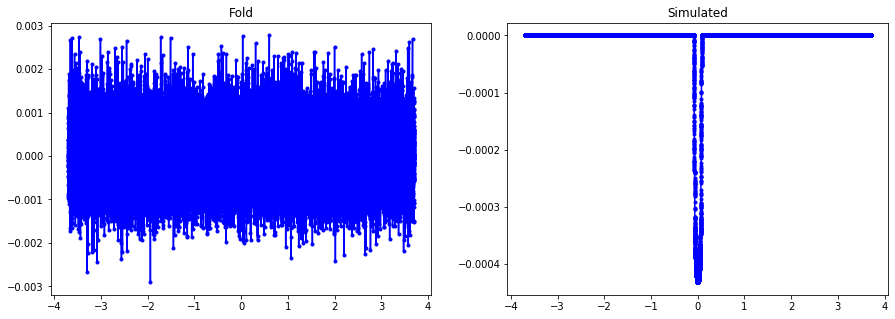

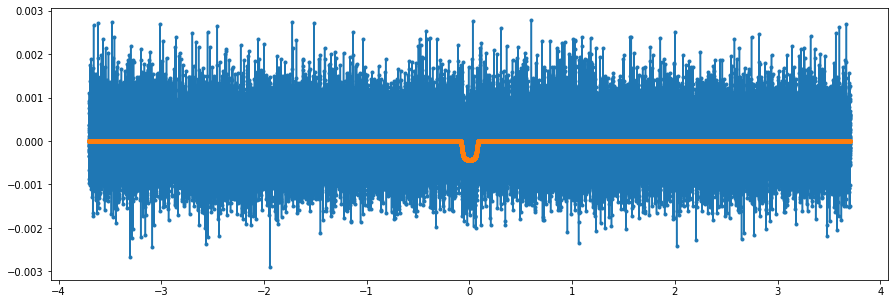

error en fold=  0.9980609887836597


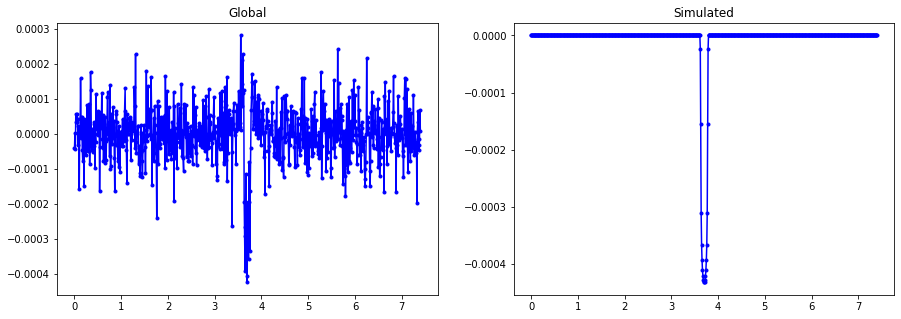

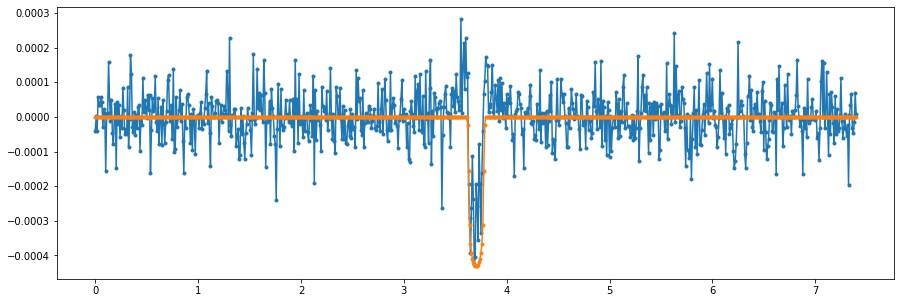

error en global=  0.9365516518987579
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


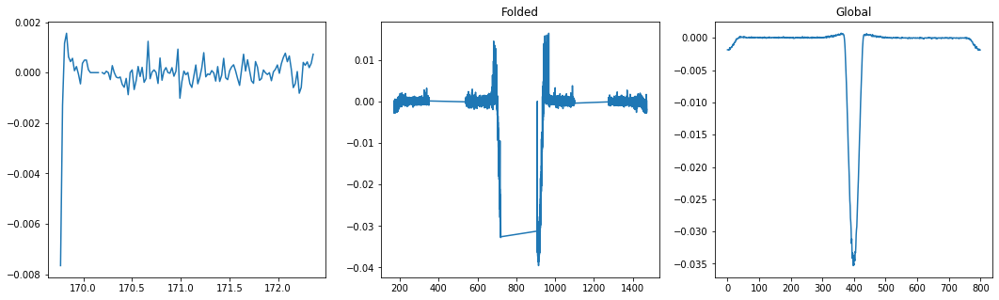

Max power:  0.11638245271927943
Second Max:  0.11315621281339945


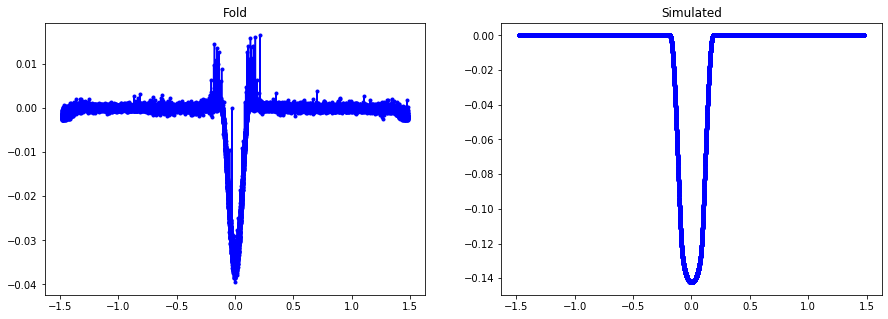

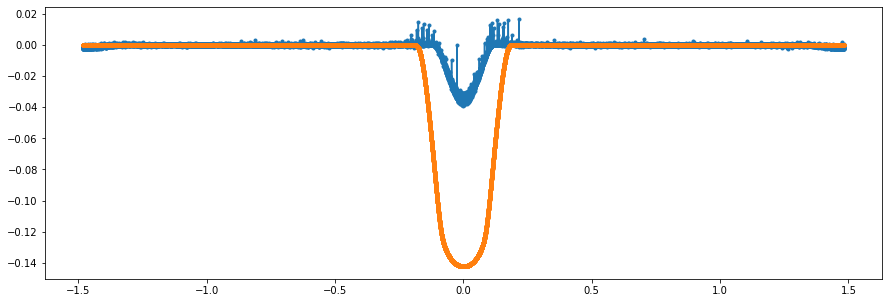

error en fold=  5.144557629500618


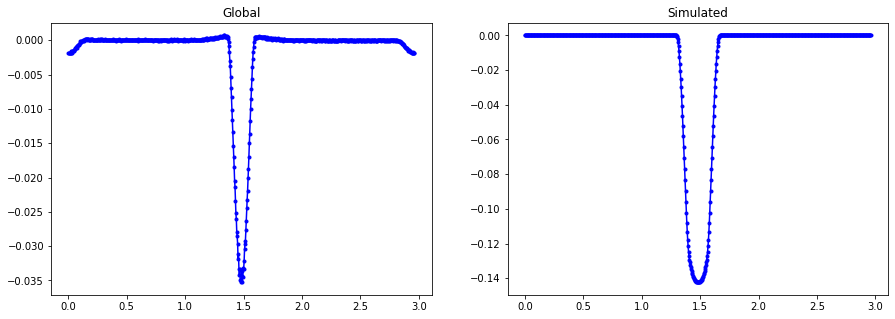

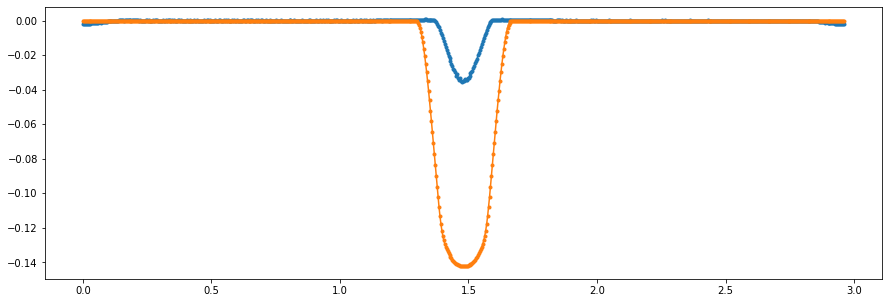

error en global=  5.161381713931545
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


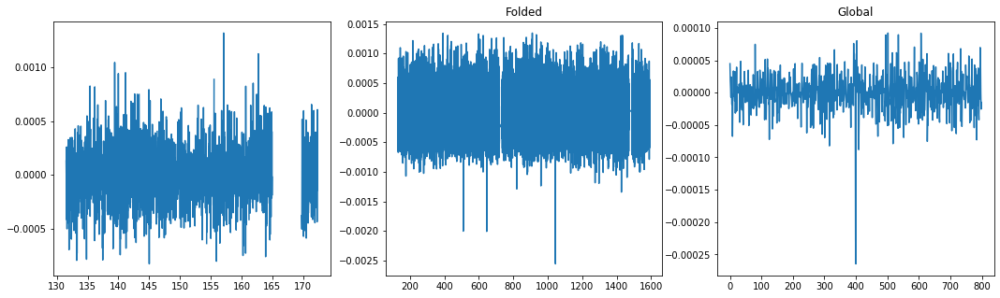

Max power:  0.0006184884943893931
Second Max:  0.0006093871387540331


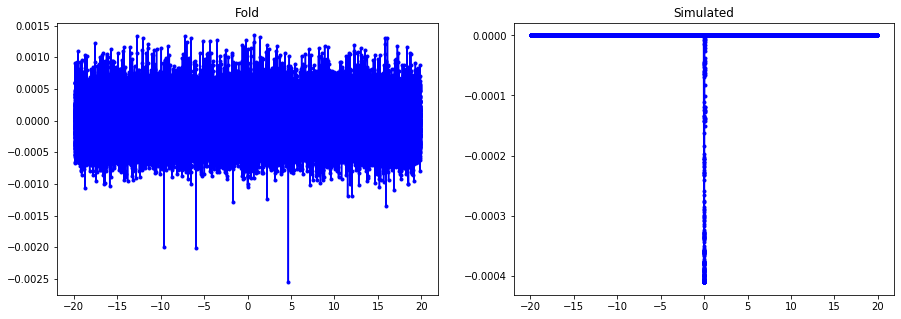

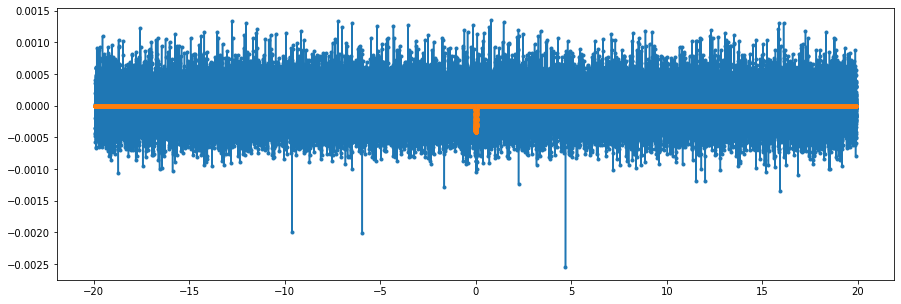

error en fold=  0.9988453391637228


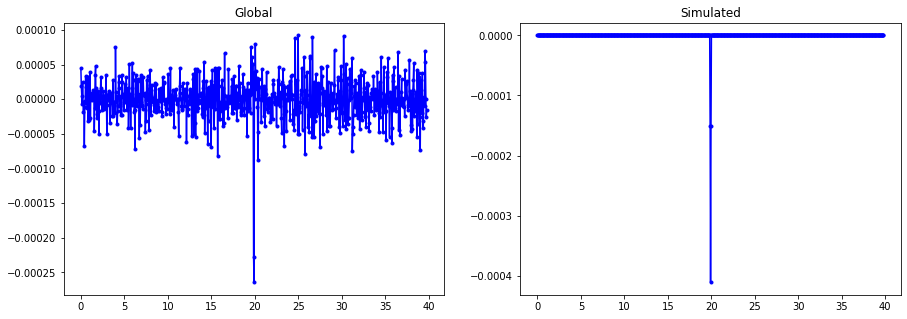

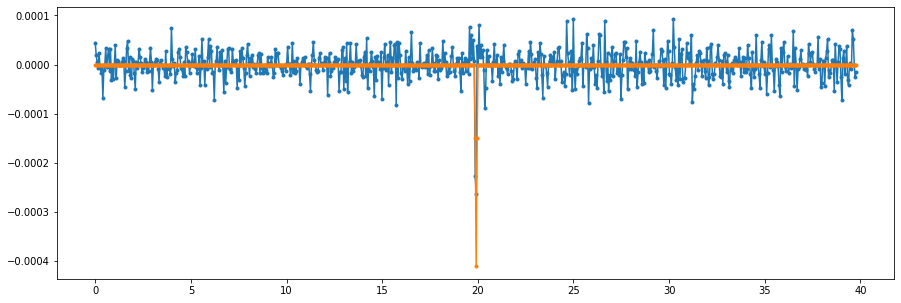

error en global=  0.9548673043482324
----------------------------------------------------------------
Dis score 0.998000, not transit flag 0.0 sec flag 0.0


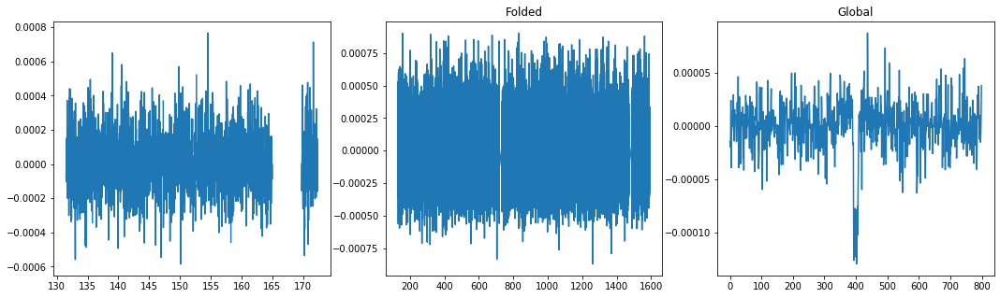

Max power:  0.0007281490914228746
Second Max:  0.0006579781862216147


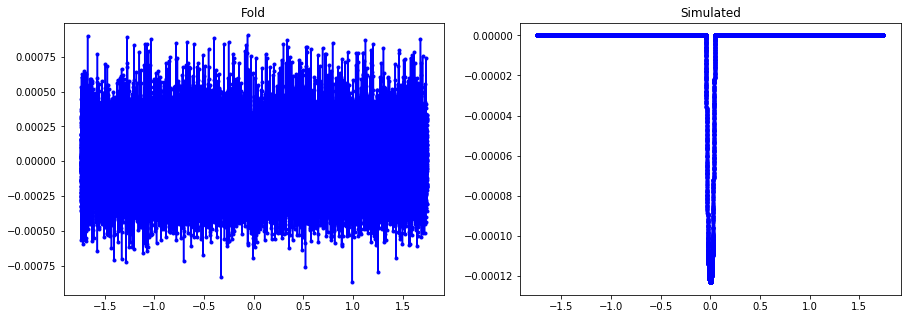

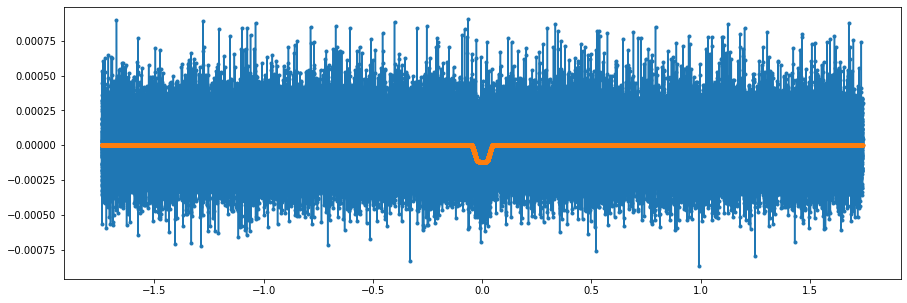

error en fold=  0.9970956873878598


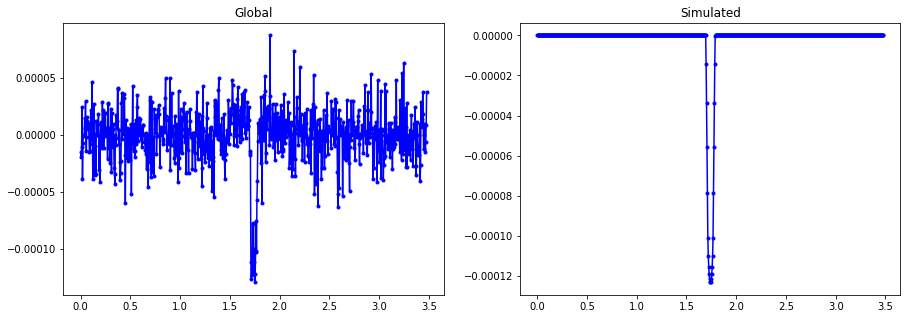

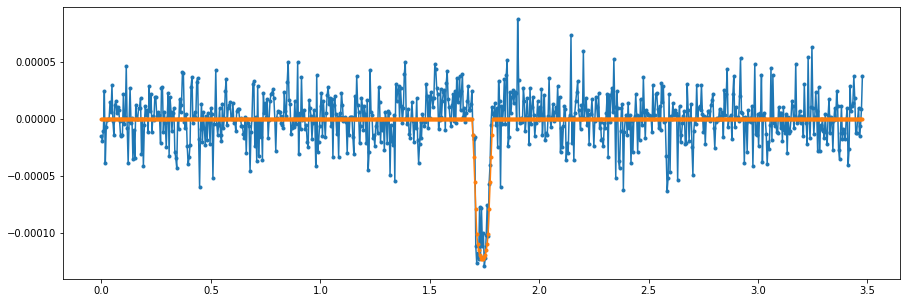

error en global=  0.8199222271597407
----------------------------------------------------------------
Dis score 0.523000, not transit flag 0.0 sec flag 0.0


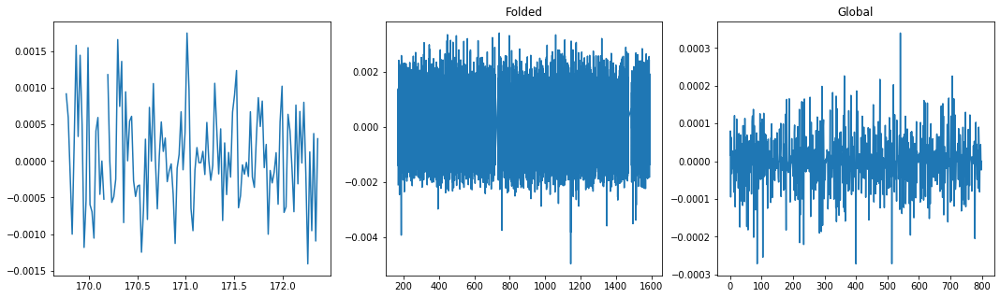

Max power:  0.000568892980995663
Second Max:  0.0005446354128675328


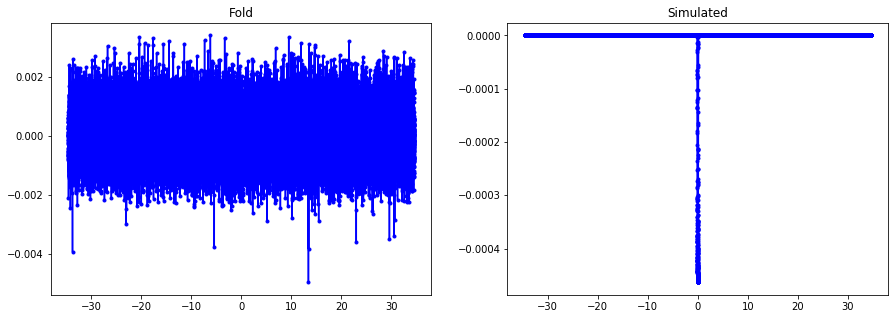

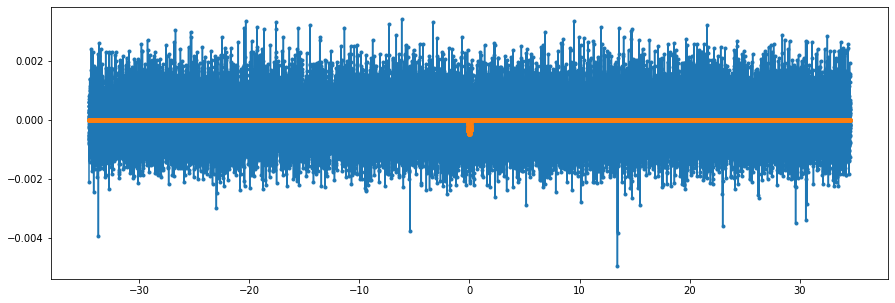

error en fold=  1.000129246606827


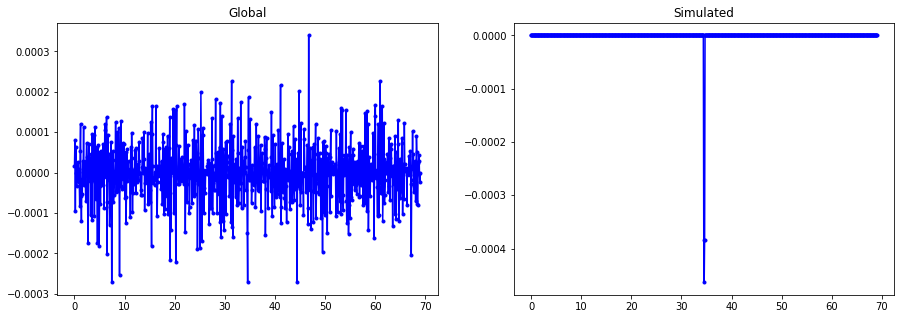

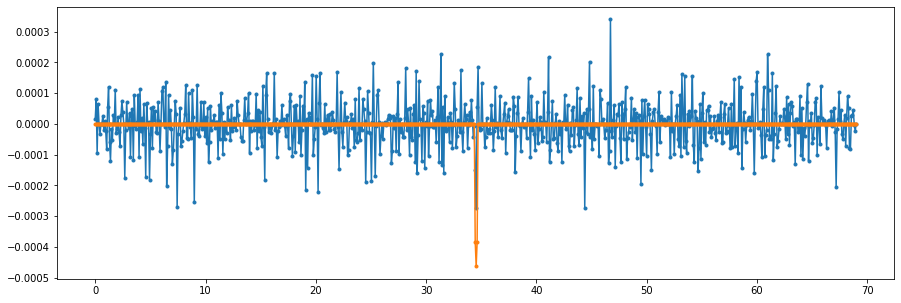

error en global=  1.0219527913948994
----------------------------------------------------------------
Dis score 0.384000, not transit flag 1.0 sec flag 0.0


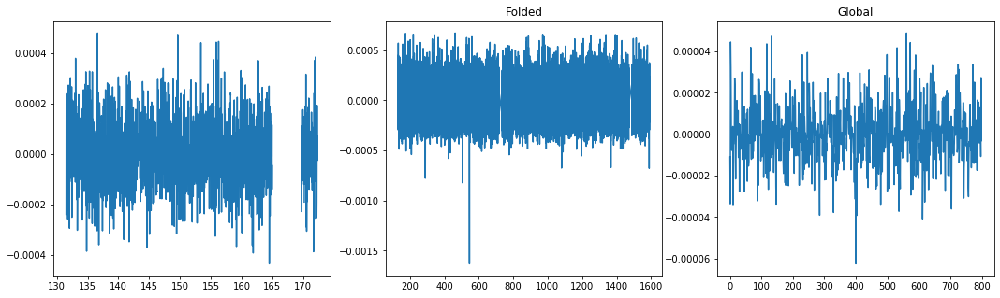

Max power:  0.0007327630873415184
Second Max:  0.0006611305224337145


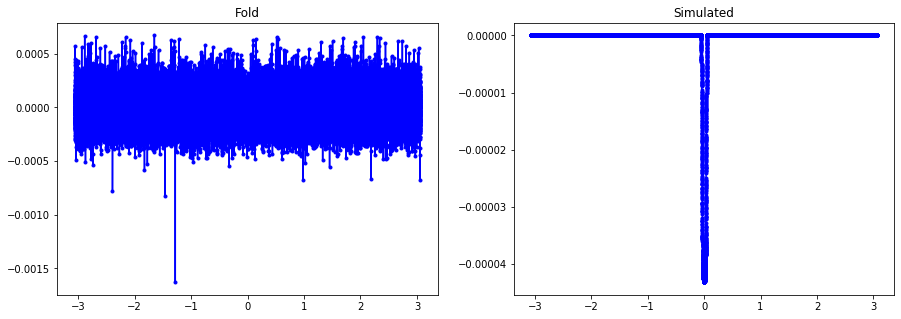

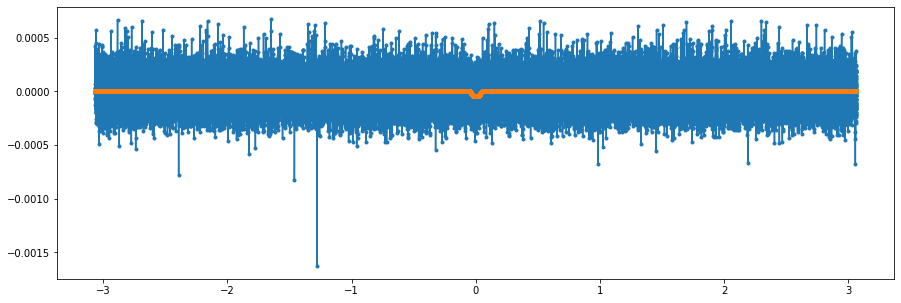

error en fold=  0.9998359068728377


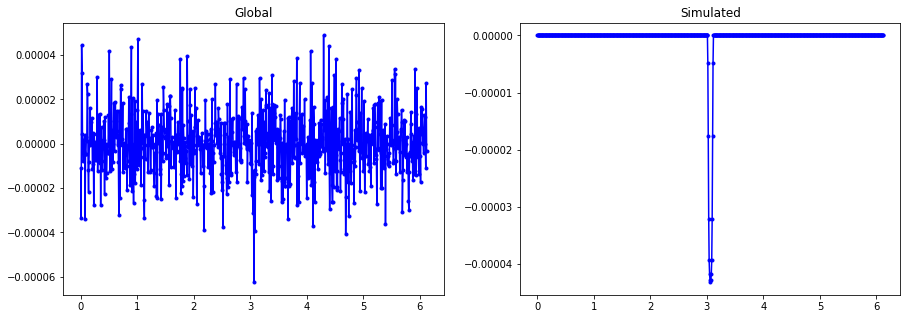

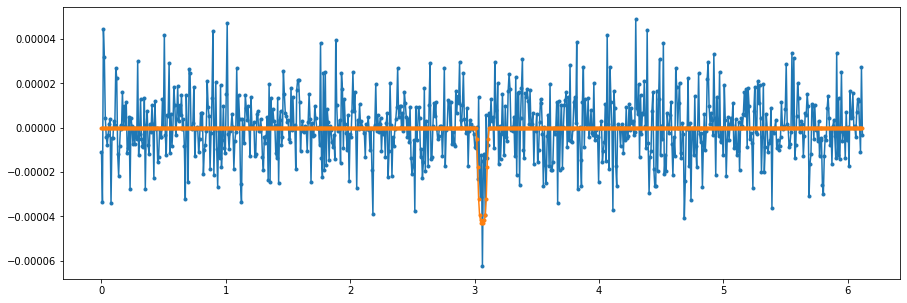

error en global=  0.995424705460917
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


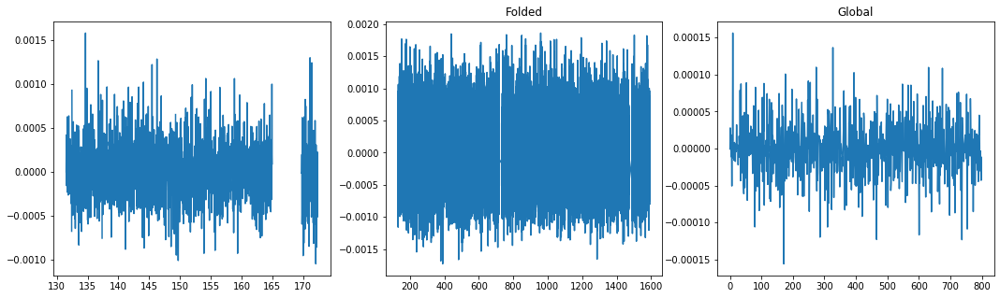

Max power:  0.0004796546419666989
Second Max:  0.0004602537597826177


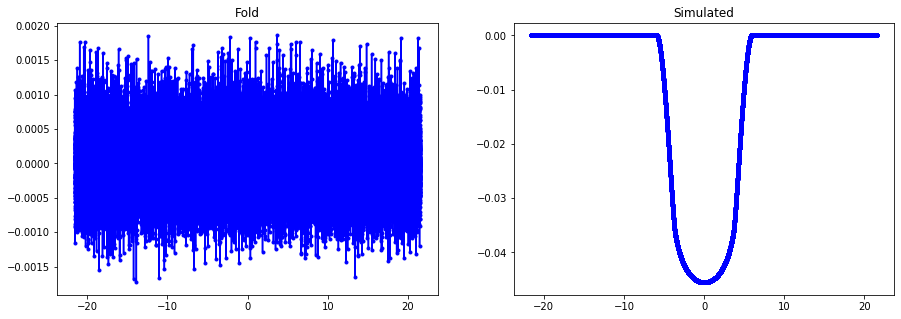

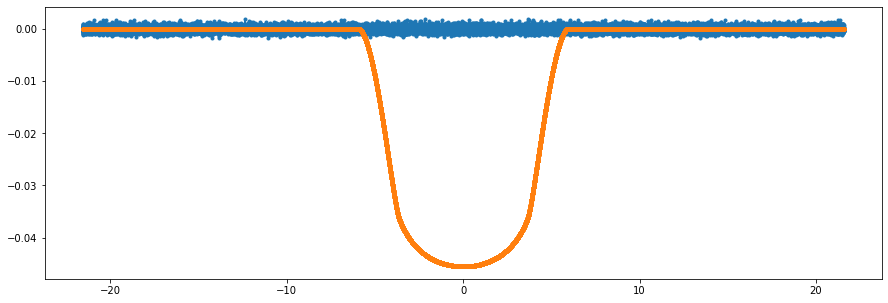

error en fold=  50.664387169654596


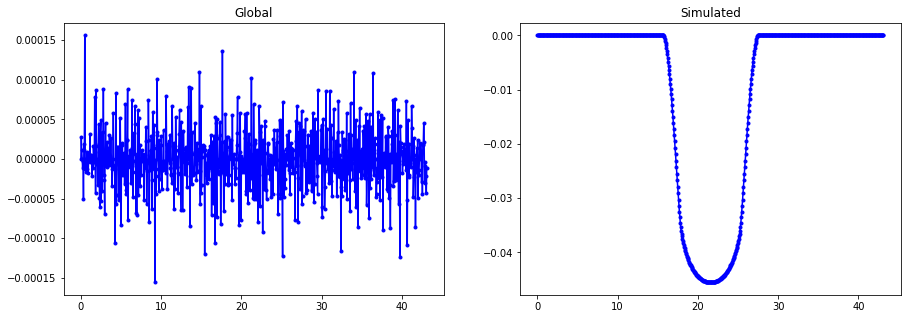

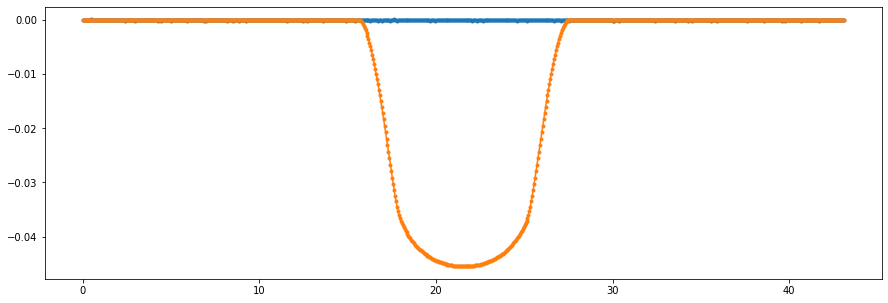

error en global=  517.6161602705195
----------------------------------------------------------------
Dis score 0.976000, not transit flag 0.0 sec flag 0.0


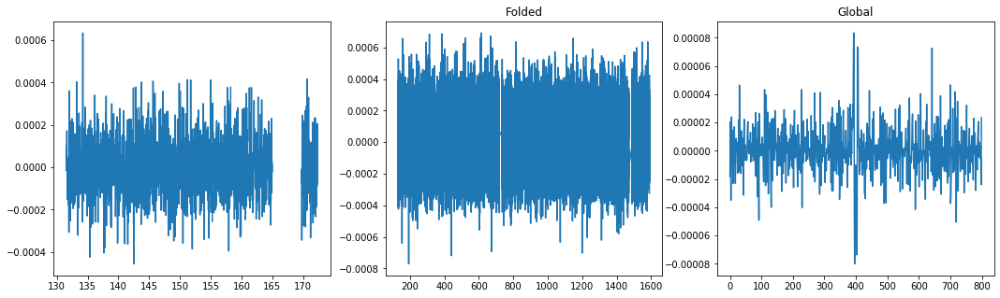

Max power:  0.0006236445989883792
Second Max:  0.0005737523449987033


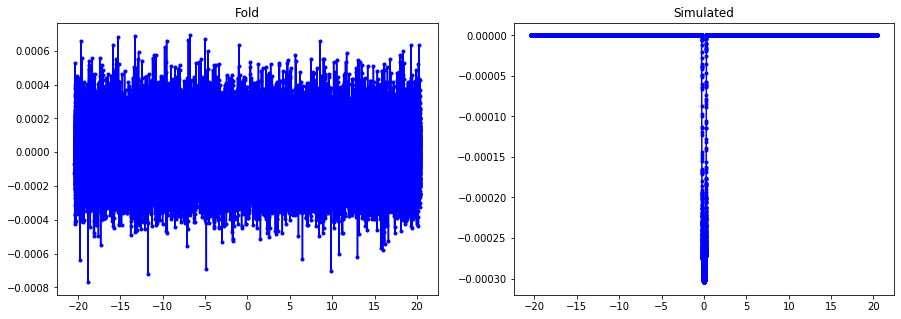

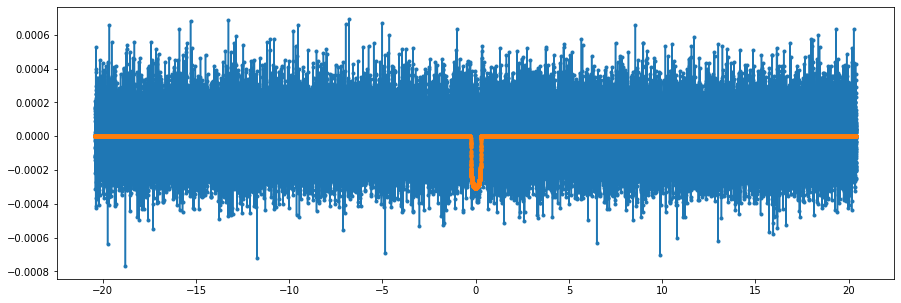

error en fold=  1.0169557463531682


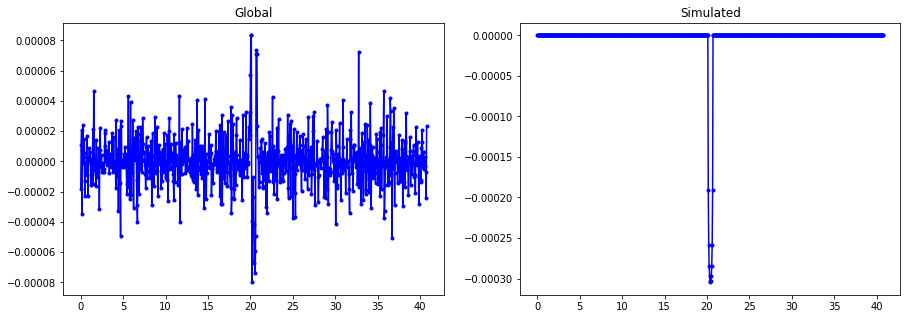

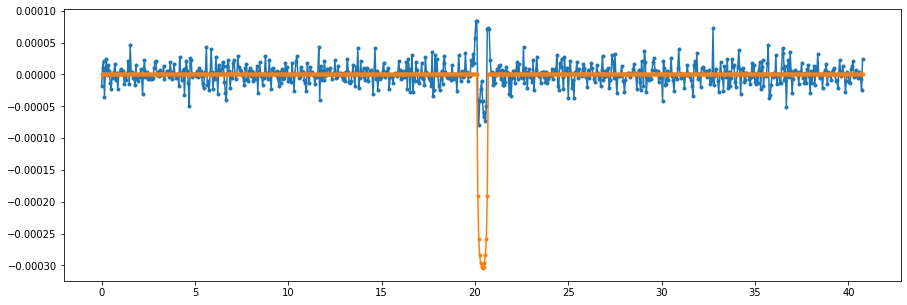

error en global=  1.881065142034544
----------------------------------------------------------------
Dis score 0.991000, not transit flag 0.0 sec flag 0.0


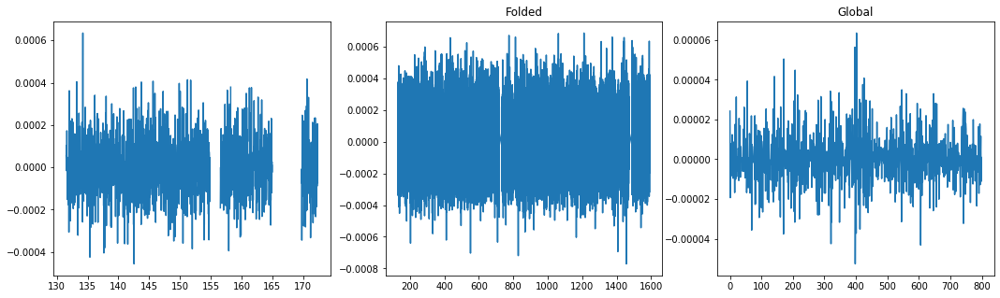

Max power:  0.0006397516260969692
Second Max:  0.0006146459175029697


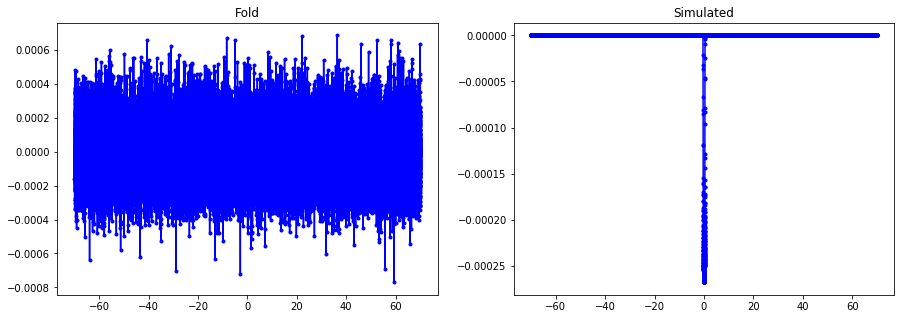

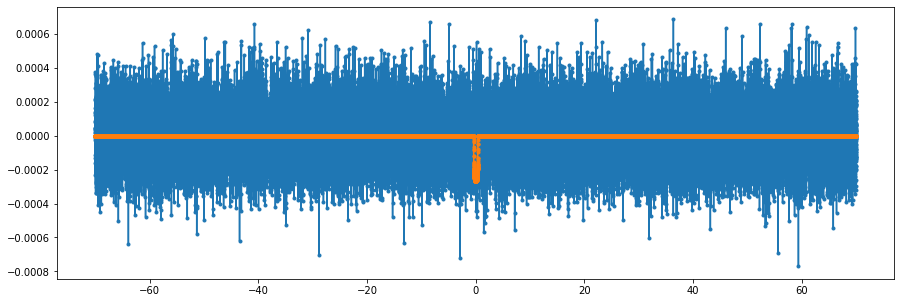

error en fold=  1.0056129902896291


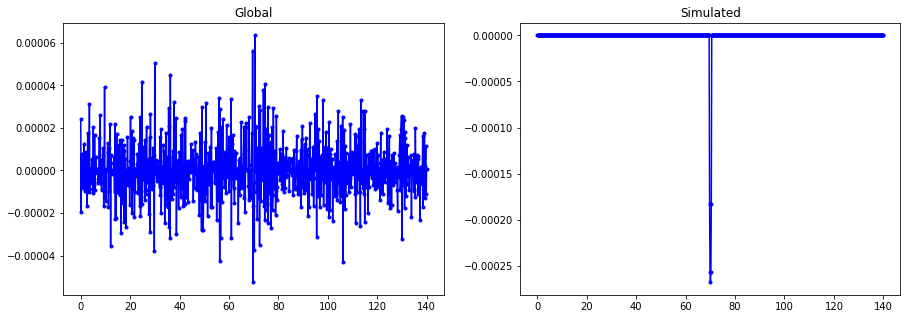

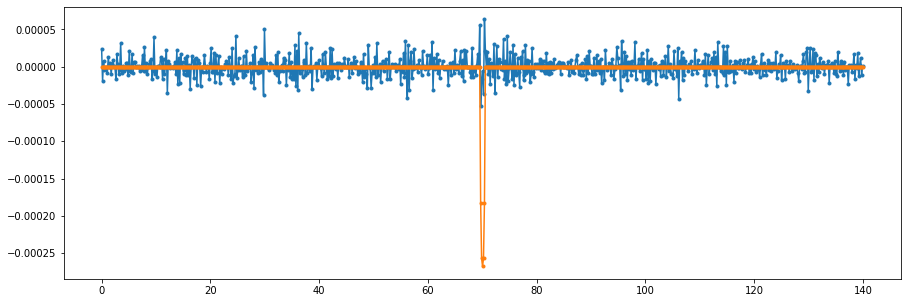

error en global=  1.6472292144729899
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


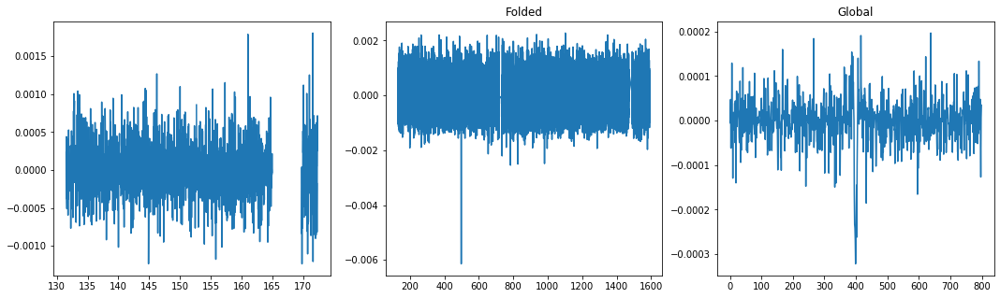

Max power:  0.0005431892882967472
Second Max:  0.00048701510206053064


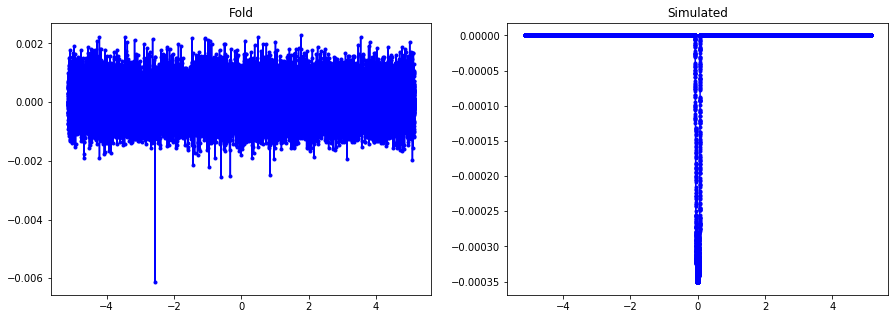

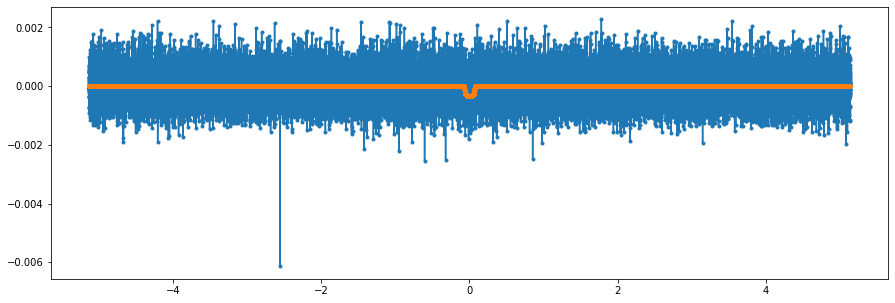

error en fold=  0.9989848949283384


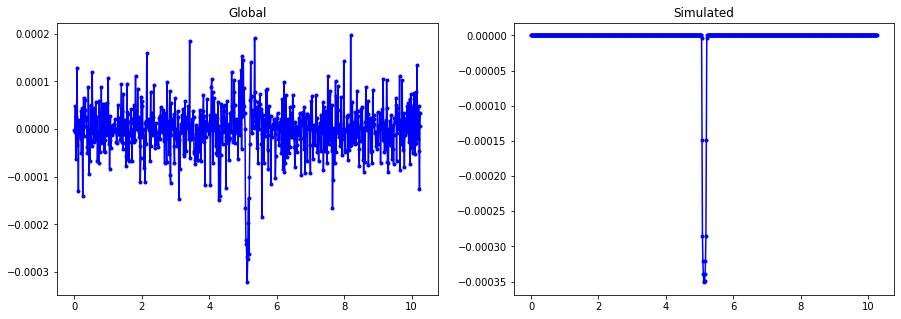

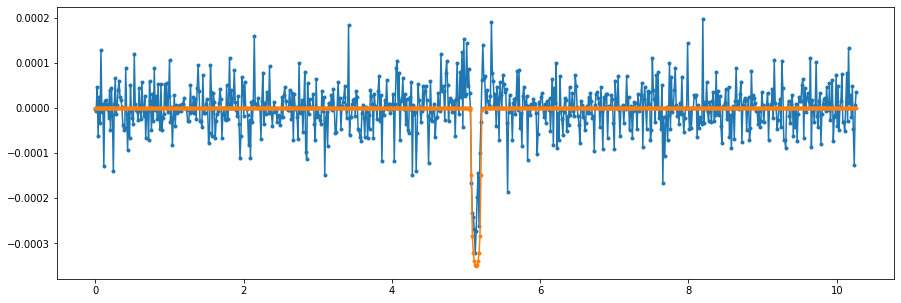

error en global=  0.9106924709279642
----------------------------------------------------------------
Dis score 0.998000, not transit flag 0.0 sec flag 0.0


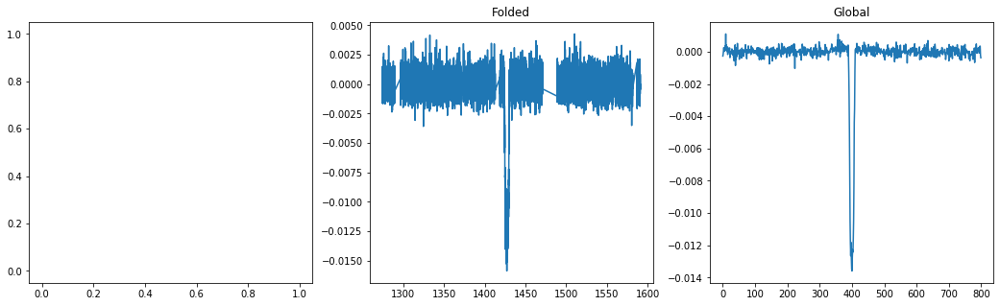

Max power:  0.037736276628771104
Second Max:  0.03652701505412664


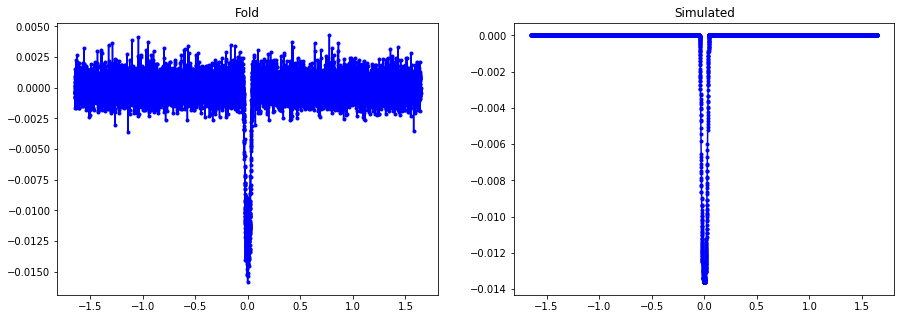

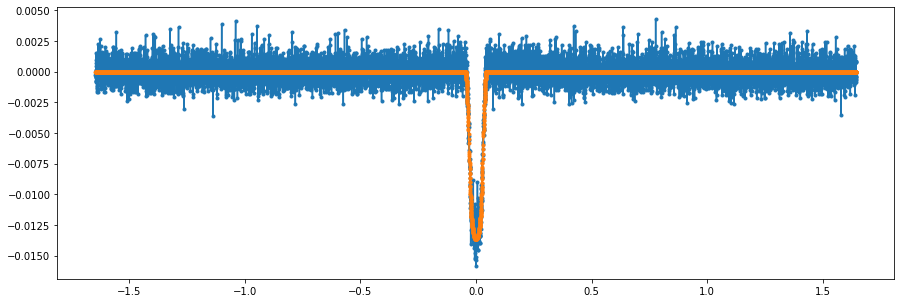

error en fold=  0.45047657026025456


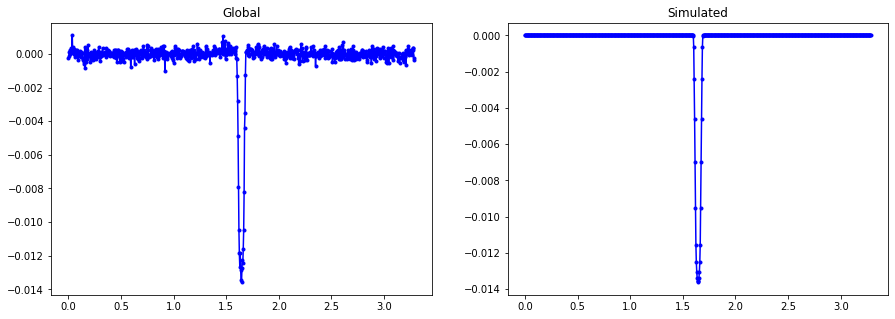

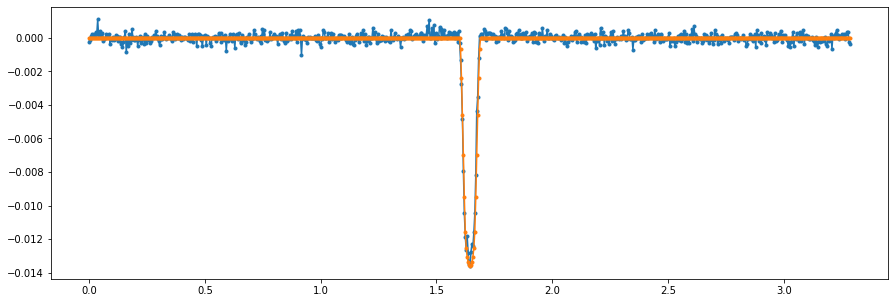

error en global=  0.18103056340152587
----------------------------------------------------------------
Dis score 0.952000, not transit flag 0.0 sec flag 0.0


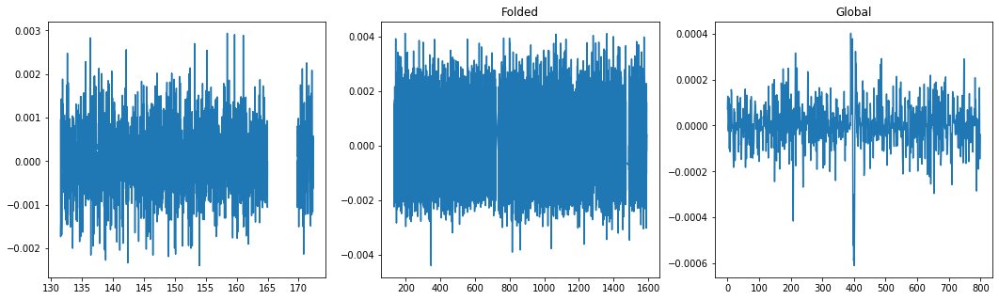

Max power:  0.00046015766269156465
Second Max:  0.000459977118293751


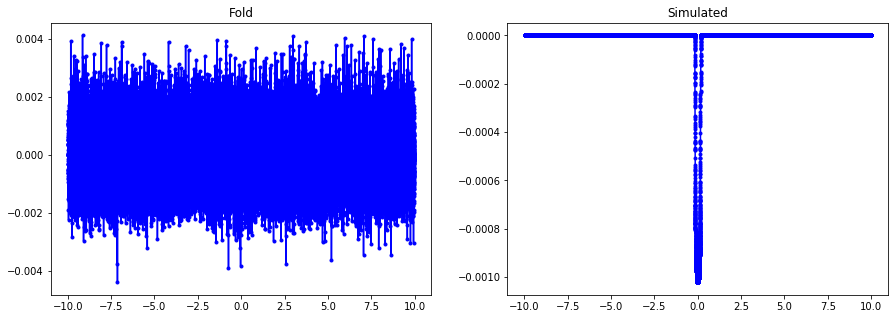

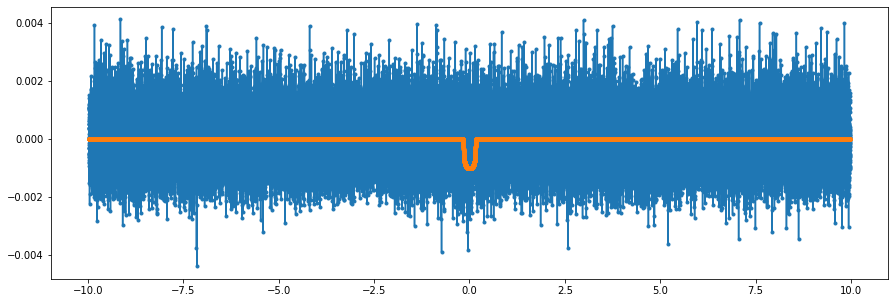

error en fold=  1.0063140972601812


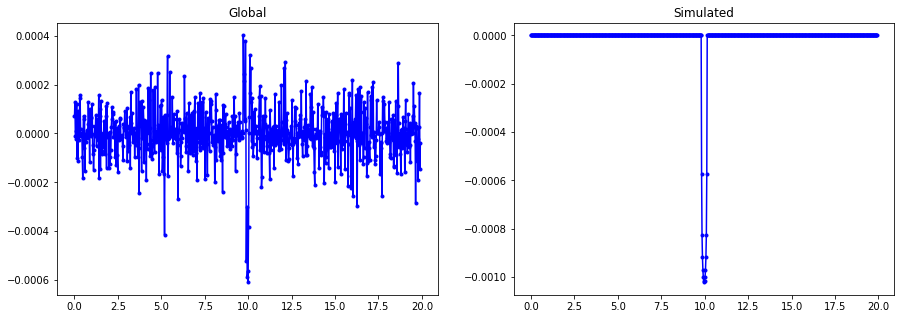

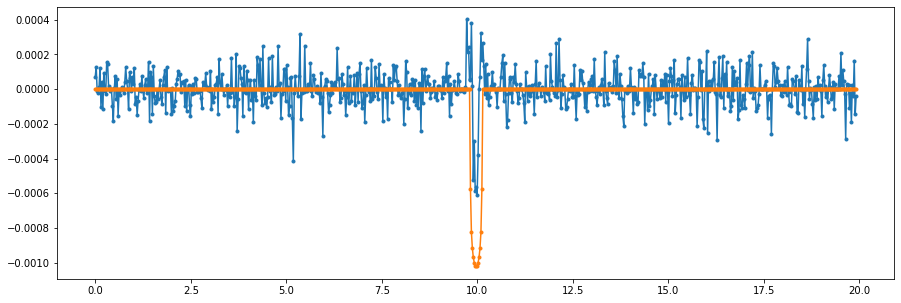

error en global=  1.3237547517180797
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


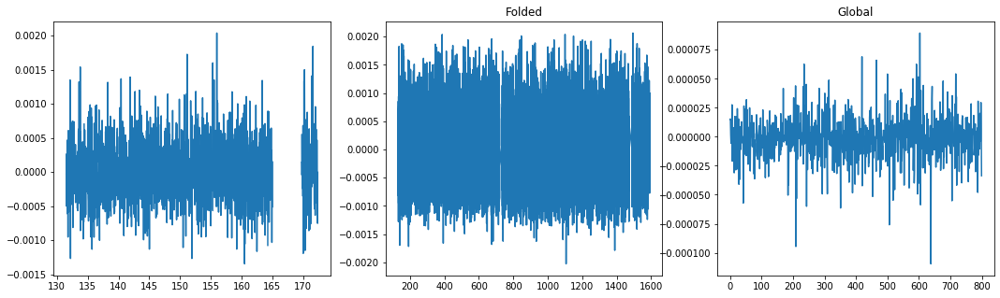

Max power:  0.0005440845571672649
Second Max:  0.0005082818417898071


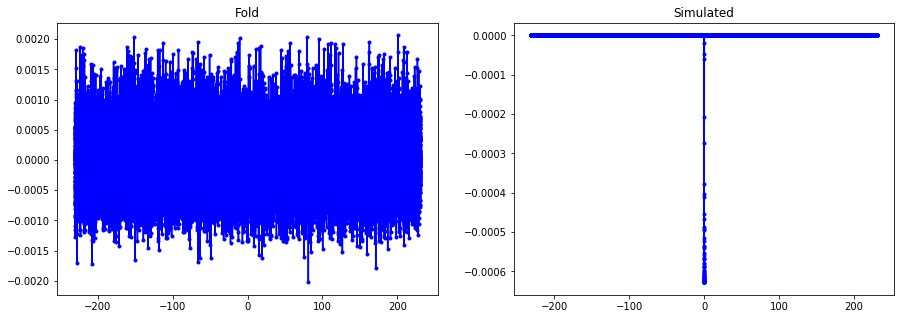

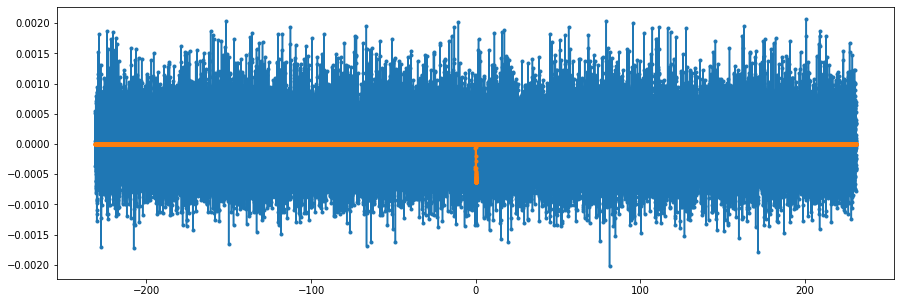

error en fold=  1.0006020568337943


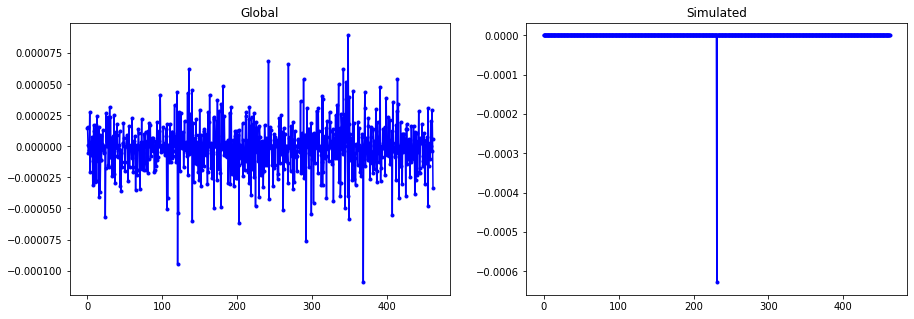

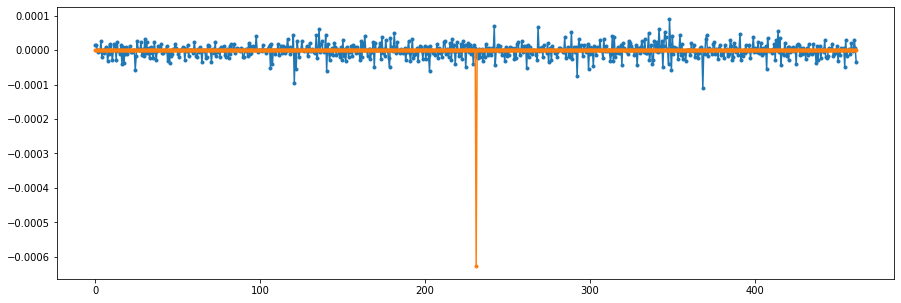

error en global=  1.4985602105872255
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


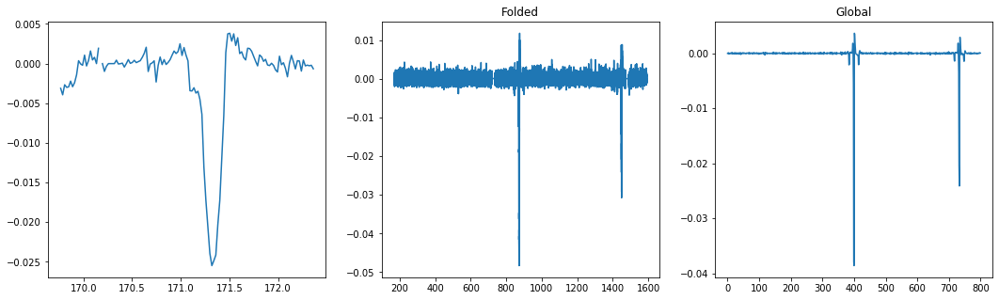

Max power:  0.012544588990666856
Second Max:  0.011878920336271807


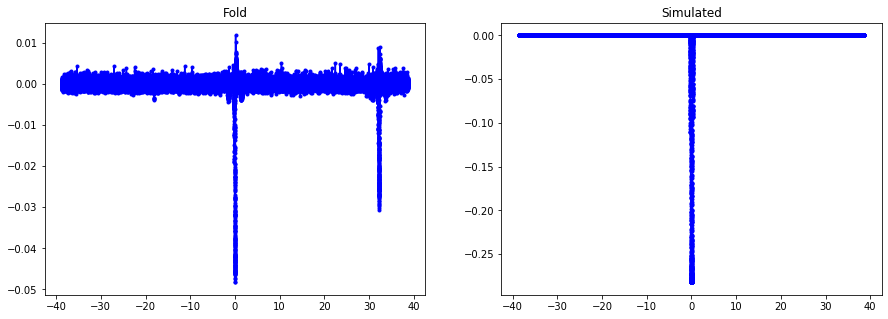

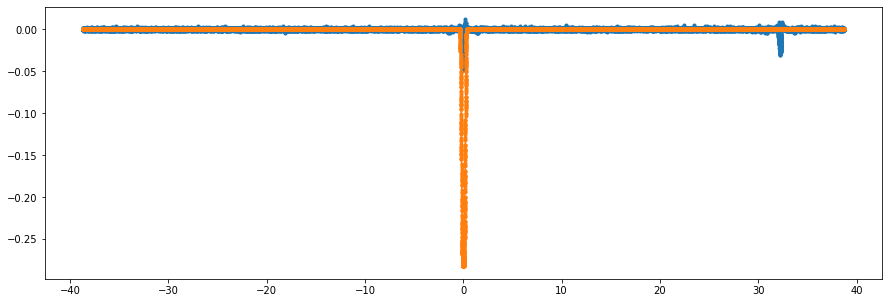

error en fold=  7.154807358278482


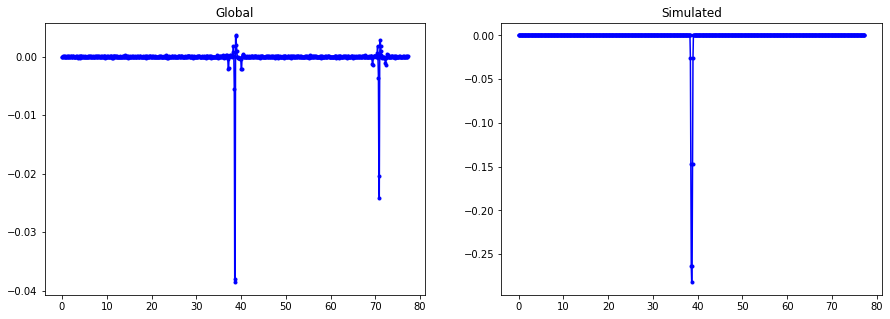

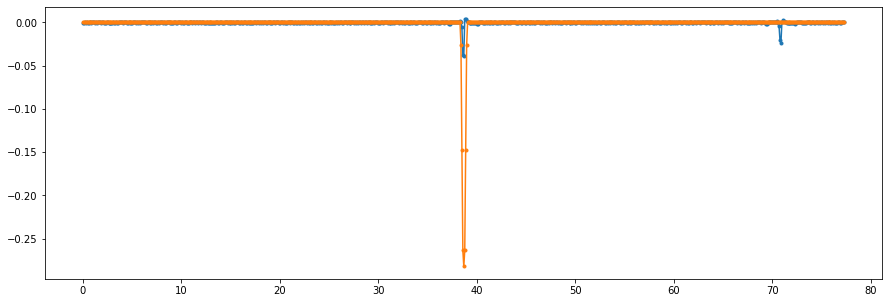

error en global=  7.51108436997002
----------------------------------------------------------------
Dis score 0.999000, not transit flag 0.0 sec flag 0.0


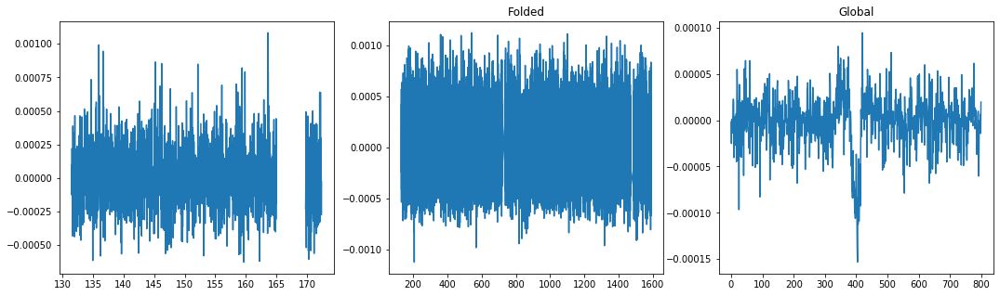

Max power:  0.0012251507884021816
Second Max:  0.001163573348742057


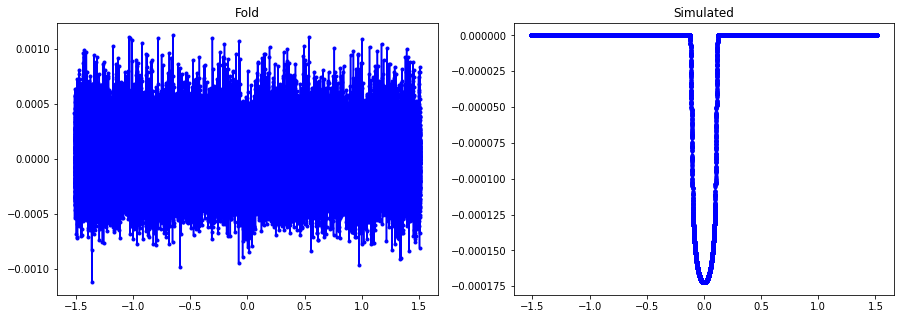

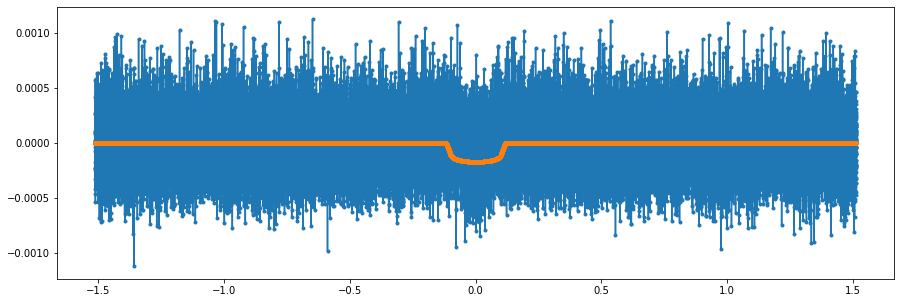

error en fold=  1.0094561325702638


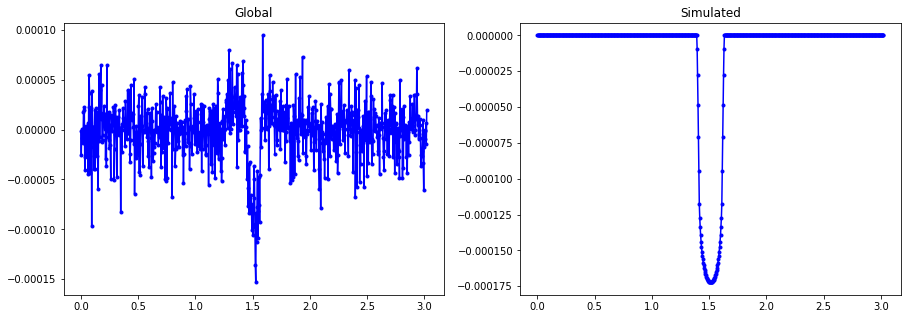

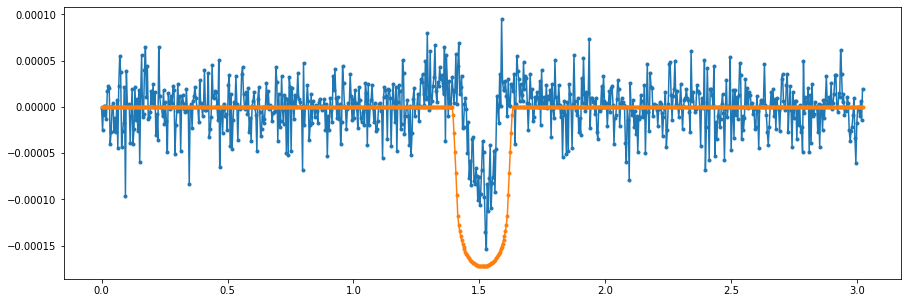

error en global=  1.4389275018001177
----------------------------------------------------------------
Dis score 0.922000, not transit flag 0.0 sec flag 0.0


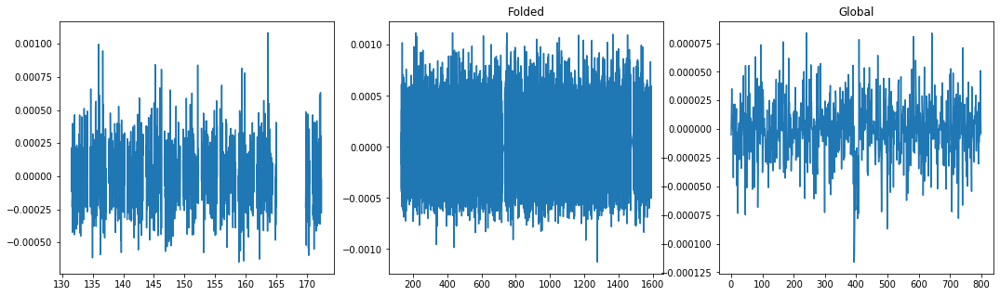

Max power:  0.0005988795278643078
Second Max:  0.0005847955921945293


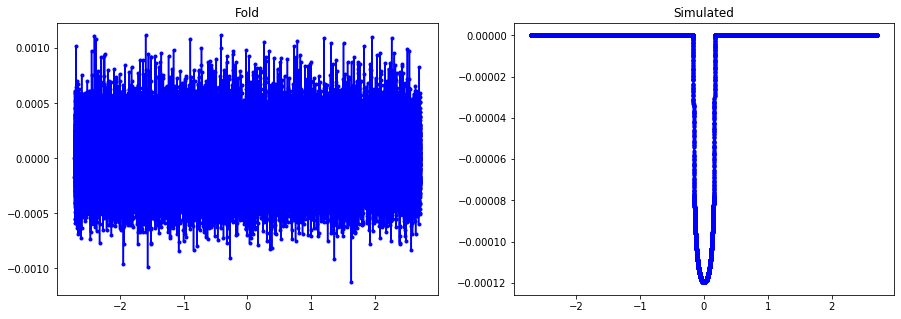

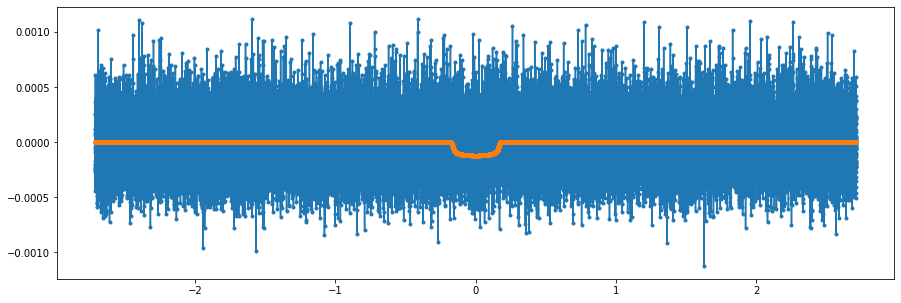

error en fold=  1.0055457074724286


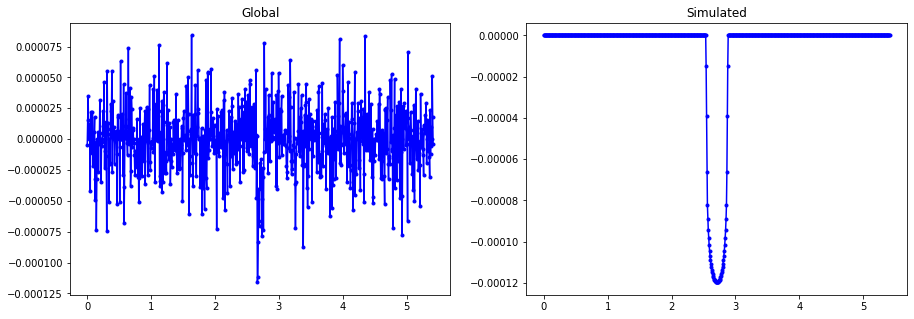

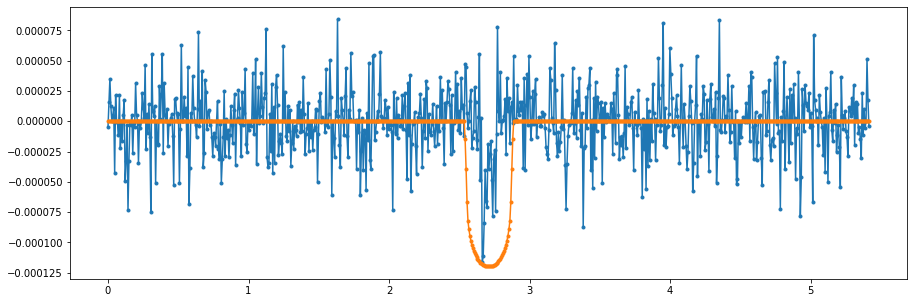

error en global=  1.3169053642865958
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


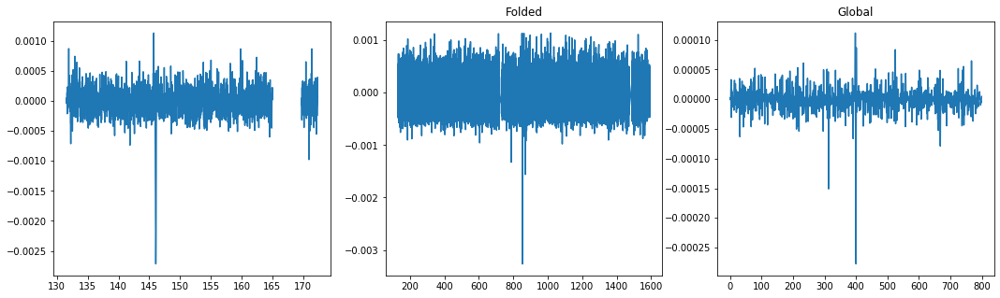

Max power:  0.0007093190212452581
Second Max:  0.0006814906909922287


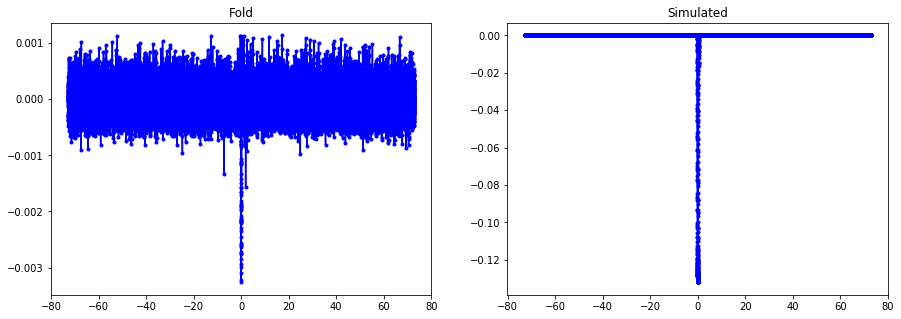

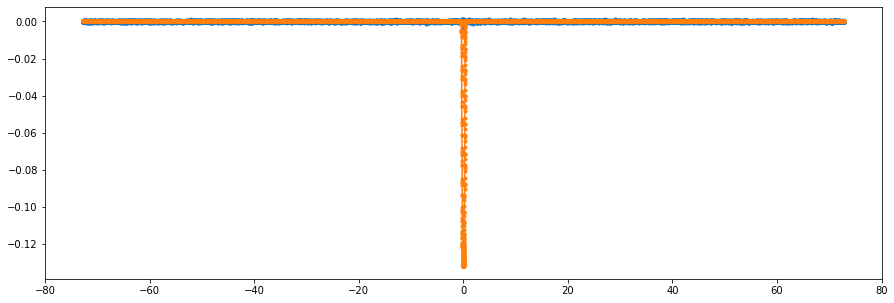

error en fold=  29.98396753733266


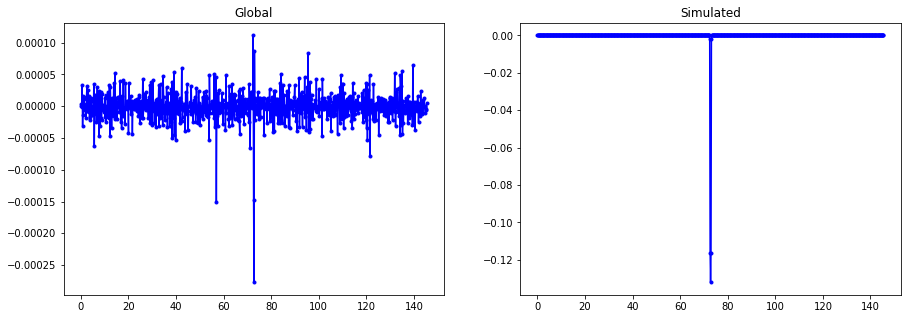

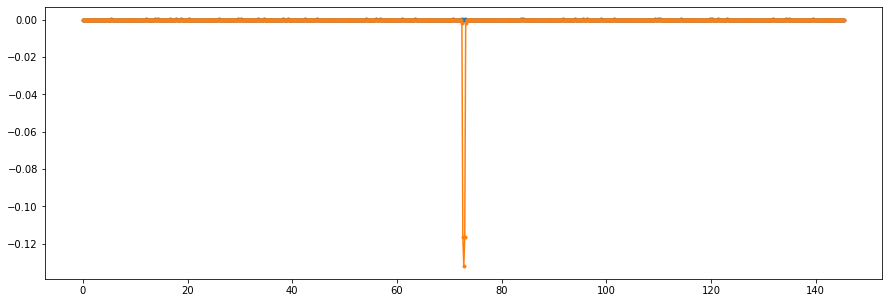

error en global=  318.1583545212436
----------------------------------------------------------------
Dis score 0.058000, not transit flag 1.0 sec flag 0.0


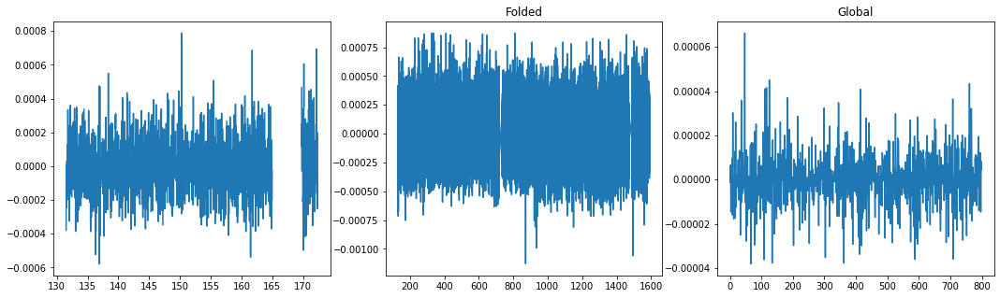

Max power:  0.000894330550175626
Second Max:  0.0008770065951101656


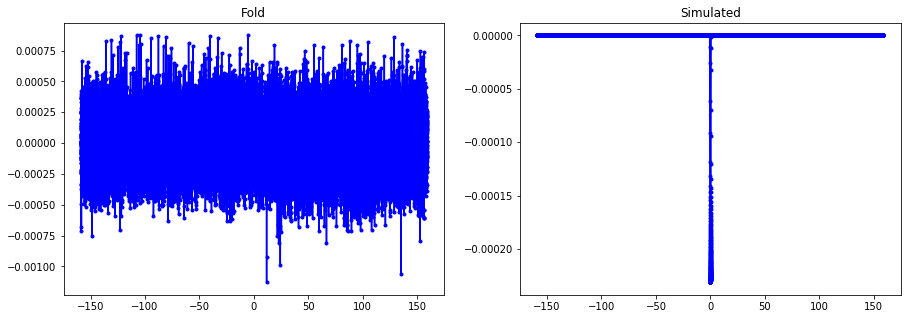

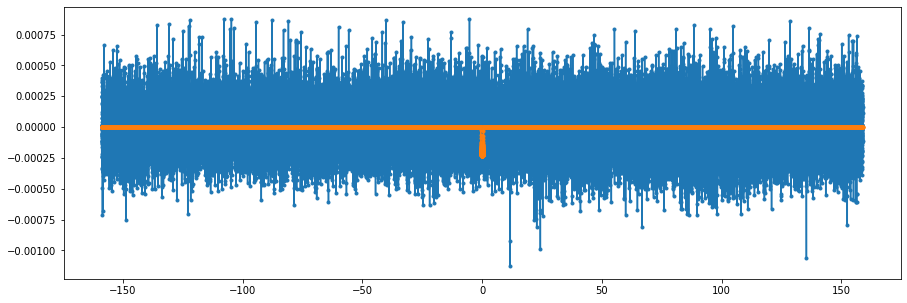

error en fold=  1.0030266902717722


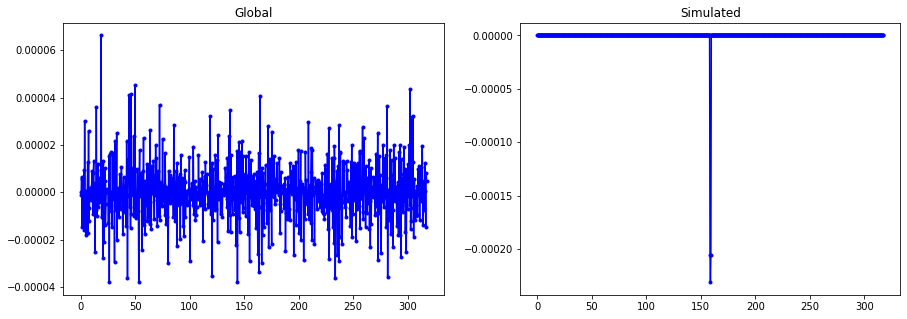

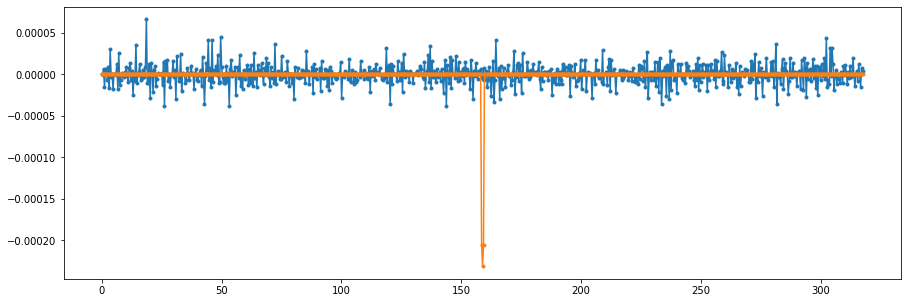

error en global=  1.4671401513296949
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


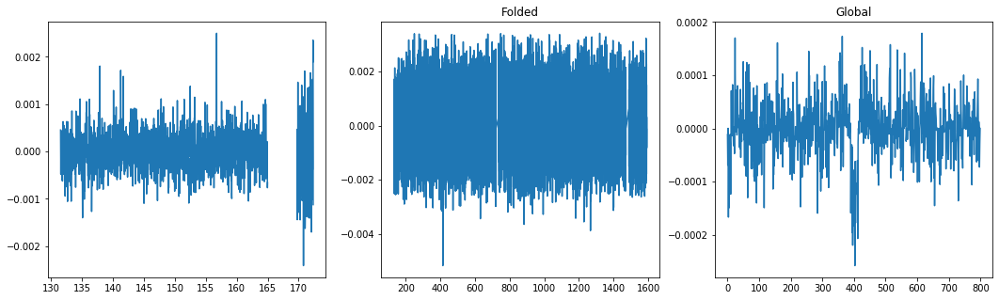

Max power:  0.0008547992135237212
Second Max:  0.0007697441949798849


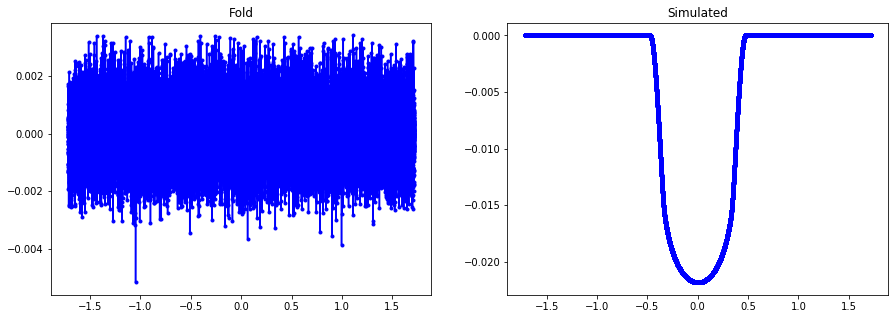

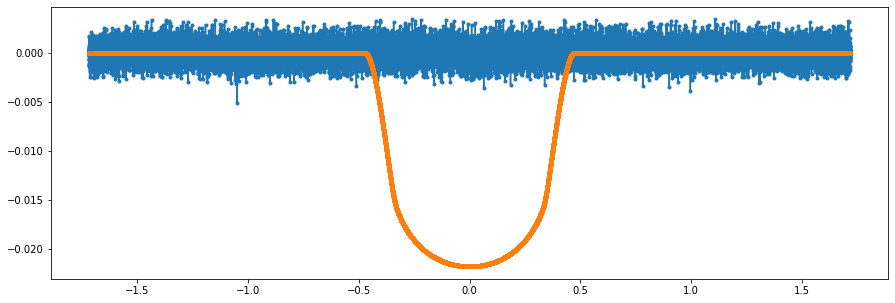

error en fold=  13.629127793113966


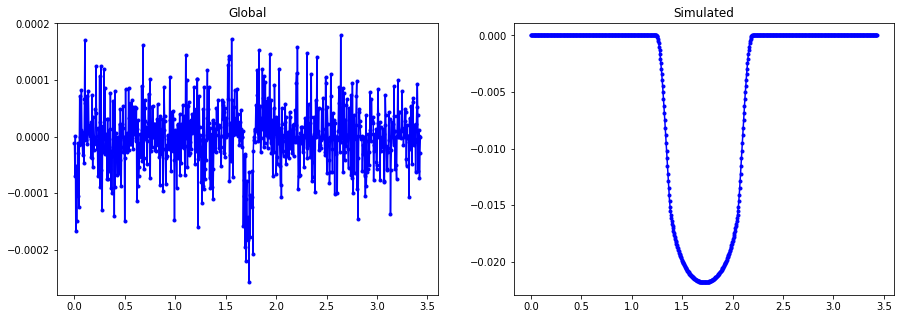

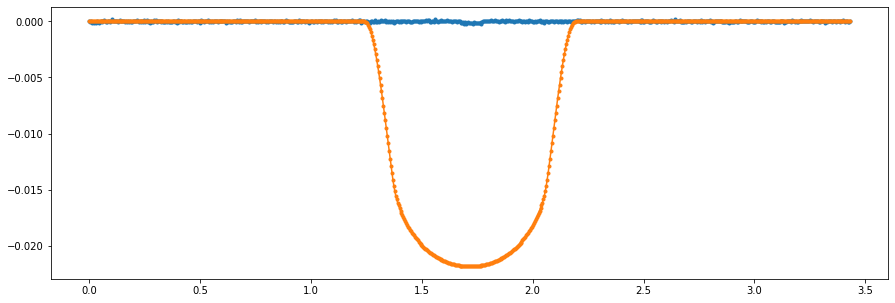

error en global=  165.64599219563732
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


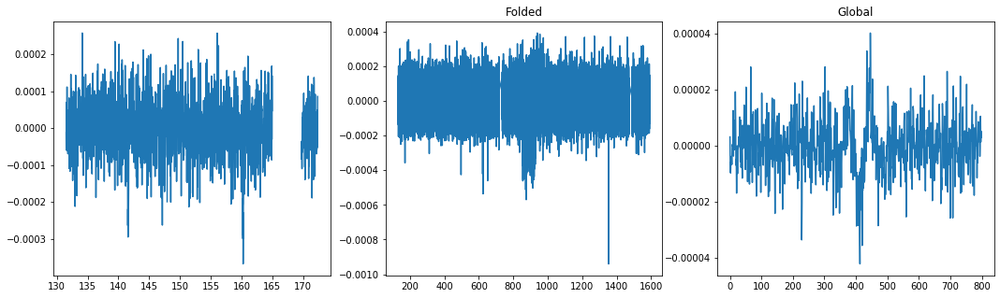

Max power:  0.006578964731627713
Second Max:  0.006173592813683205


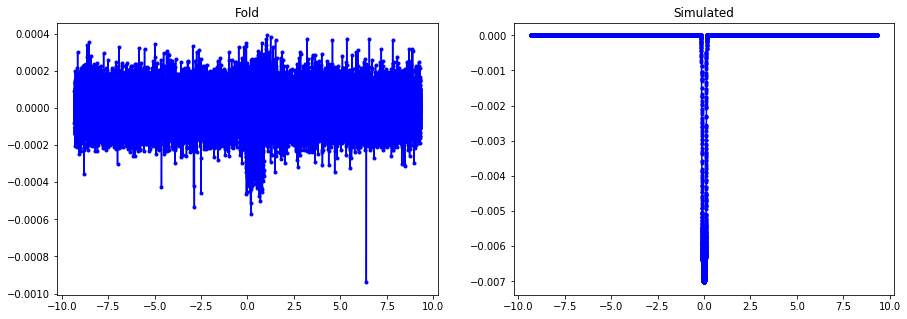

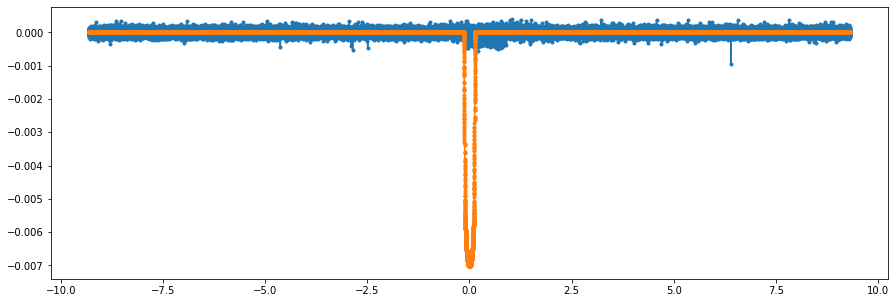

error en fold=  9.479431421548467


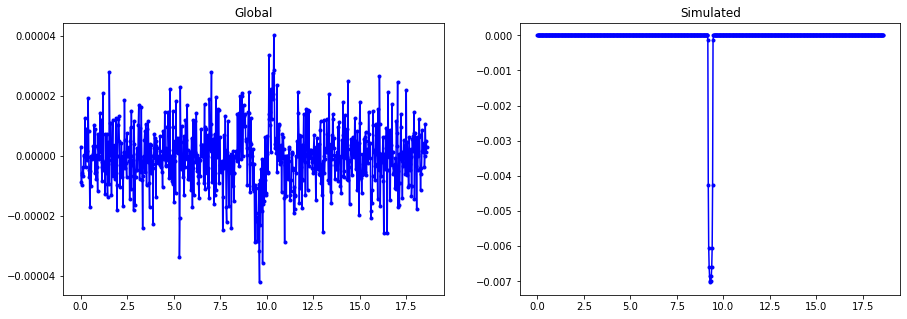

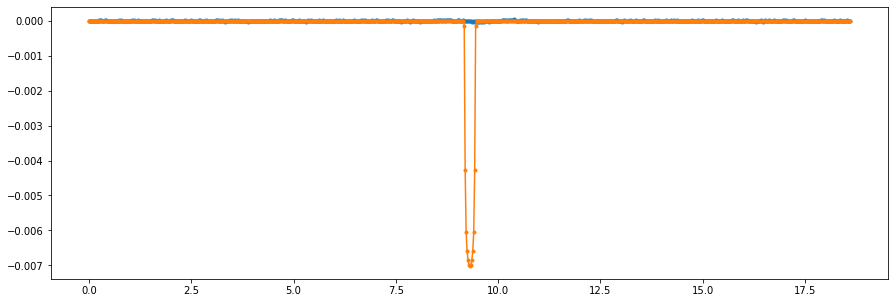

error en global=  74.99590624007071
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


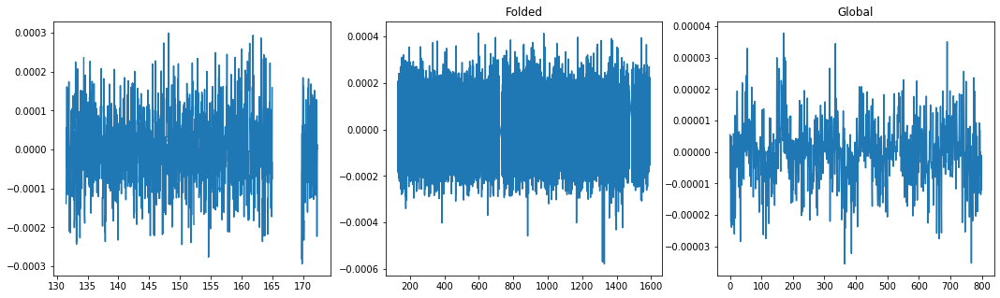

Max power:  0.0026580607704996977
Second Max:  0.0025488565415852124


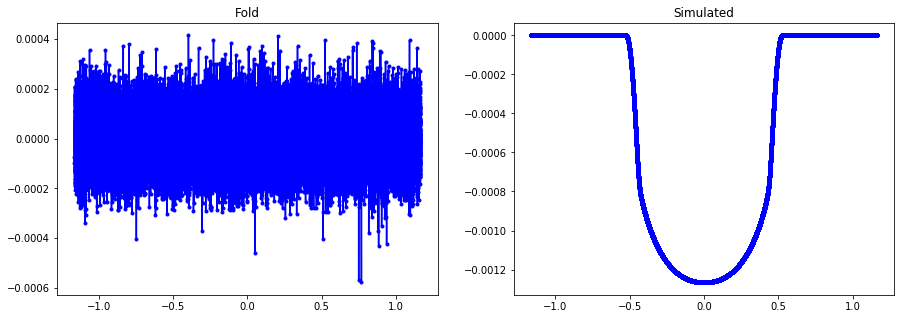

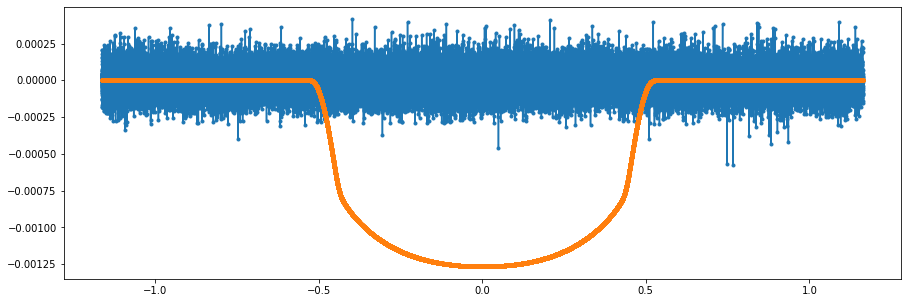

error en fold=  8.588421298633905


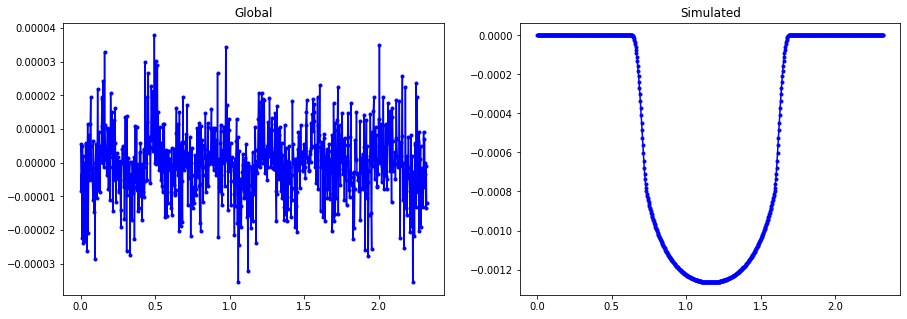

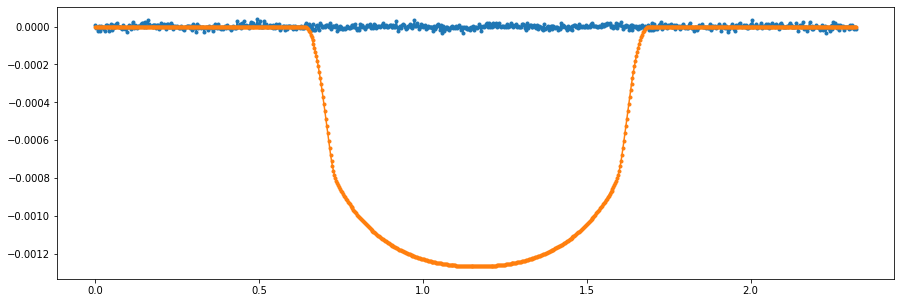

error en global=  68.77059803541444
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


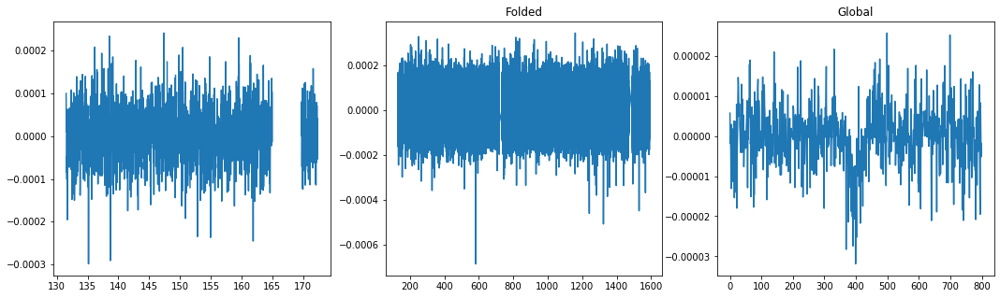

Max power:  0.0007976228838639683
Second Max:  0.00071552216018204


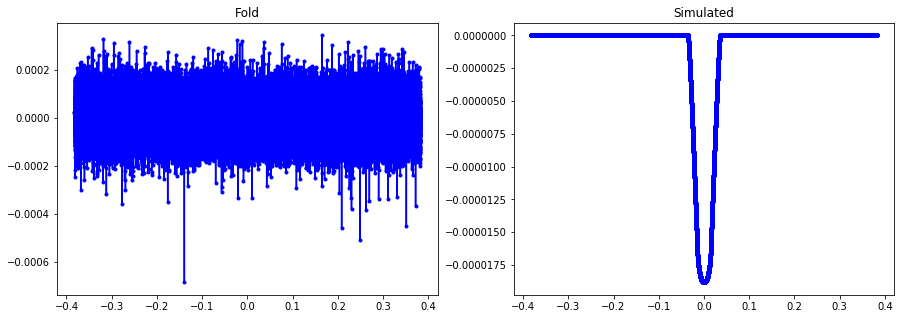

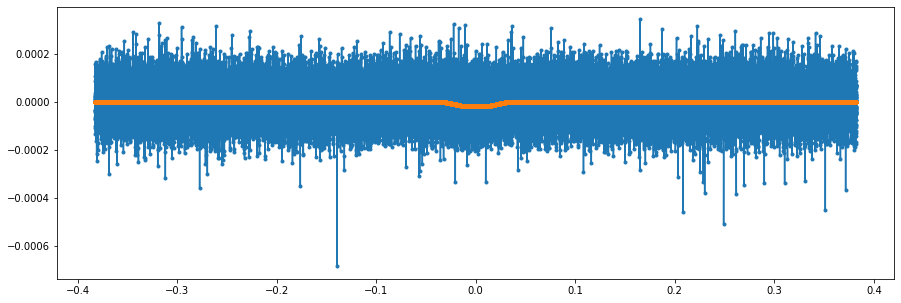

error en fold=  0.9994334940864141


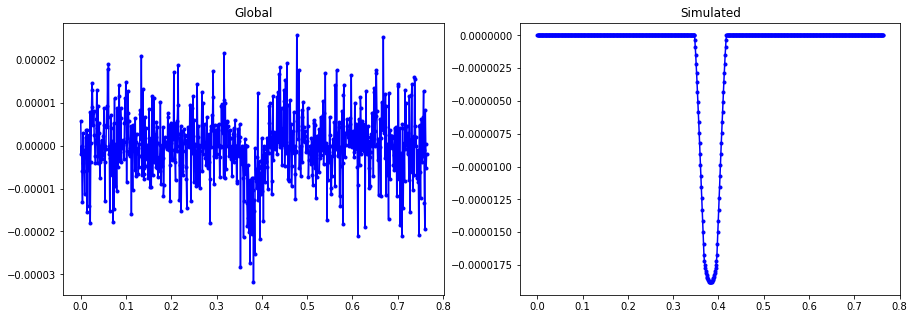

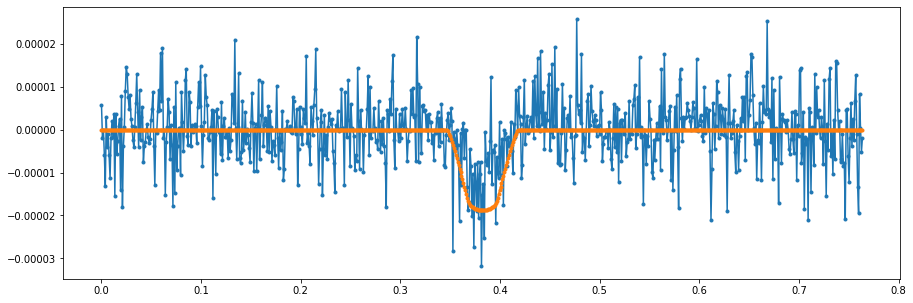

error en global=  0.9713751210944069
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


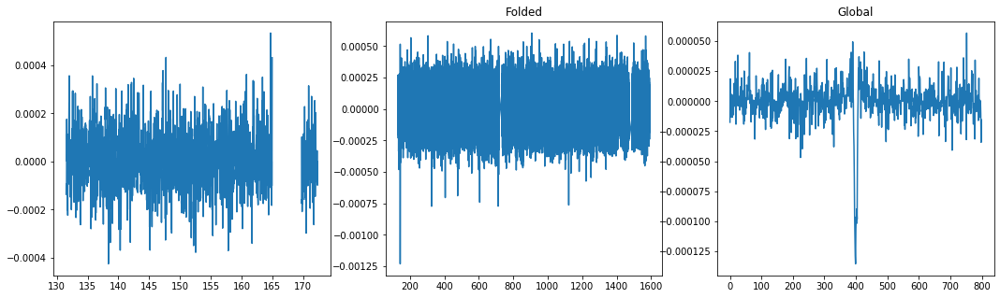

Max power:  0.003648157529316604
Second Max:  0.003299005948883725


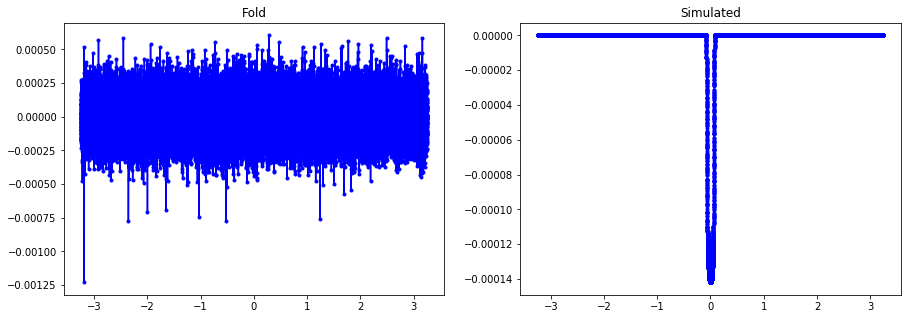

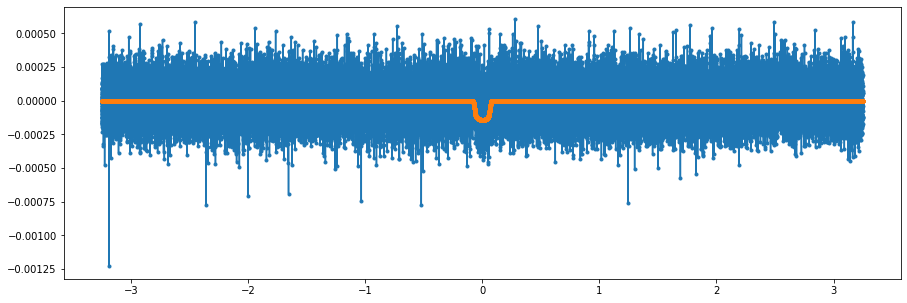

error en fold=  0.9986853998152185


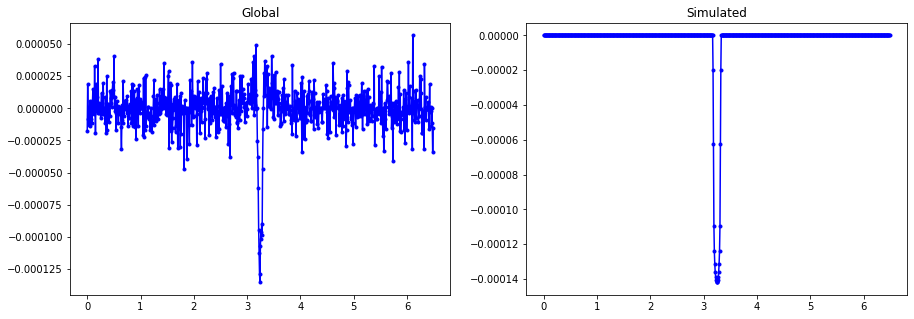

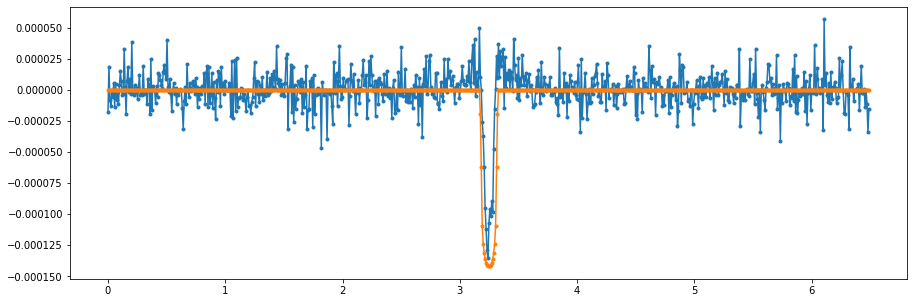

error en global=  0.9160909030322519
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


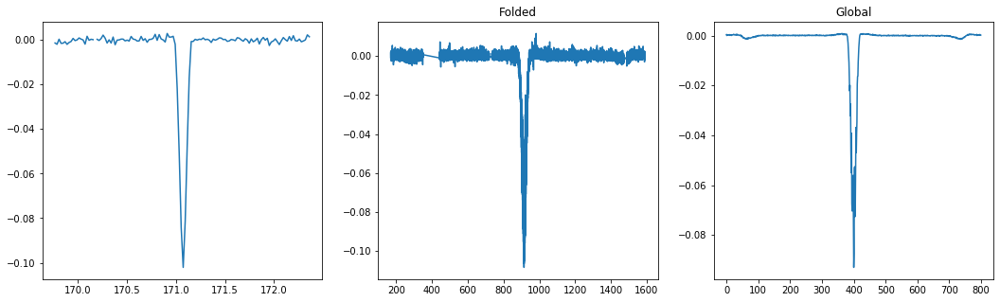

Max power:  0.06403792929605552
Second Max:  0.060292990255863224


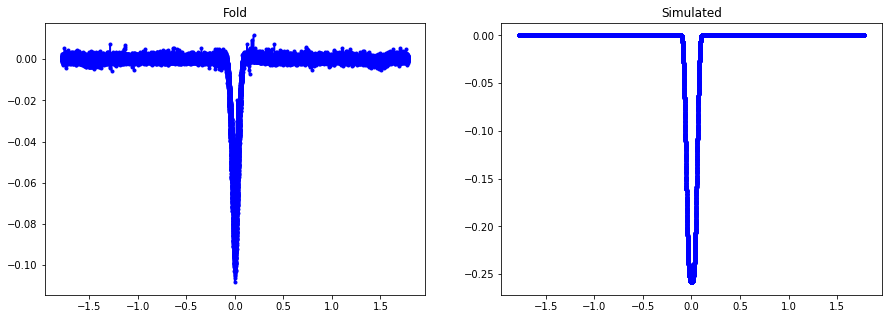

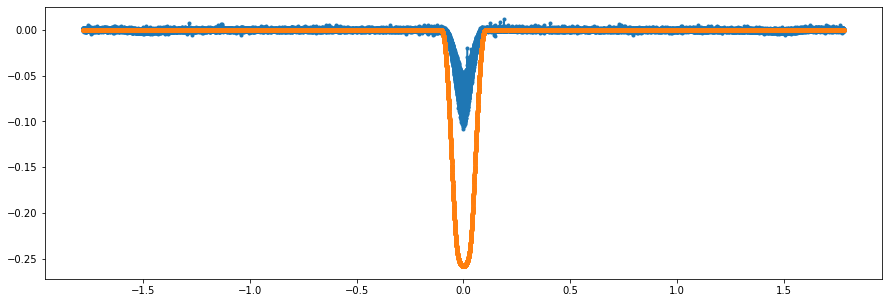

error en fold=  3.2964528320271405


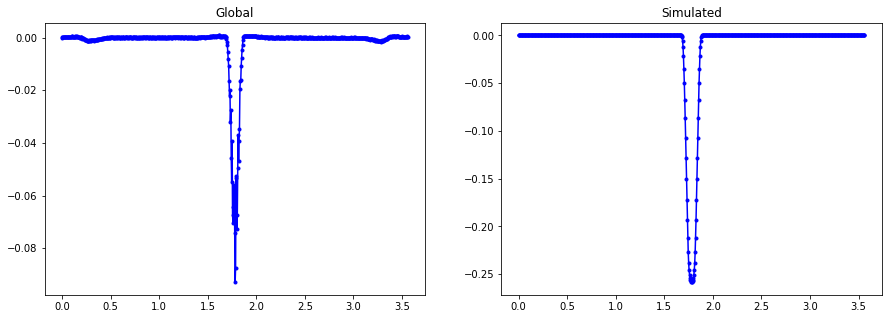

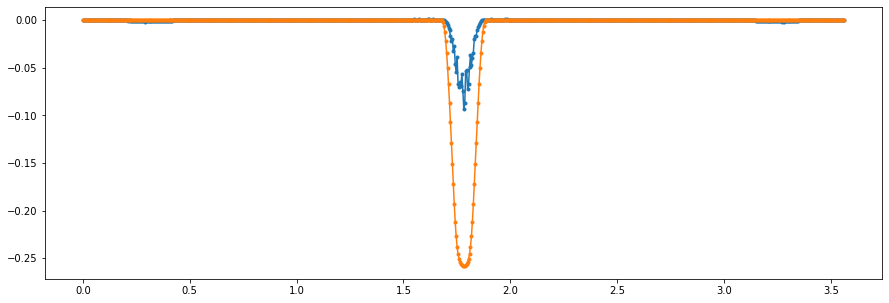

error en global=  3.348039076297423
----------------------------------------------------------------
Dis score 0.283000, not transit flag 0.0 sec flag 0.0


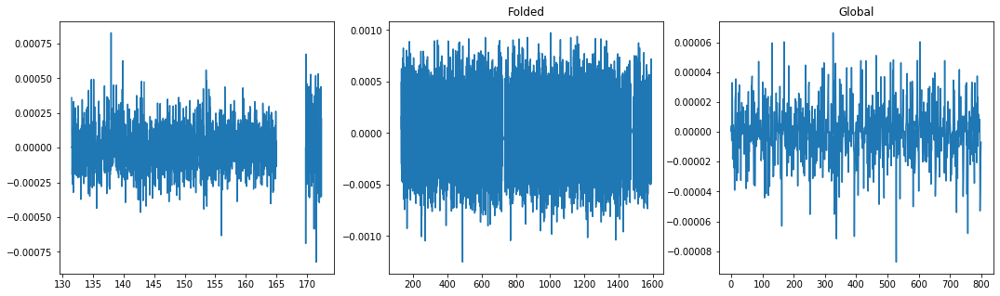

Max power:  0.0015798259211234605
Second Max:  0.0014781092254042873


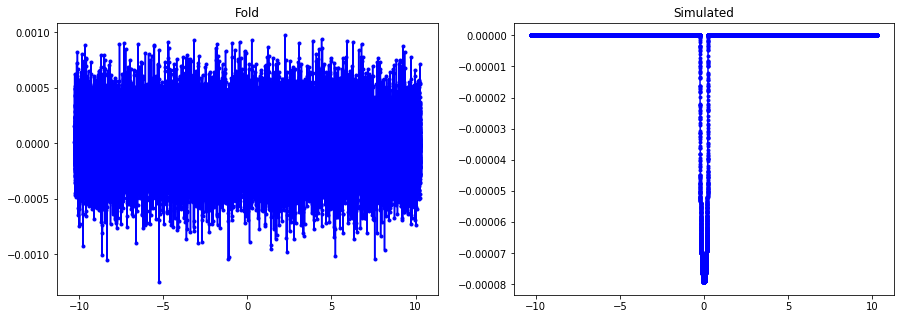

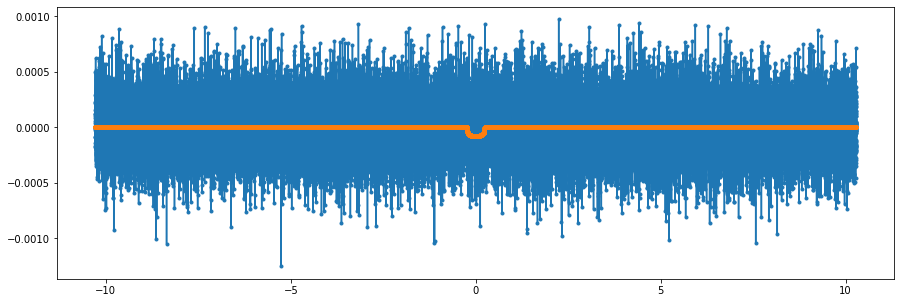

error en fold=  1.000917339755676


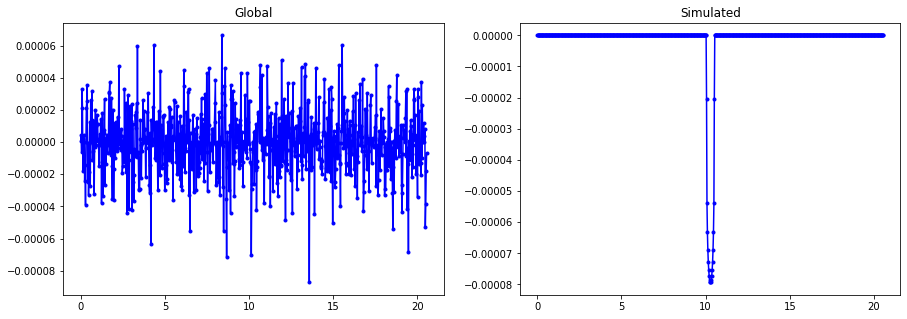

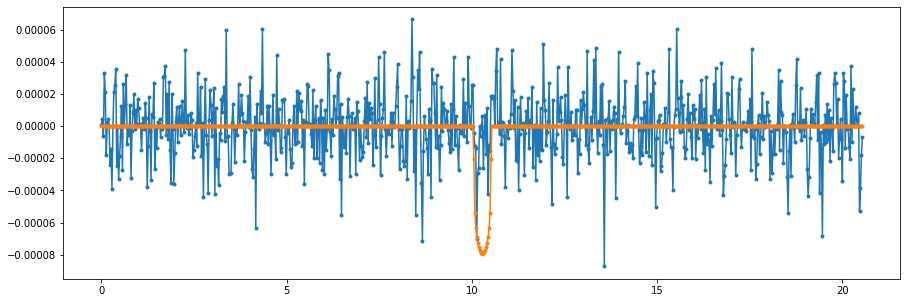

error en global=  1.0849693844421968
----------------------------------------------------------------
Dis score 0.479000, not transit flag 0.0 sec flag 0.0


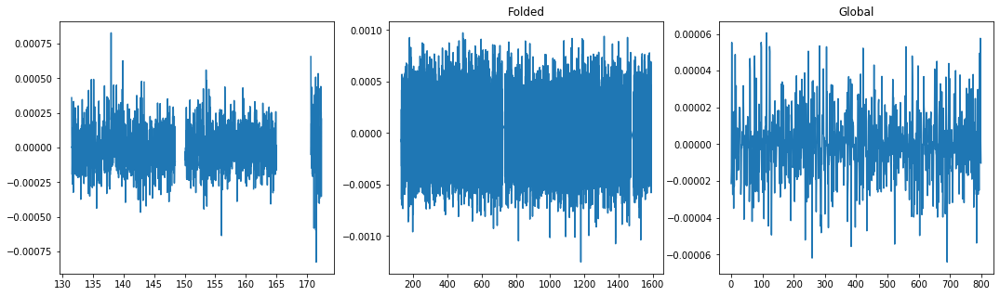

Max power:  0.0015921000418072618
Second Max:  0.0014738202390189841


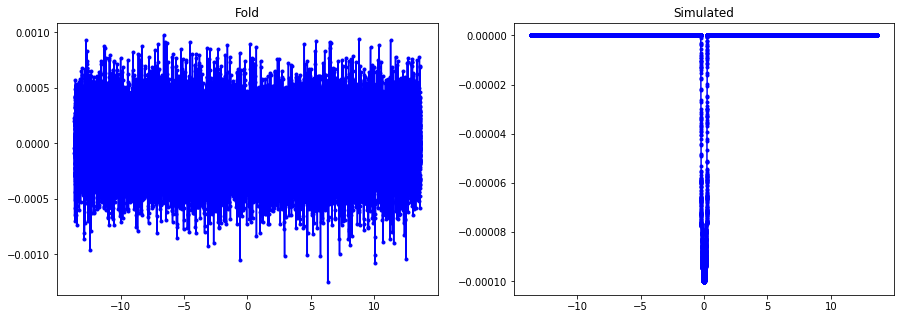

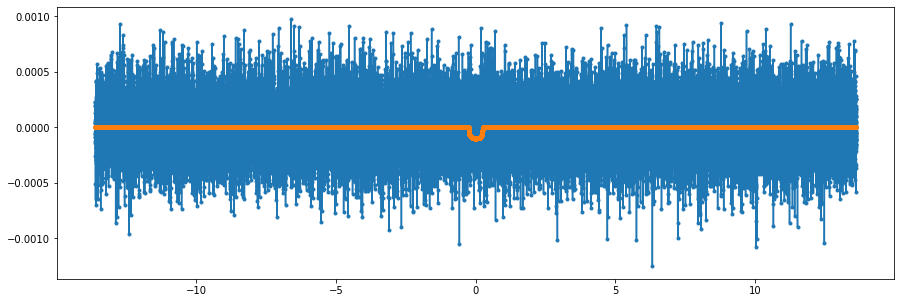

error en fold=  1.0015279613607309


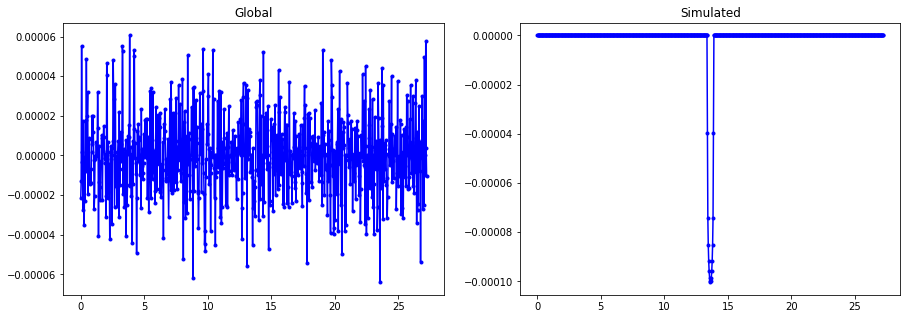

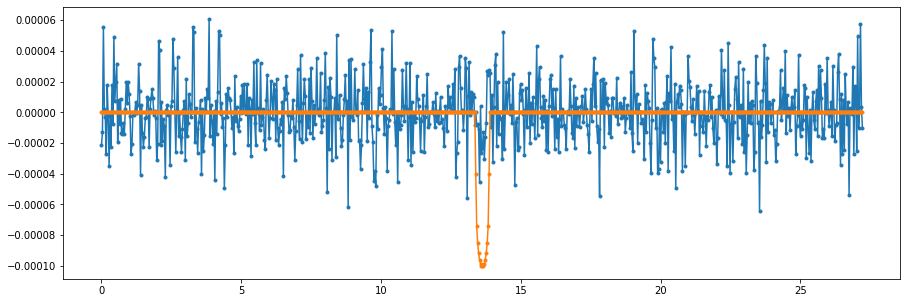

error en global=  1.1362147225526076
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


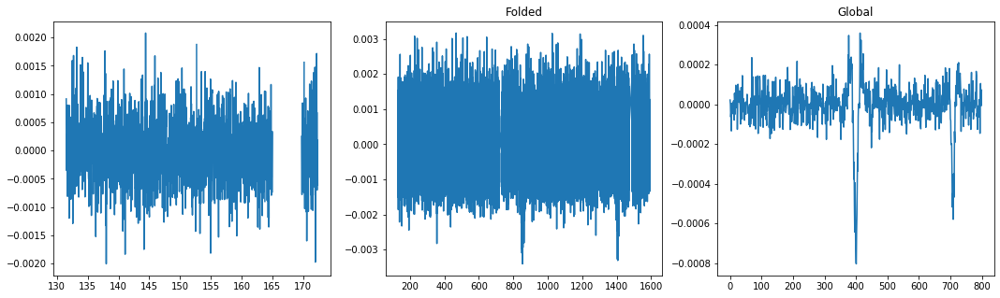

Max power:  0.003285545715737985
Second Max:  0.0031901409739554494


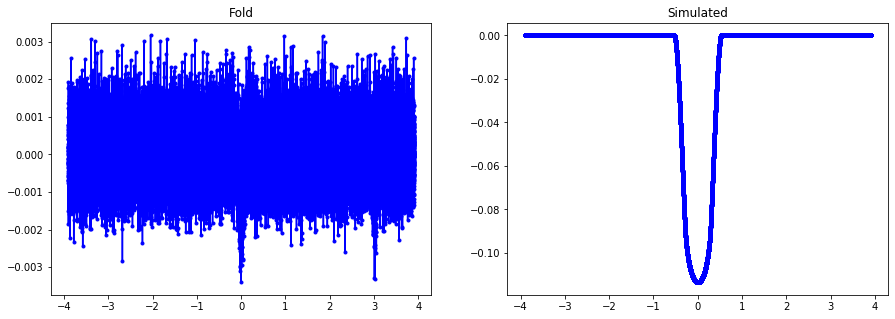

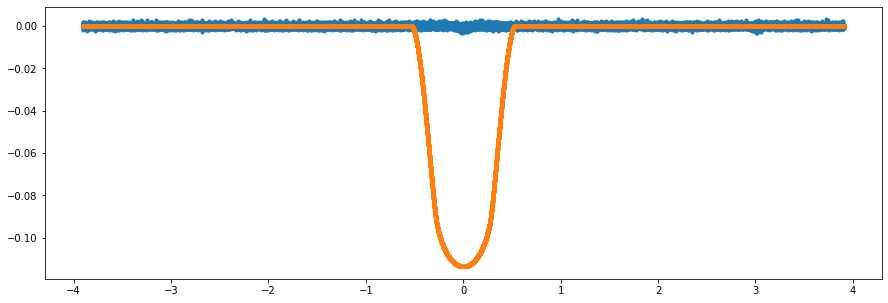

error en fold=  49.41974577921078


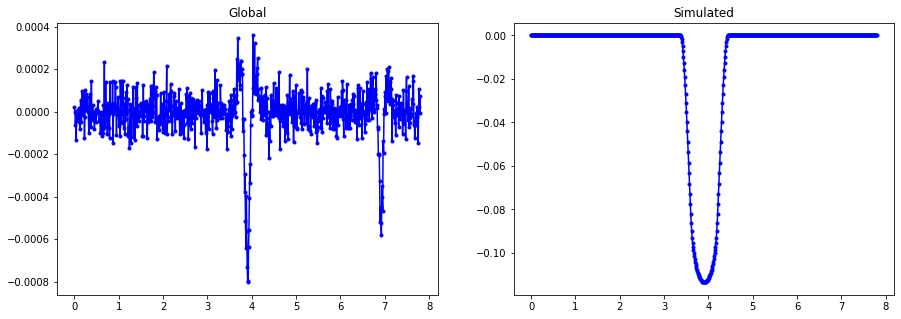

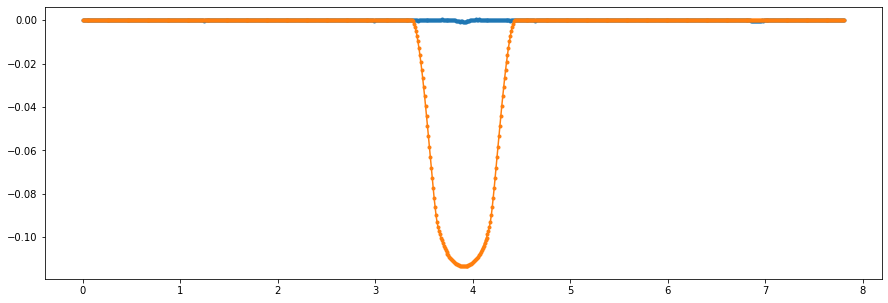

error en global=  269.35803551553255
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


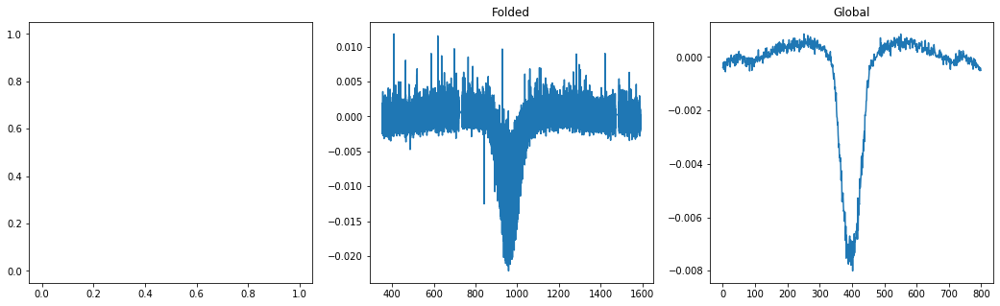

Max power:  0.21808309268182455
Second Max:  0.21151135070084082


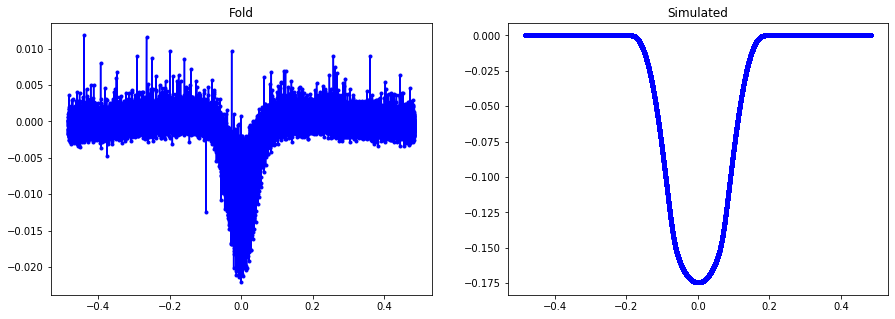

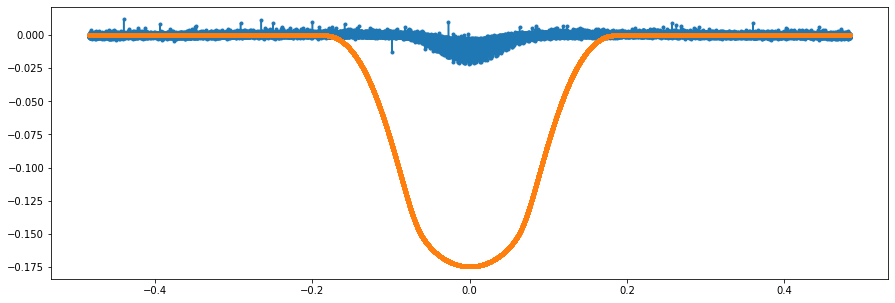

error en fold=  27.471650325511902


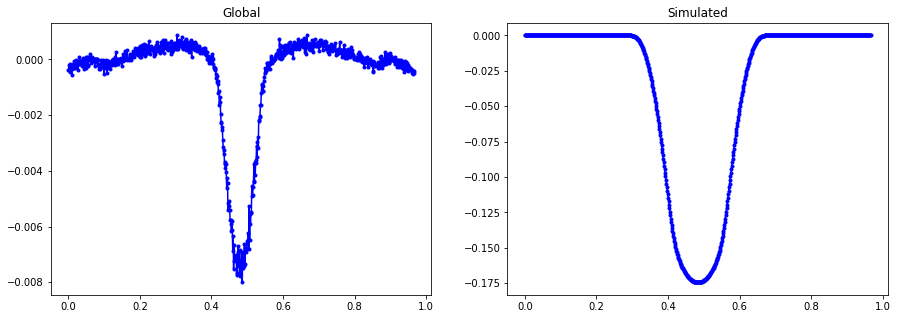

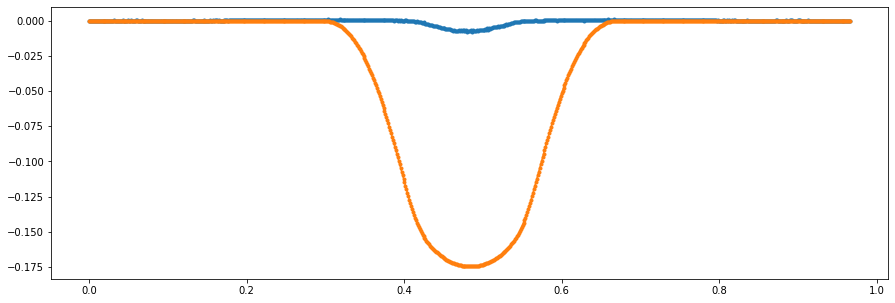

error en global=  36.638305608083535
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


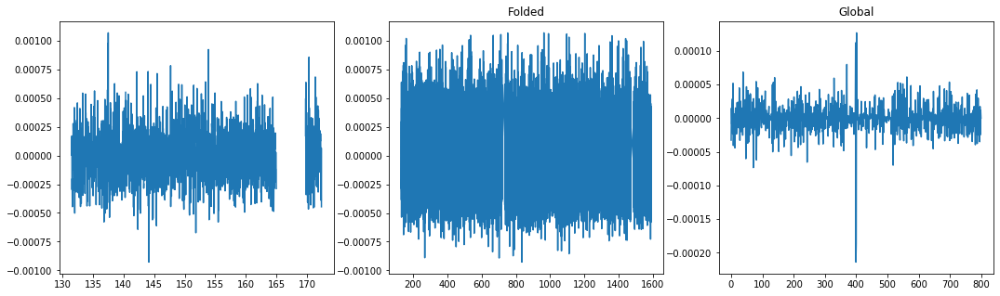

Max power:  0.0007533617582058251
Second Max:  0.0007203224124035678


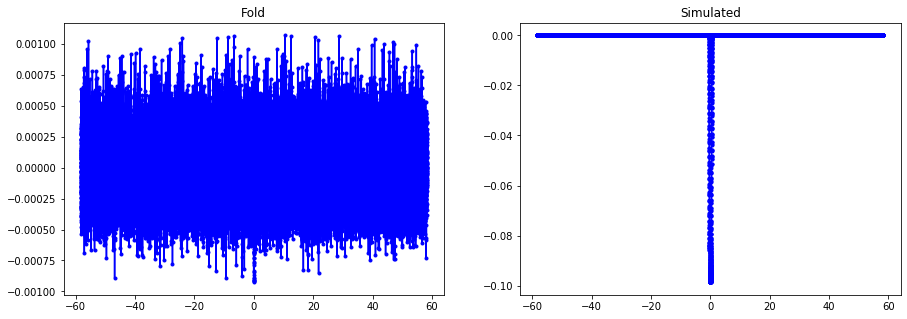

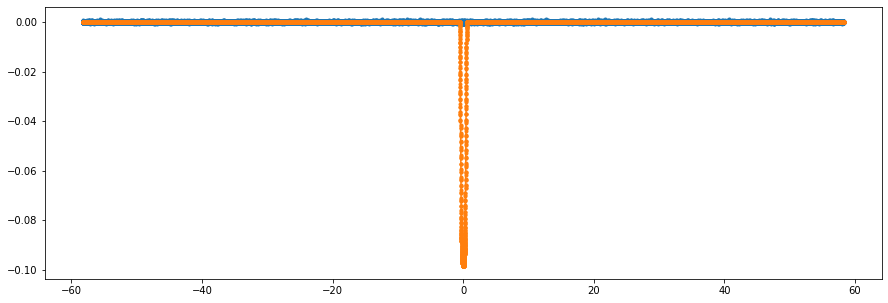

error en fold=  35.53963202900349


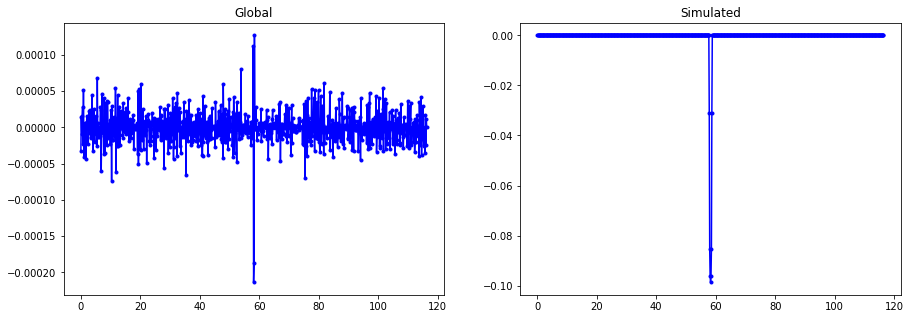

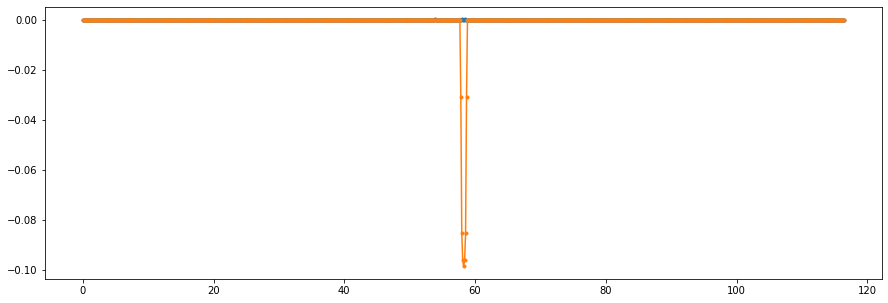

error en global=  320.2133120034073
----------------------------------------------------------------
Dis score 0.757000, not transit flag 0.0 sec flag 0.0


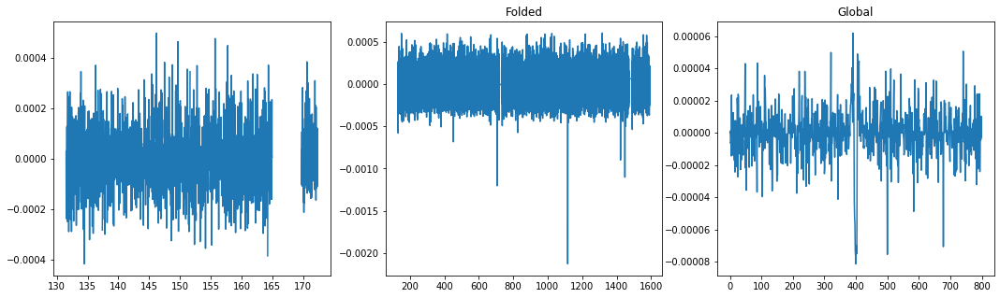

Max power:  0.0005647649246643258
Second Max:  0.0005463152060138822


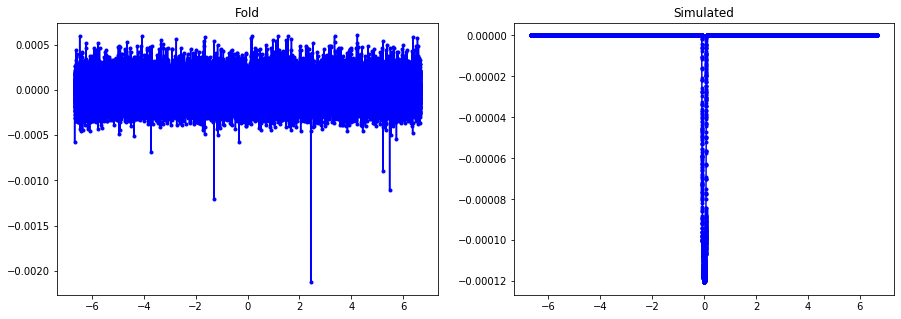

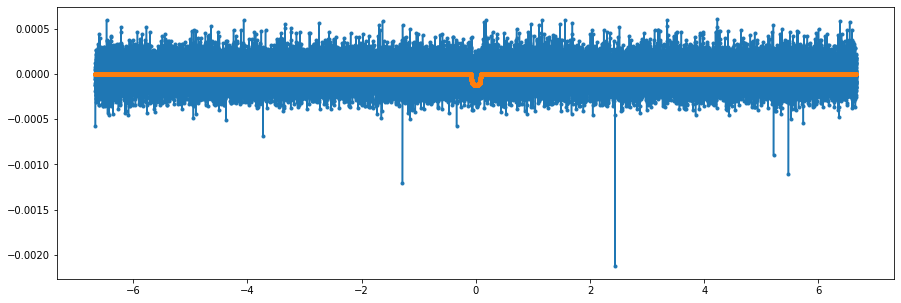

error en fold=  0.9991793370569785


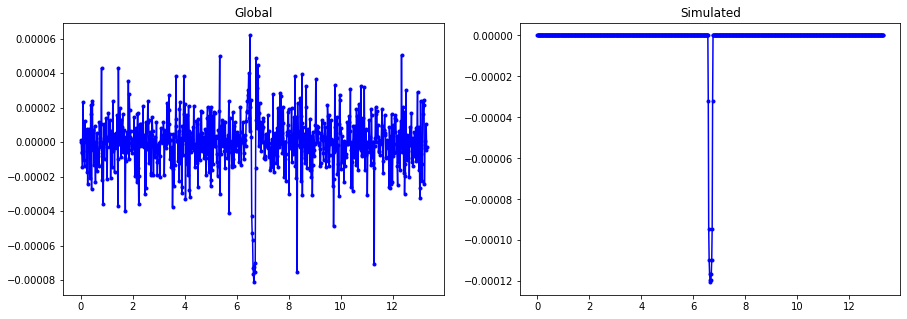

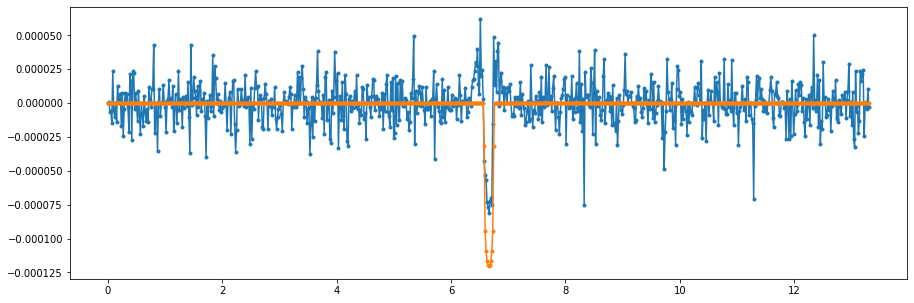

error en global=  0.9613353711687734
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


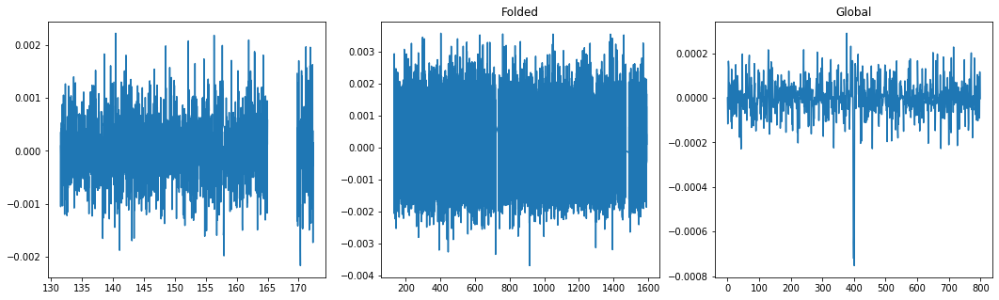

Max power:  0.0007069553984827747
Second Max:  0.0006438148350011126


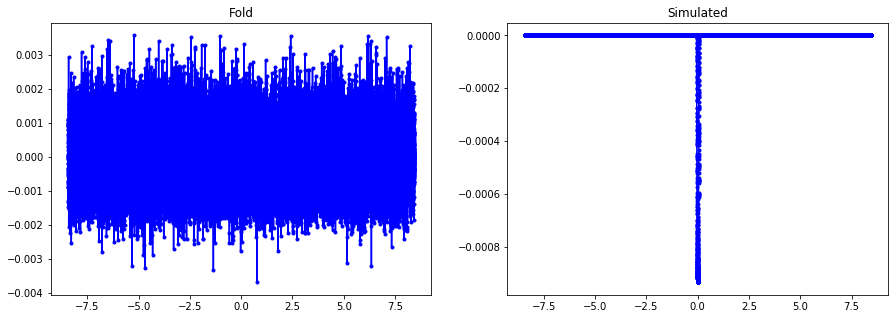

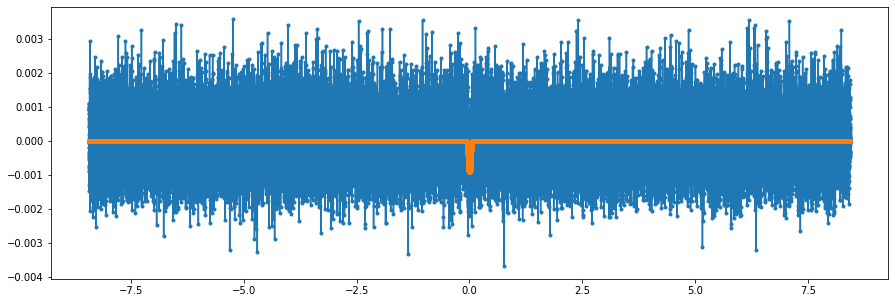

error en fold=  0.9983051729701874


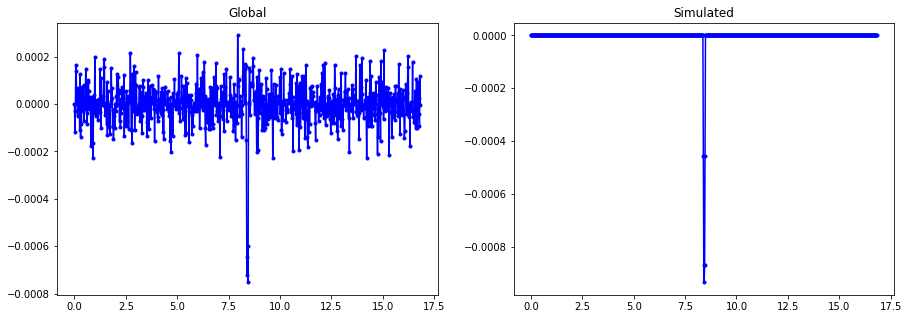

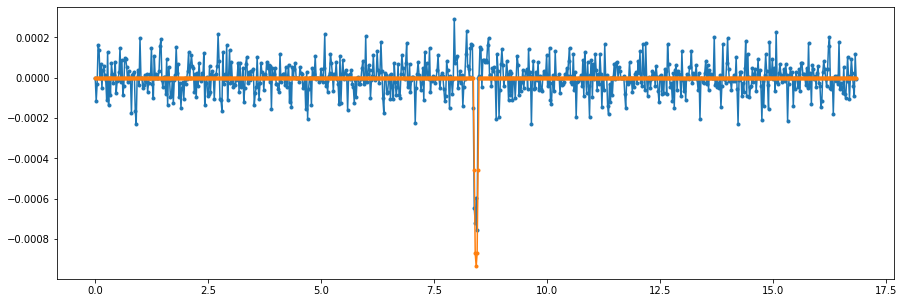

error en global=  0.8809536531320542
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


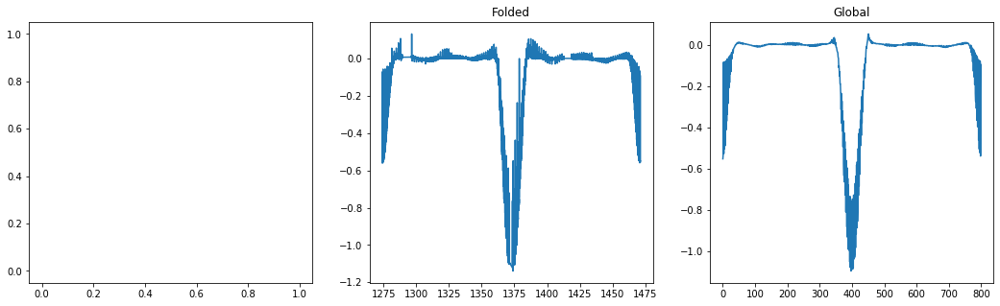

Max power:  0.22950695629739154
Second Max:  0.2161099018048859
ERROR, CURVA ELIMINADO DE INMEDIATO
Dis score 0.813000, not transit flag 0.0 sec flag 0.0


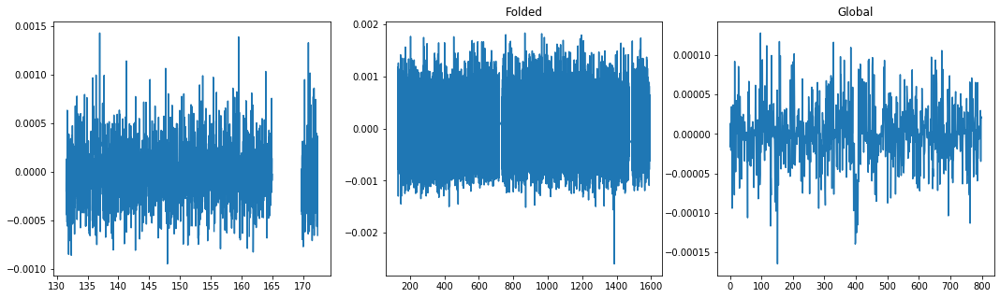

Max power:  0.0004601324368063517
Second Max:  0.0004576863639495789


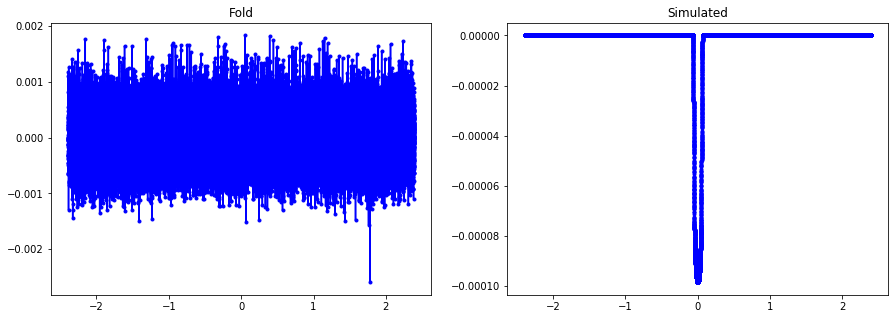

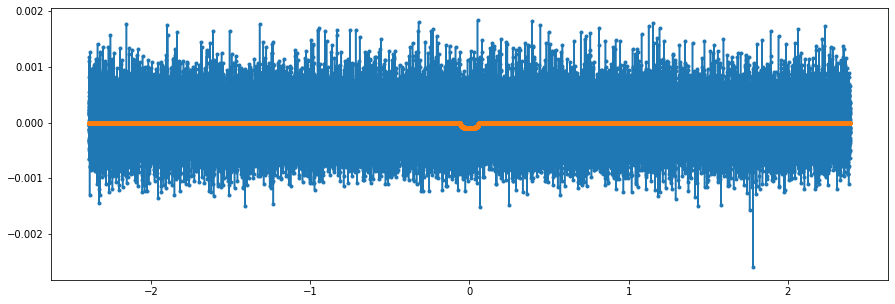

error en fold=  0.9998401266941439


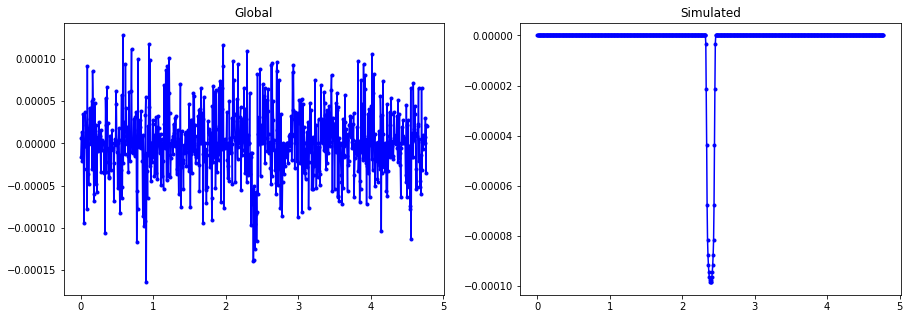

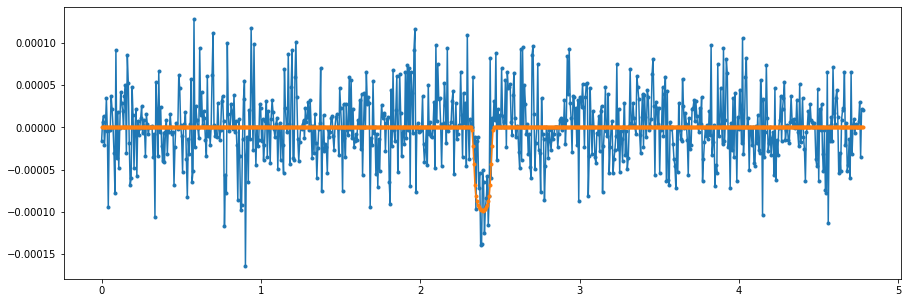

error en global=  0.9702680479209834
----------------------------------------------------------------
Dis score 0.967000, not transit flag 0.0 sec flag 0.0


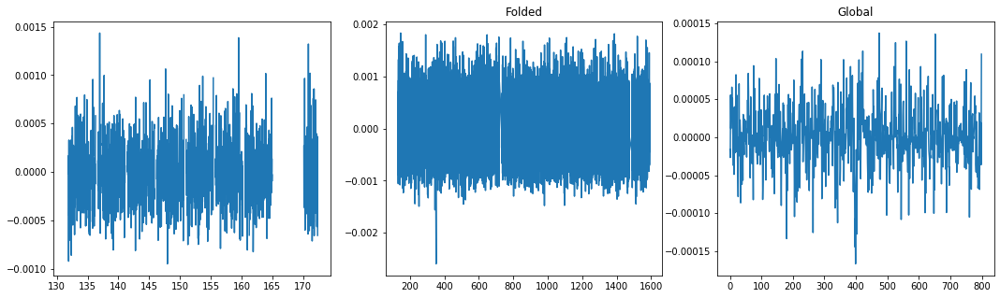

Max power:  0.0004777978216790365
Second Max:  0.00044950542938916203


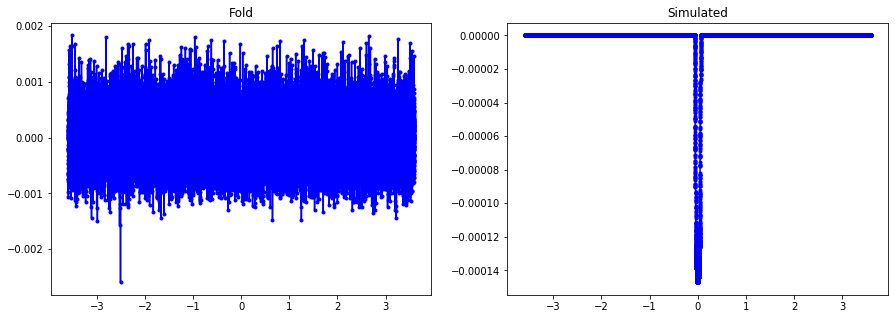

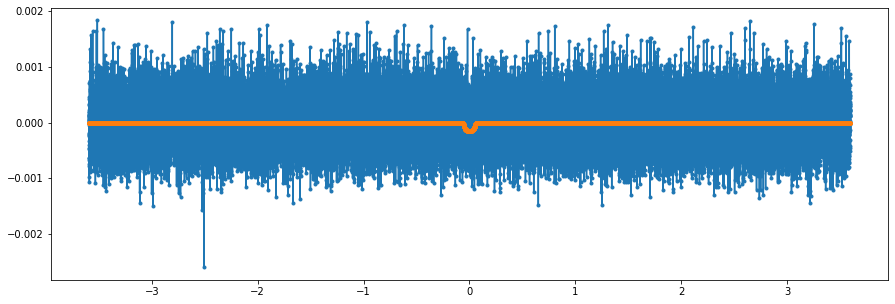

error en fold=  0.9999796595700375


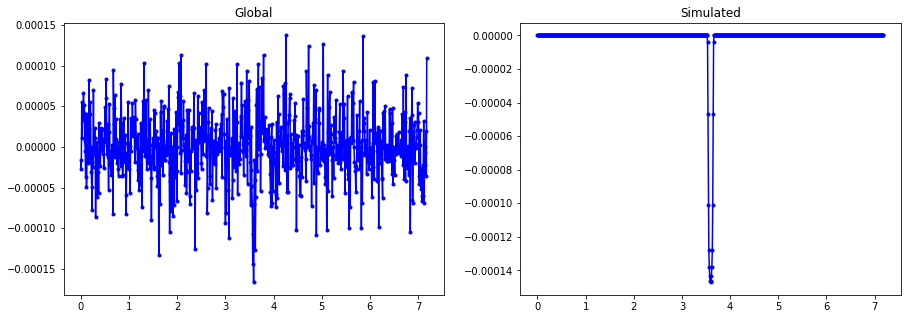

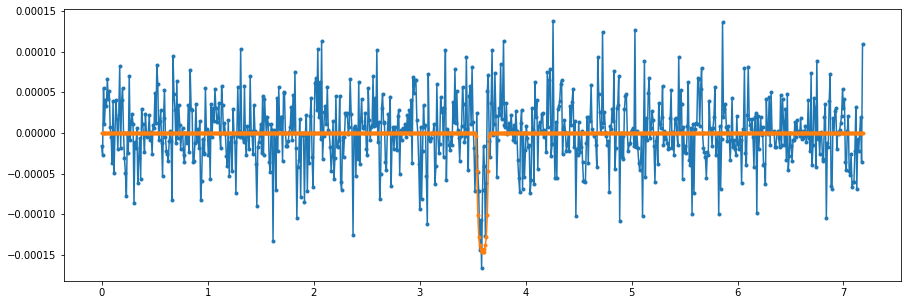

error en global=  0.994487529626385
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


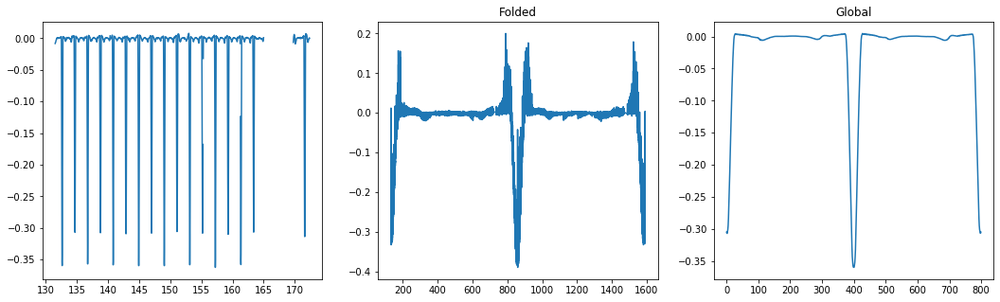

Max power:  0.1686809797563123
Second Max:  0.1605456669376921


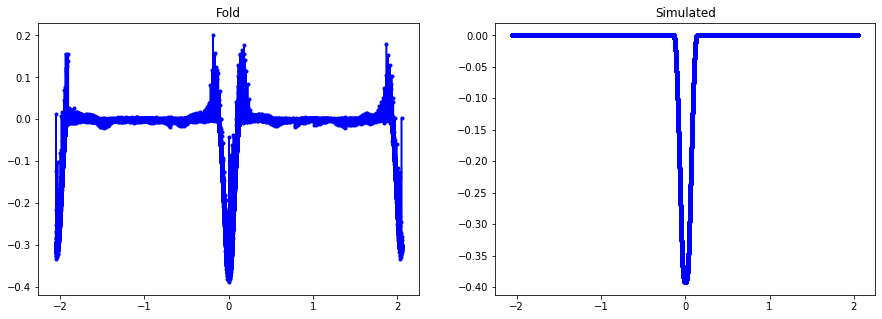

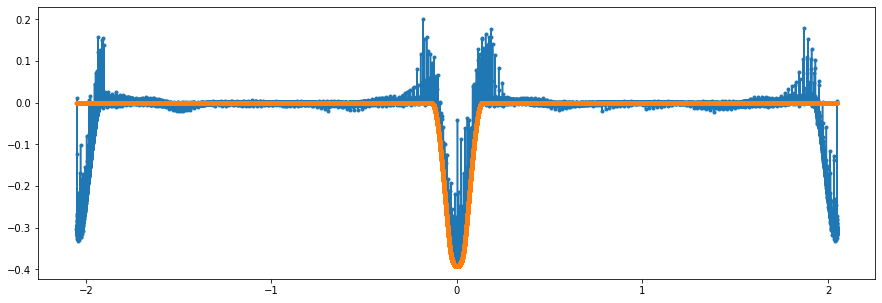

error en fold=  0.7131079984362408


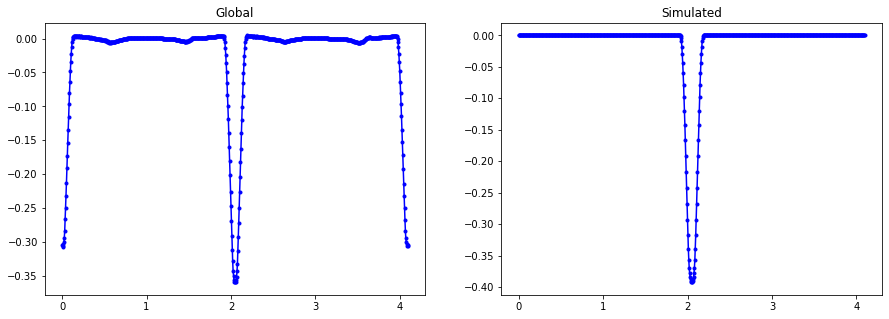

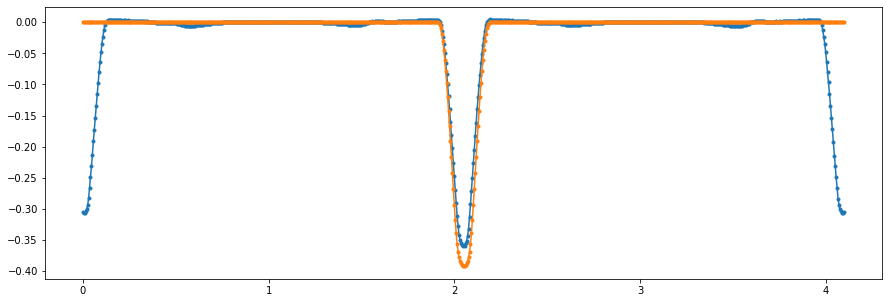

error en global=  0.7104428130221142
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


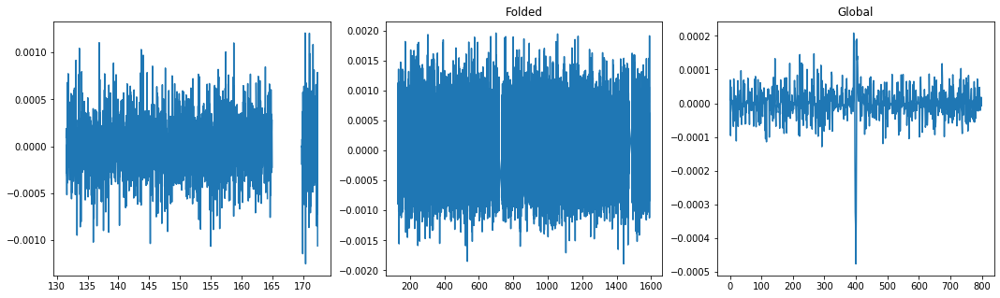

Max power:  0.0006005803600025093
Second Max:  0.0005900228282041702


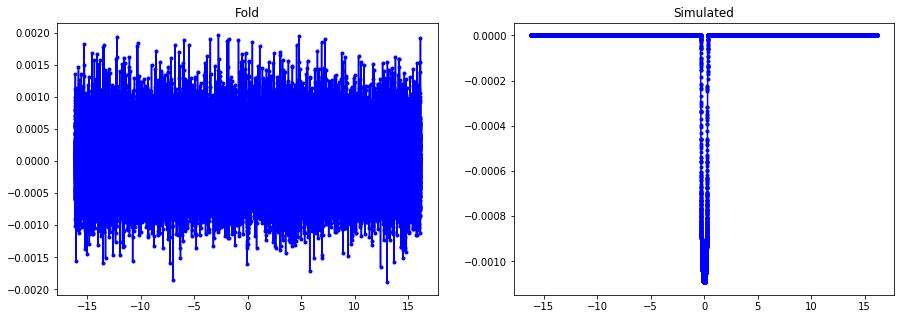

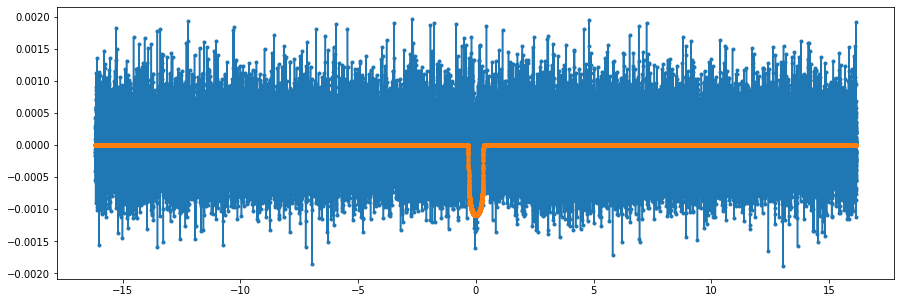

error en fold=  1.0590437140608875


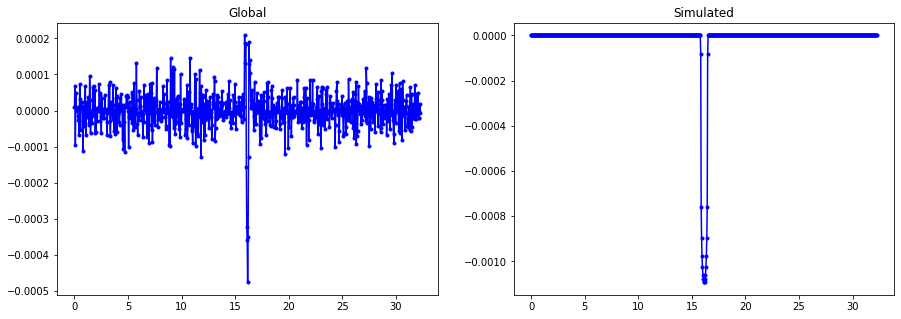

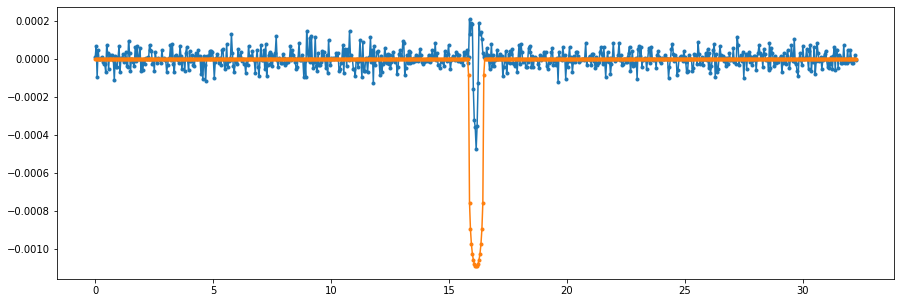

error en global=  2.6925584684671273
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


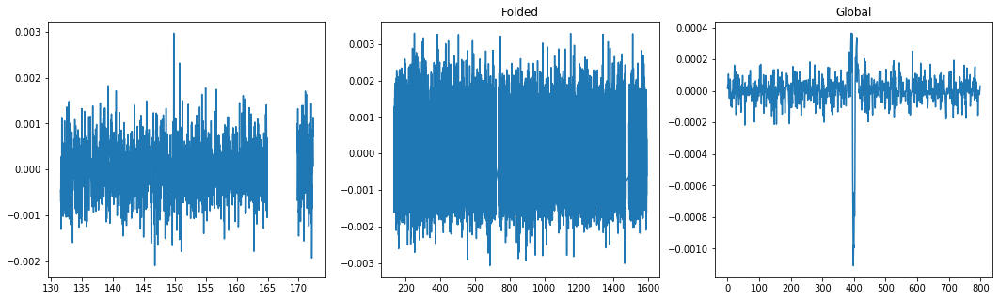

Max power:  0.0010545683610065112
Second Max:  0.0010347351319103051


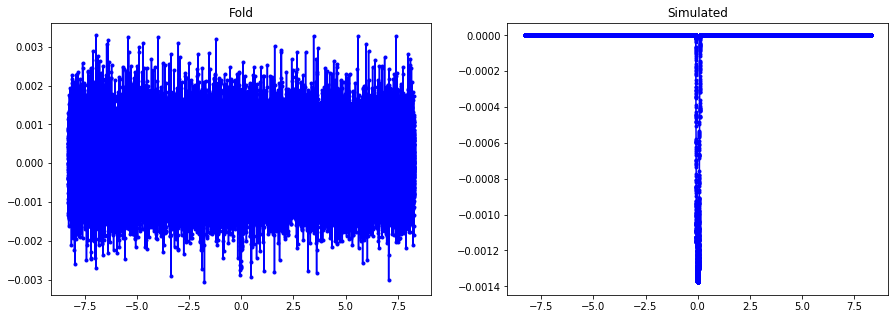

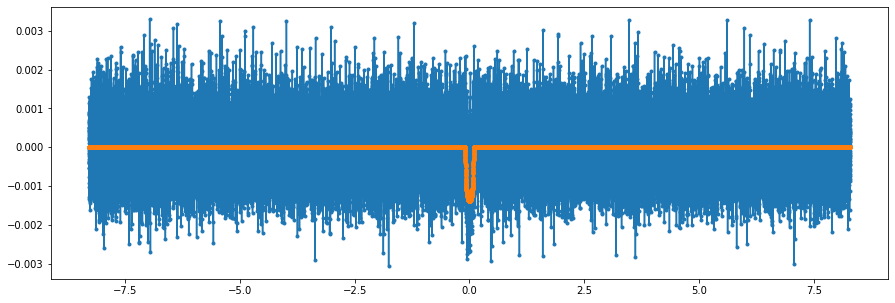

error en fold=  0.9946810761731817


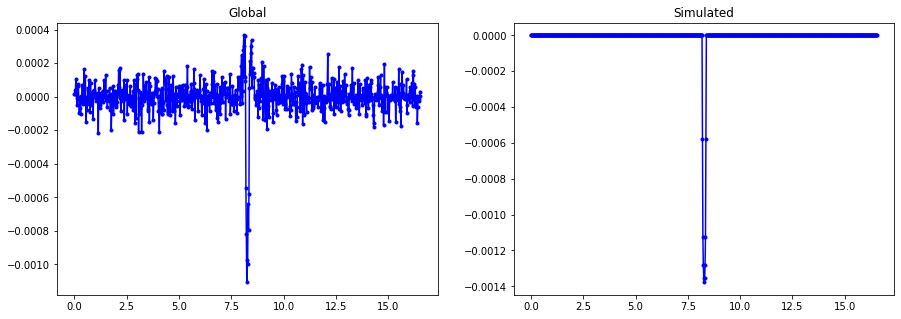

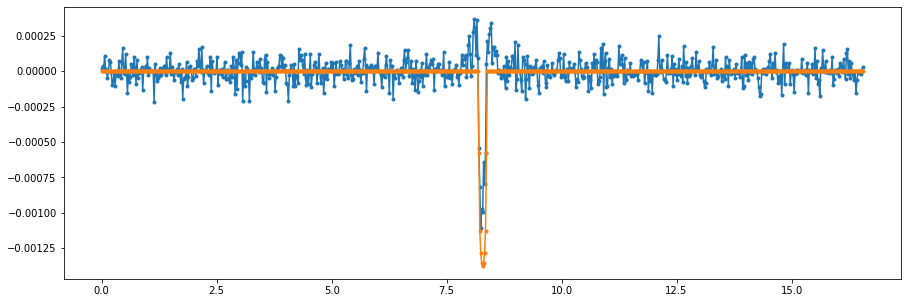

error en global=  0.8008497998979346
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


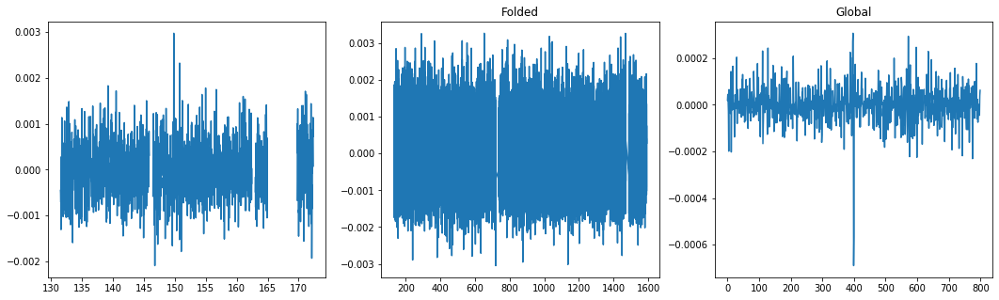

Max power:  0.0006313382351541873
Second Max:  0.0005932338854500829


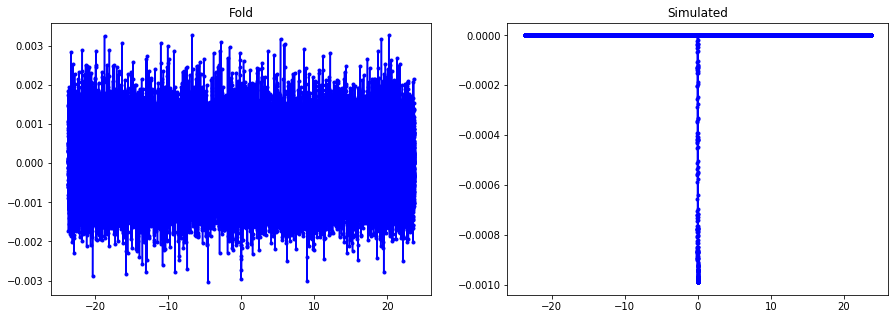

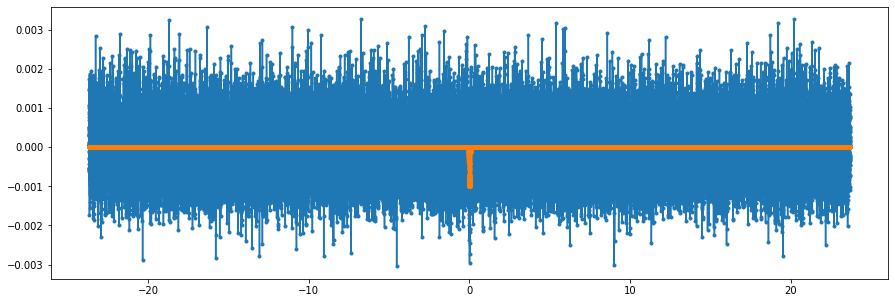

error en fold=  0.9988924016950746


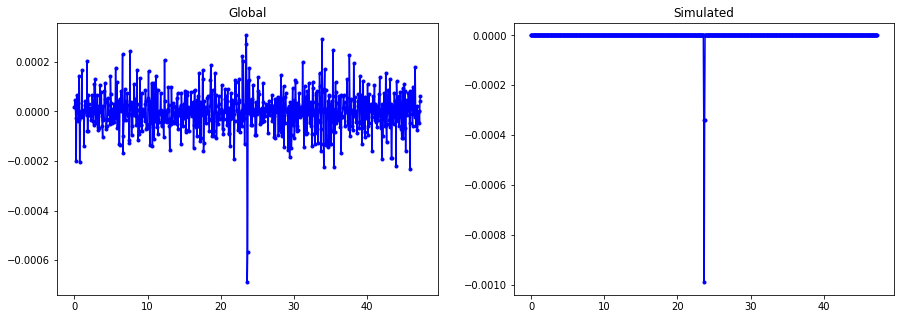

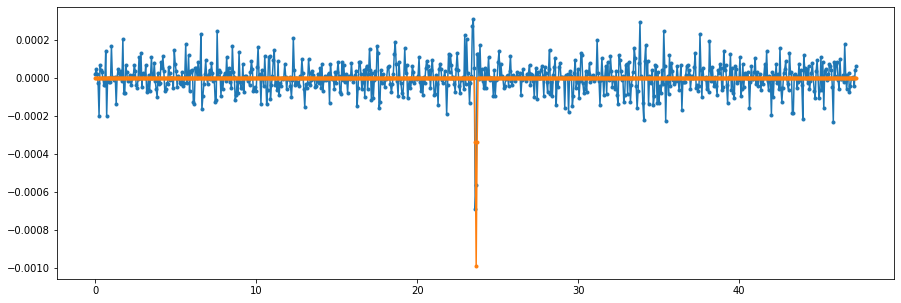

error en global=  0.9713041508787029
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


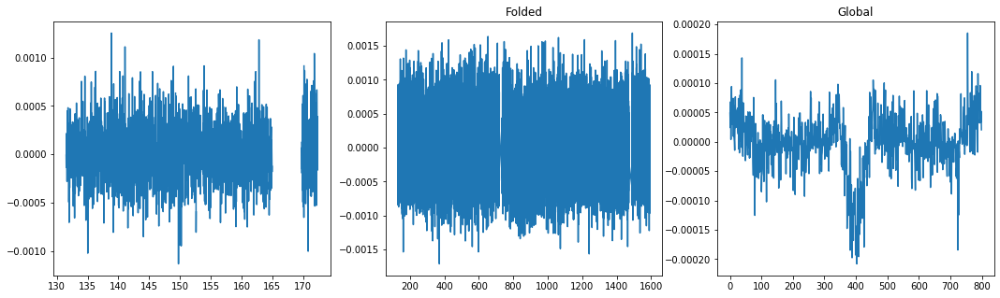

Max power:  0.004896134554730781
Second Max:  0.004439194337545419


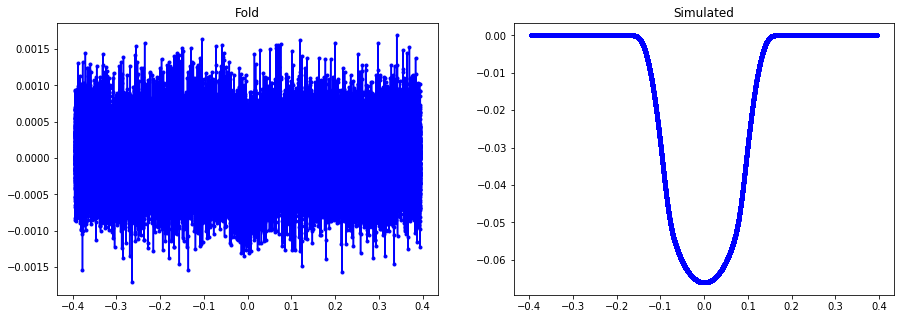

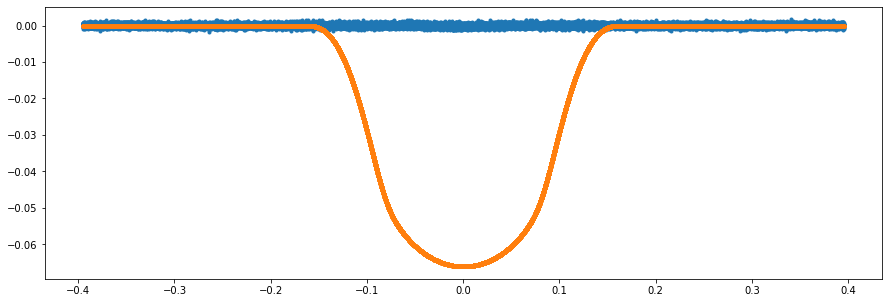

error en fold=  86.71571581554774


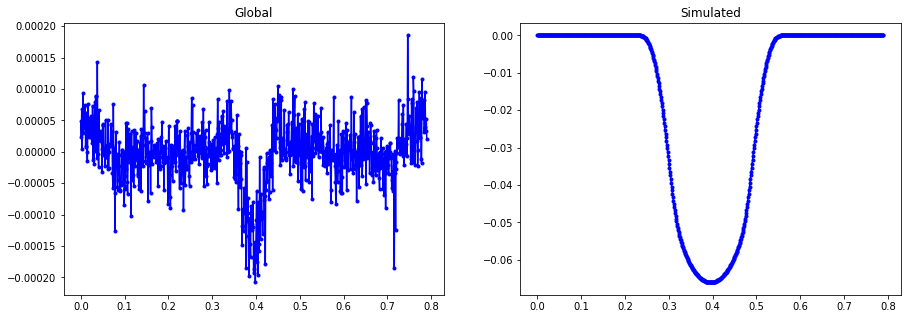

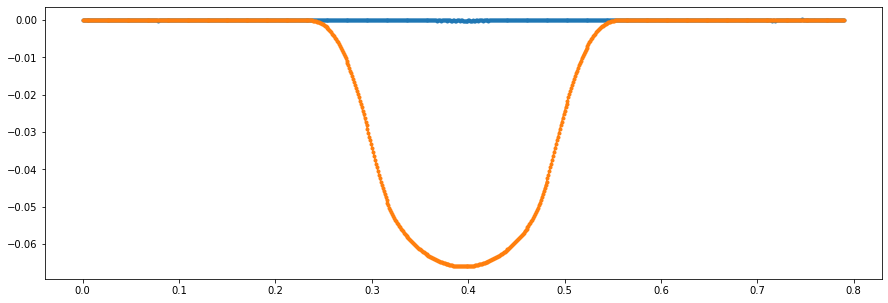

error en global=  581.5077596806009
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


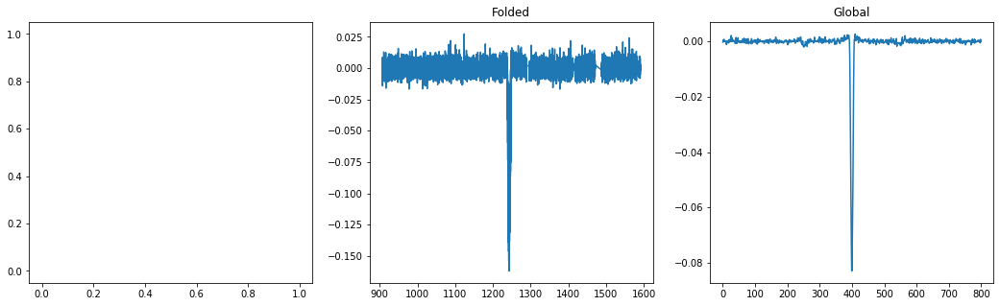

Max power:  0.019394348077557504
Second Max:  0.018527908440239504


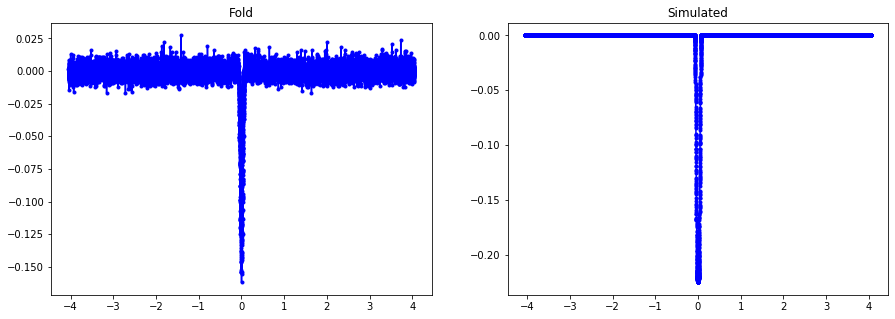

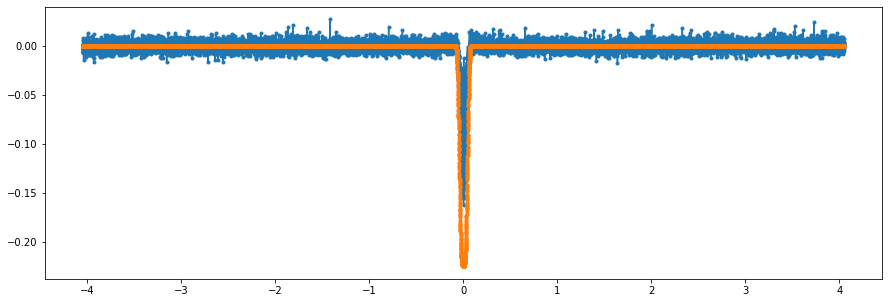

error en fold=  1.6082911849868287


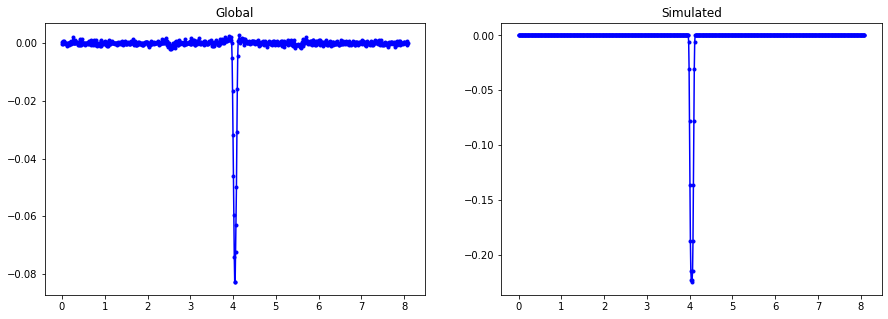

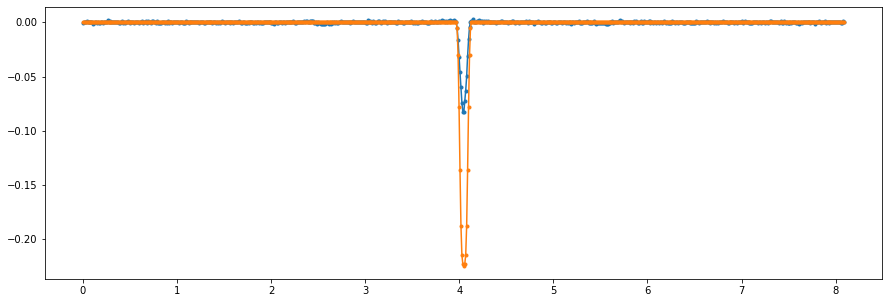

error en global=  2.0695734198704767
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 0.0


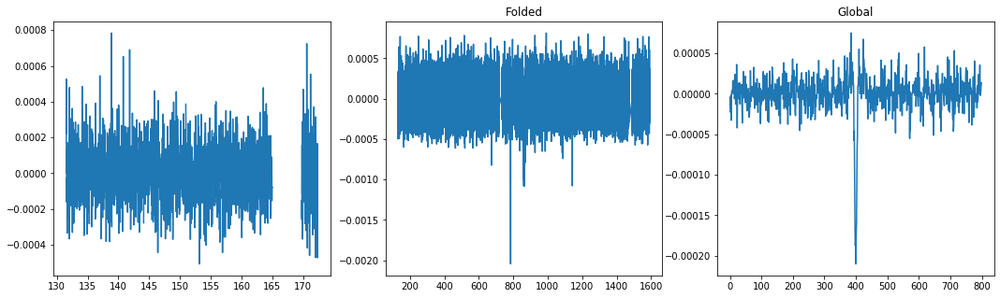

Max power:  0.0009095160593414843
Second Max:  0.0008907448765477266


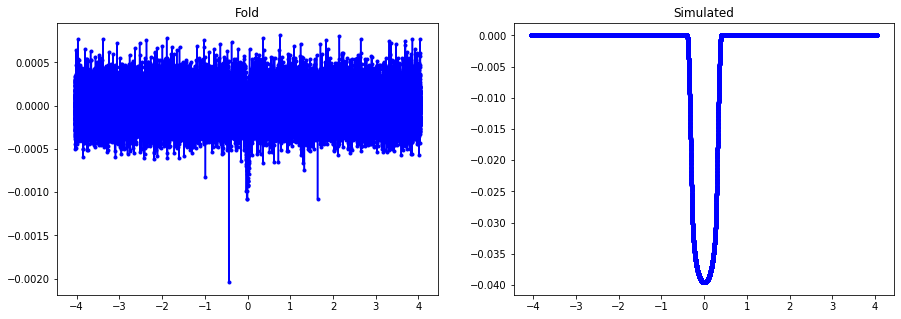

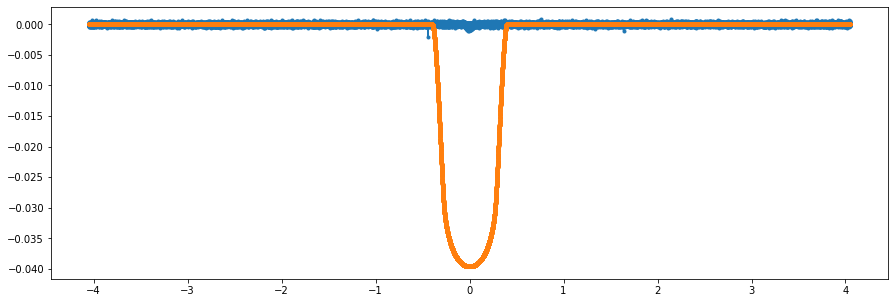

error en fold=  61.81464354737091


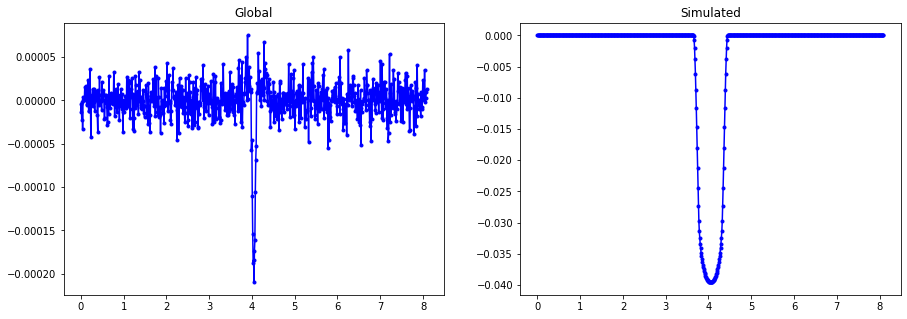

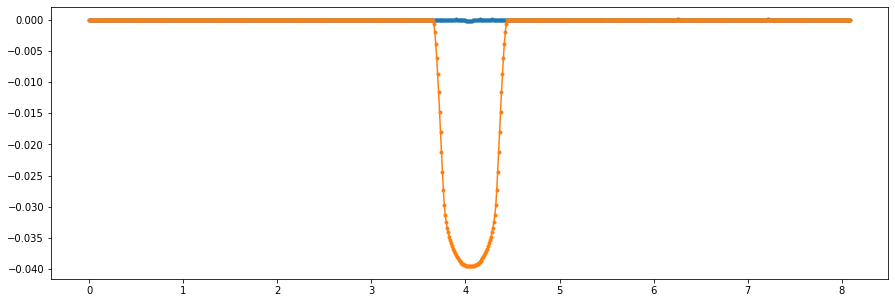

error en global=  415.409688186319
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


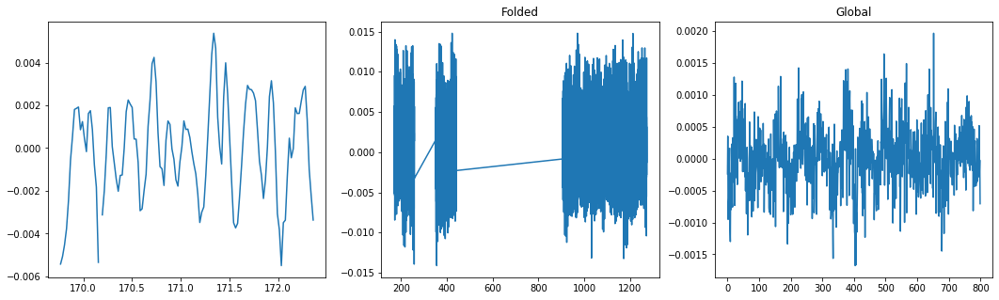

Max power:  0.04506961598035024
Second Max:  0.04200254437998038
ERROR, CURVA ELIMINADO DE INMEDIATO
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


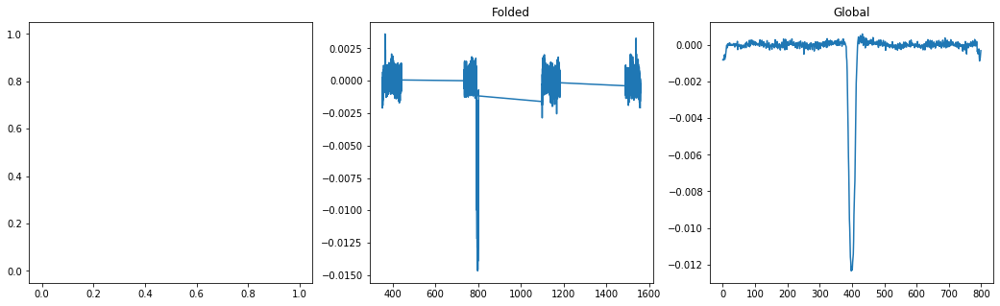

Max power:  0.06717831154847896
Second Max:  0.06600372979632448


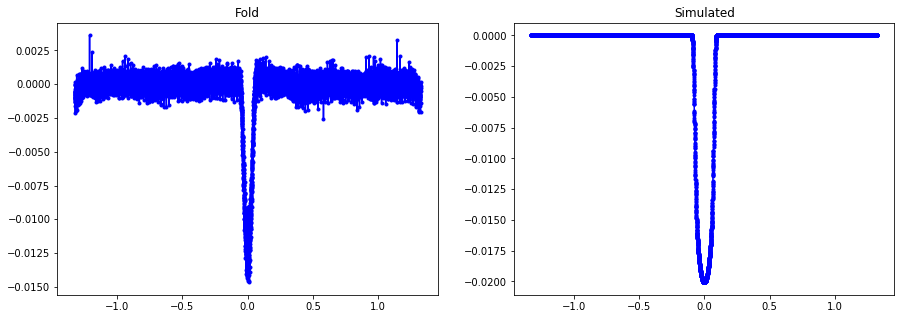

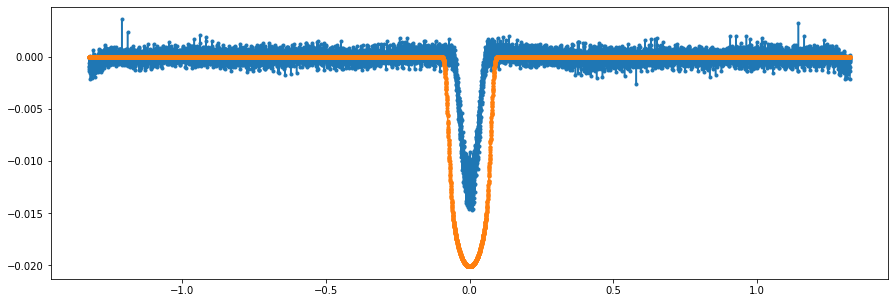

error en fold=  1.6386619730163234


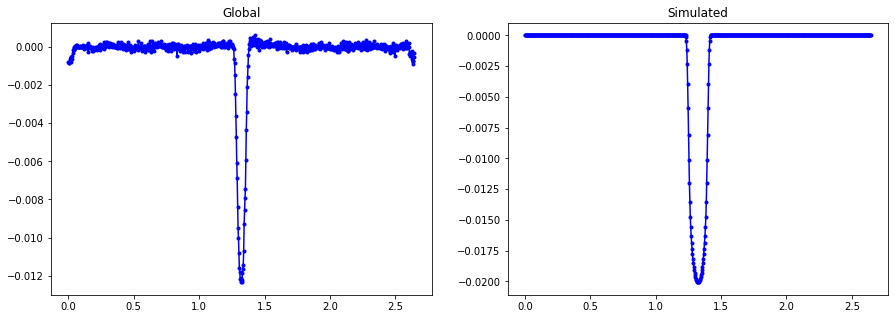

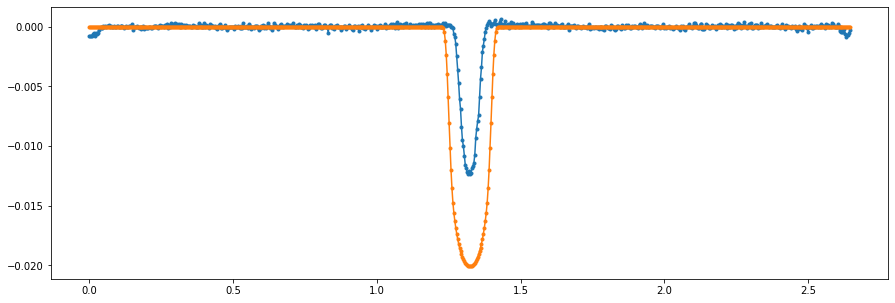

error en global=  1.675763345986759
----------------------------------------------------------------
Dis score 0.416000, not transit flag 0.0 sec flag 0.0


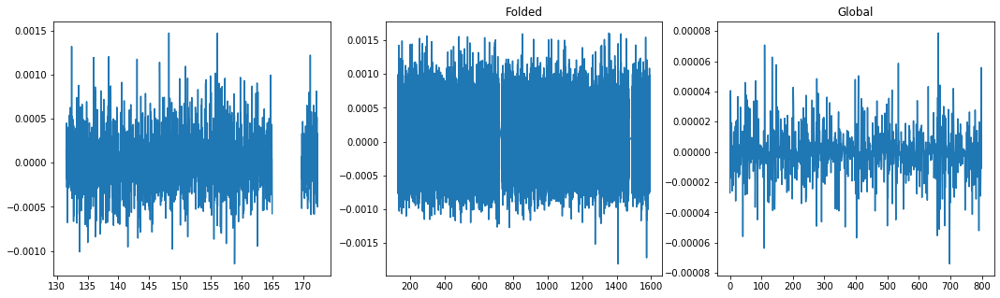

Max power:  0.0006687713388701764
Second Max:  0.0006239787174431957


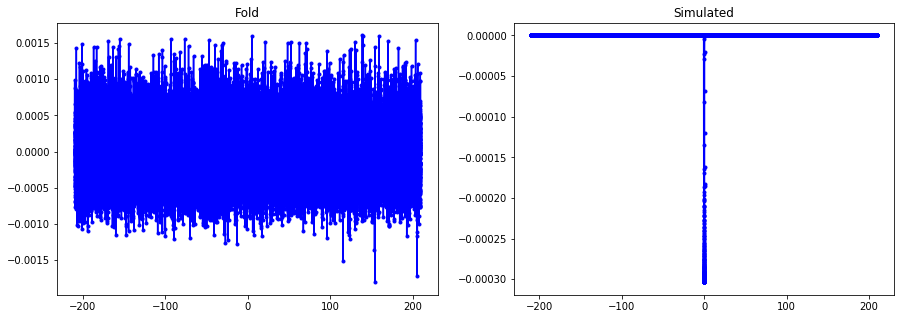

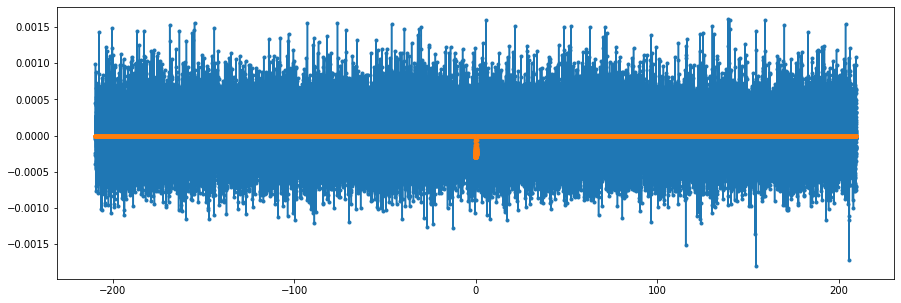

error en fold=  1.001181405983837


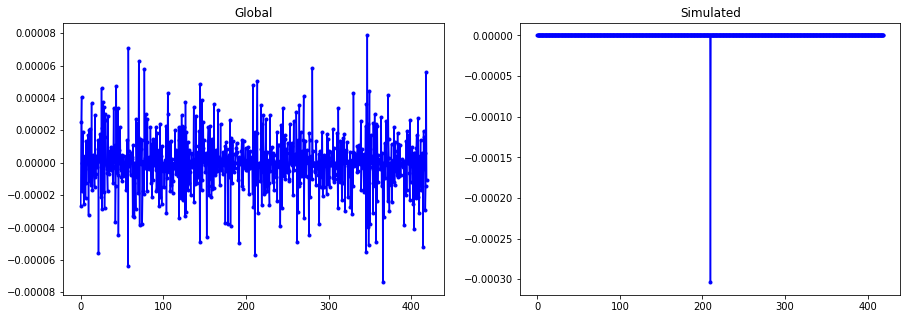

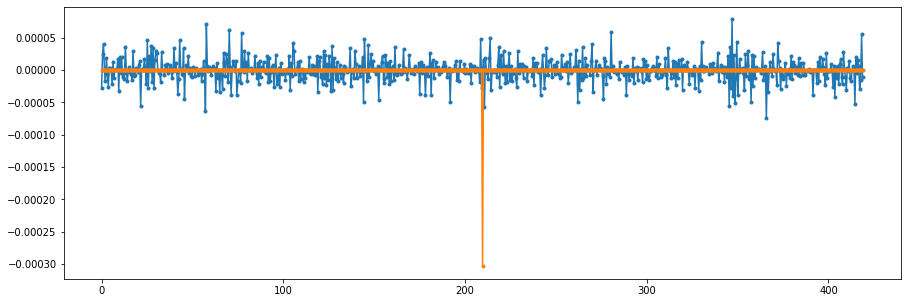

error en global=  1.1724891498483538
----------------------------------------------------------------
Dis score 0.901000, not transit flag 0.0 sec flag 0.0


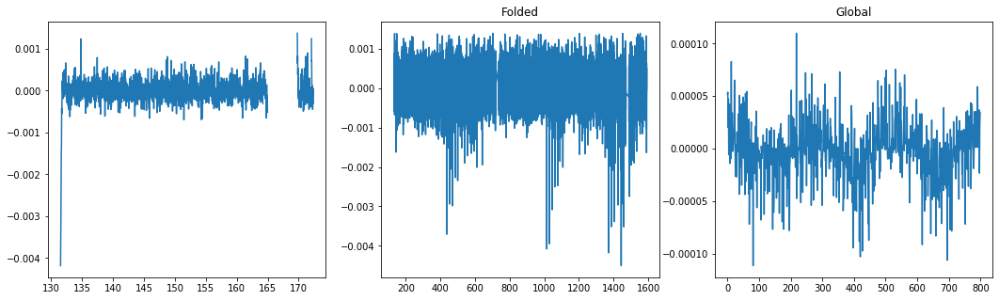

Max power:  0.002869752431259626
Second Max:  0.002675339872002185


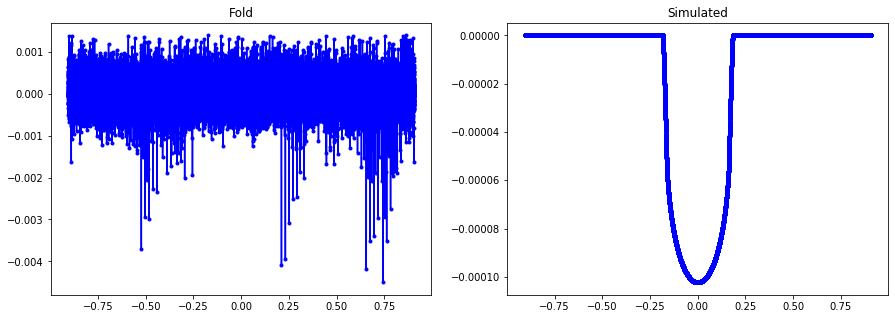

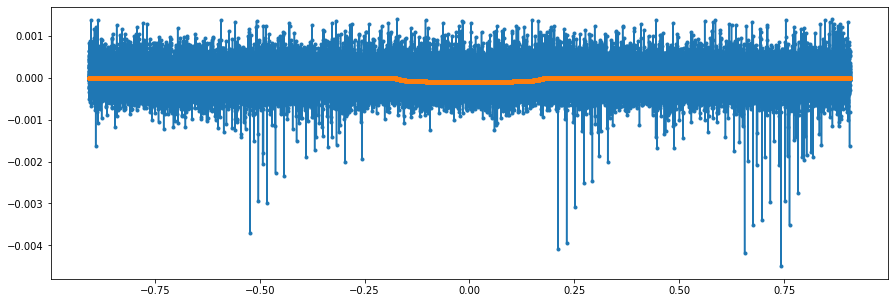

error en fold=  1.0071888937495437


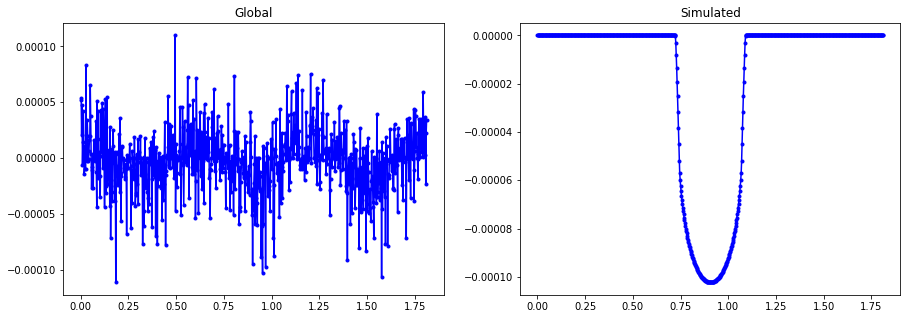

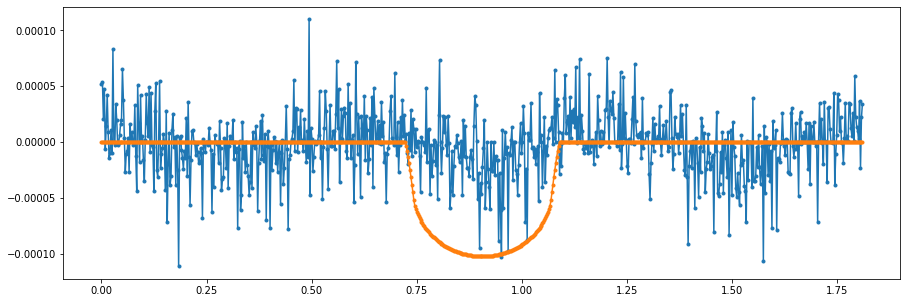

error en global=  1.5511272524718405
----------------------------------------------------------------
Dis score 0.994000, not transit flag 0.0 sec flag 0.0


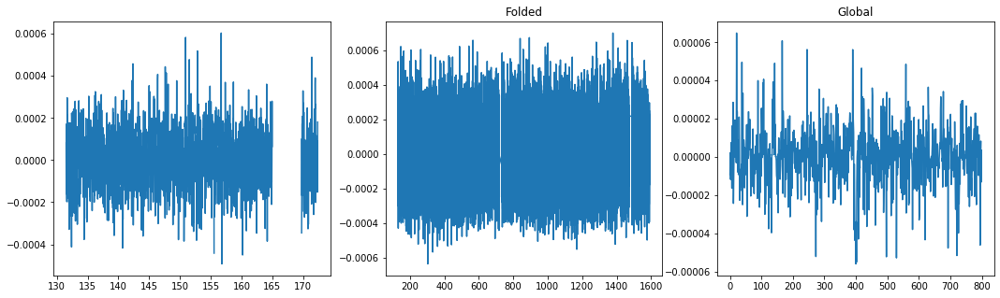

Max power:  0.0006324706051494172
Second Max:  0.0006227794982141593


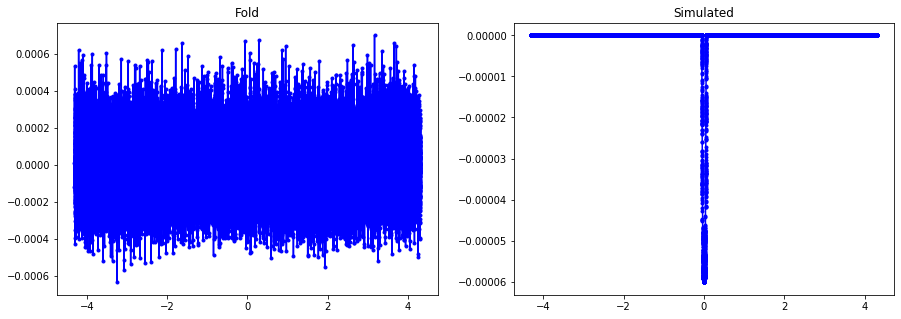

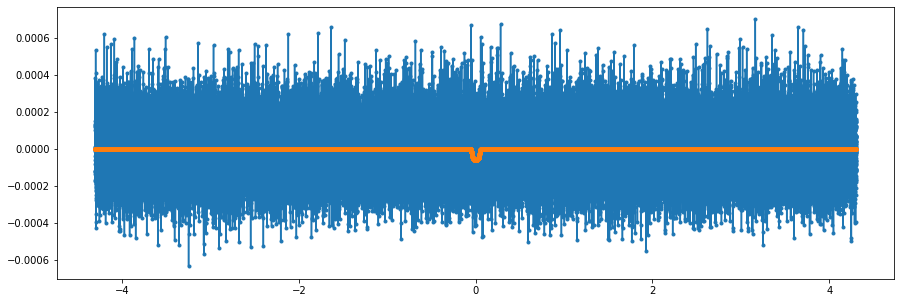

error en fold=  0.9995316150779094


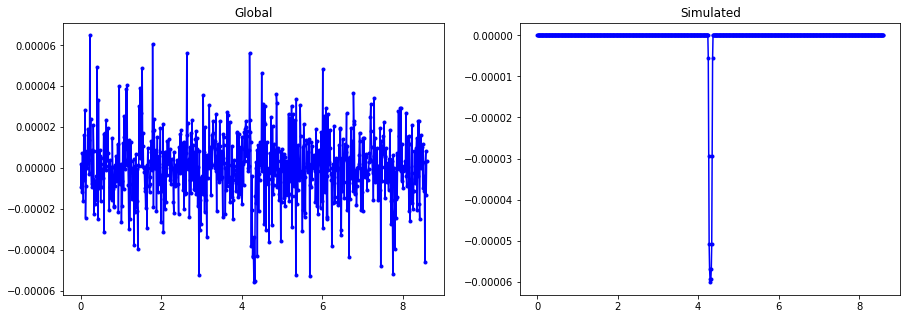

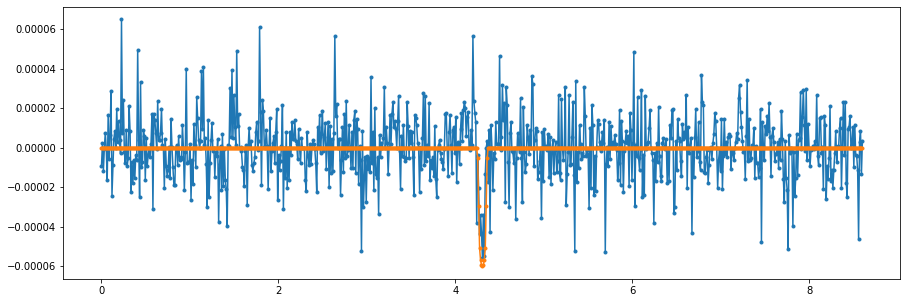

error en global=  0.9777276471502402
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


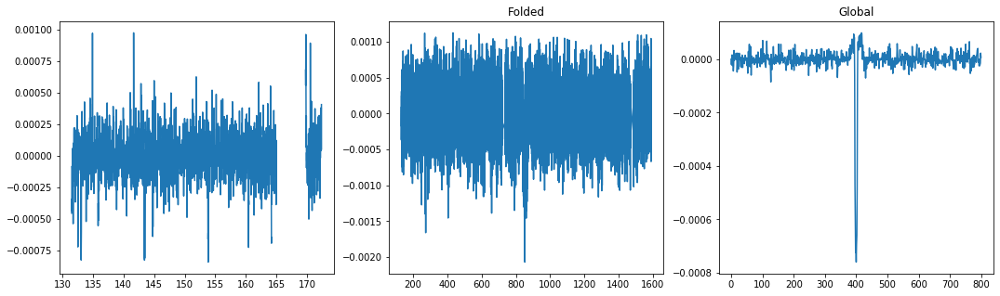

Max power:  0.0035152568978839577
Second Max:  0.0031749844850670365


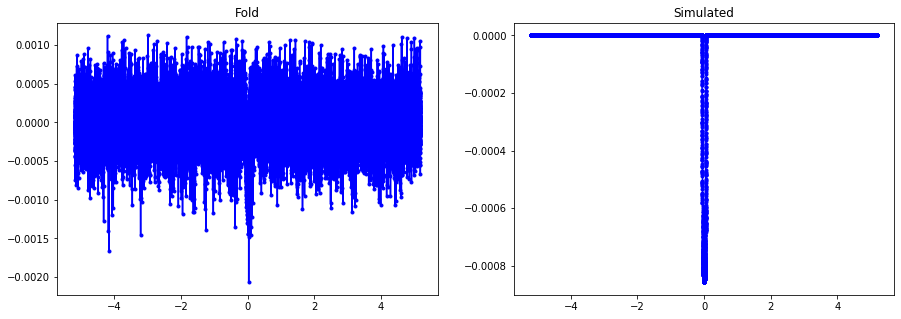

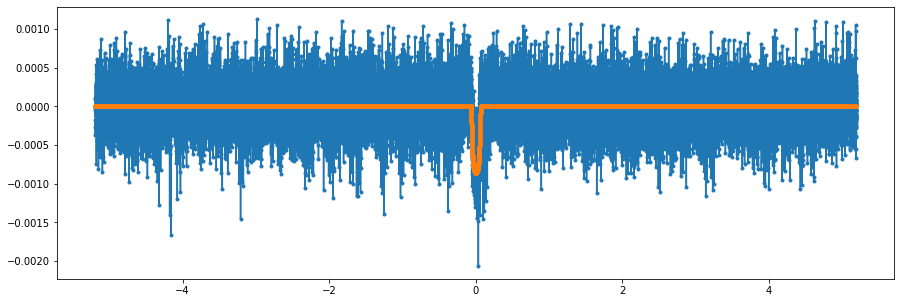

error en fold=  0.9615094970828836


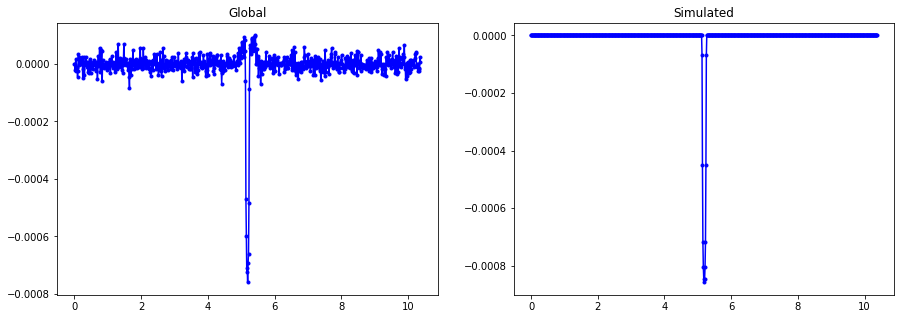

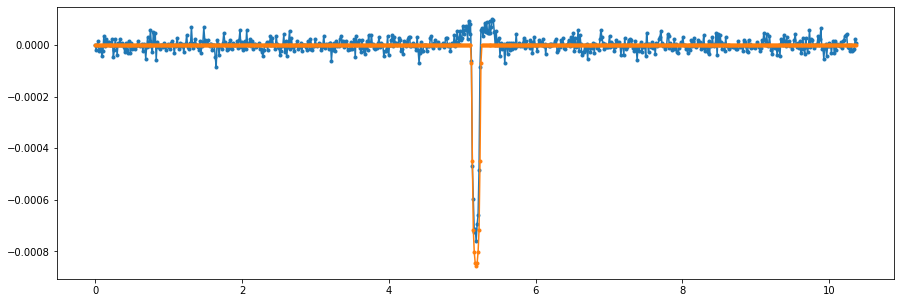

error en global=  0.4378857792080743
----------------------------------------------------------------
Dis score 1.000000, not transit flag 0.0 sec flag 0.0


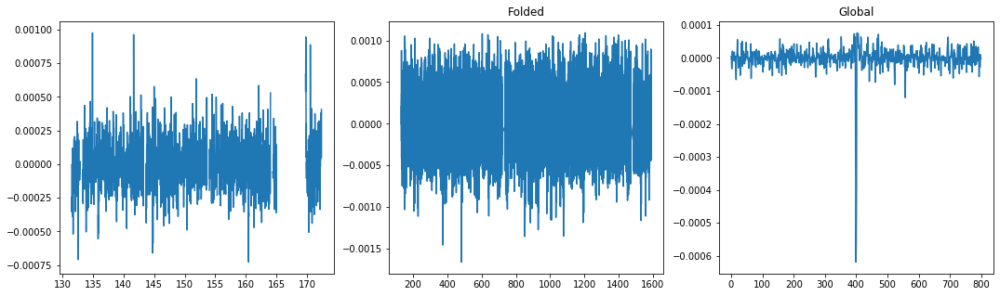

Max power:  0.001330071663734968
Second Max:  0.0013185827819046127


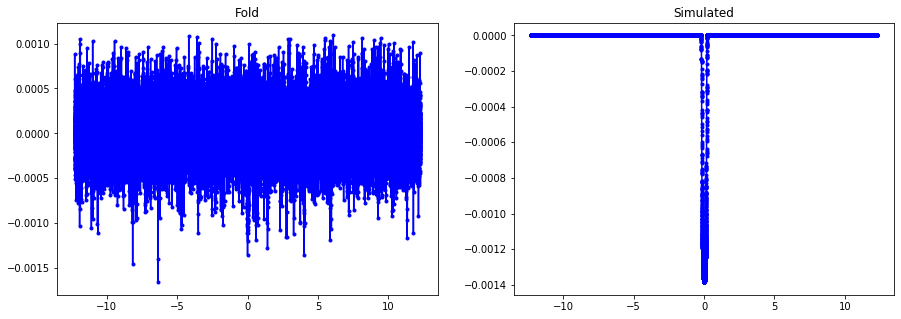

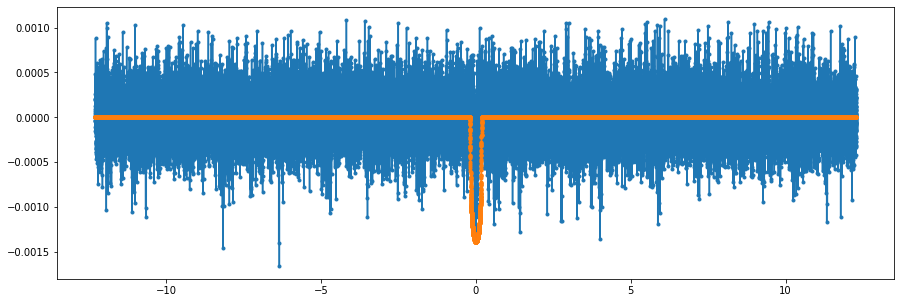

error en fold=  1.1507506835365744


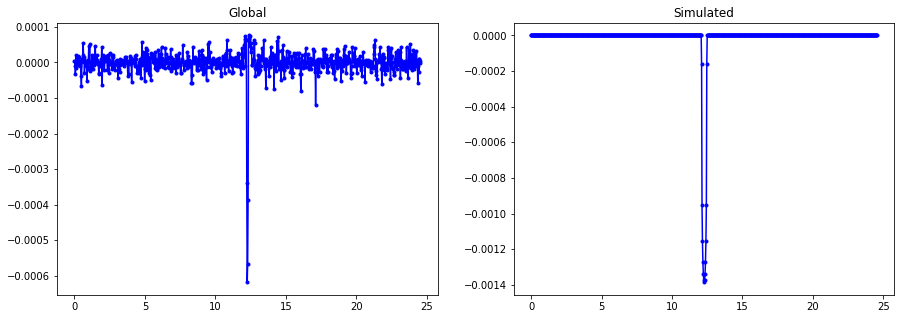

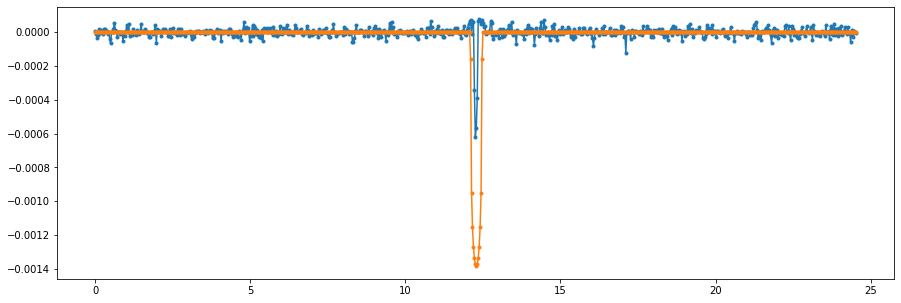

error en global=  3.203779330389739
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


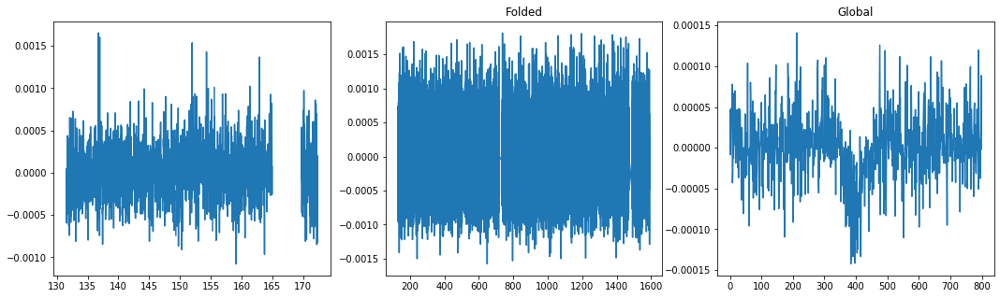

Max power:  0.001020956333326144
Second Max:  0.000992953842842069


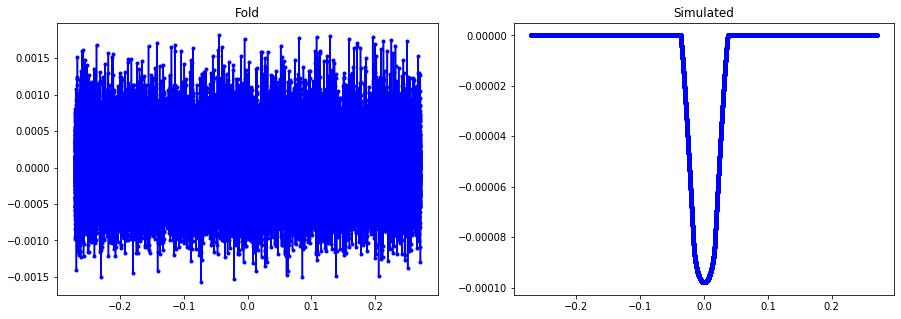

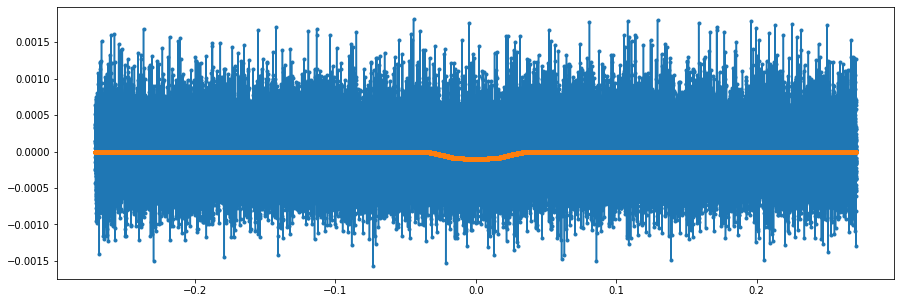

error en fold=  0.9992807947560132


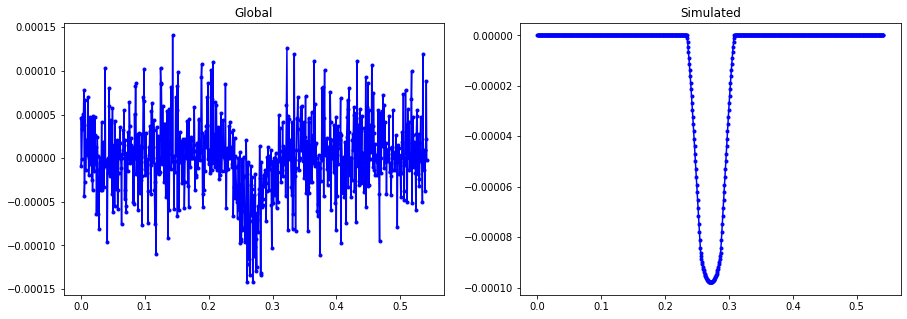

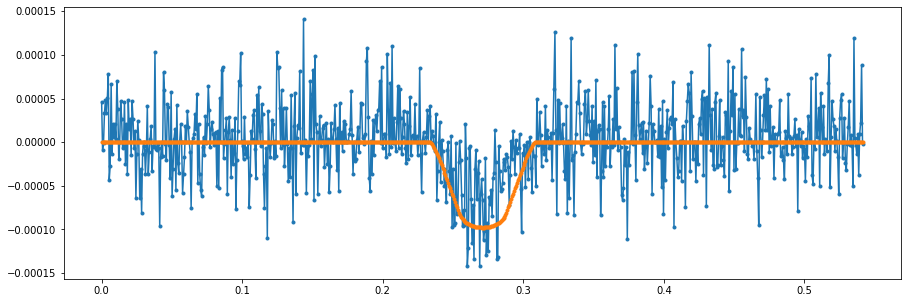

error en global=  0.9463278681978214
----------------------------------------------------------------
Dis score 0.957000, not transit flag 0.0 sec flag 0.0


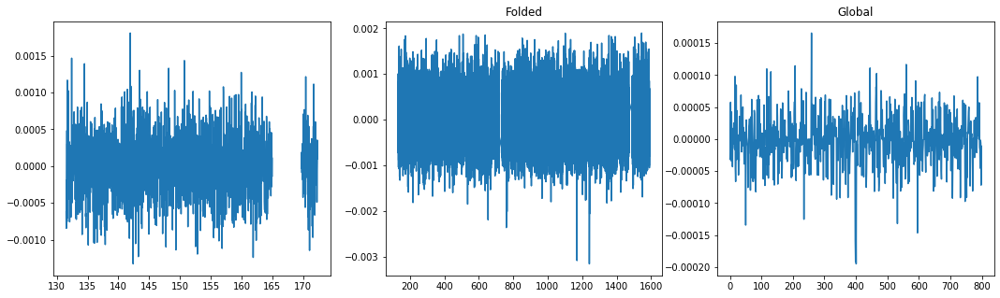

Max power:  0.0006892183899887437
Second Max:  0.0006828940827563193


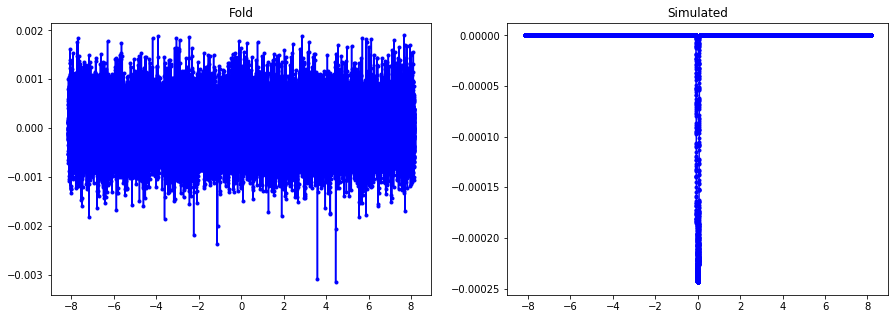

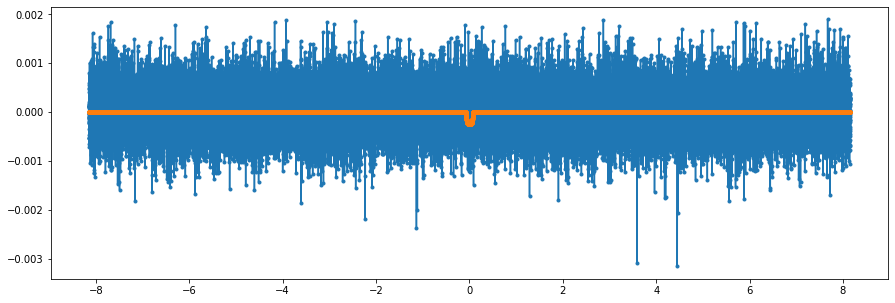

error en fold=  1.0003524058146713


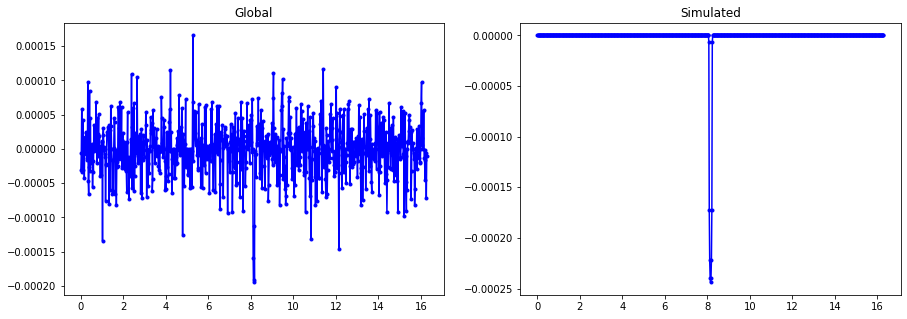

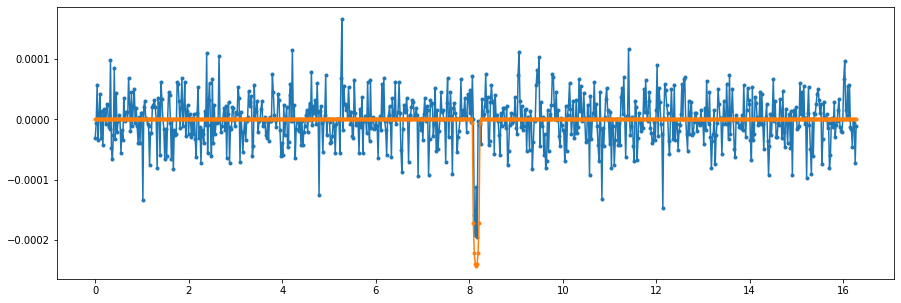

error en global=  1.0071963832069004
----------------------------------------------------------------
Dis score 0.800000, not transit flag 0.0 sec flag 0.0


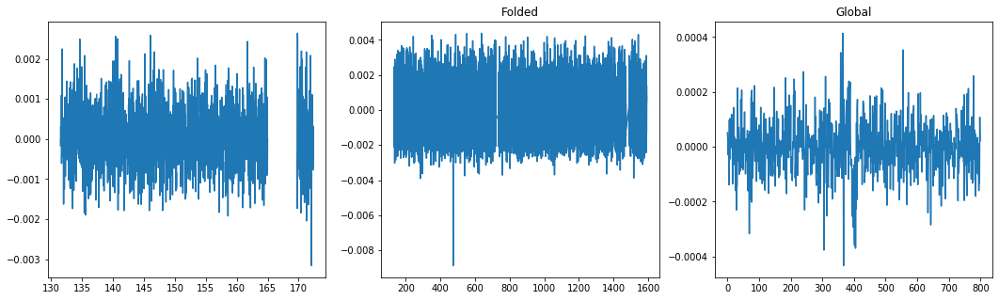

Max power:  0.0006284348680324526
Second Max:  0.0006221701415917115


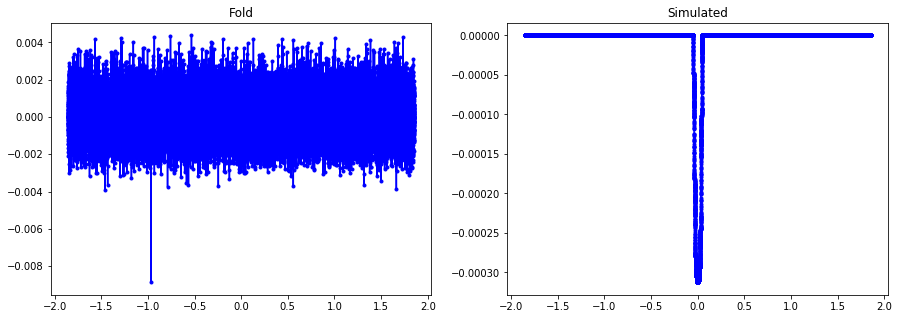

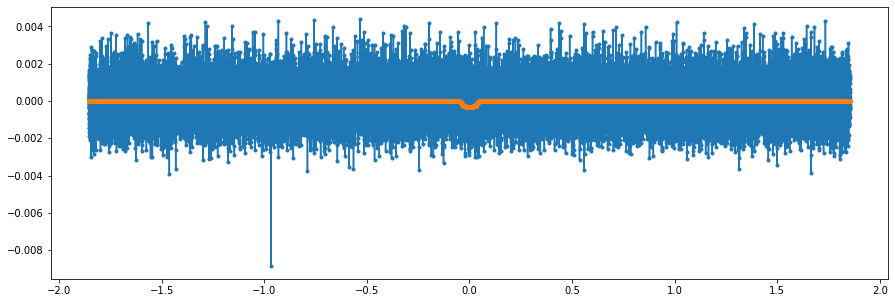

error en fold=  0.9995833033356659


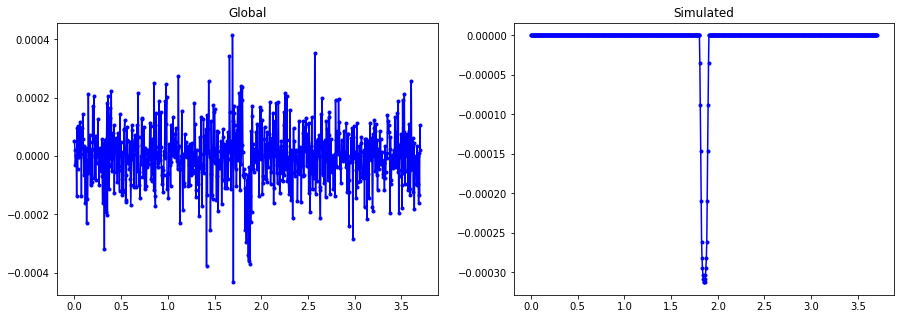

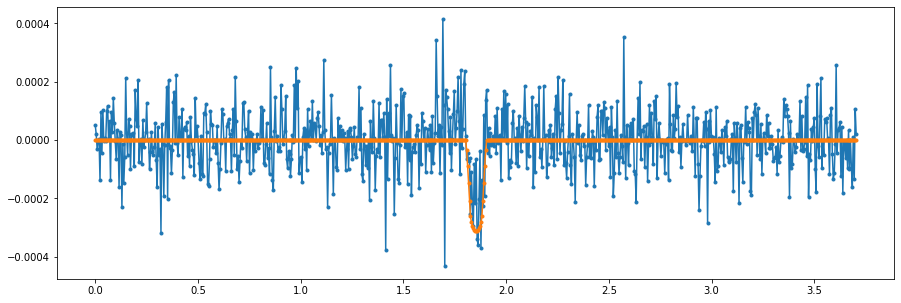

error en global=  0.9709555547241999
----------------------------------------------------------------
Dis score 0.998000, not transit flag 0.0 sec flag 0.0


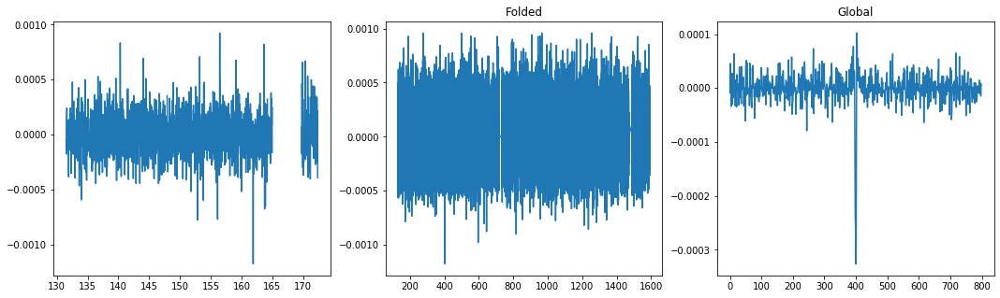

Max power:  0.0006631123787078014
Second Max:  0.0006627583551555612


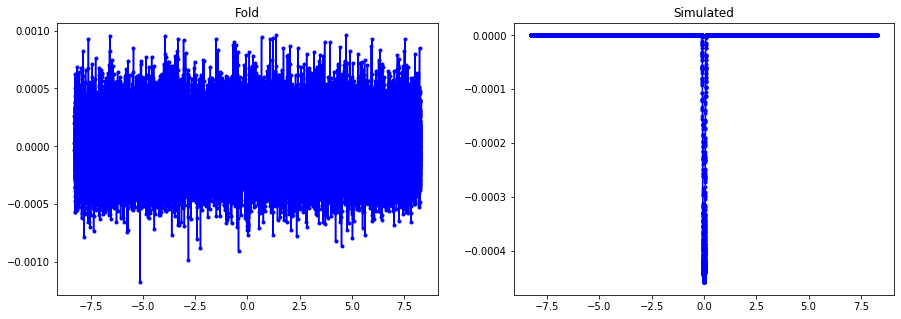

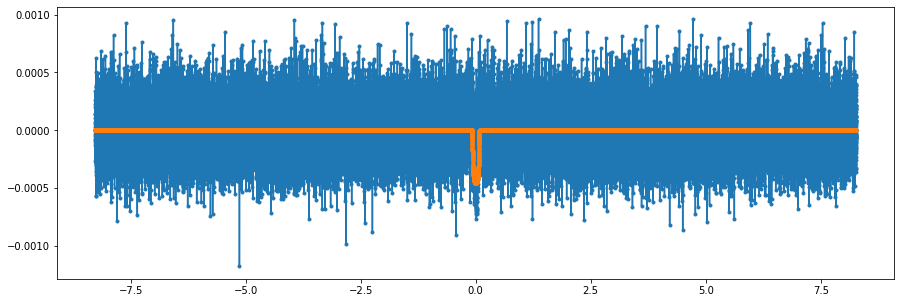

error en fold=  1.0008139036728152


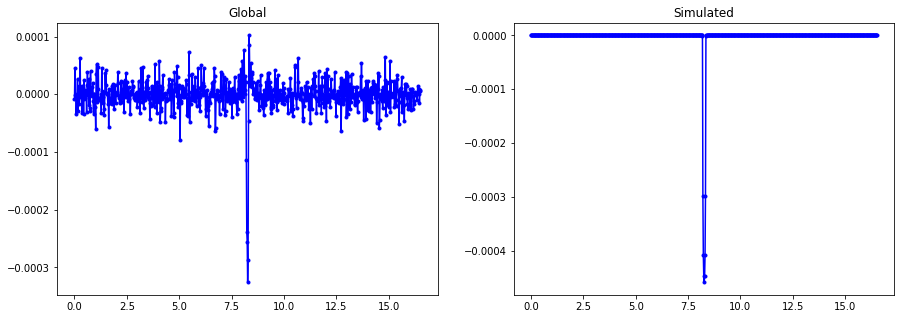

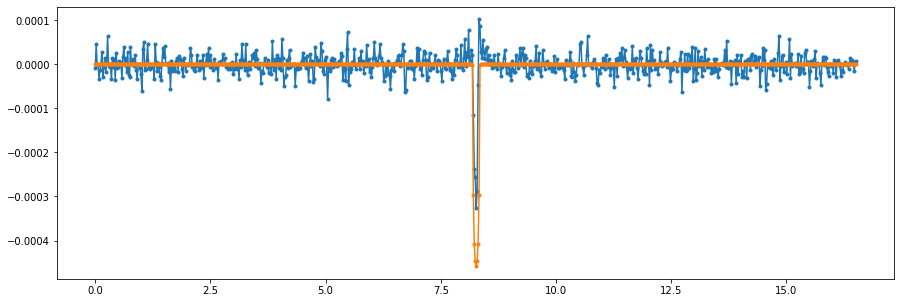

error en global=  1.0689723363973926
----------------------------------------------------------------
Dis score 0.000000, not transit flag 1.0 sec flag 0.0


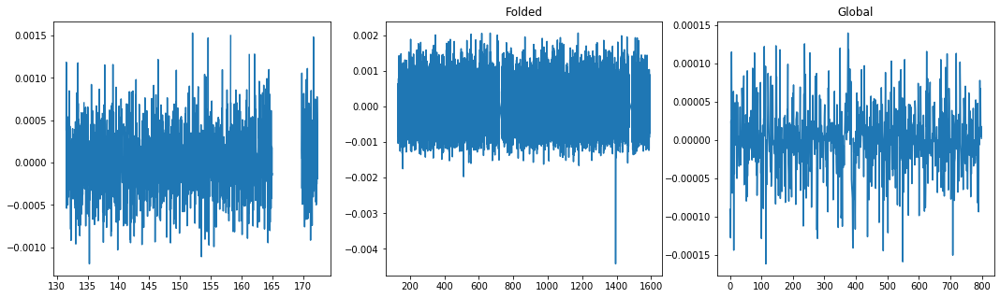

Max power:  0.0004194850540646069
Second Max:  0.00040660659509606303


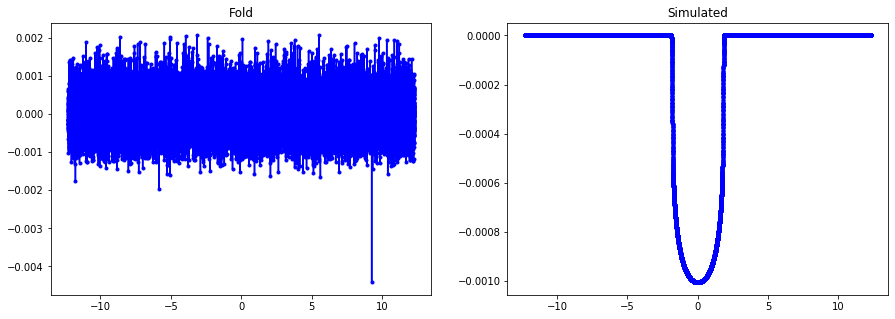

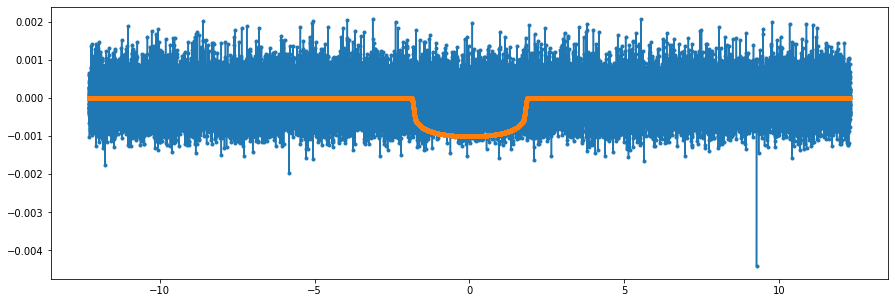

error en fold=  1.3042250414382388


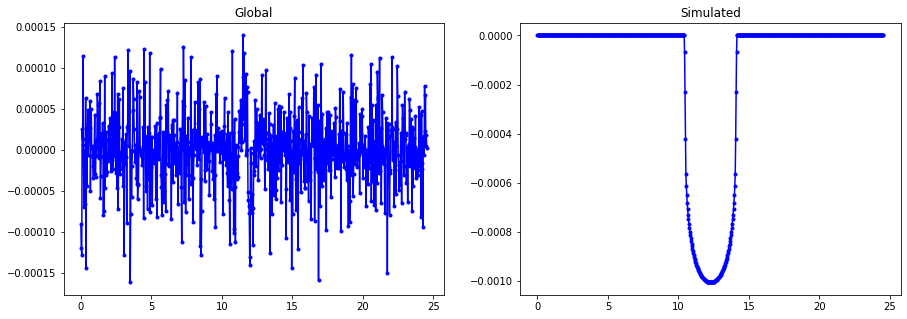

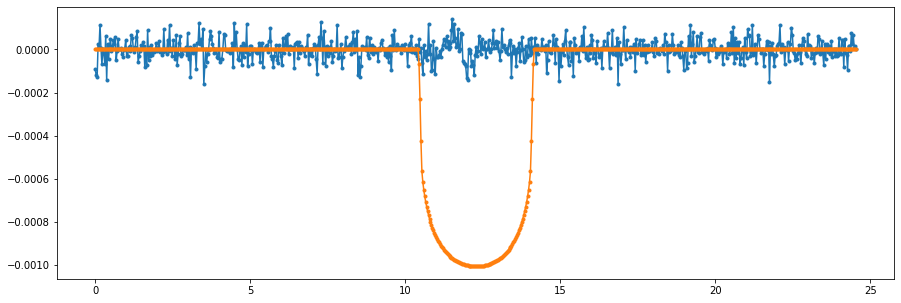

error en global=  7.6647889645860365
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


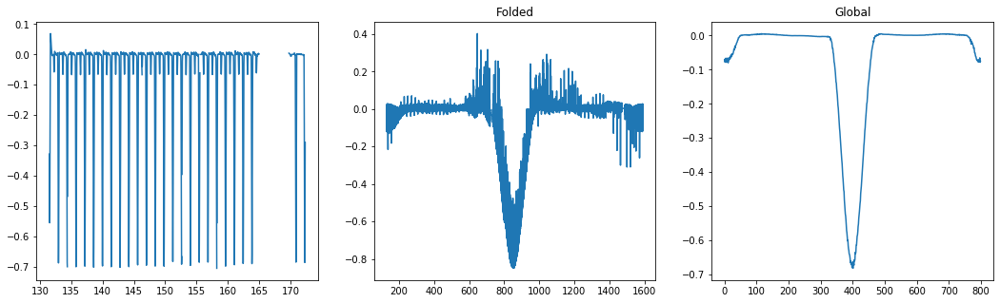

Max power:  0.26237315767243125
Second Max:  0.2564513459678377
ERROR, CURVA ELIMINADO DE INMEDIATO
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


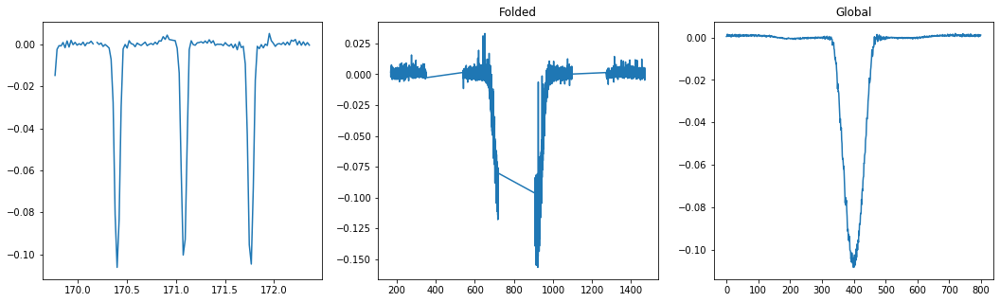

Max power:  0.2557400501001024
Second Max:  0.24933709224874884


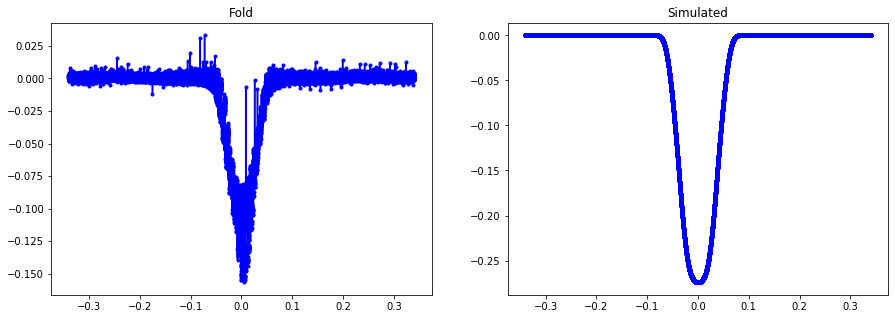

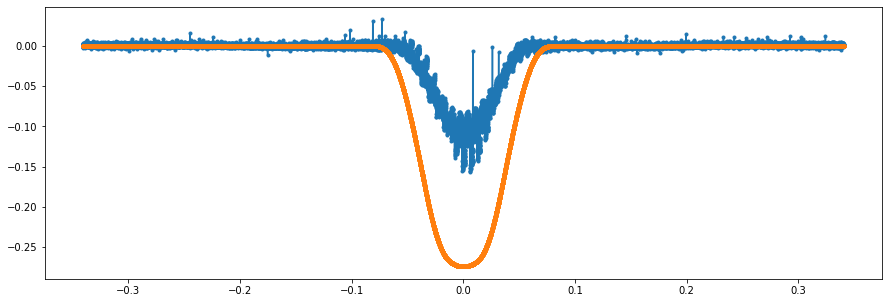

error en fold=  2.1568138354815165


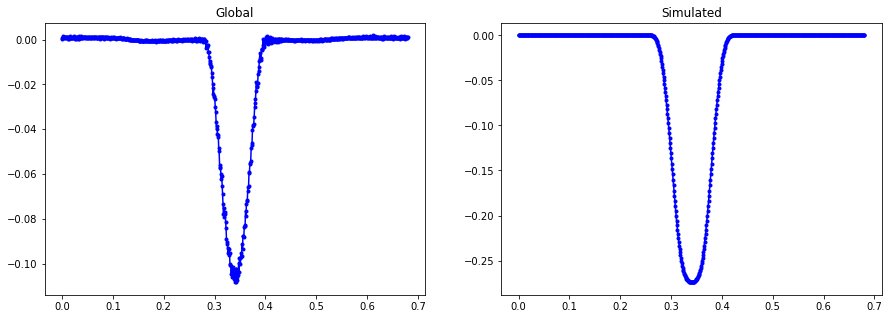

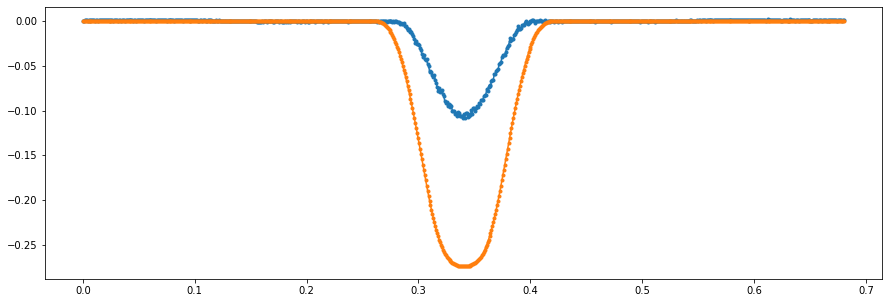

error en global=  2.224752187772227
----------------------------------------------------------------
Dis score 0.966000, not transit flag 0.0 sec flag 0.0


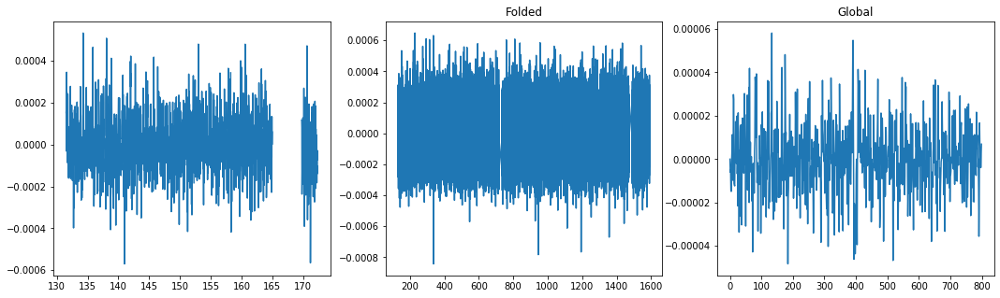

Max power:  0.005334563702428149
Second Max:  0.004777979577276199


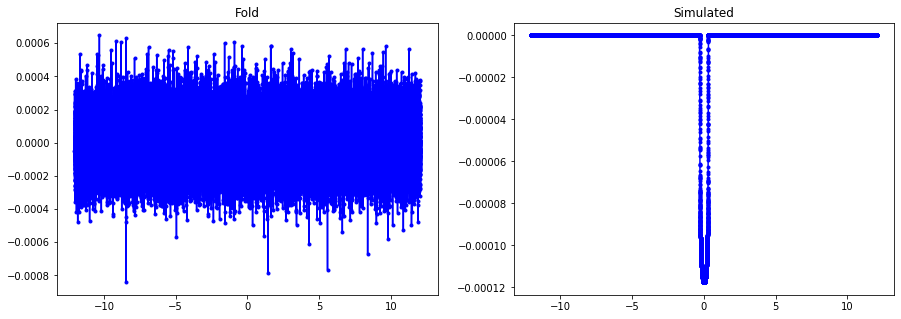

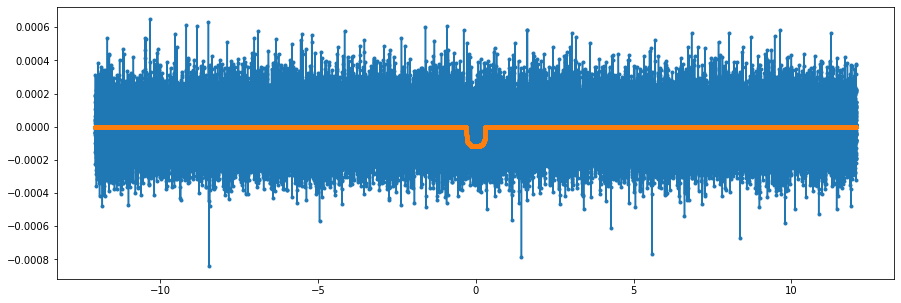

error en fold=  1.0067742776097246


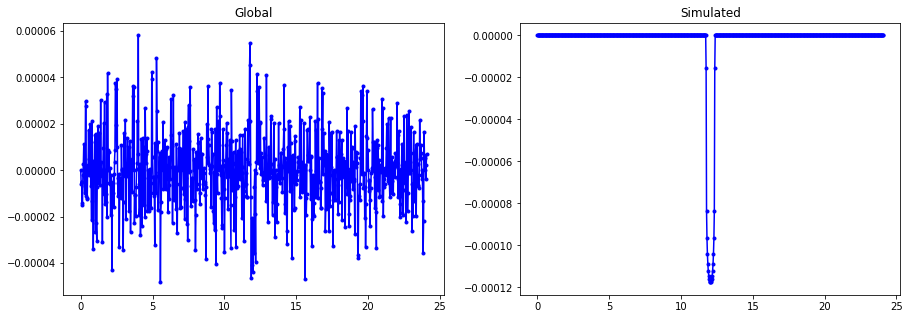

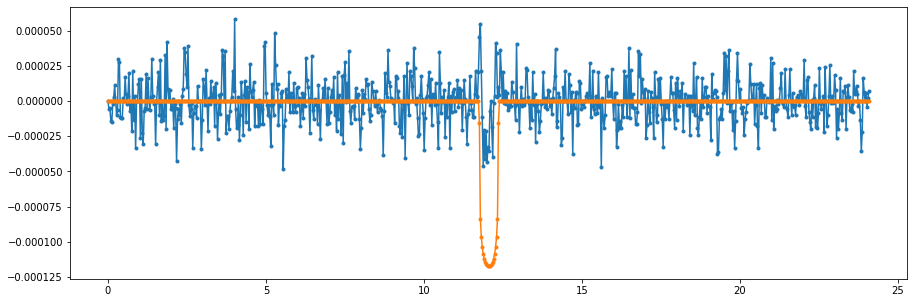

error en global=  1.3972326130288204
----------------------------------------------------------------
Dis score 0.441000, not transit flag 0.0 sec flag 0.0


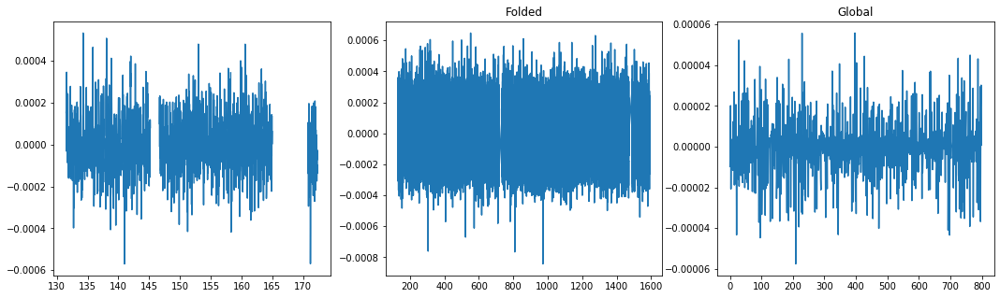

Max power:  0.00466360636113477
Second Max:  0.004304249552790449


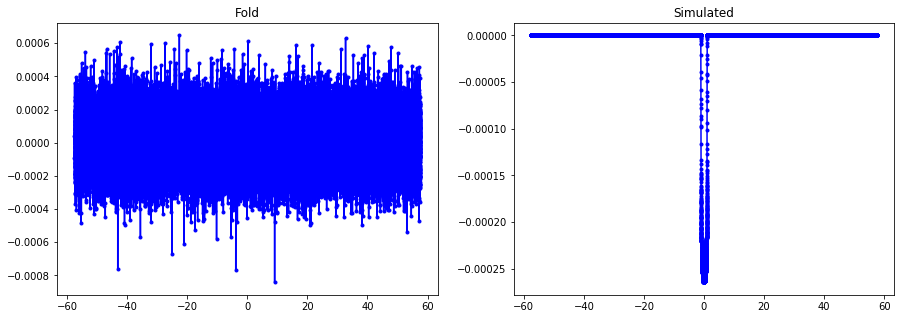

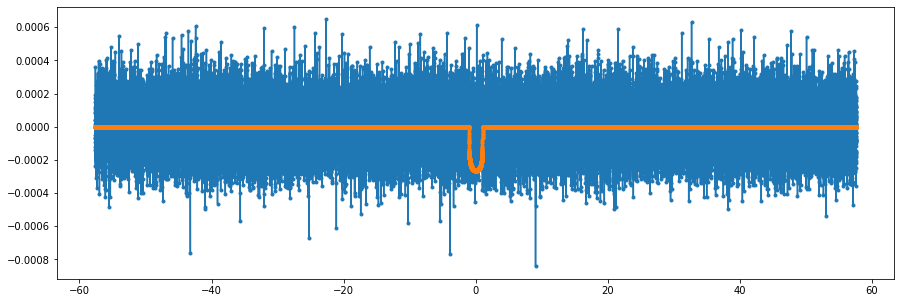

error en fold=  1.0333484655119263


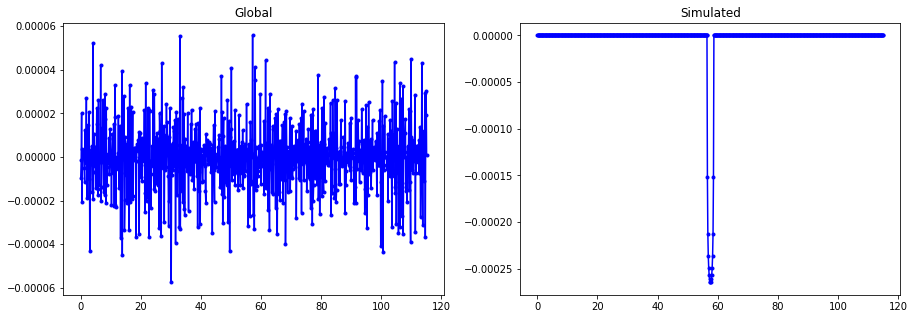

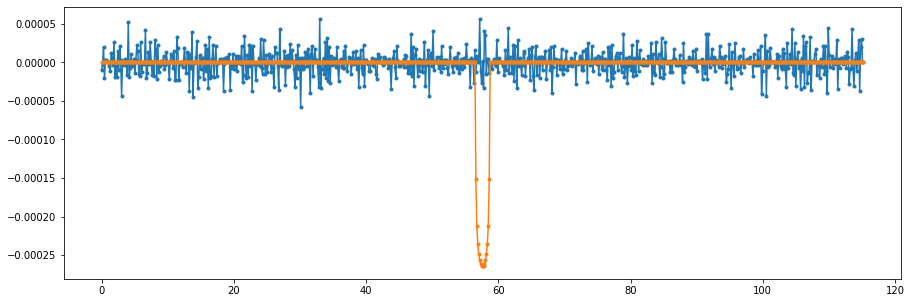

error en global=  2.3286557764258786
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


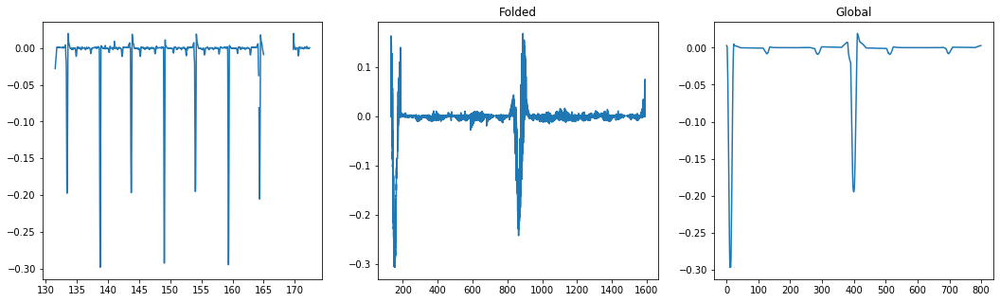

Max power:  0.06466662327996602
Second Max:  0.06389338715228025


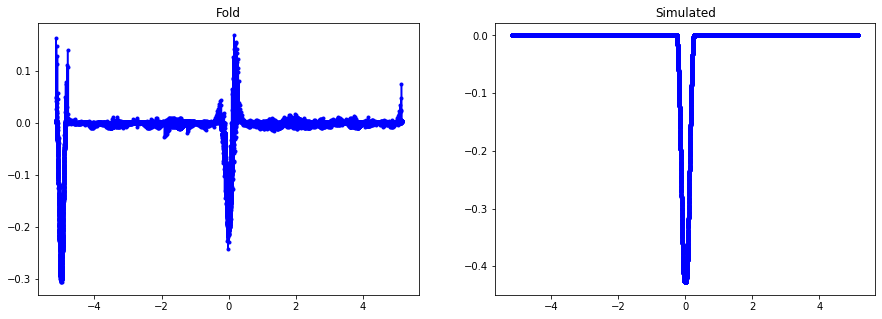

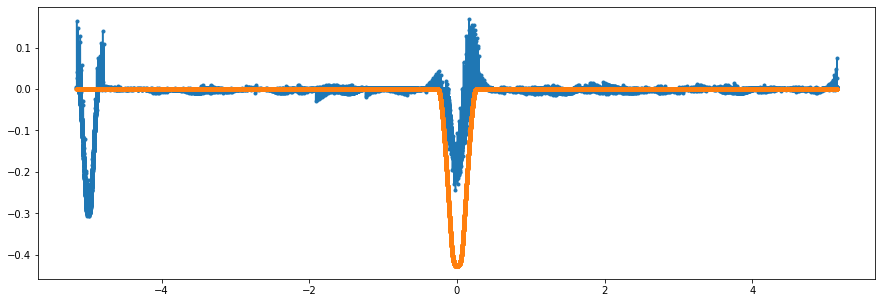

error en fold=  1.3996270343298869


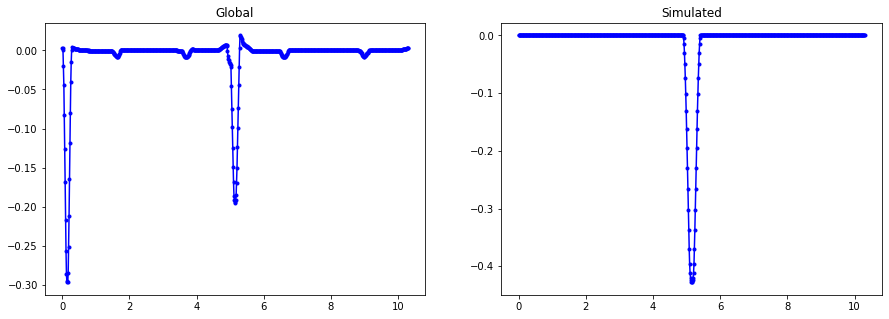

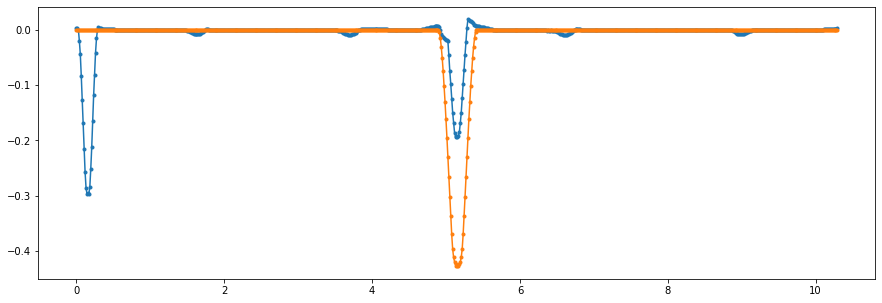

error en global=  1.4157773722627909
----------------------------------------------------------------
Dis score 0.752000, not transit flag 0.0 sec flag 0.0


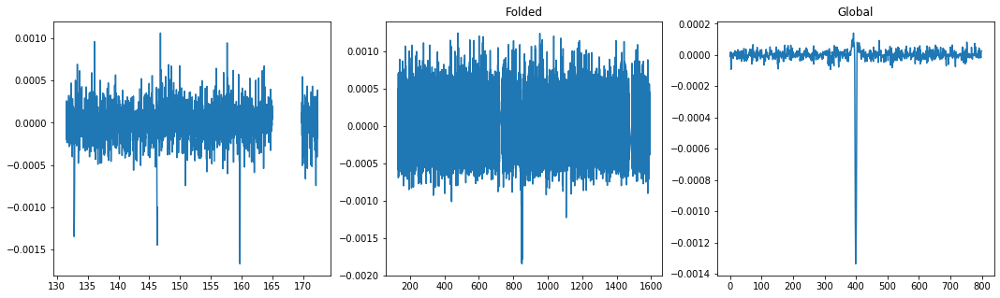

Max power:  0.002793789267497399
Second Max:  0.002618006841358216


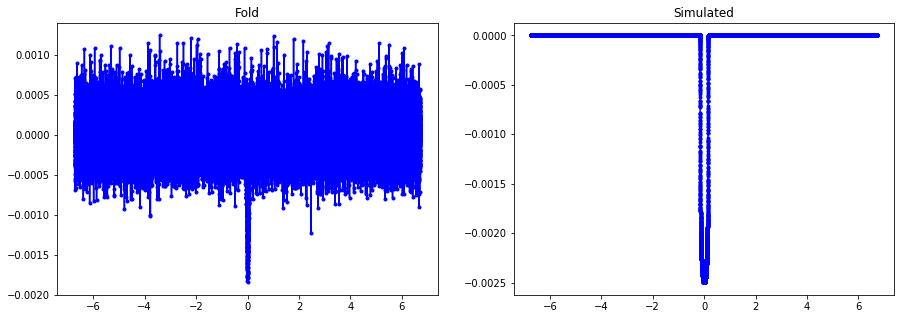

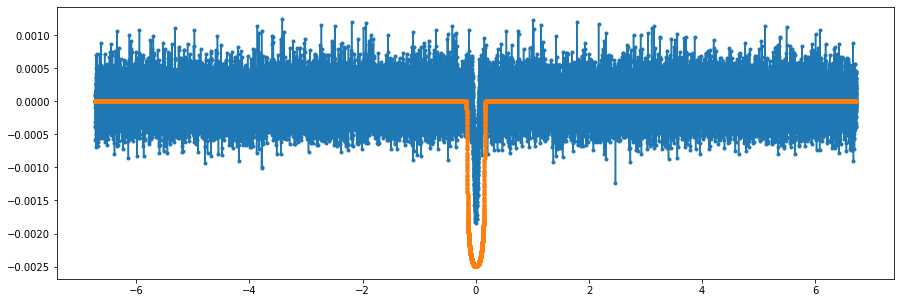

error en fold=  1.5426734072015813


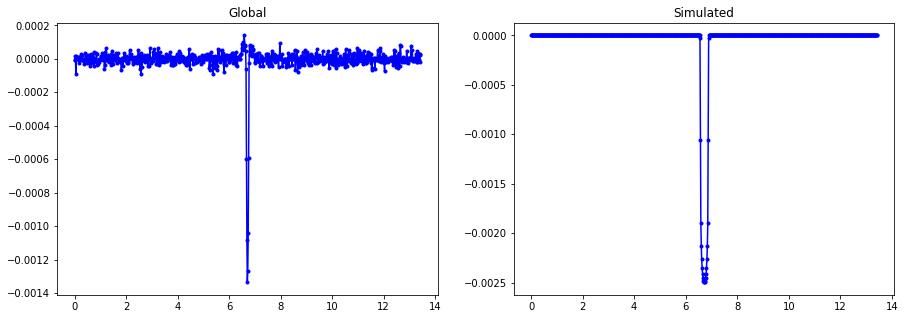

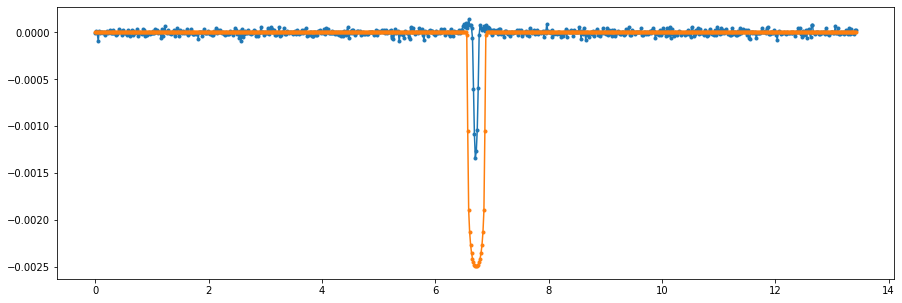

error en global=  3.28007866699605
----------------------------------------------------------------
Dis score 0.000000, not transit flag 0.0 sec flag 1.0


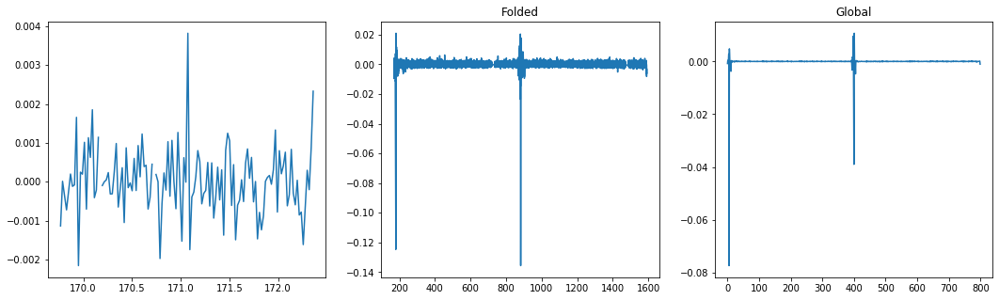

Max power:  0.0043758365696135075
Second Max:  0.004273722611896993


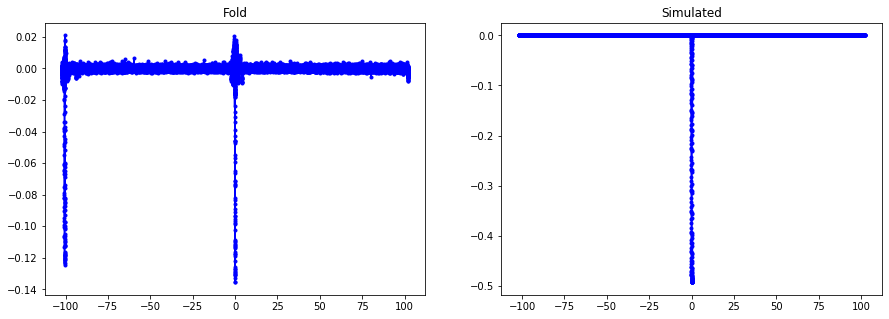

In [ ]:
from astropy.timeseries import BoxLeastSquares, LombScargle
import os, sys
dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import *
import pysyzygy as ps


to =2000
T = 800
for i in range(N):
    nflag, ds, sflag = df_meta[["Transit Flag","Disposition Score","Secondary Flag"]].values[i]
    
    print("Dis score %f, not transit flag %s sec flag %s"%(ds,nflag,sflag))
    #error de la curva real vs mandel agol? con librerias?
    
    f, axarr = plt.subplots(1,3, figsize=(18,5))
    
    axarr[0].plot(time_kepler[i][:to],process_lc[i][:to])
    #plt.show()
    
    per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[i]
    t = coupled_time[i]
    y = coupled_lc_scaled[i]

    t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)

    val_glo = global_view(t_fold, val_fold, period=per, num_bins=T, bin_width_factor=1 / T)
    
    axarr[1].plot(t,val_fold)
    axarr[1].set_title("Folded")
    #plt.show()
    
    axarr[2].plot(val_glo)
    axarr[2].set_title("Global")
    plt.show()
    
    
    model = LombScargle(t, y, center_data=False, fit_mean=True)
    freqs_t, periodogram = model.autopower(method='fast')
    periods_t = 1/freqs_t    
    val_s = np.sort(periodogram)[::-1]
    print("Max power: ",val_s[0])
    print("Second Max: ",val_s[1])
    plt.show()
    
    metadata_n = df_meta.iloc[i]
    period = metadata_n["Period"]
    duration = metadata_n["Duration"]/24
    a_R = metadata_n["a/R"]
    t_0 = 0 #trabajando con folds.. #metadata_n["Time of Transit Epoch"]-t[0] #start on 0
    r_R = metadata_n["r/R"]
    inclination = metadata_n["Inclination"]
    u1 = metadata_n["Limb Darkening Coeff1"]
    u2 = metadata_n["Limb Darkening Coeff2"]
    model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, maxpts=65000) 
    try:
        lc_simulated = model(t_fold) #primer error/contratiempo encontrado (TIEMPO)
    except:
        print("ERROR, CURVA ELIMINADO DE INMEDIATO")
        continue
    
    #pre-process simualted
    #lc_simulated = process_found(lc_simulated, plot_show=False, divided=False)
    lc_simulated -=1 #approx the same..

    f, (ax1, ax2) = plt.subplots(1, 2, sharex=True,figsize= (15,5))
    ax1.plot(t_fold, val_fold , 'b.-')
    ax1.set_title("Fold")
    ax2.plot(t_fold, lc_simulated, 'b.-')
    ax2.set_title("Simulated")
    plt.show()

    plt.figure(figsize=(15,5))
    plt.plot(t_fold, val_fold , '.-')
    plt.plot(t_fold, lc_simulated, '.-')
    plt.show()
    
    mse_resid = np.sqrt(np.nanmean(np.square(val_fold - lc_simulated)))
    mse_resid /= np.std(val_fold)
    print("error en fold= ",mse_resid)

    
    t_glo = np.cumsum(np.concatenate([[0], np.tile(per/T, T-1)]) )
    t_0 = t_glo[int(np.round(T/2))]
    model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, maxpts=65000) 
    lc_simulated = model(t_glo)-1 
    
    f, (ax1, ax2) = plt.subplots(1, 2, sharex=True,figsize= (15,5))
    ax1.plot(t_glo, val_glo , 'b.-')
    ax1.set_title("Global")
    ax2.plot(t_glo, lc_simulated, 'b.-')
    ax2.set_title("Simulated")
    plt.show()

    plt.figure(figsize=(15,5))
    plt.plot(t_glo, val_glo , '.-')
    plt.plot(t_glo, lc_simulated, '.-')
    plt.show() 
    
    mse_resid = np.sqrt(np.nanmean(np.square(val_glo - lc_simulated)))
    mse_resid /= np.std(val_glo)
    print("error en global= ",mse_resid)
    
    print("----------------------------------------------------------------")

In [ ]:
from transitleastsquares import transitleastsquares as TLS


#chequear..

if transit and not seq eclipse: #borrar seq eclipse??
    if dis_score > 0.55: #mayor o igual a 0.3 minimo  (o 0.55)
        save..
    else: #egunda opcion
        if max_power > 0.0007: #o que sea dis score + esto??
            save
#el resto se borra 

In [13]:
from astropy.timeseries import BoxLeastSquares, LombScargle
import os, sys
dirpath = os.getcwd().split("code")[0]+"code/"
sys.path.append(dirpath)
from pre_process import *
import pysyzygy as ps
T = 800

mask_train = np.zeros(N, dtype='bool')
for n in range(N):
    if n%500 == 0:
        print("Va en el, ",n)
        
    nflag, ds, sflag = df_meta[["Transit Flag","Disposition Score","Secondary Flag"]].values[n]

    if not nflag and not sflag: #borrar seq eclipse??
        if ds > 0.55: #mayor o igual a 0.3 minimo  (o 0.55)
            mask_train[n] = True
        else:
            #usar Mandel-Agol
            per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[n]
            t = coupled_time[n]
            y = coupled_lc_scaled[n]

            t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)
            val_glo = global_view(t_fold, val_fold, period=per, num_bins=T, bin_width_factor=1 / T)
            
            metadata_n = df_meta.iloc[n]
            period = metadata_n["Period"]
            duration = metadata_n["Duration"]/24
            a_R = metadata_n["a/R"]
            r_R = metadata_n["r/R"]
            inclination = metadata_n["Inclination"]
            u1 = metadata_n["Limb Darkening Coeff1"]
            u2 = metadata_n["Limb Darkening Coeff2"]
            
            t_glo = np.cumsum(np.concatenate([[0], np.tile(per/T, T-1)]) )
            t_0 = t_glo[int(np.round(T/2))]
            model = ps.Transit(per = period, RpRs = r_R, t0 = t_0, u1=u1,u2=u2, aRs= a_R, maxpts=65000) 
            try:
                lc_simulated = model(t_glo)-1 #primer error/contratiempo encontrado (TIEMPO)
            except:
                print("ERROR, CURVA ELIMINADO DE INMEDIATO")
                continue

            mse_resid = np.sqrt(np.nanmean(np.square(val_glo - lc_simulated)))
            mse_resid /= np.std(val_glo)
            if mse_resid < 1:
                mask_train[n] = True
    else:
        pass #ya se elimina
print("Cantidad de datos dejados, ",np.sum(mask_train))

Va en el,  0
Va en el,  500
Va en el,  1000
Va en el,  1500
Va en el,  2000
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  2500
Va en el,  3000
Va en el,  3500
ERROR, CURVA ELIMINADO DE INMEDIATO
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  4000
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  4500
Va en el,  5000
Va en el,  5500
Va en el,  6000
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  6500
Va en el,  7000
Va en el,  7500
ERROR, CURVA ELIMINADO DE INMEDIATO
Va en el,  8000
Cantidad de datos dejados,  4317


### Create dataset

In [36]:
def std_scaler(x):
    mu = np.nanmean(x, axis=-1, keepdims=True)
    std = np.nanstd(x, axis=-1, keepdims=True)+1e-9
    return (x- mu)/std

def minmax_scaler(x, max_v,min_v):
    scale = 1 / (max_v - min_v)
    return scale * x - min_v * scale

#pre-process light curve
def set_scaler(x):
    #return x #o +1
    return std_scaler(x)

opciones:
0. std individual
1. Igual (de-trenden) escala original
2. Igual + 1 (simi a mandel-agol)
3. min-max scaler global
4. std global

### elimimando

In [15]:
T = 300 # CANTIDAD DE PUNTOS EN LA CURVA GLOBAL

X_fold_lc = []
X_fold_lc_aug = [] #con curvas invertidas
X_fold_time = []
for n in range(N):
    if n%500 == 0:
        print("Va en el, ",n)
        
    nflag, ds, sflag = df_meta[["Transit Flag","Disposition Score","Secondary Flag"]].values[n]
    
    if mask_train[n]: 
        per, t0, dur = df_meta_obj[["Period", "Time of Transit Epoch","Duration"]].values[n]
        t = coupled_time[n]
        y = coupled_lc_scaled[n]

        t_fold, val_fold = phase_fold_and_sort_light_curve(t, y, period= per, t0= t0)

        val_glo = global_view(t_fold, val_fold, period=per, num_bins=T, bin_width_factor=1 / T)
        #preprocess global..
        val_glo = set_scaler(val_glo)

        X_fold_lc.append(val_glo)

        #dos opciones para revertir
        t_fold_aug = t_fold#*-1
        val_fold_aug = val_fold[::-1]

        val_glo = global_view(t_fold_aug, val_fold_aug, period=per, num_bins=T, bin_width_factor=1 / T)
        #preprocess global..
        val_glo = set_scaler(val_glo)

        X_fold_lc_aug.append(val_glo)

        #t_glo = np.linspace(0, per, T)
        t_glo_diff = np.concatenate([[0], np.tile(per/T, T-1)])  #np.diff(t_glo)
        X_fold_time.append(t_glo_diff) #differences values
    
X_fold_lc = np.asarray(X_fold_lc)
X_fold_lc_aug = np.asarray(X_fold_lc_aug)
X_fold_time = np.asarray(X_fold_time)
X_fold_lc.shape

Va en el,  0
Va en el,  500
Va en el,  1000
Va en el,  1500
Va en el,  2000
Va en el,  2500
Va en el,  3000
Va en el,  3500
Va en el,  4000
Va en el,  4500
Va en el,  5000
Va en el,  5500
Va en el,  6000
Va en el,  6500
Va en el,  7000
Va en el,  7500
Va en el,  8000


(4317, 300)

In [26]:
np.save("data/LC_global_%dT.npy"%T,X_fold_lc)
np.save("data/LC_globalA_%dT.npy"%T,X_fold_lc_aug)
np.save("data/Time_global_%dT.npy"%T,X_fold_time)
print("Saved")

Saved


In [44]:
T = 200
X_fold_lc = np.load("data/LC_global_%dT.npy"%T)
X_fold_lc_aug = np.load("data/LC_globalA_%dT.npy"%T)
X_fold_time = np.load("data/Time_global_%dT.npy"%T)
X_fold_lc.shape

(4317, 200)

In [45]:
for i in range(X_fold_lc.shape[0]):
    X_fold_lc[i] = std_scaler(X_fold_lc[i])
    X_fold_lc_aug[i] = std_scaler(X_fold_lc_aug[i])

In [46]:
mask_train = np.random.rand(X_fold_lc.shape[0])<0.75
mask_test = ~mask_train

In [47]:
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train_t = np.concatenate([X_fold_time[mask_train], X_fold_time[mask_train]], axis=0)
#X_train = np.concatenate([X_fold_lc[mask_train[mask_conf]], X_fold_lc_aug[mask_train[mask_conf]]], axis=0)
X_train = np.concatenate([X_fold_lc[mask_train], X_fold_lc_aug[mask_train]], axis=0)

if Ystd_train.shape[0] != X_train.shape[0]:
    Ystd_train = np.tile(Ystd_train, (2,1))

#X_test = X_fold_lc[mask_test[mask_conf]]
X_test = X_fold_lc[mask_test]
#X_test_t = X_fold_time[mask_test[mask_conf]]
X_test_t = X_fold_time[mask_test]

X_train = np.expand_dims(X_train, axis=-1)
X_test = np.expand_dims(X_test, axis=-1)

X_train_t = np.expand_dims(X_train_t, axis=-1)
X_test_t = np.expand_dims(X_test_t, axis=-1)

print("X train shape: ",X_train.shape)
print("X train time shape: ",X_train_t.shape)
print("X test shape: ",X_test.shape)
print("Y train shape: ",Ystd_train.shape)
print("Y test shape: ",Ystd_test.shape)

X train shape:  (6494, 200, 1)
X train time shape:  (6494, 200, 1)
X test shape:  (1070, 200, 1)
Y train shape:  (6440, 13)
Y test shape:  (671, 13)


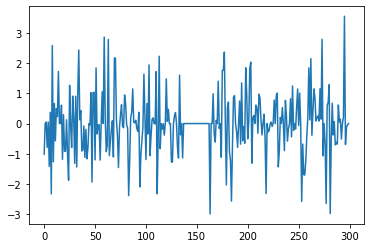

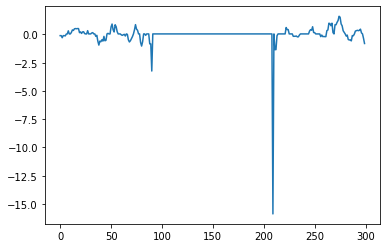

In [37]:
plt.plot(X_train[13,:,0])
plt.show()

plt.plot(X_train[13,:,1])
plt.show()

### Keras models

In [48]:
import keras
from keras import backend as K
from keras.models import Sequential, Model
from keras.layers import *

from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
import matplotlib.pyplot as plt
def plot_n_lc(real_lc, decoded_lc, n = 10):
    for _ in range(n):
        n_sampled = np.random.randint(0, real_lc.shape[0])
        
        f, (ax1, ax2) = plt.subplots(1, 2, sharex=True,figsize= (15,5))
        ax1.plot(real_lc[n_sampled], 'b.-')
        ax1.set_title("Real")
        ax2.plot(decoded_lc[n_sampled], 'b.-')
        ax2.set_title("Reconstructed")
        plt.show()  

        plt.figure(figsize=(15,5))
        plt.plot(real_lc[n_sampled], 'bo-', label="Real")
        plt.plot(decoded_lc[n_sampled], 'g*-', label="Reconstructed")
        plt.title("Over")
        plt.legend()
        plt.show()
        print("----------------------------------------------------------------")

In [49]:
latent_dim = 32
_, T, channels = X_train.shape
D_dim = 5 #o variar: Period", "Duration", "Time of Transit Epoch", "r/R", "a/R",

## Regular VAE

In [42]:
def sampling(args):
    z_mean, z_log_var = args
    epsilon = K.random_normal(shape=(K.shape(z_mean)[0], K.shape(z_mean)[1]), mean=0., stddev=1.)
    return z_mean + K.exp(0.5*z_log_var) * epsilon

def KL_loss(y_true, y_pred):
    return - 0.5 * K.sum(1 + z_log_var - K.square(z_mean) - K.exp(z_log_var), axis=-1)

#### IF THIS IS USED,, KL WEIGHT NEEDED TO BE LOW ######
def MSE_loss(y_true, y_pred):
    v = K.mean( K.square( y_true - y_pred ), axis=1) #on time axis..    
    return K.flatten(v)

#### HAS TO BE USED IN ORDER TO LEARN #######
def SSE_loss(y_true, y_pred):
    v = K.sum( K.square( y_true - y_pred ), axis=1) #on time axis..    
    return K.flatten(v)

def vae_loss(y_true, y_pred):
    l = 0.01 #kl weight
    return SSE_loss(y_true, y_pred) + l*KL_loss(y_true, y_pred)

### Con tiempo, asimilando la arquitectura de Naul

In [38]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 128
vae.fit([X_train_t,X_train], X_train, epochs=50, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 250, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 250, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108096      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 250, 1)       111873      T_inp[0][0]                      
          

KeyboardInterrupt: 

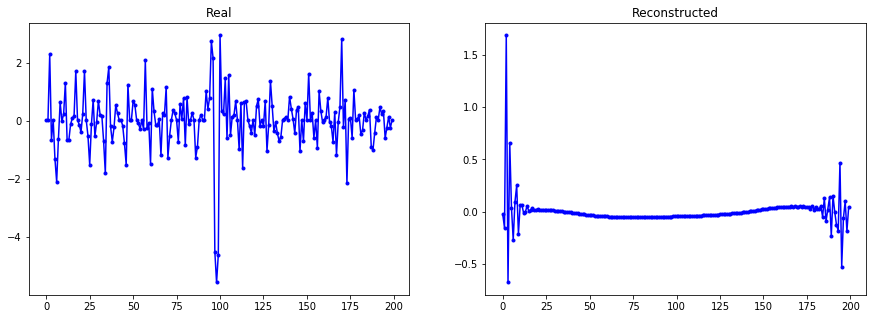

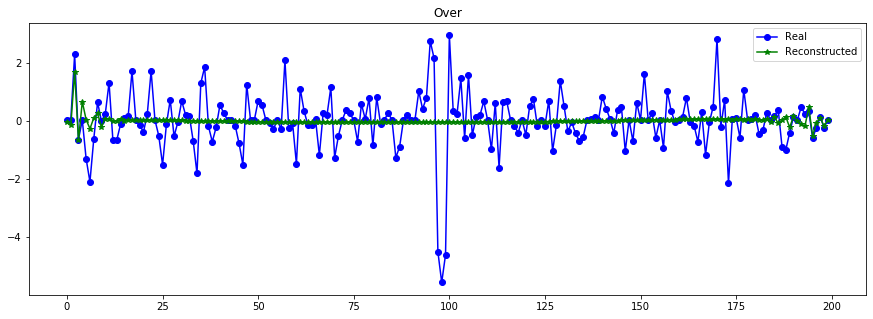

----------------------------------------------------------------


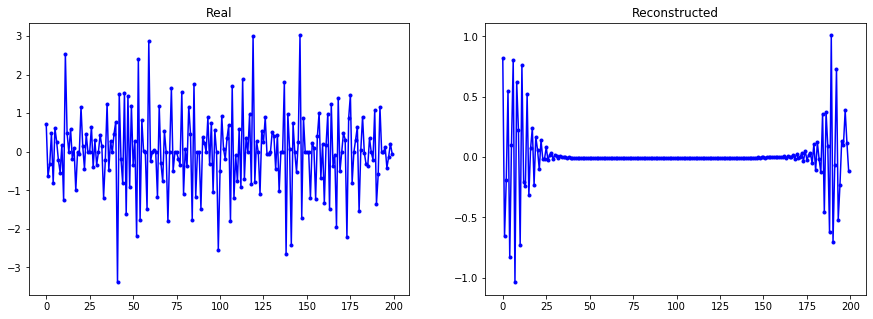

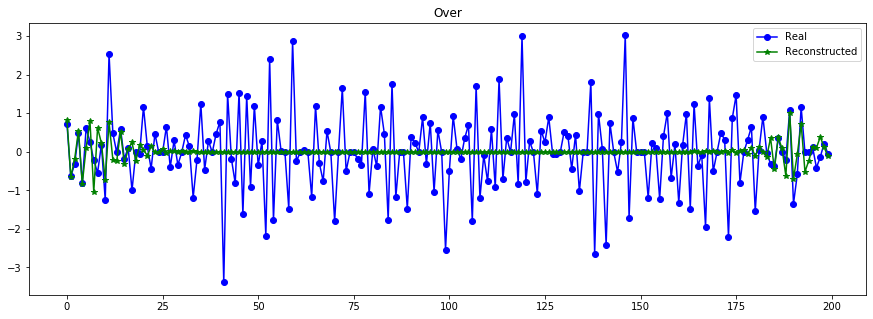

----------------------------------------------------------------


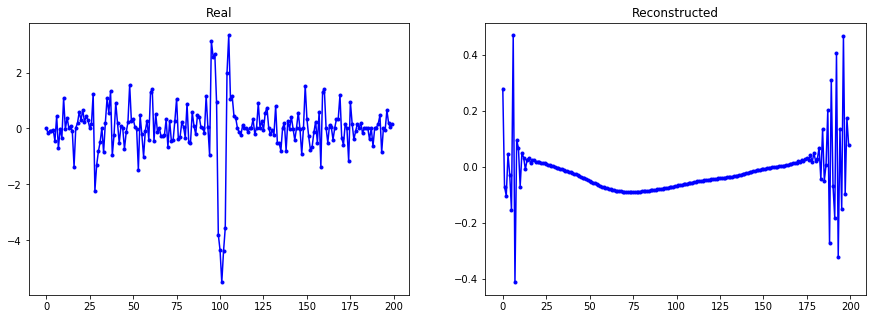

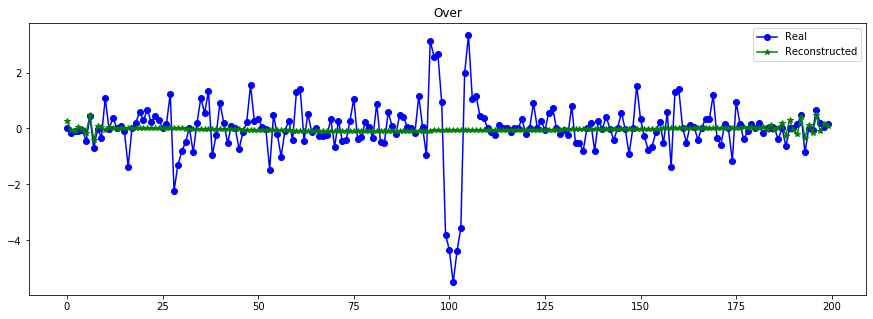

----------------------------------------------------------------


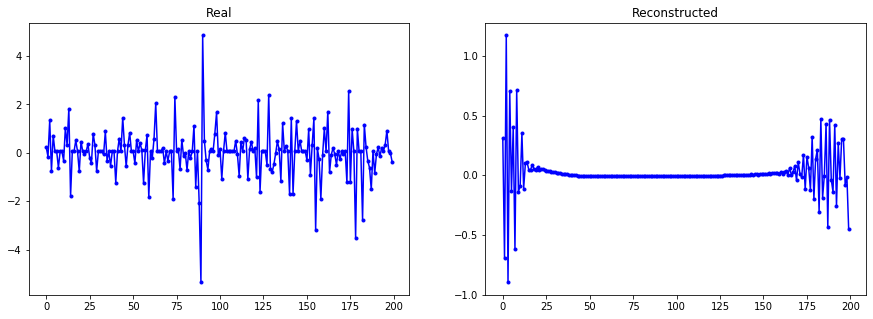

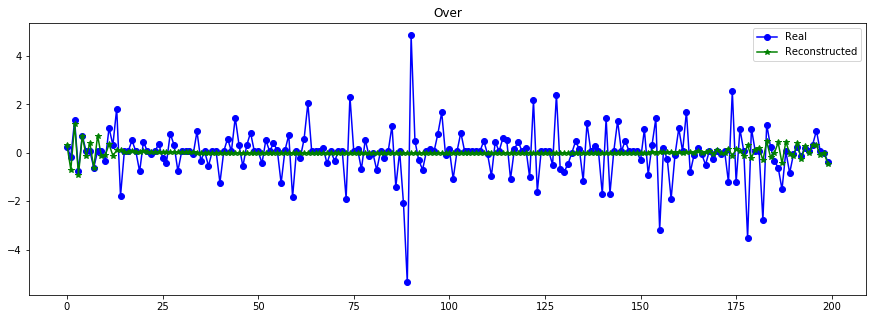

----------------------------------------------------------------


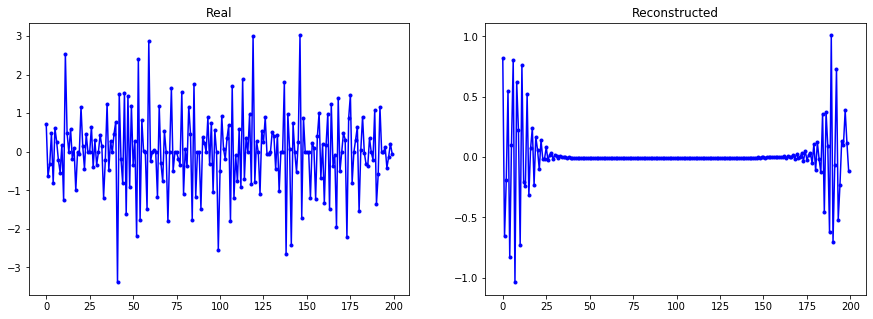

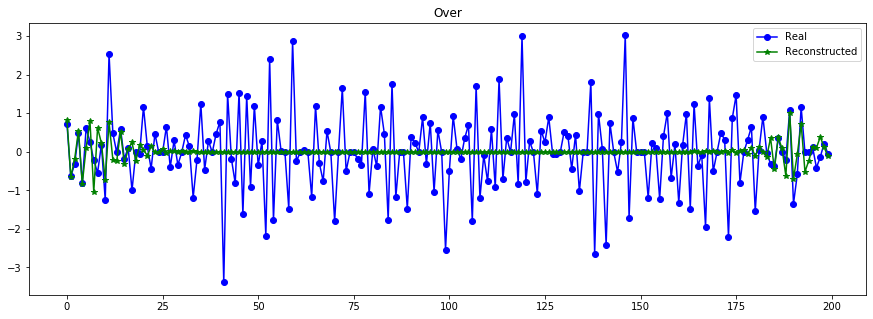

----------------------------------------------------------------


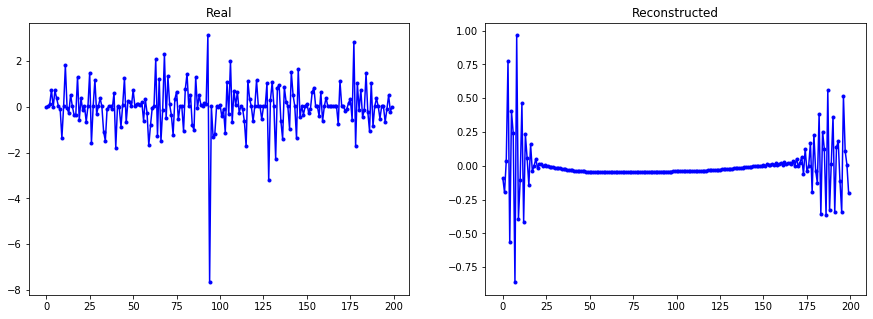

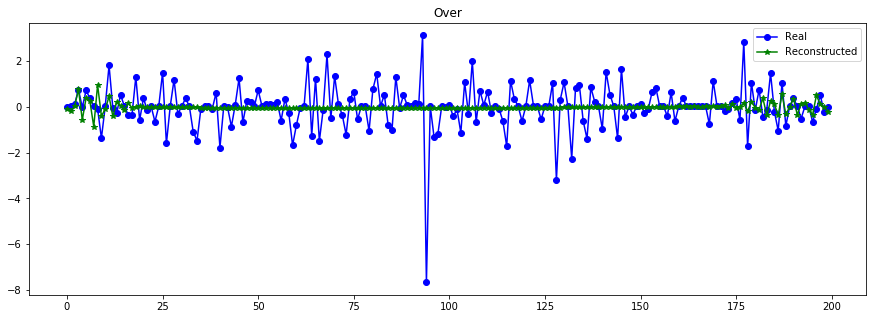

----------------------------------------------------------------


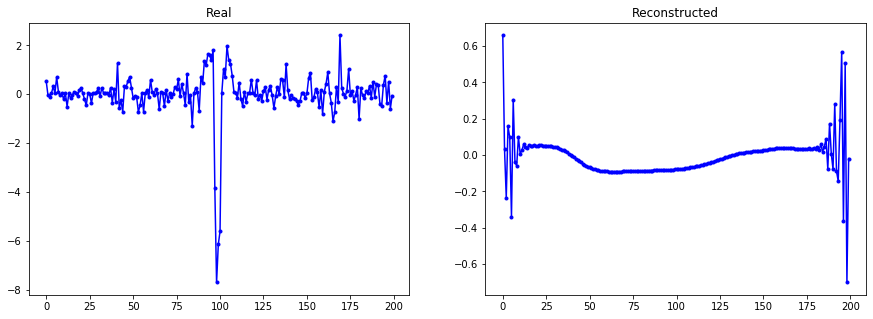

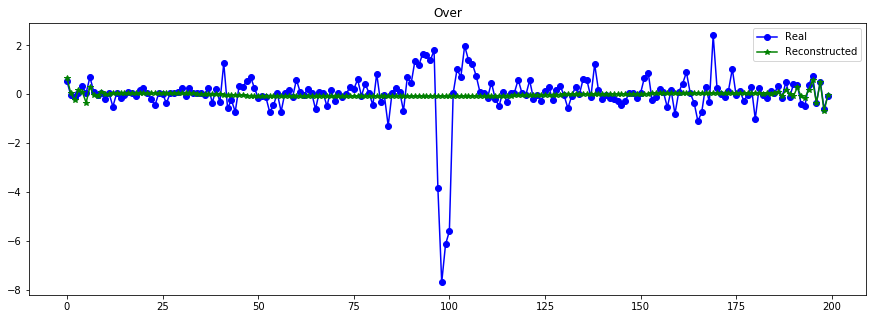

----------------------------------------------------------------


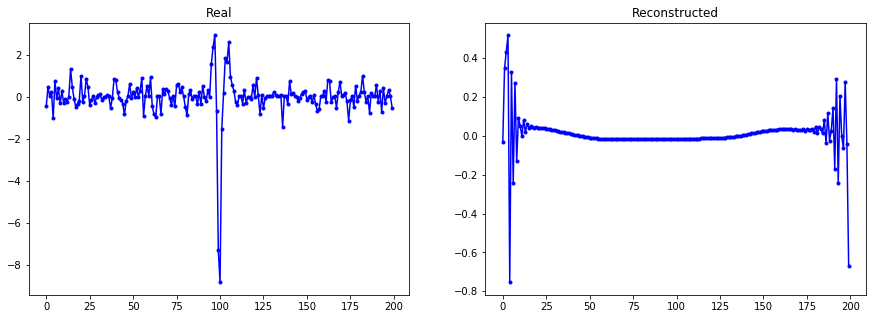

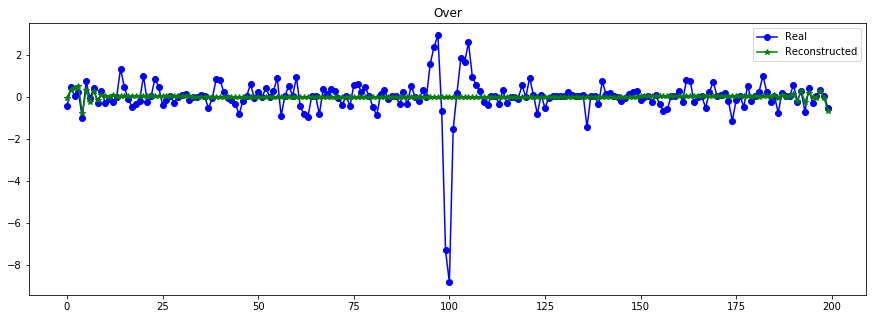

----------------------------------------------------------------


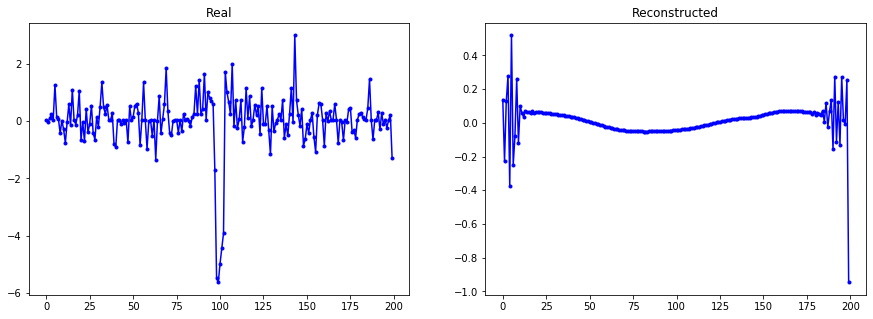

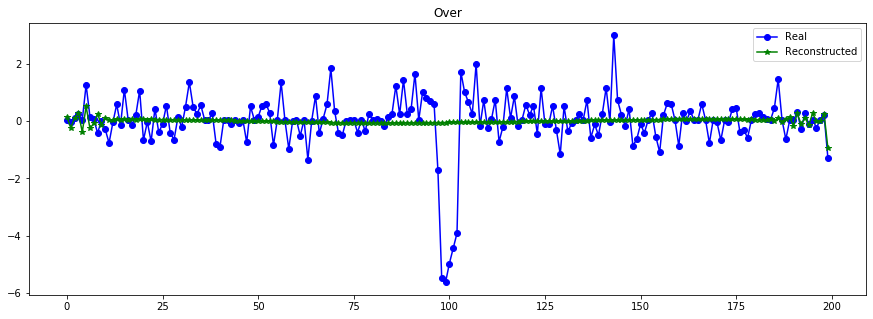

----------------------------------------------------------------


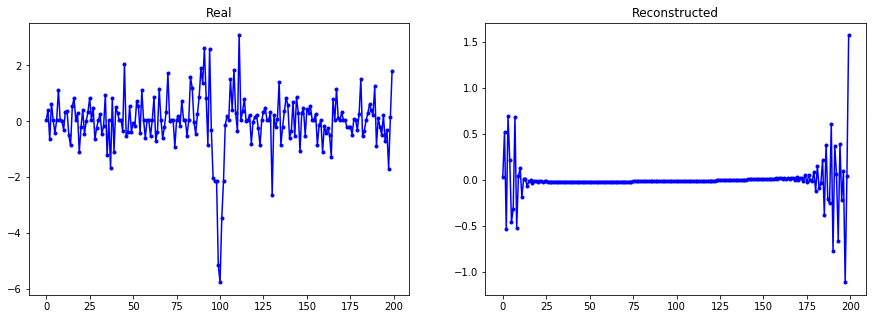

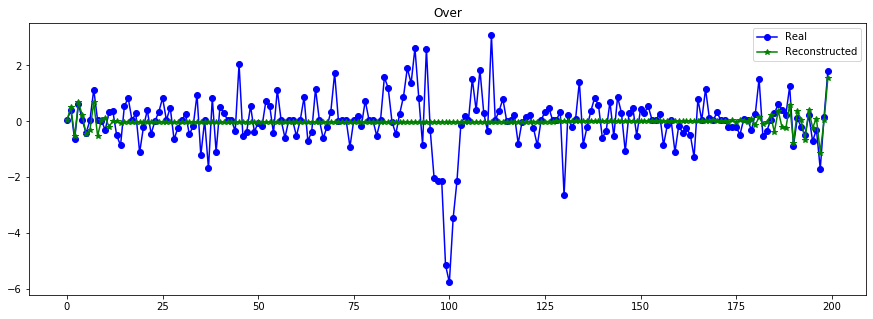

----------------------------------------------------------------


In [28]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10)

SI SIGUE MAL:
* BAJAR PESO A KL (0.1)
* AGREGAR DENSE ANTES DE REPEAT


In [ ]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, 1) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")


decoder_input = Input(shape=(latent_dim,))

decode = Dense(latent_dim, activation='relu')(decoder_input)


decode = RepeatVector(T)(decode)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 128
vae.fit([X_train_t,X_train], X_train, epochs=40, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108096      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       112929      T_inp[0][0]                      
          

6494/6494 [==============================] - 182s 28ms/step - loss: 196.1293 - KL_loss: 47.2678 - MSE_loss: 0.9783 - val_loss: 196.1878 - val_KL_loss: 48.6149 - val_MSE_loss: 0.9785
Epoch 36/40
6494/6494 [==============================] - 183s 28ms/step - loss: 195.8588 - KL_loss: 48.7620 - MSE_loss: 0.9769 - val_loss: 194.7375 - val_KL_loss: 51.1050 - val_MSE_loss: 0.9711
Epoch 37/40
6494/6494 [==============================] - 183s 28ms/step - loss: 197.0277 - KL_loss: 46.7984 - MSE_loss: 0.9828 - val_loss: 196.2997 - val_KL_loss: 42.1470 - val_MSE_loss: 0.9794
Epoch 38/40
6494/6494 [==============================] - 183s 28ms/step - loss: 196.1869 - KL_loss: 44.2851 - MSE_loss: 0.9787 - val_loss: 195.8514 - val_KL_loss: 46.5281 - val_MSE_loss: 0.9769
Epoch 39/40
6494/6494 [==============================] - 183s 28ms/step - loss: 195.8361 - KL_loss: 48.6264 - MSE_loss: 0.9767 - val_loss: 195.5154 - val_KL_loss: 52.2269 - val_MSE_loss: 0.9750
Epoch 40/40
3712/6494 [================>..

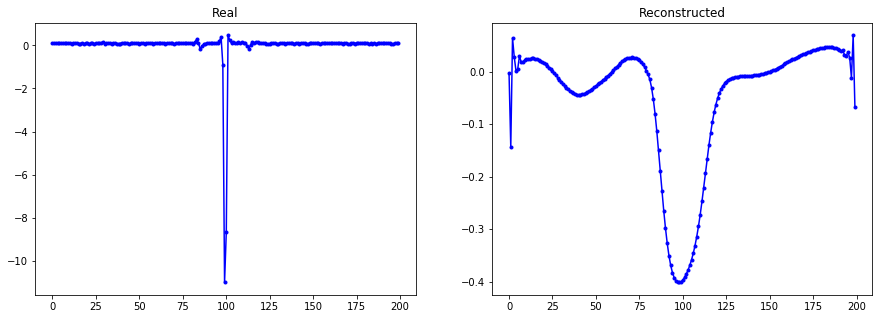

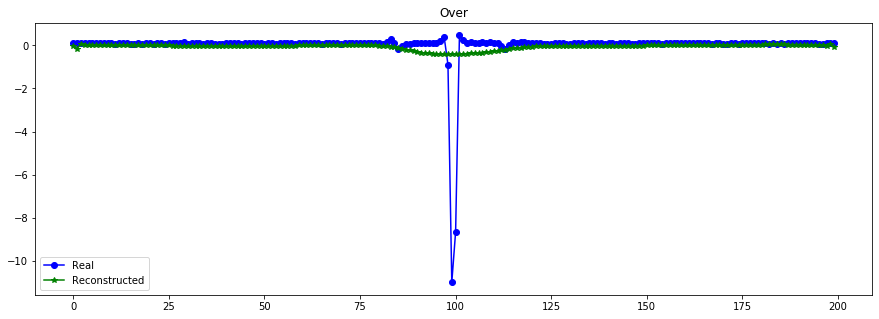

----------------------------------------------------------------


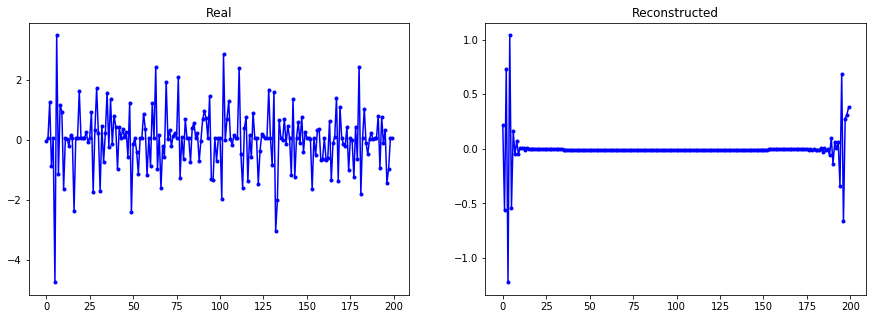

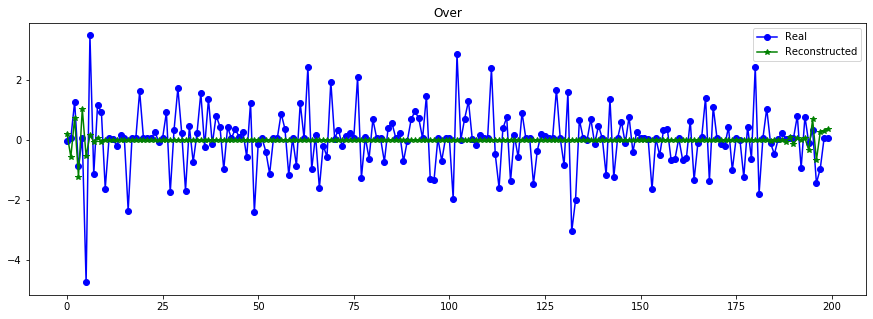

----------------------------------------------------------------


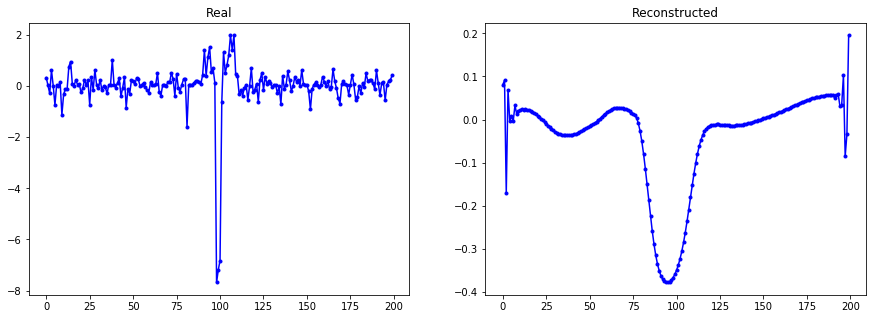

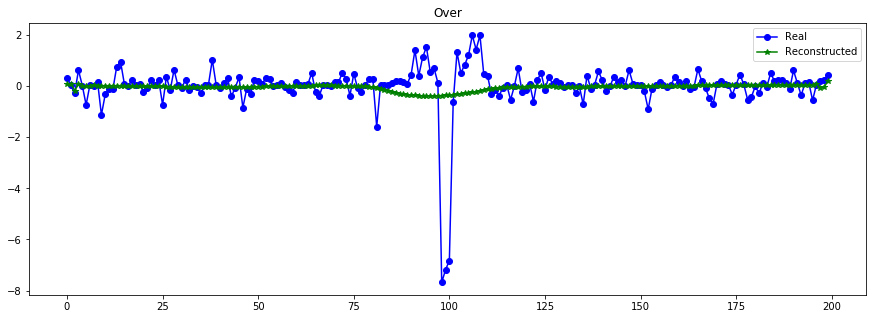

----------------------------------------------------------------


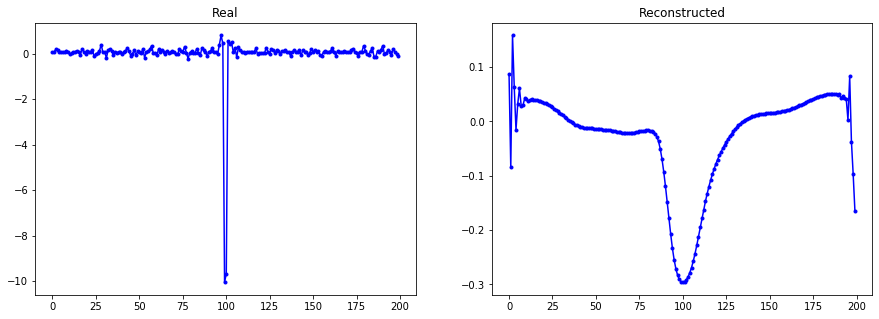

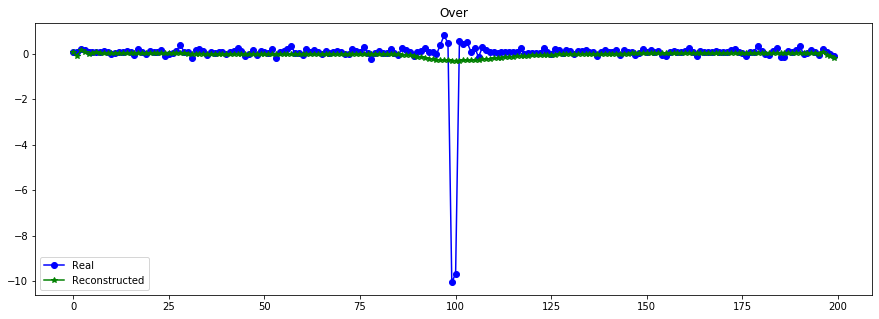

----------------------------------------------------------------


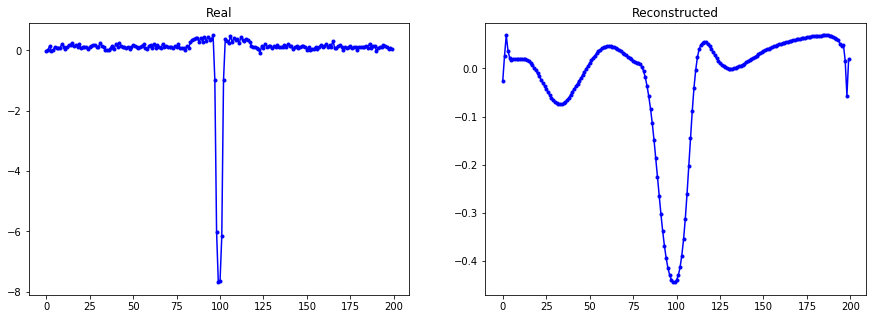

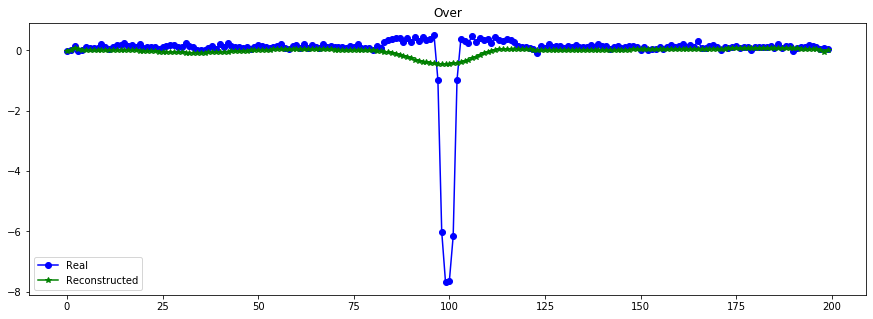

----------------------------------------------------------------


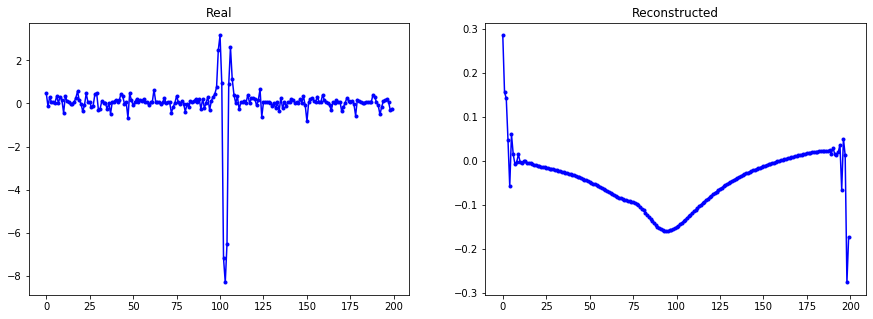

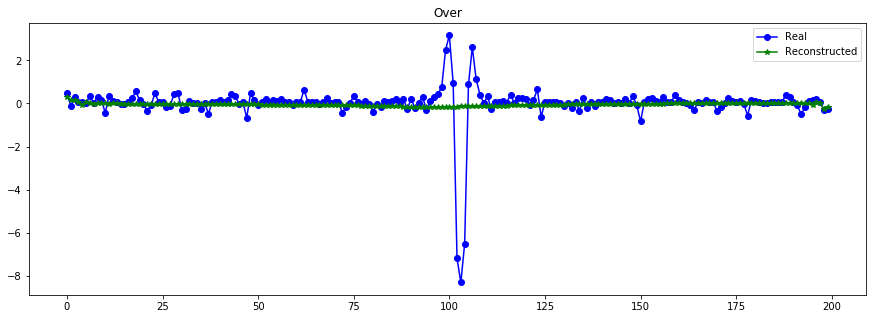

----------------------------------------------------------------


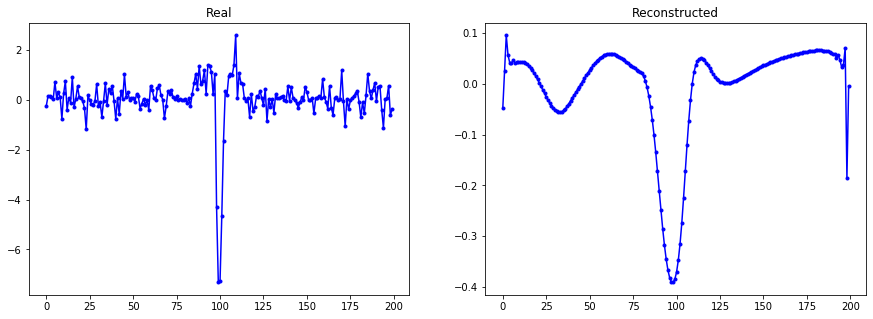

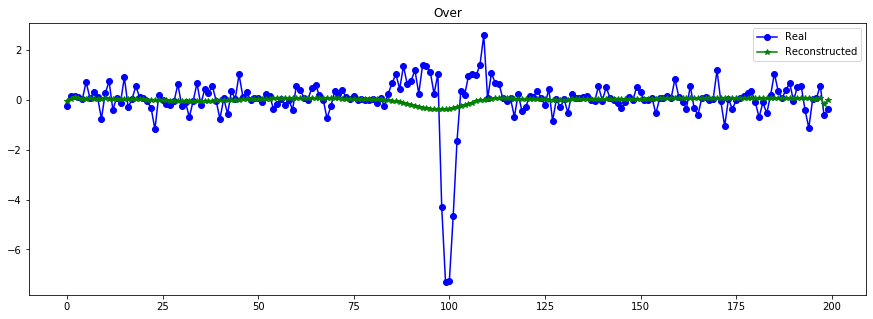

----------------------------------------------------------------


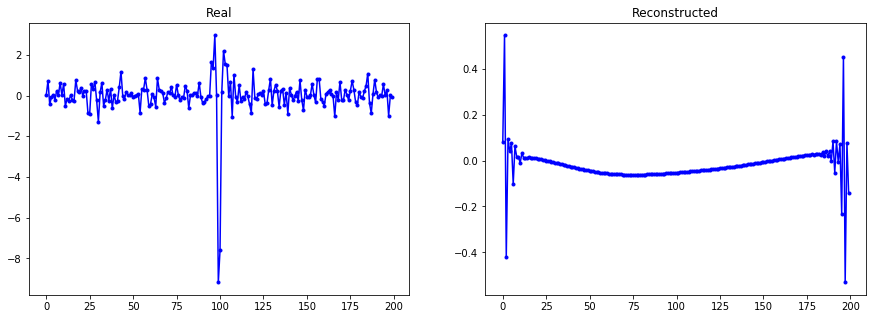

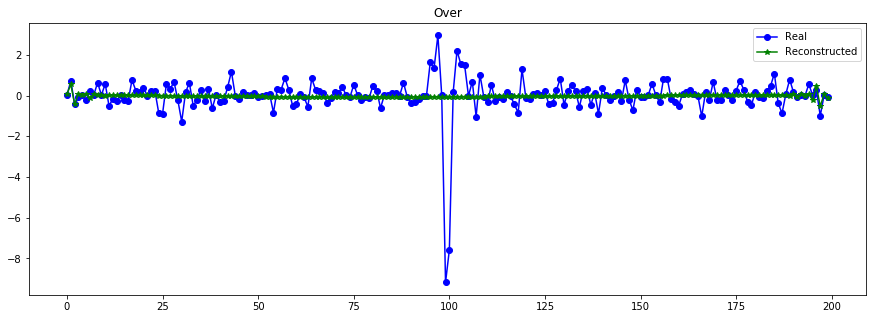

----------------------------------------------------------------


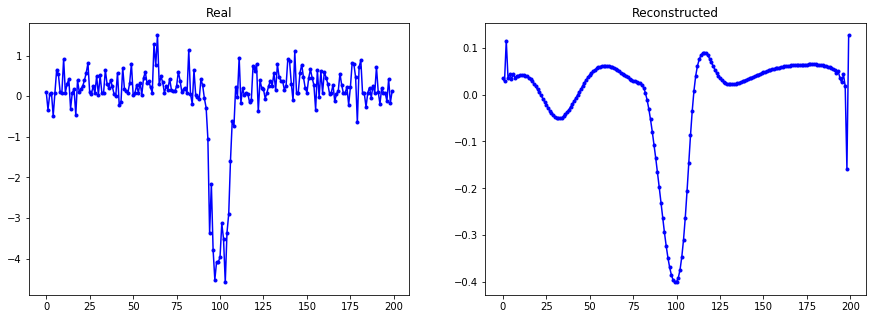

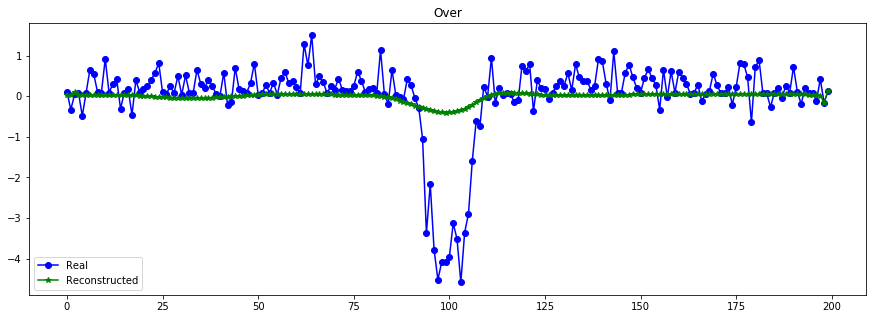

----------------------------------------------------------------


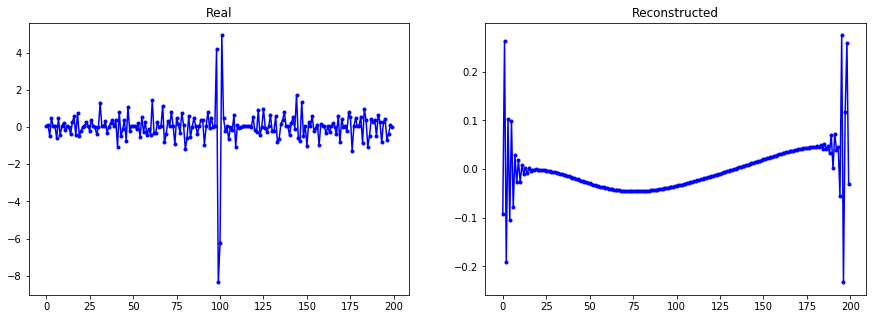

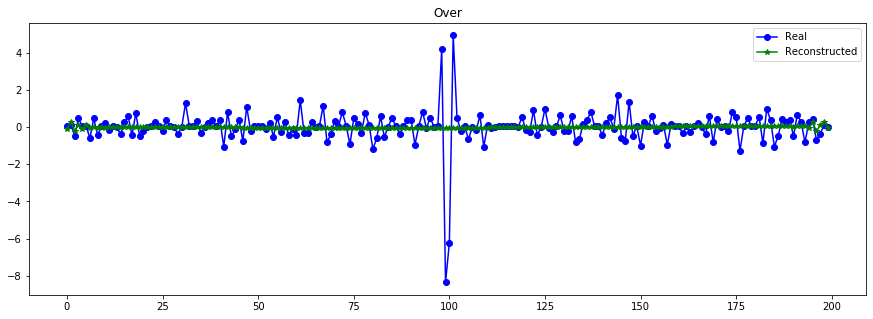

----------------------------------------------------------------


In [22]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10)

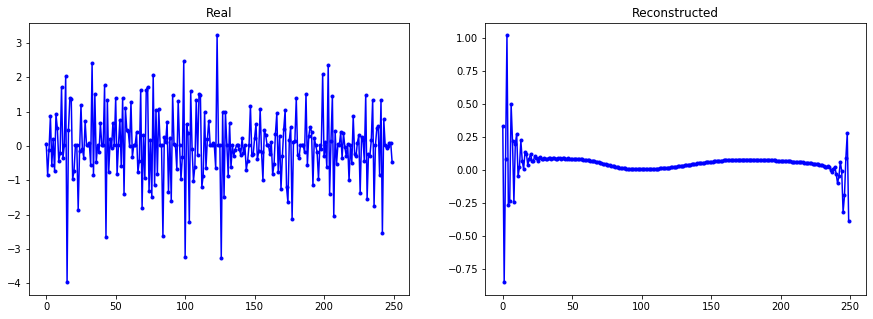

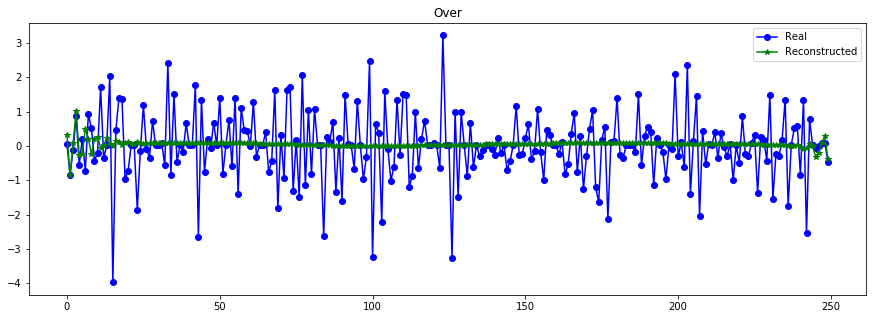

----------------------------------------------------------------


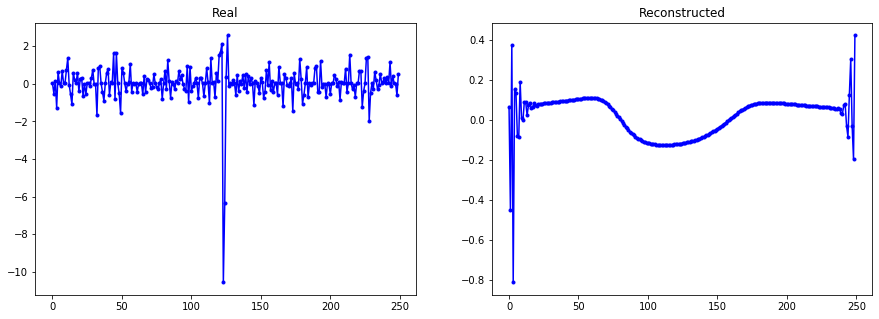

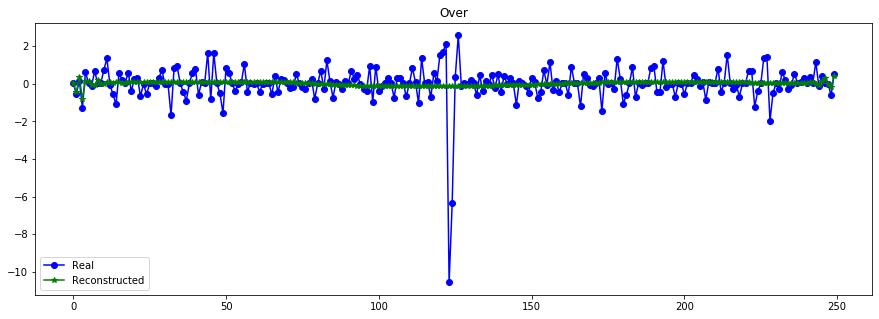

----------------------------------------------------------------


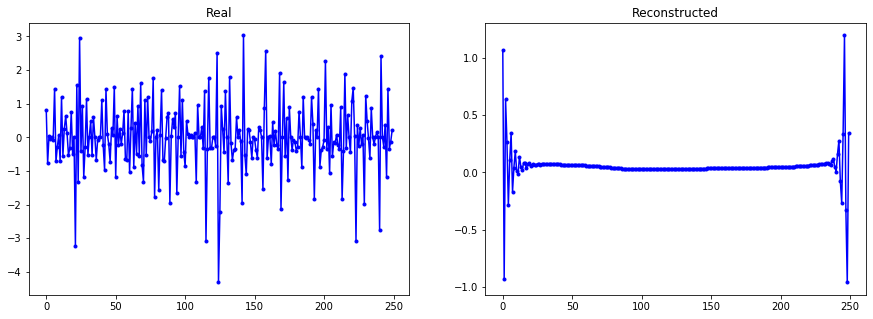

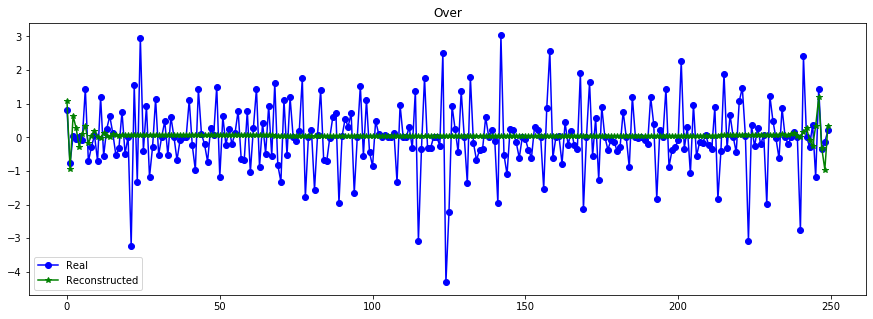

----------------------------------------------------------------


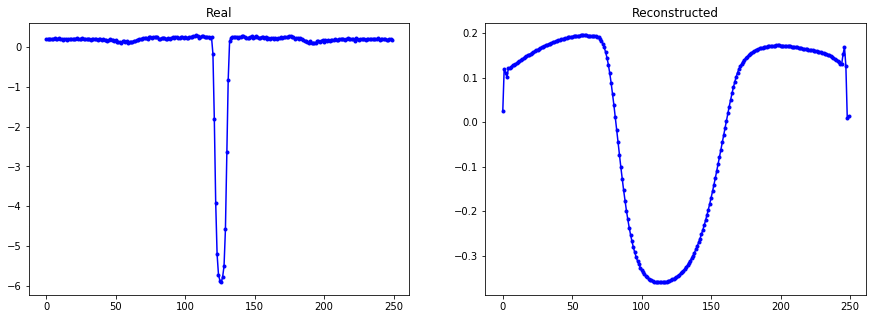

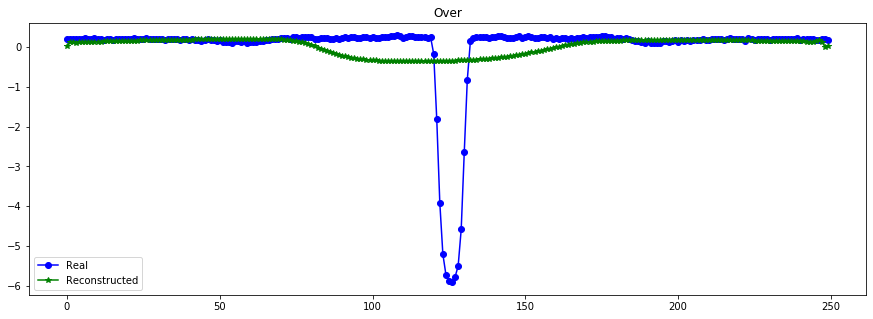

----------------------------------------------------------------


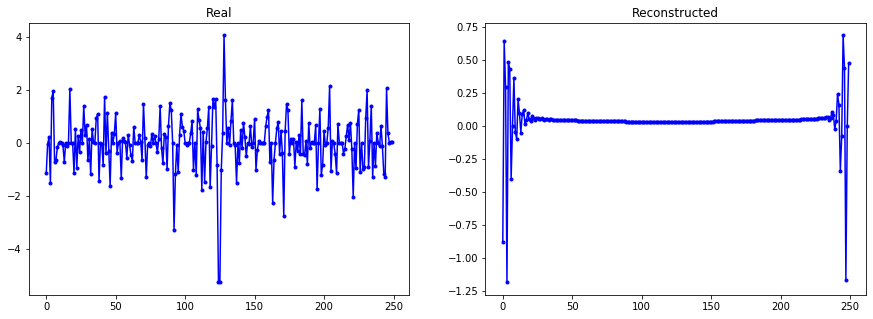

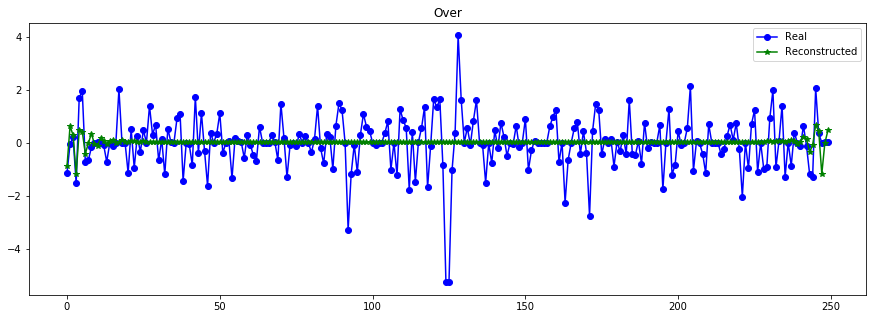

----------------------------------------------------------------


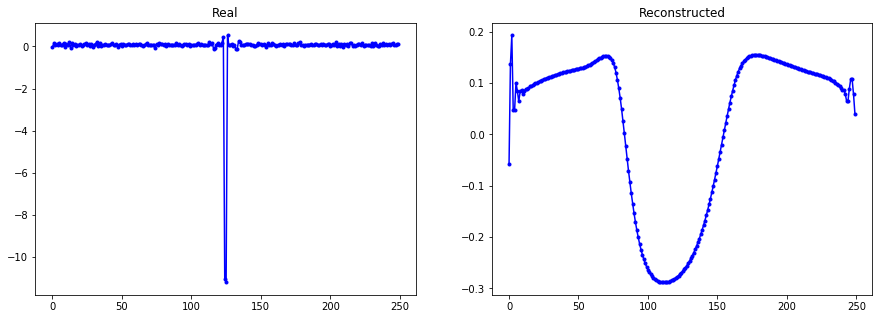

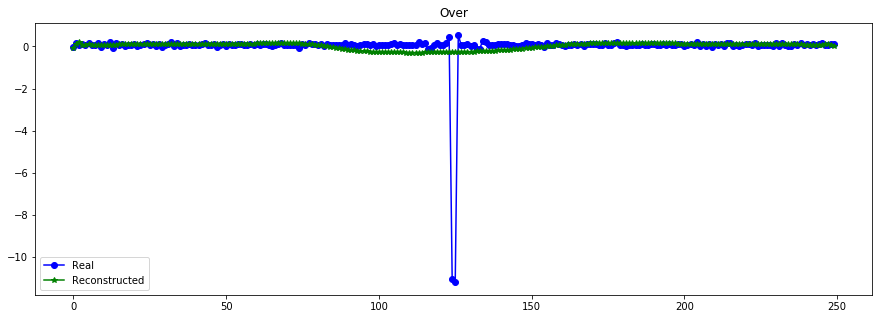

----------------------------------------------------------------


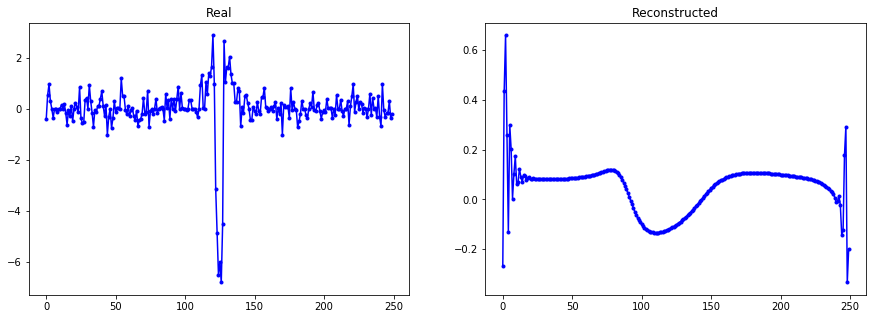

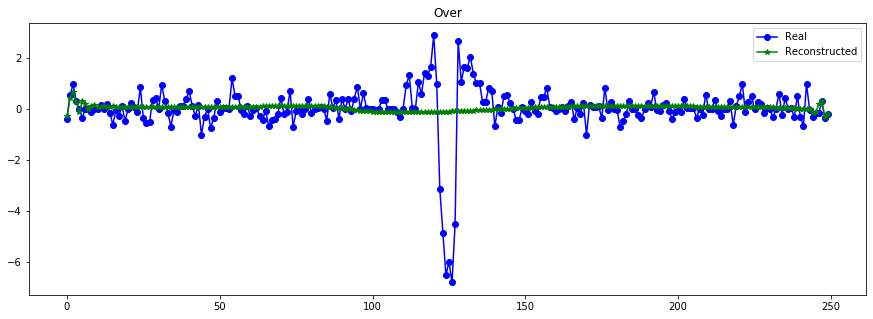

----------------------------------------------------------------


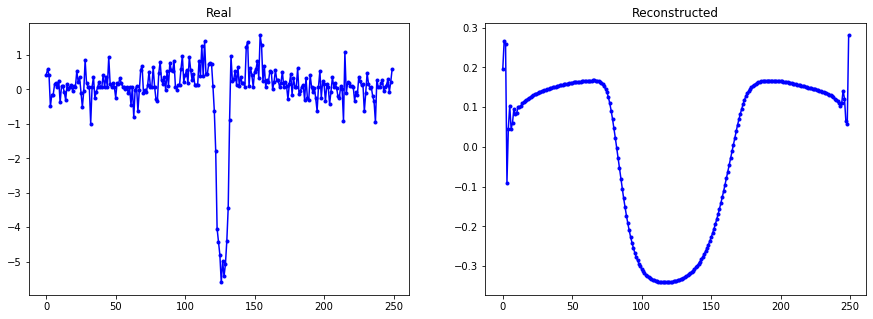

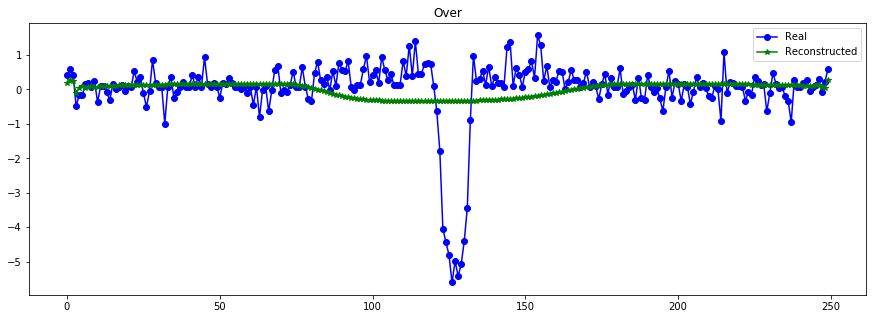

----------------------------------------------------------------


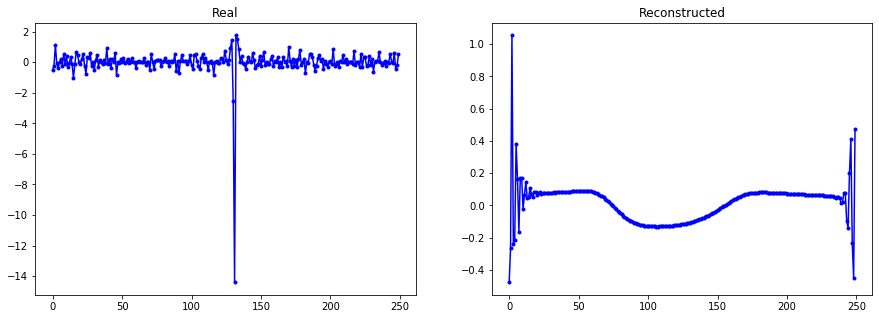

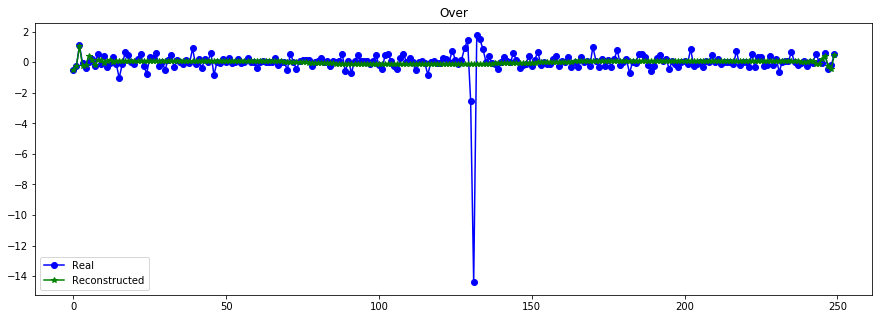

----------------------------------------------------------------


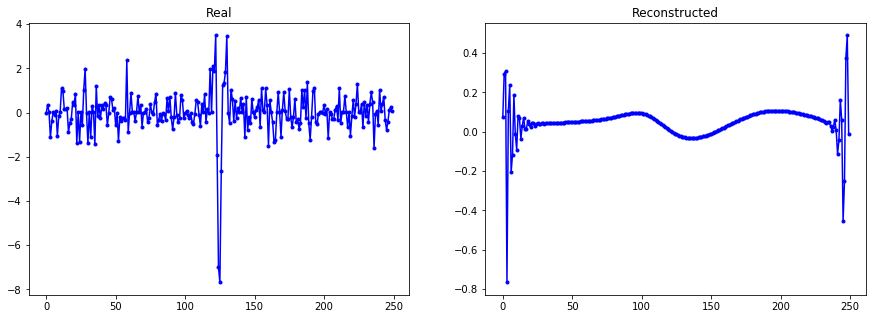

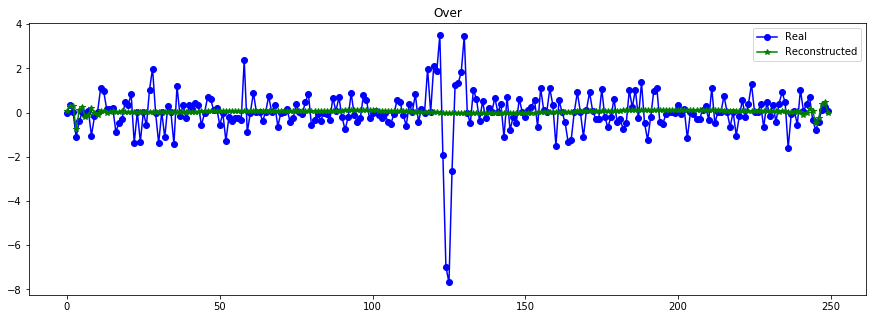

----------------------------------------------------------------


In [21]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10) ##con 40 epochs T=250 y dense linear

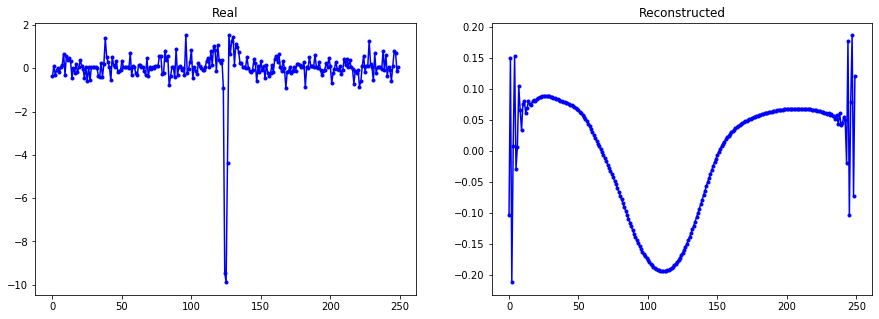

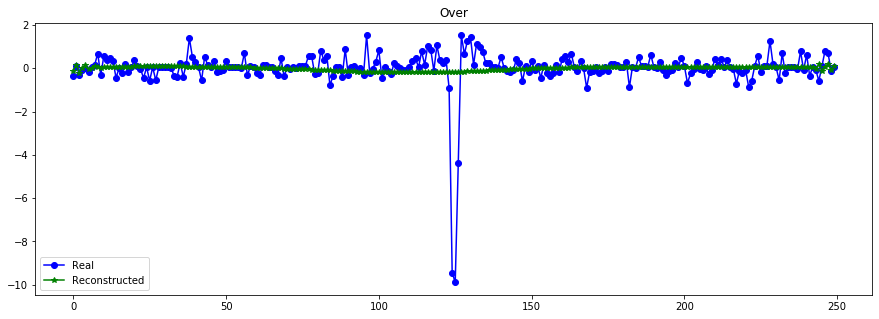

----------------------------------------------------------------


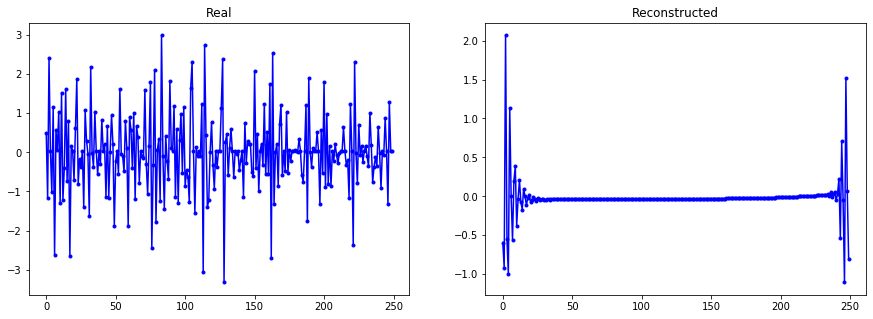

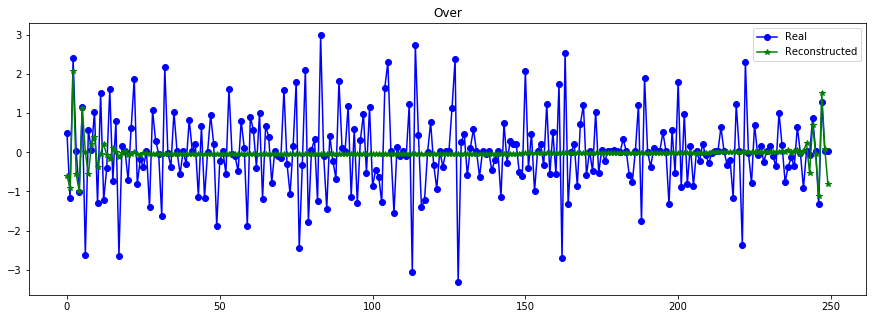

----------------------------------------------------------------


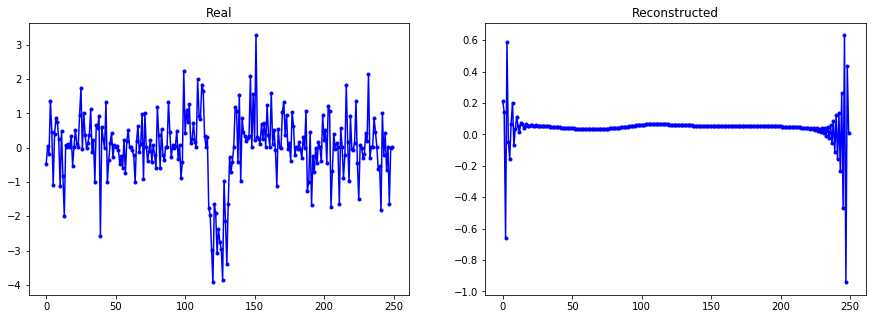

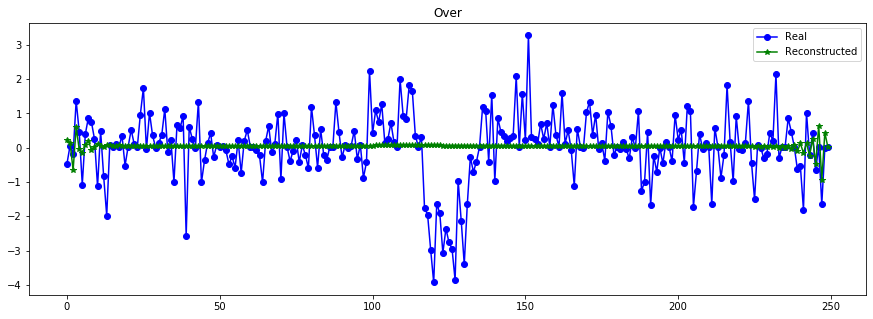

----------------------------------------------------------------


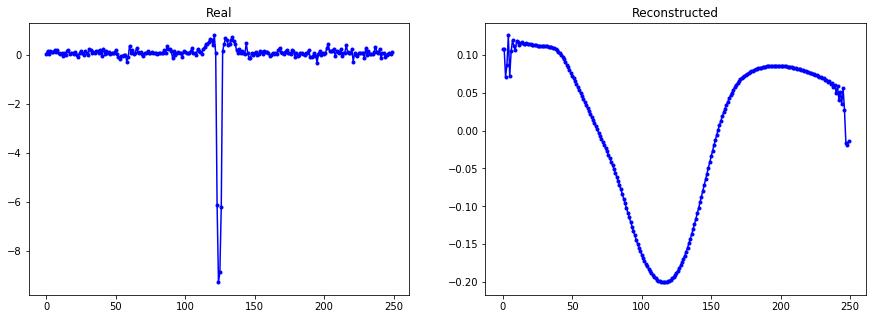

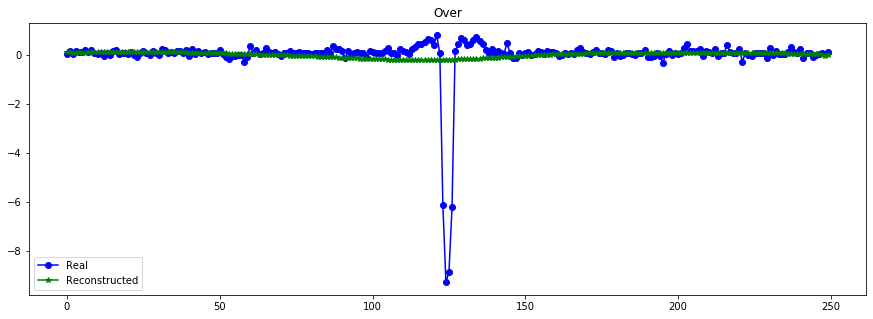

----------------------------------------------------------------


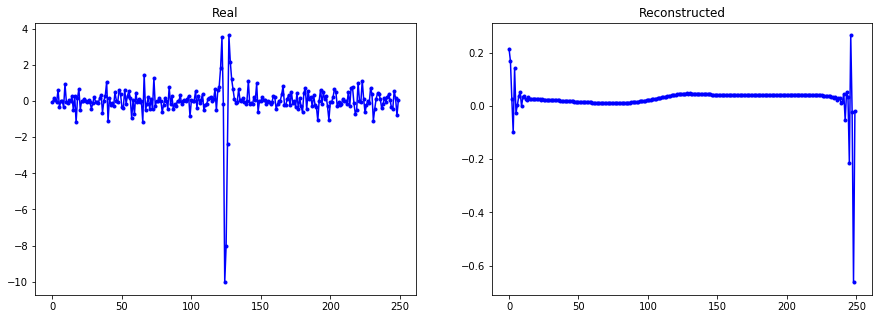

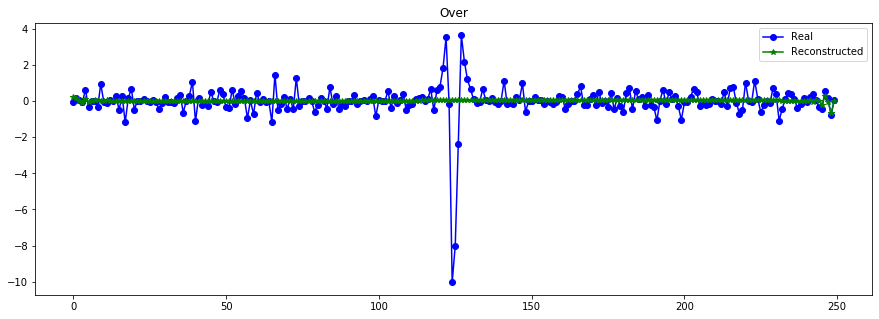

----------------------------------------------------------------


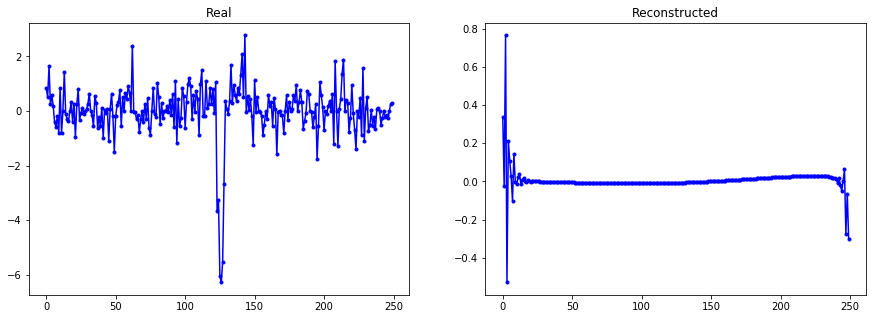

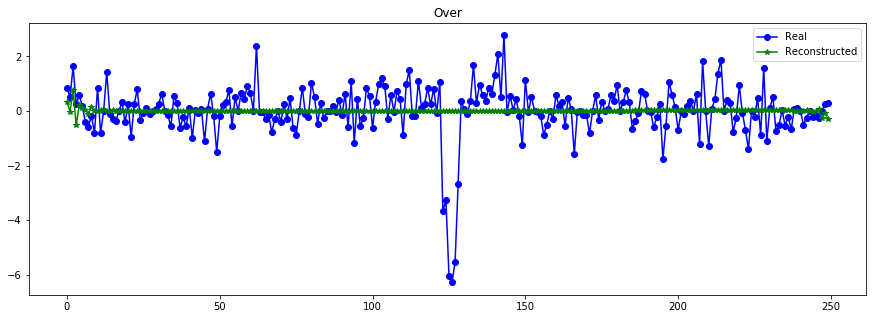

----------------------------------------------------------------


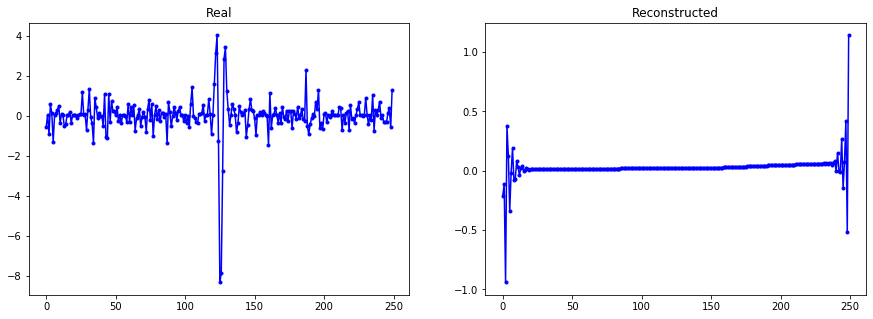

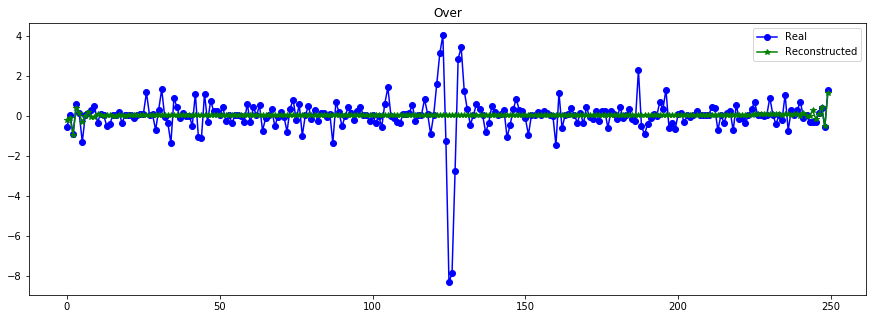

----------------------------------------------------------------


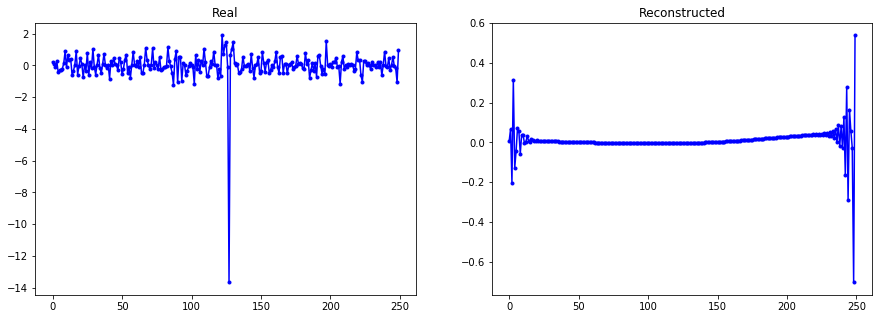

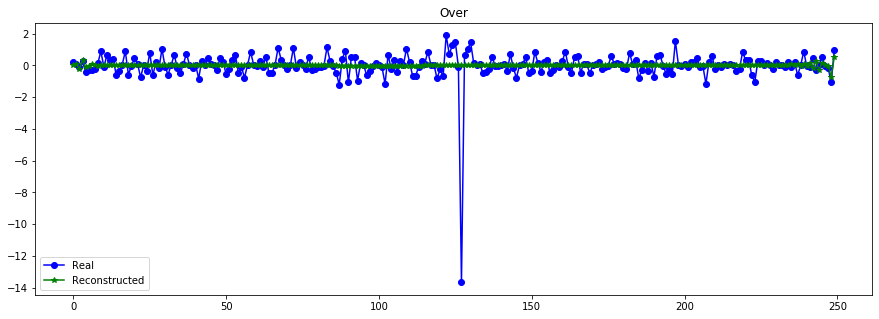

----------------------------------------------------------------


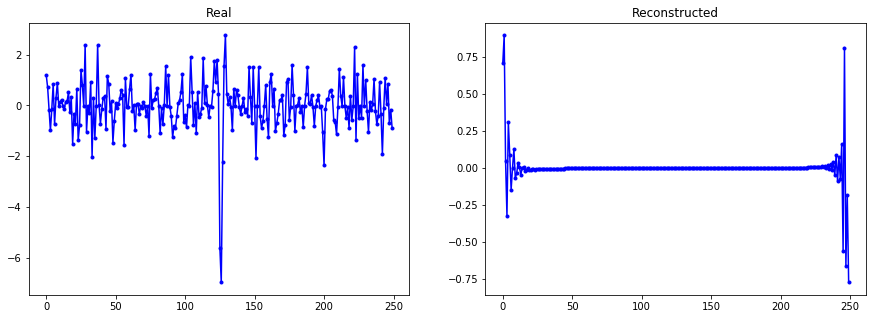

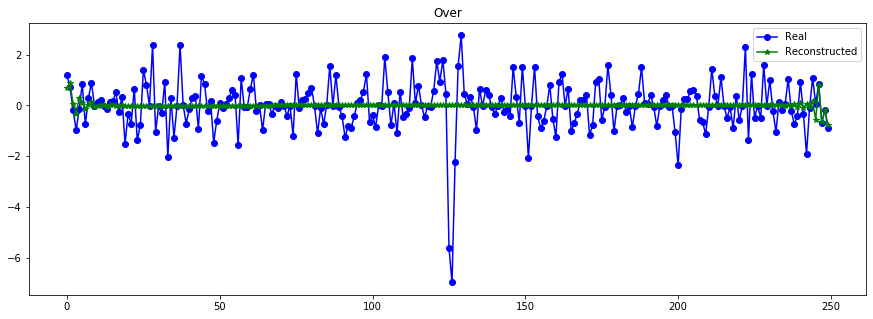

----------------------------------------------------------------


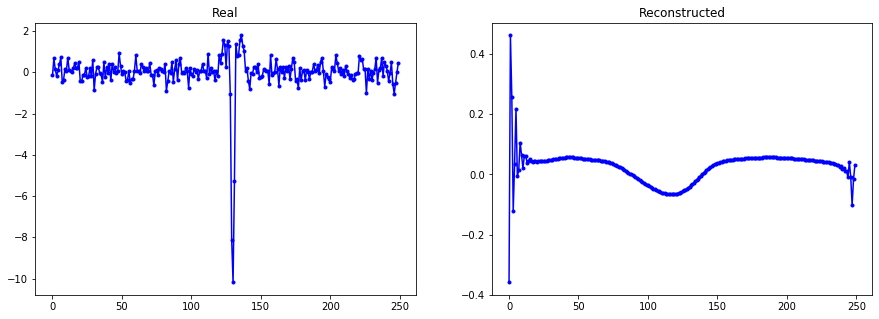

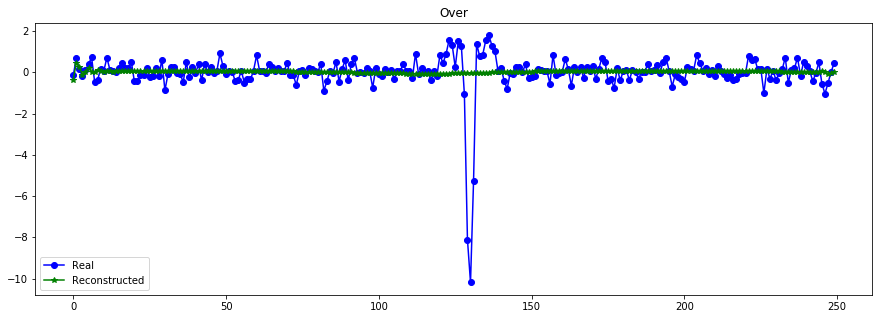

----------------------------------------------------------------


In [37]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10) ###con 40 epochs T=250 y dense relu y sin KL

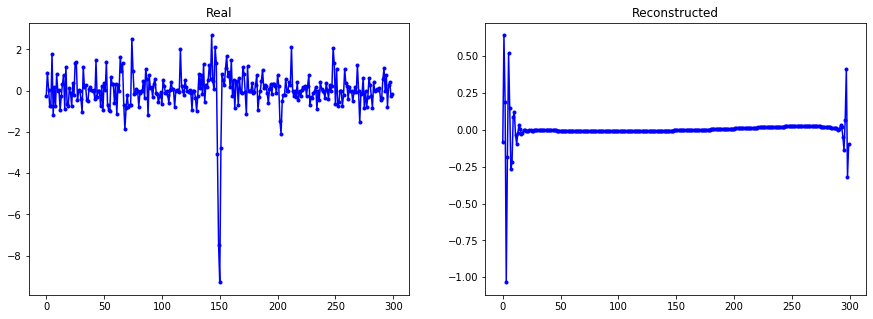

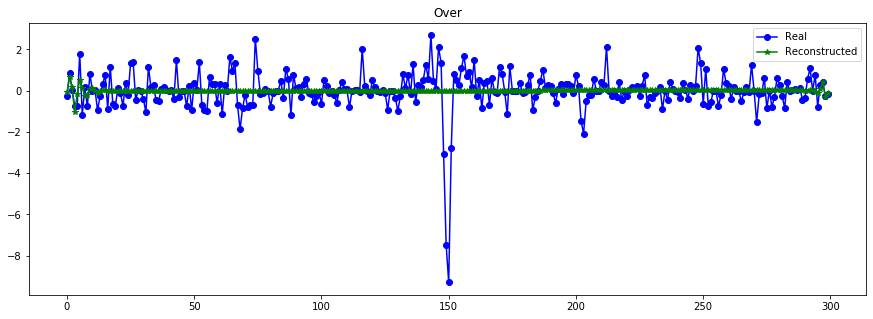

----------------------------------------------------------------


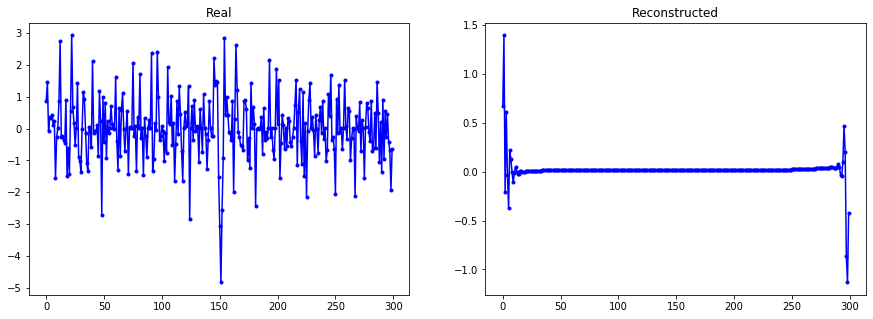

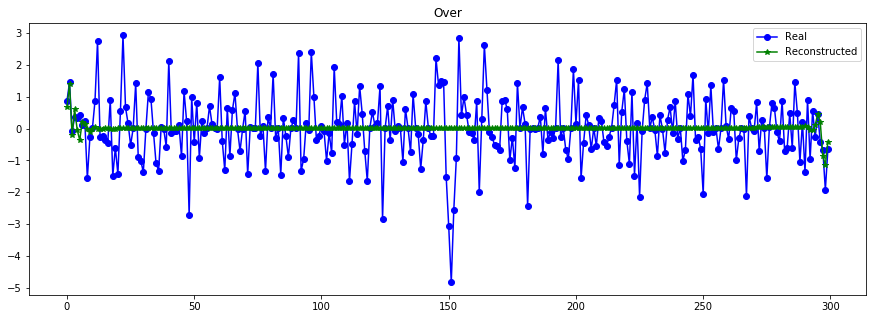

----------------------------------------------------------------


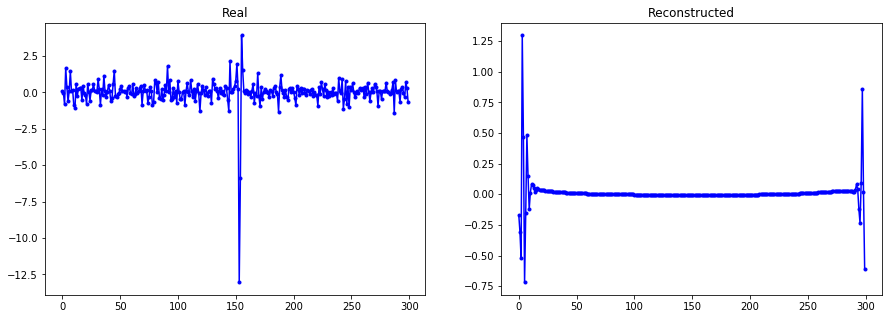

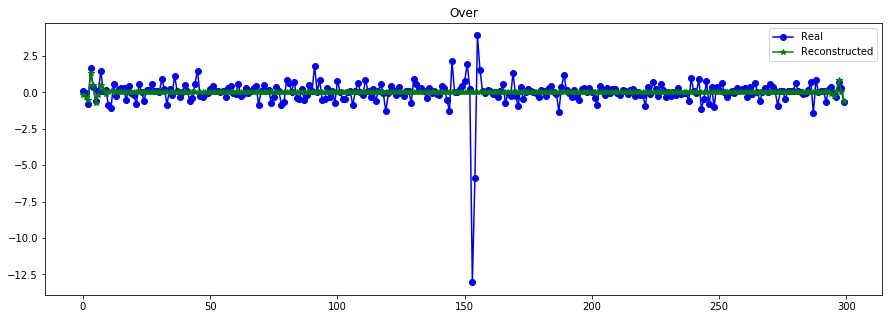

----------------------------------------------------------------


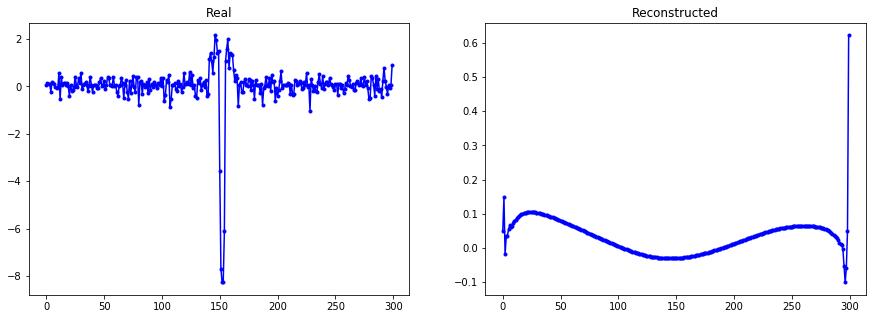

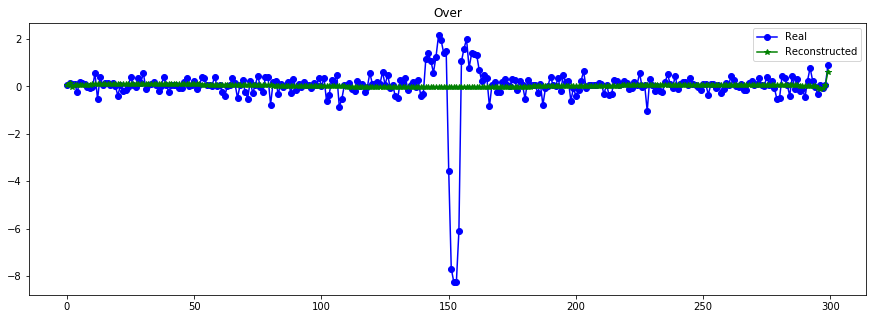

----------------------------------------------------------------


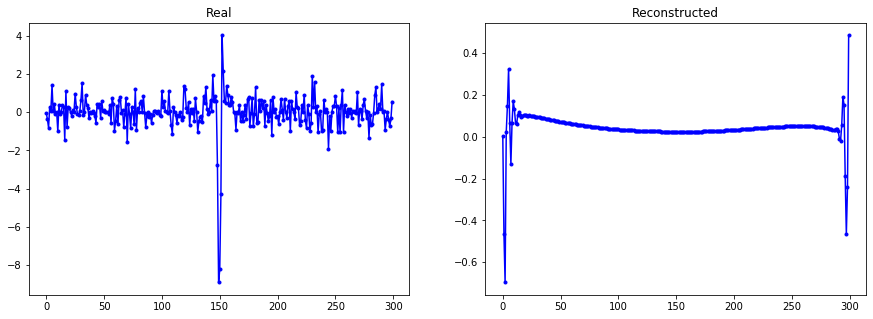

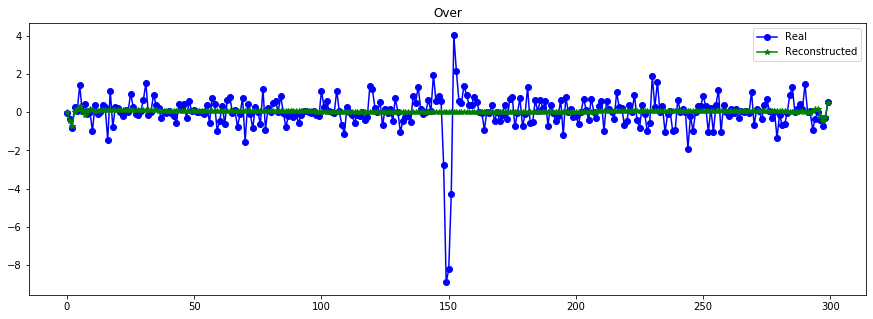

----------------------------------------------------------------


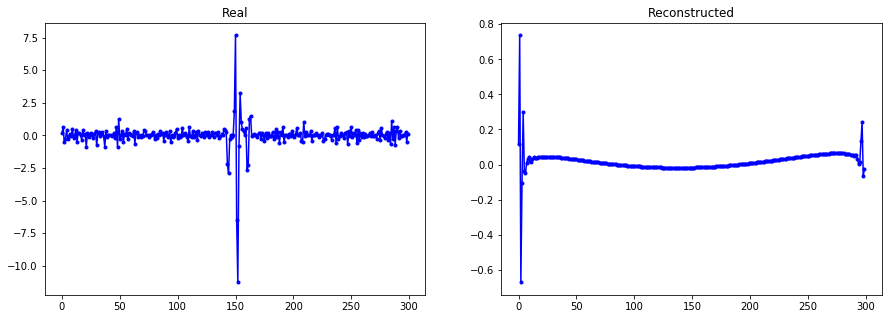

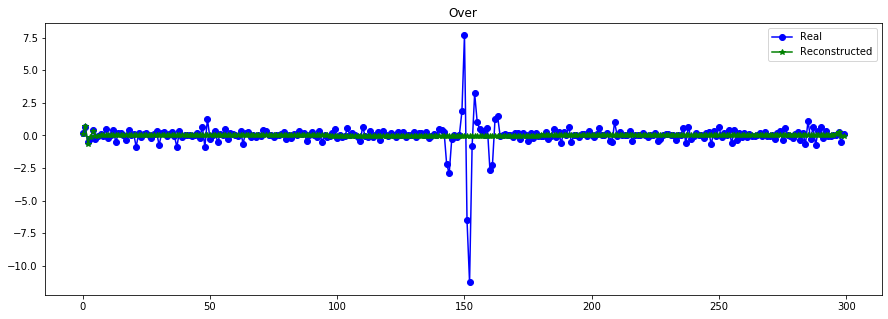

----------------------------------------------------------------


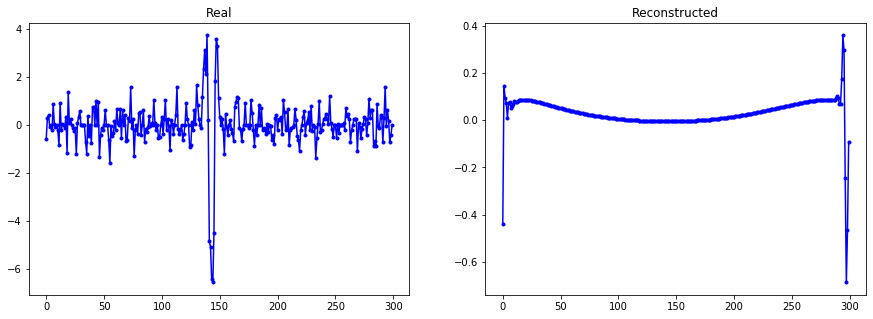

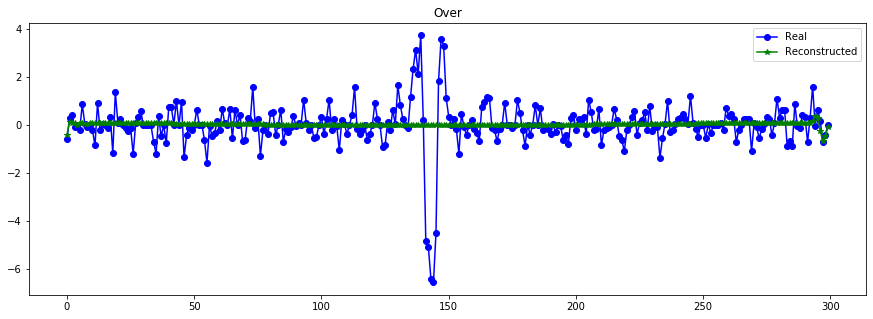

----------------------------------------------------------------


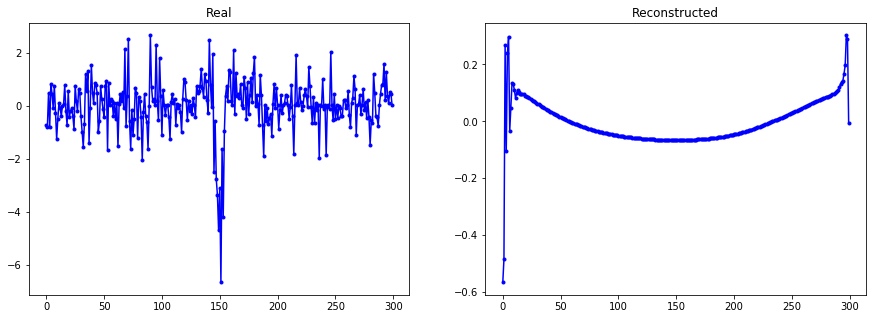

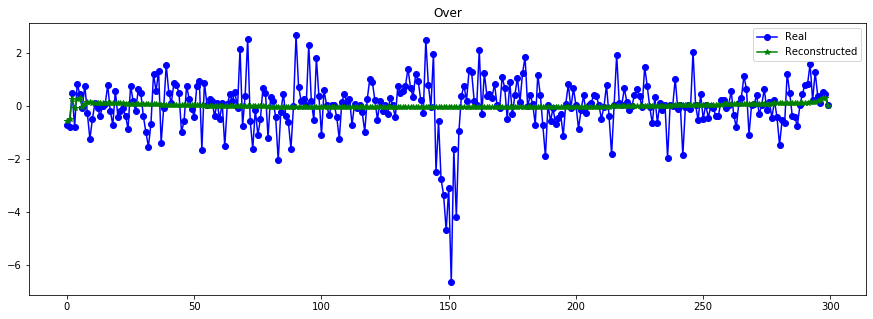

----------------------------------------------------------------


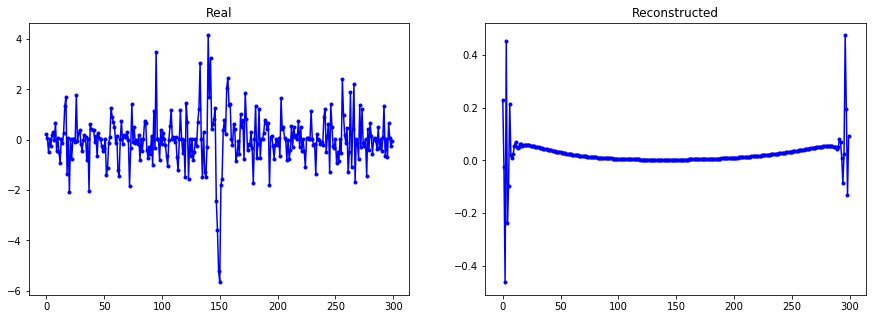

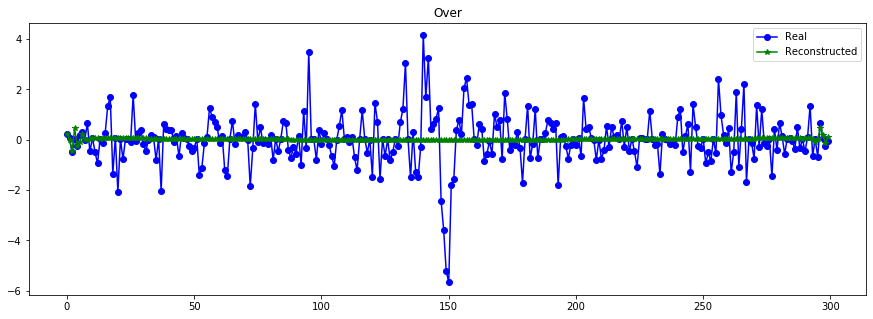

----------------------------------------------------------------


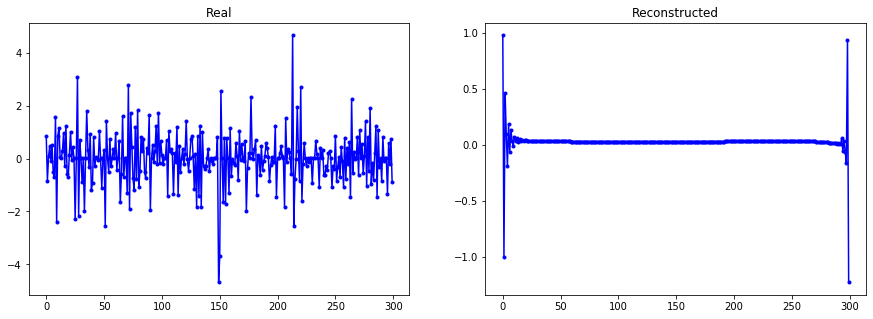

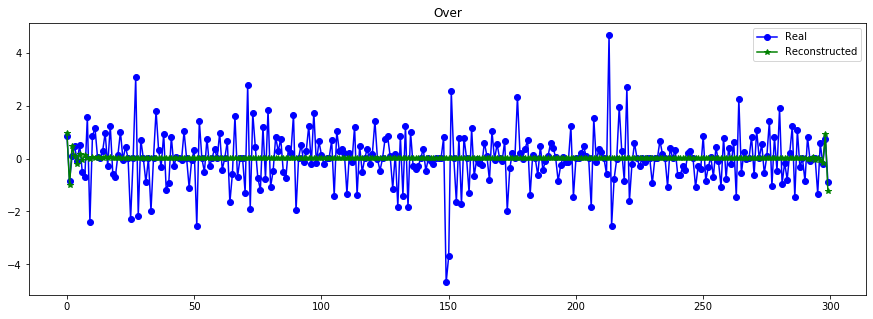

----------------------------------------------------------------


In [24]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 50 epochs T=300 global + local input

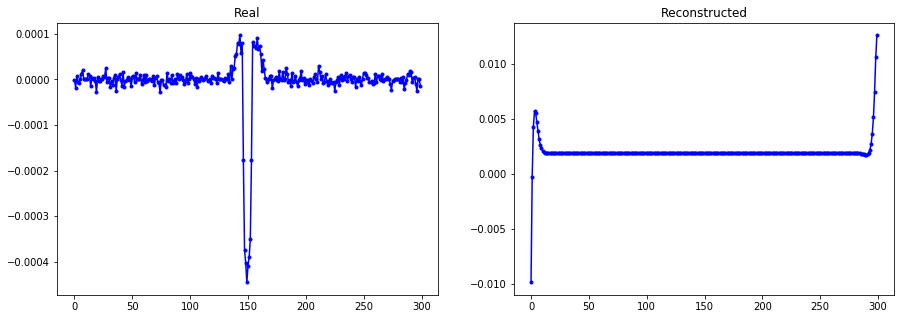

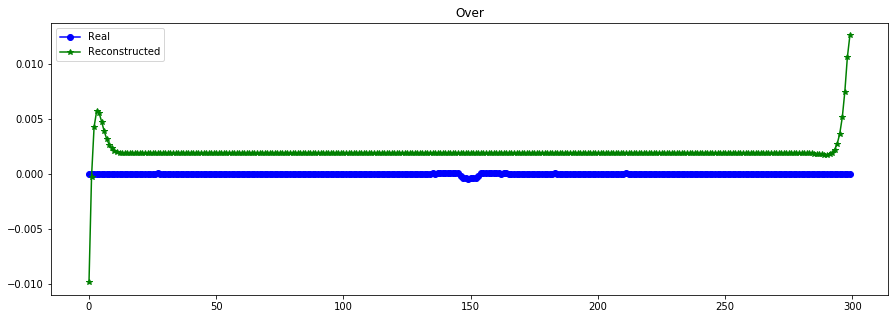

----------------------------------------------------------------


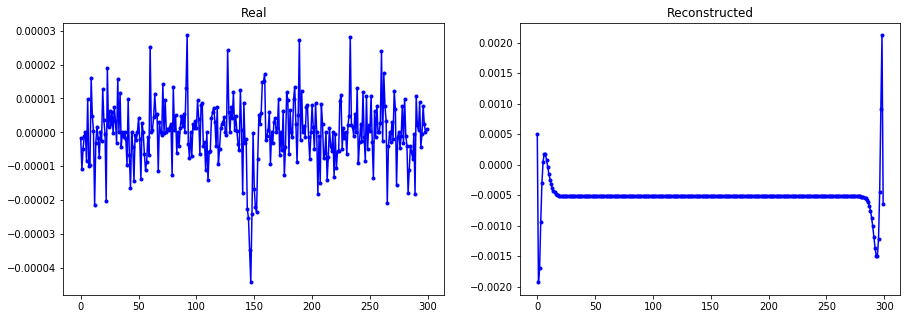

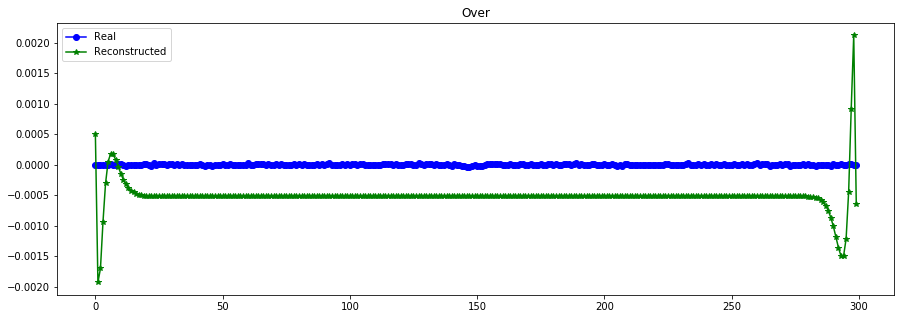

----------------------------------------------------------------


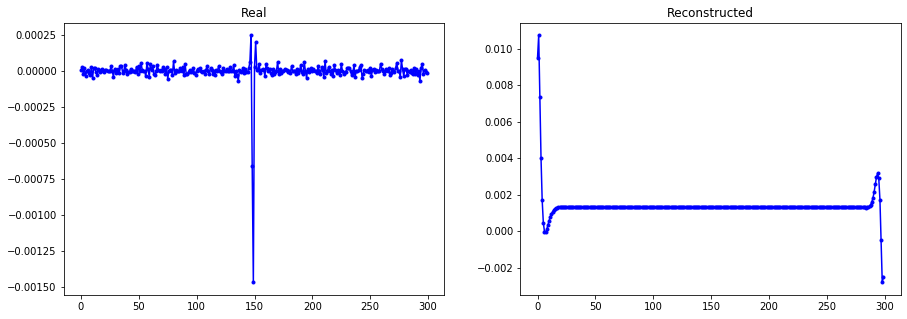

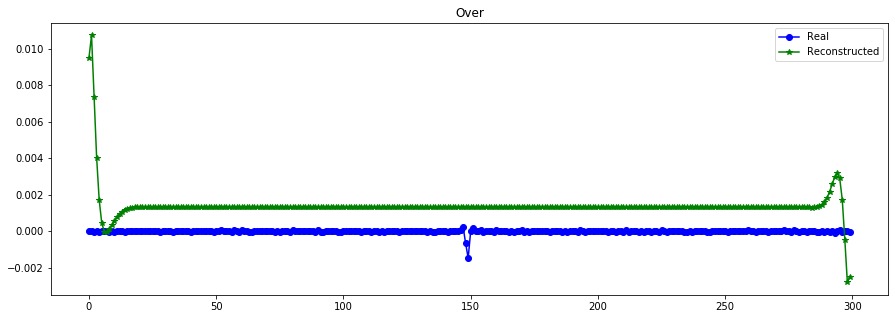

----------------------------------------------------------------


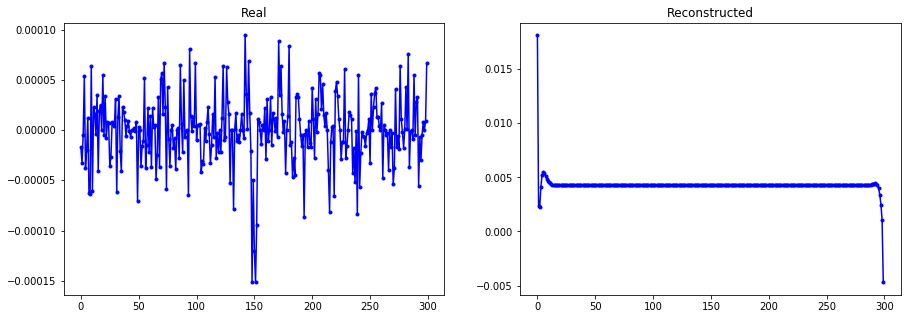

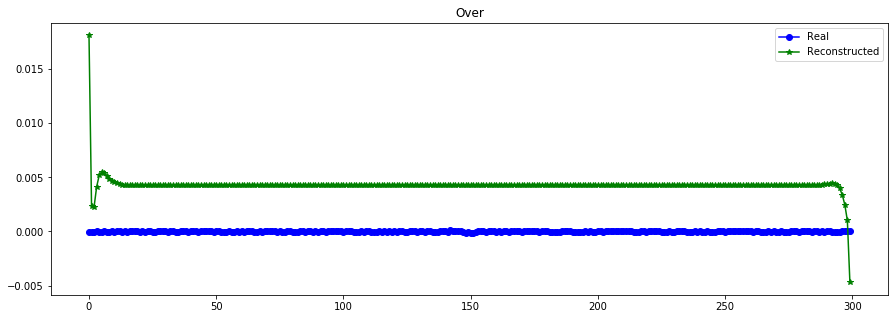

----------------------------------------------------------------


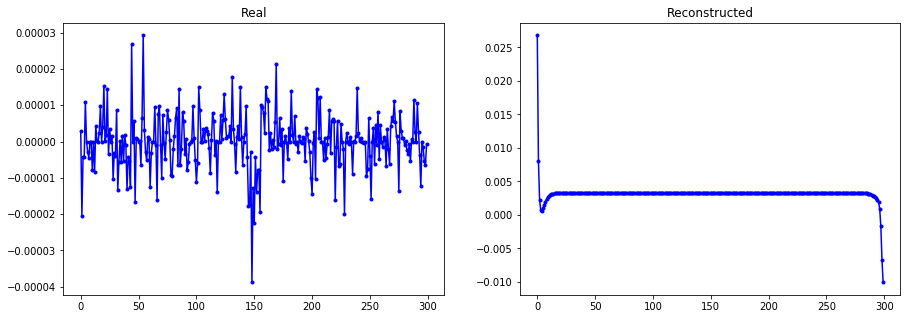

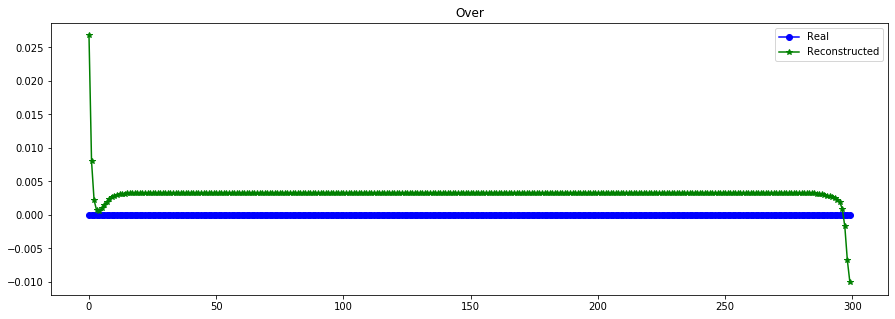

----------------------------------------------------------------


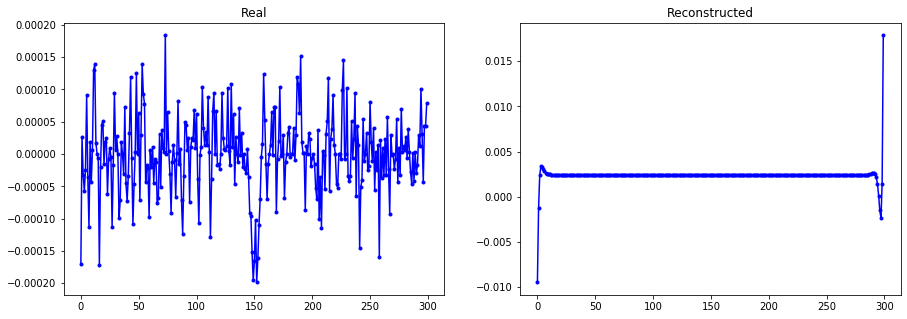

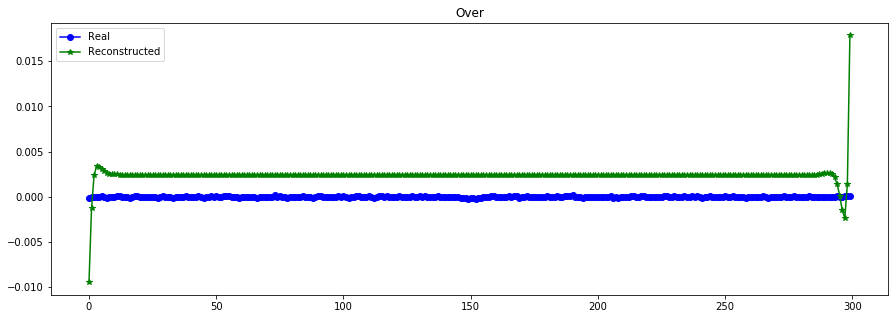

----------------------------------------------------------------


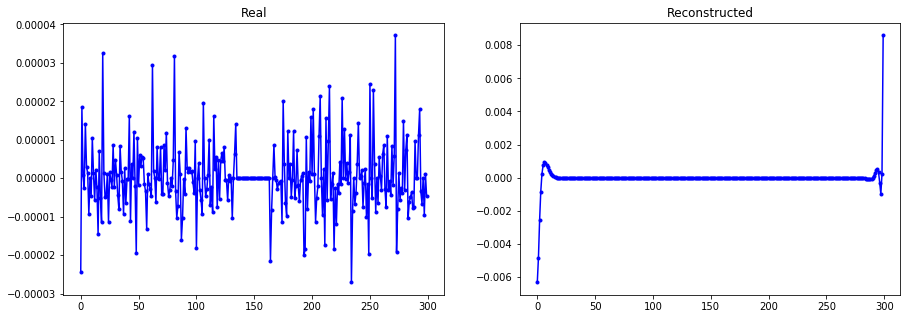

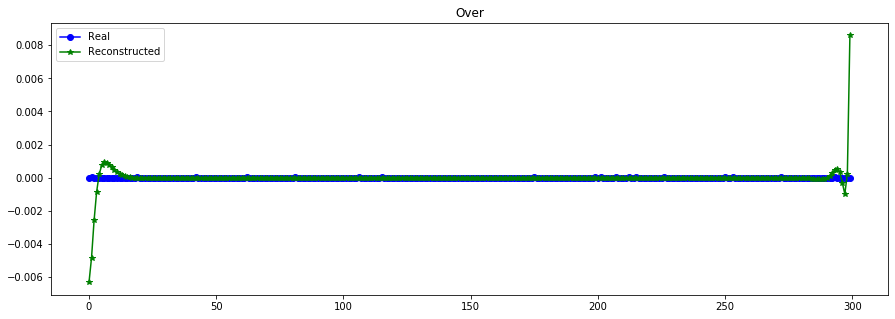

----------------------------------------------------------------


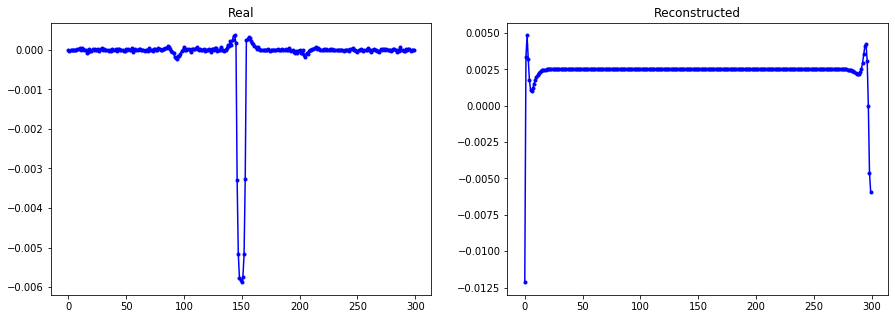

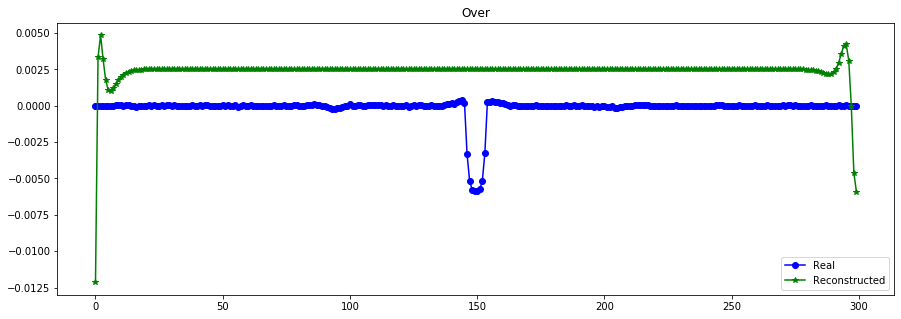

----------------------------------------------------------------


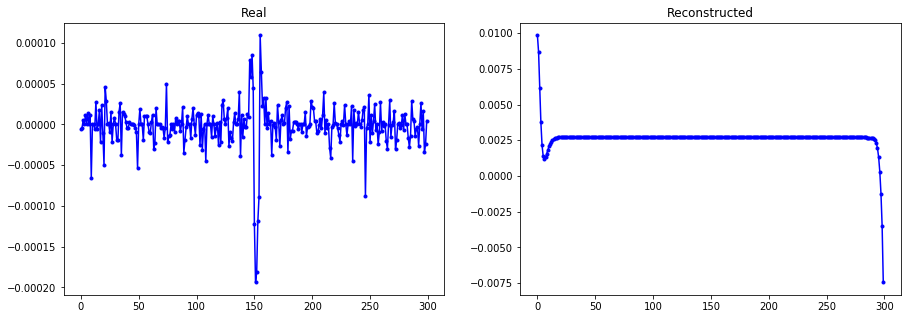

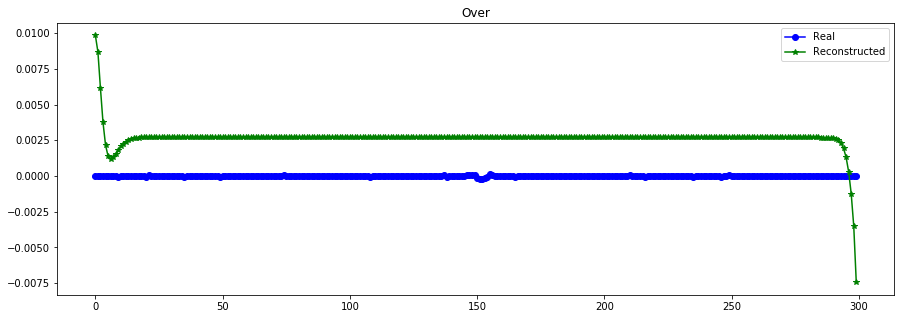

----------------------------------------------------------------


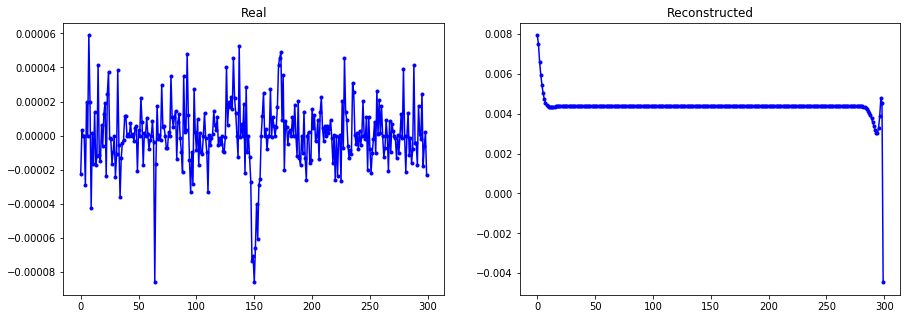

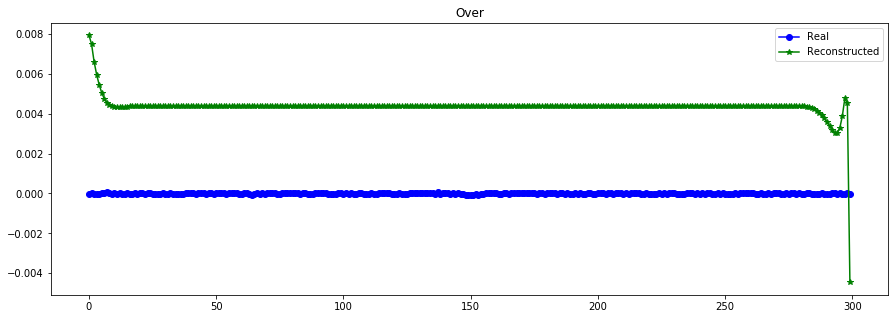

----------------------------------------------------------------


In [22]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 40 epochs T=300 global (CURVAS TRANSITO) normal rep

In [ ]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train[:,:,0], X_train_hat, n= 10) ###con 30 epochs T=300 global (CURVAS TRANSITO) 0-1 rep

In [ ]:
keras.optimizers.Adam(learning_rate=5e-4) #naul
keras.optimizers.Adam(learning_rate=2e-4) #tsang
notroso 1e-3 == 0.001

#dropa de 0.25

#tsamg baja embedd a 16
#todos con epochs > 100

In [18]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")

decoder_input = Input(shape=(latent_dim,))

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)
vae.compile(optimizer=keras.optimizers.Adam(lr=5e-4), loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=50, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))






__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 200, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 200, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108096      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 200, 1)       111873      T_inp[0][0]                      
     

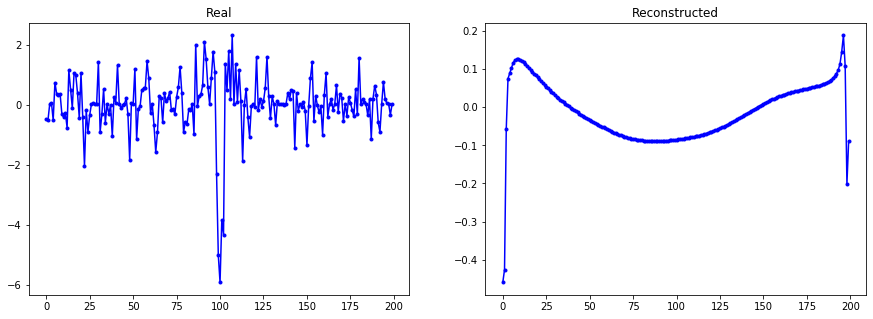

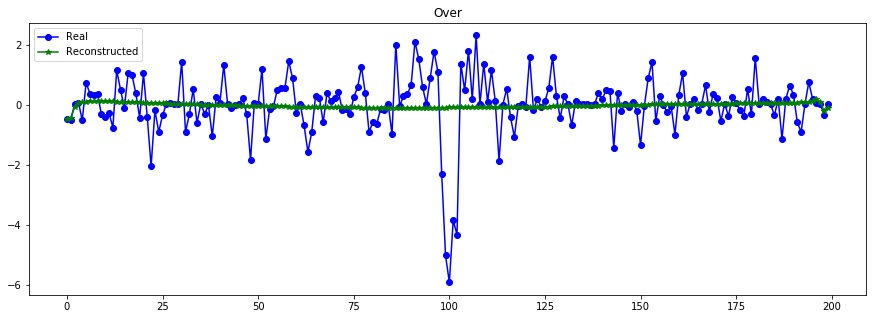

----------------------------------------------------------------


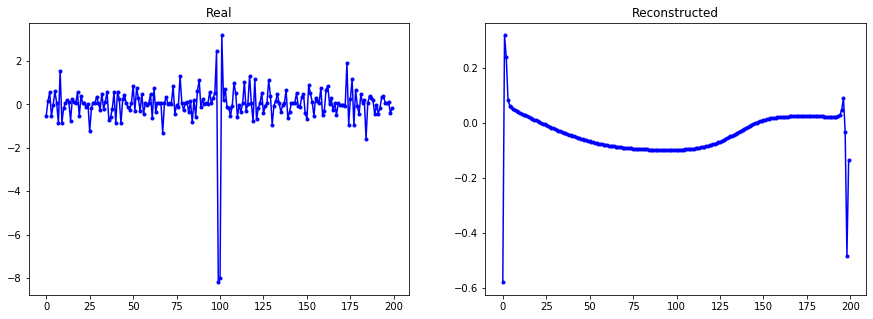

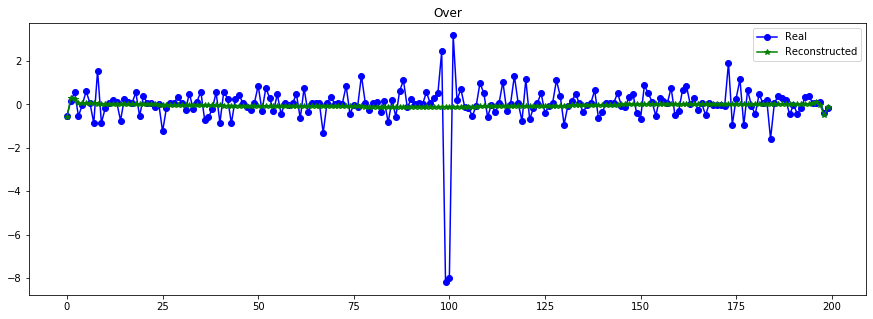

----------------------------------------------------------------


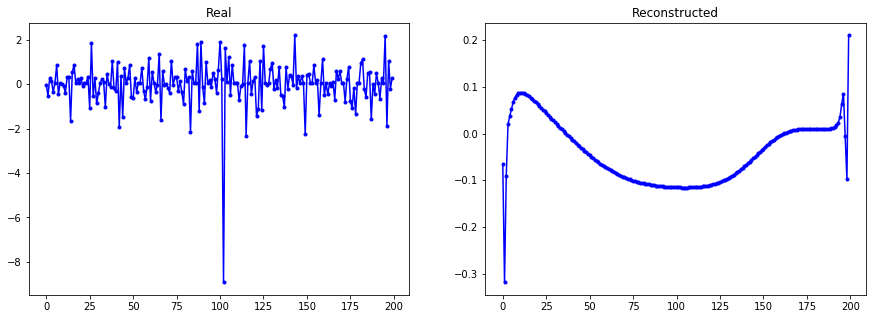

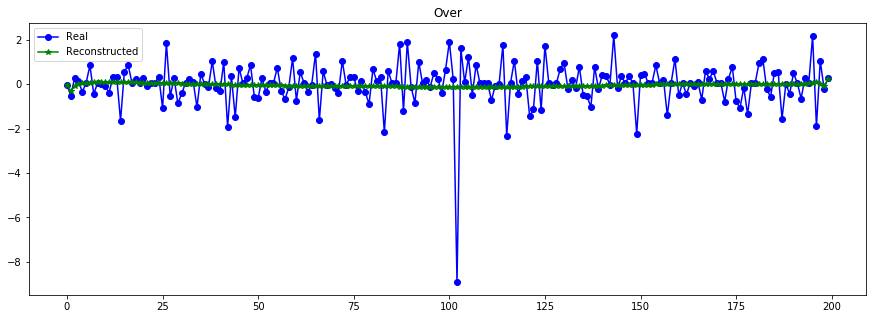

----------------------------------------------------------------


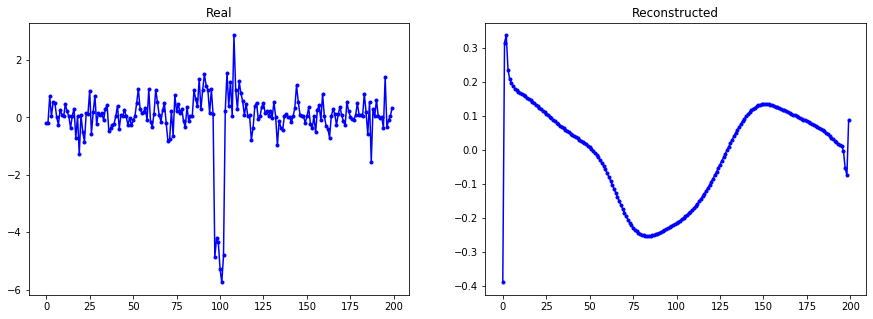

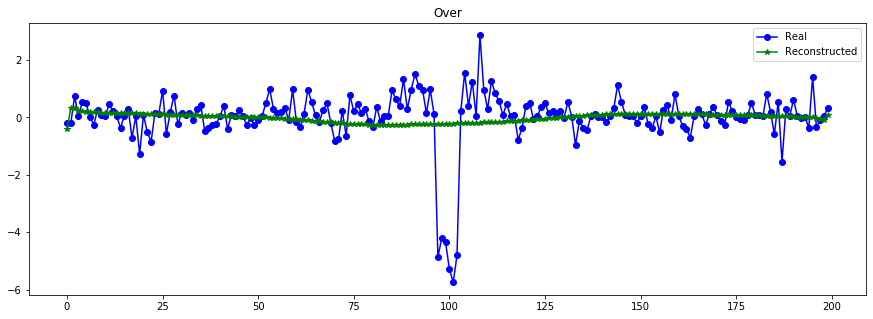

----------------------------------------------------------------


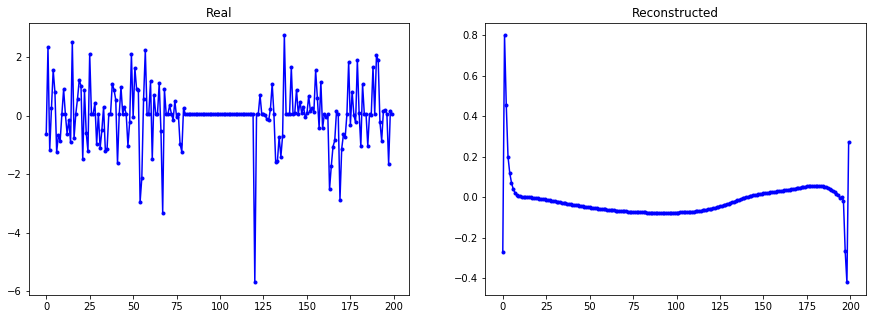

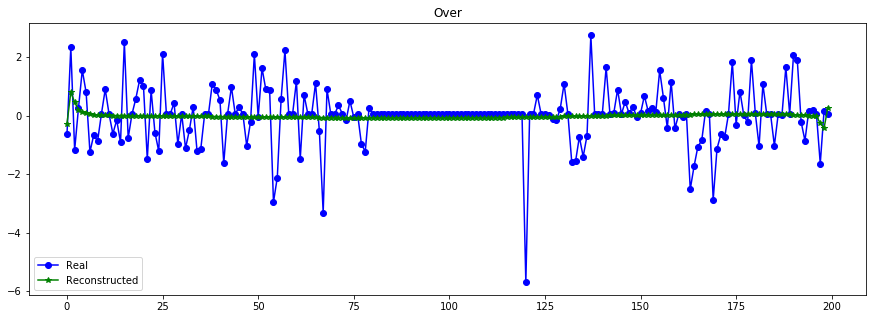

----------------------------------------------------------------


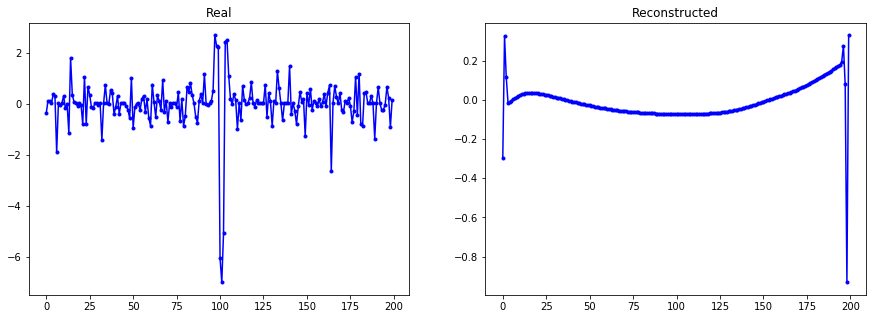

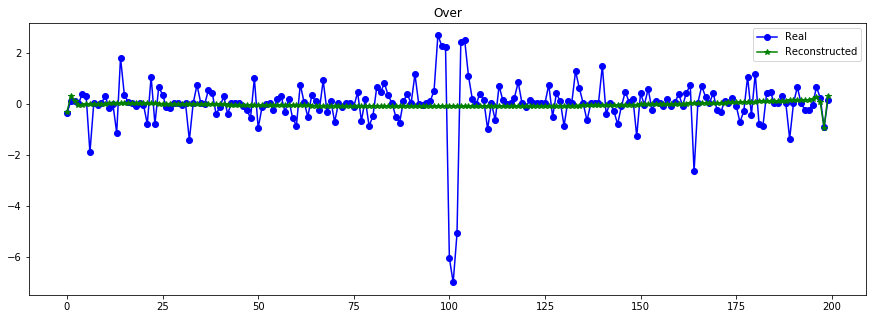

----------------------------------------------------------------


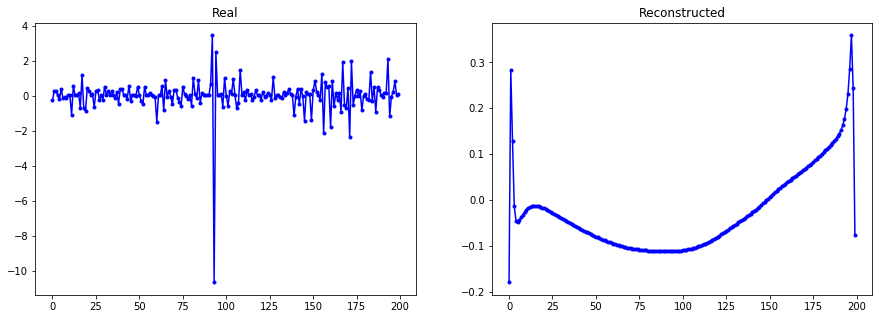

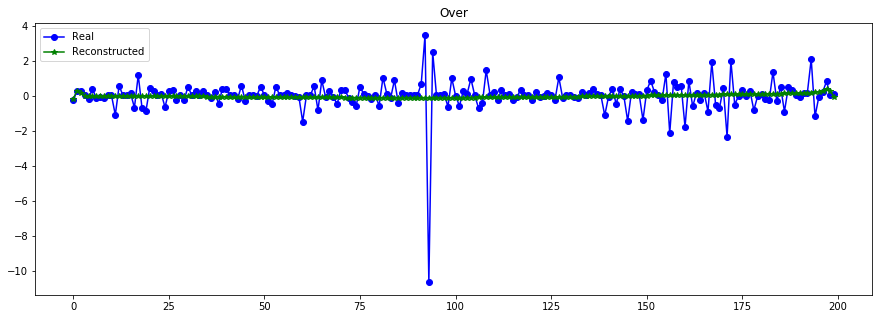

----------------------------------------------------------------


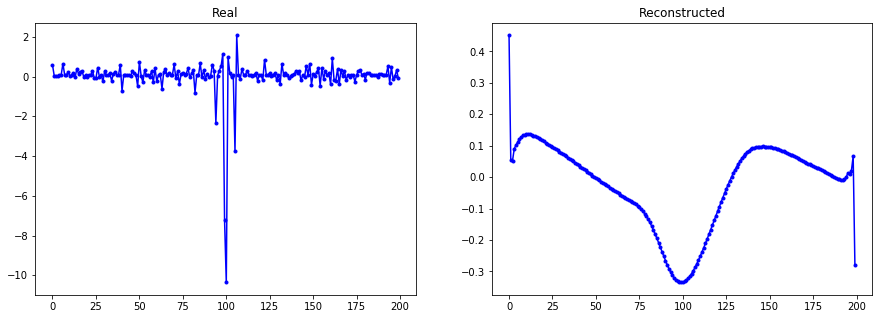

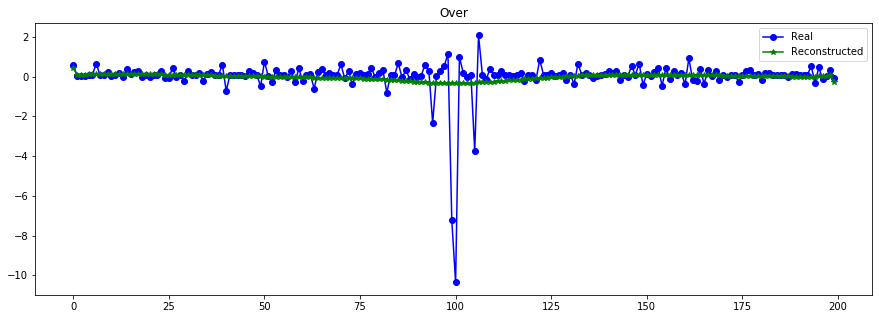

----------------------------------------------------------------


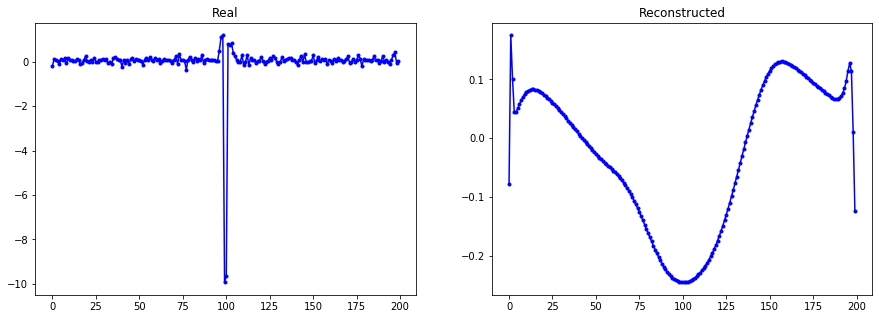

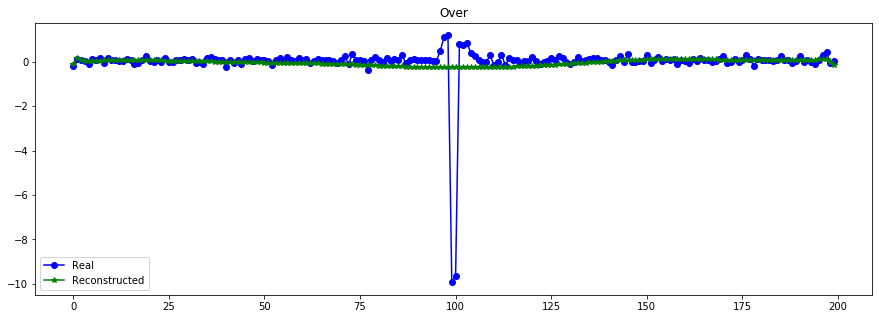

----------------------------------------------------------------


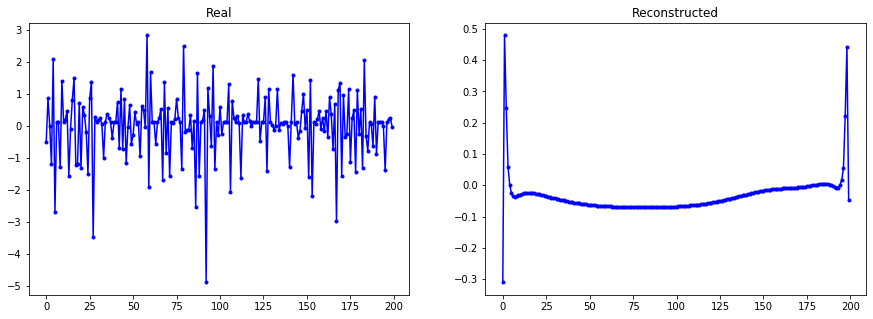

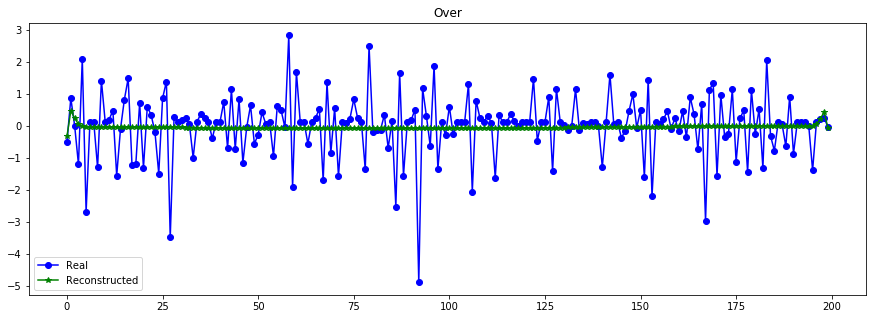

----------------------------------------------------------------


In [19]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10)

{'whiskers': [<matplotlib.lines.Line2D at 0x2aed7f739a58>,
 'caps': [<matplotlib.lines.Line2D at 0x2aededb51a90>,
 'boxes': [<matplotlib.lines.Line2D at 0x2aededb41f98>],
 'medians': [<matplotlib.lines.Line2D at 0x2aededb51e80>],
 'fliers': [<matplotlib.lines.Line2D at 0x2aededb51f60>],
 'means': []}

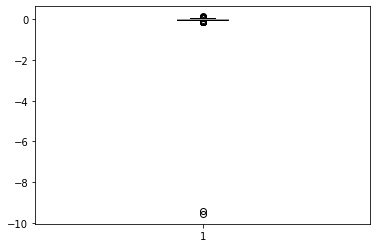

In [24]:
plt.boxplot(X_train[0,:,0])

In [ ]:
#https://towardsdatascience.com/deep-quantile-regression-c85481548b5a
#https://arxiv.org/pdf/1808.08798.pdf
def vae_titled_loss(q):
    l = 0.001 #menor peso 
    def loss(y_true, y_pred):
        e = y_true - y_pred #residuals
        return K.flatten(K.sum( K.maximum(q*e, (q-1)*e), axis=1)) + l*KL_loss(y_true,y_pred)
    return loss

In [ ]:
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)
encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")

decoder_input = Input(shape=(latent_dim,))

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

vae.compile(optimizer='adam', loss=vae_titled_loss(0.25), metrics = [KL_loss, MSE_loss])

vae.summary()

batch_size = 64
vae.fit([X_train_t,X_train], X_train, epochs=40, batch_size=batch_size, 
        validation_data=([X_test_t,X_test], X_test))

In [ ]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10)

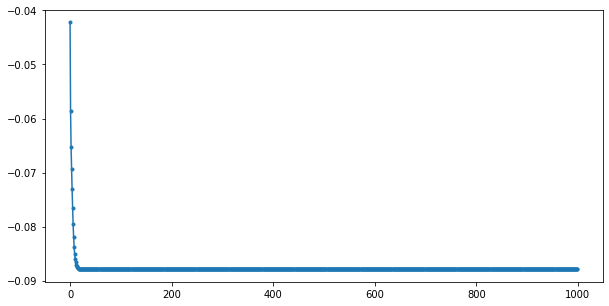

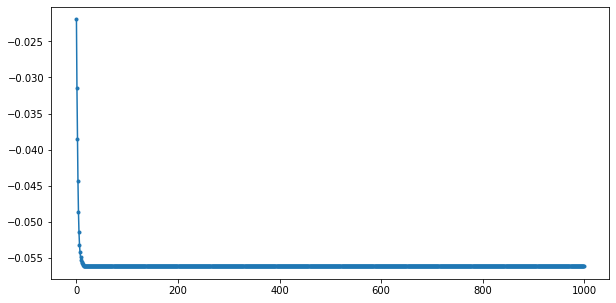

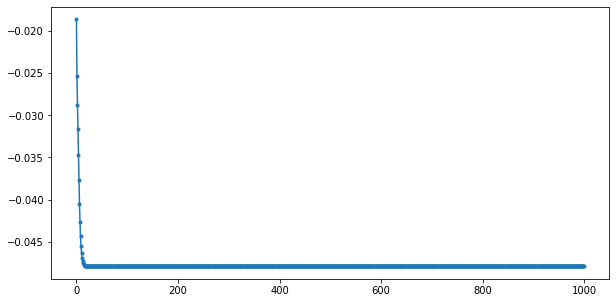

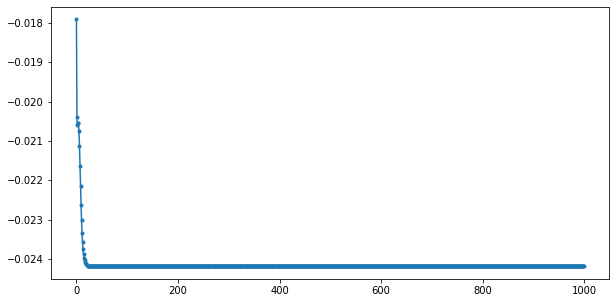

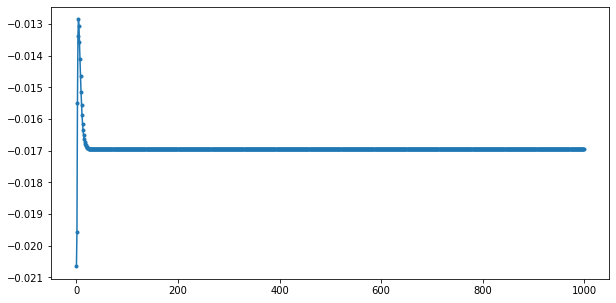

...

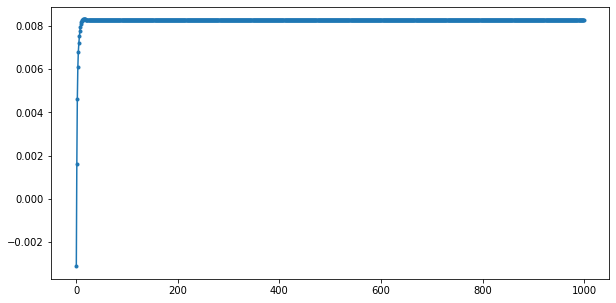

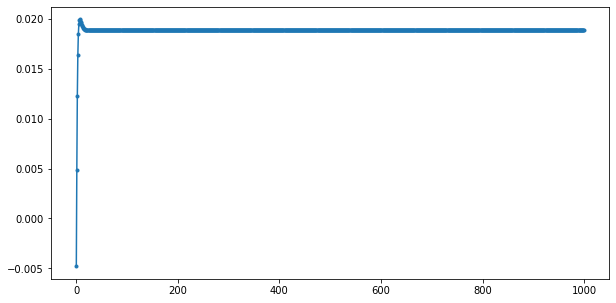

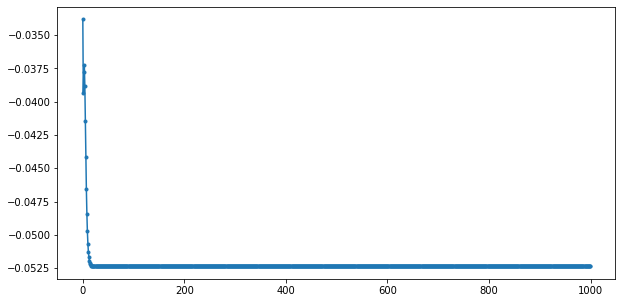

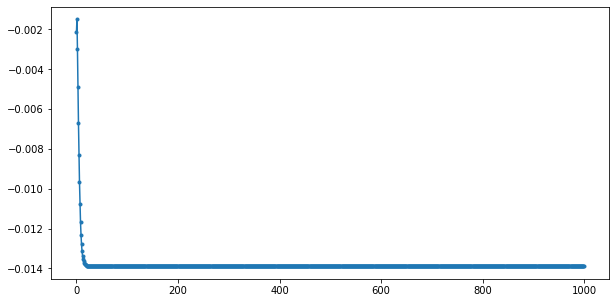

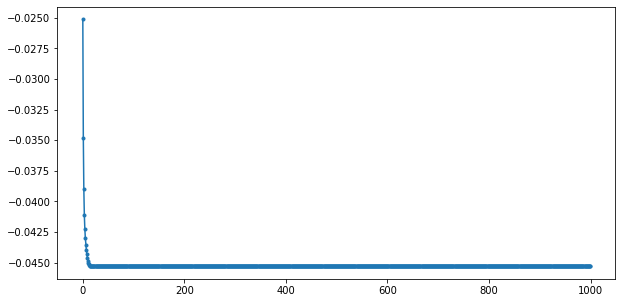

In [140]:
## generate random
n = 20

z_sampleds = np.random.normal(0, 1, size=(n,latent_dim))

x_decoded = generator.predict(z_sampleds)

for i in range(n):
    plt.figure(figsize=(10,5))
    plt.plot(x_decoded[i,:,0], '.-')
    plt.show()

### load vae

In [26]:
## load architecture 
x_lc = Input(shape = (T, channels) , name="LC_inp")
x_t = Input(shape = (T, channels) , name ="T_inp")

x = Concatenate(axis=-1)([x_t, x_lc]) #add time encode

f1 = Bidirectional(GRU(64, return_sequences=True))(x) #bidirectional
f1 = Bidirectional(GRU(64, return_sequences=False))(f1) #bidirectional

z_mean = Dense(latent_dim,activation='linear')(f1)
z_log_var = Dense(latent_dim,activation='linear')(f1)

encoder = Model([x_t, x_lc], z_mean, name="encoder")
z = Lambda(sampling, output_shape=(latent_dim,), name='sample')([z_mean, z_log_var])
samp_encoder = Model([x_t, x_lc], z, name="encoder_sampling")

decoder_input = Input(shape=(latent_dim,))

#decode = Dense(latent_dim, activation='relu')(decoder_input) ## o sacar??

decode = RepeatVector(T)(decoder_input)

decode = Concatenate(axis=-1)([x_t, decode]) #add time decode

decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional
decode = Bidirectional(GRU(64, return_sequences=True))(decode) #bidirectional

decode = TimeDistributed(Dense(1, activation='linear'))(decode)
generator = Model([x_t, decoder_input], decode, name="generator")

# instantiate VAE model
out = generator([x_t, samp_encoder([x_t, x_lc]) ])
vae = Model([x_t, x_lc], out)

#vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
vae.summary()
vae.compile(optimizer='adam', loss=vae_loss, metrics = [KL_loss, MSE_loss])
print(vae.evaluate([X_test_t,X_test], X_test))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
T_inp (InputLayer)              (None, 300, 1)       0                                            
__________________________________________________________________________________________________
LC_inp (InputLayer)             (None, 300, 1)       0                                            
__________________________________________________________________________________________________
encoder_sampling (Model)        (None, 32)           108096      T_inp[0][0]                      
                                                                 LC_inp[0][0]                     
__________________________________________________________________________________________________
generator (Model)               (None, 300, 1)       111873      T_inp[0][0]                      
          

In [22]:
!ls labsj_py
folder = "./labsj_py/"

300T_32D_0.001l_200e_VAE_glo.h5  300T_32D_0.001l_500e_VAE_glo.h5


In [28]:
vae.load_weights(folder+"300T_32D_0.001l_500e_VAE_glo.h5")
print(vae.evaluate([X_test_t,X_test], X_test))

1094/1094 [==============================] - 22s 20ms/step
[291.1052887130263, 169.12266635371736, 0.9647135315037296]


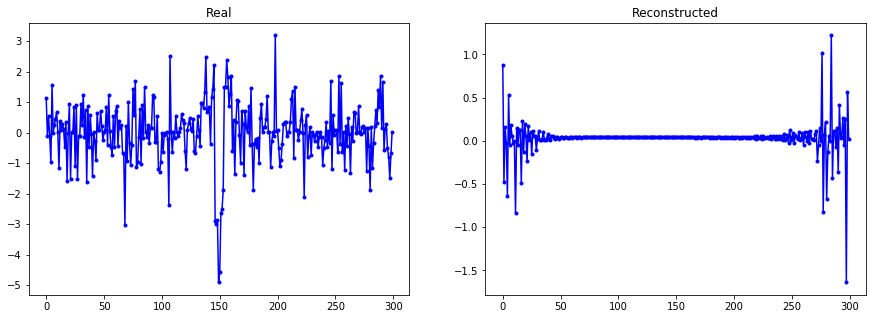

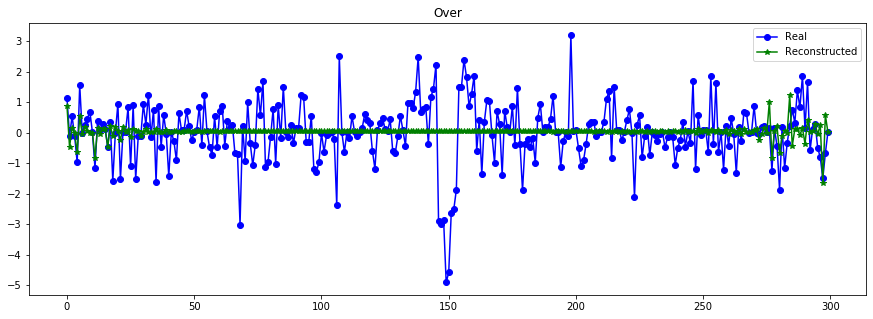

----------------------------------------------------------------


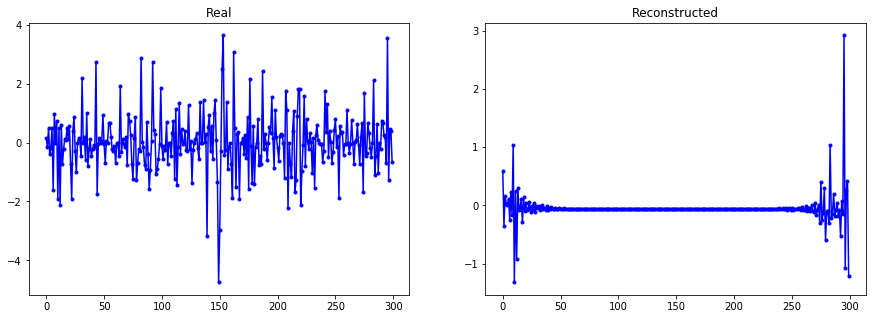

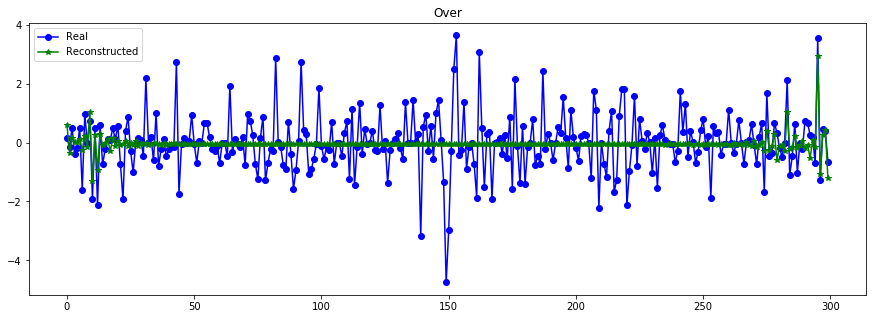

----------------------------------------------------------------


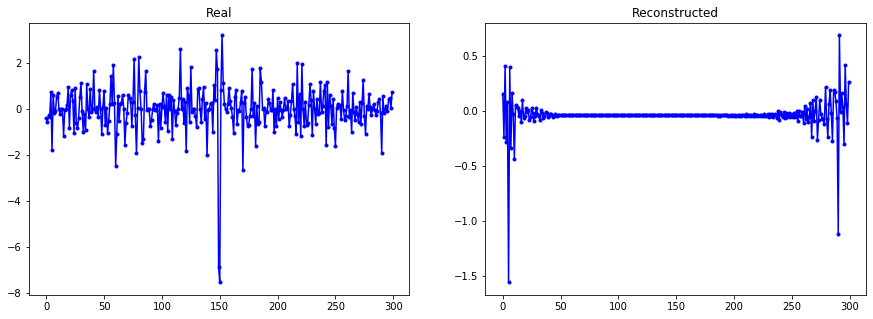

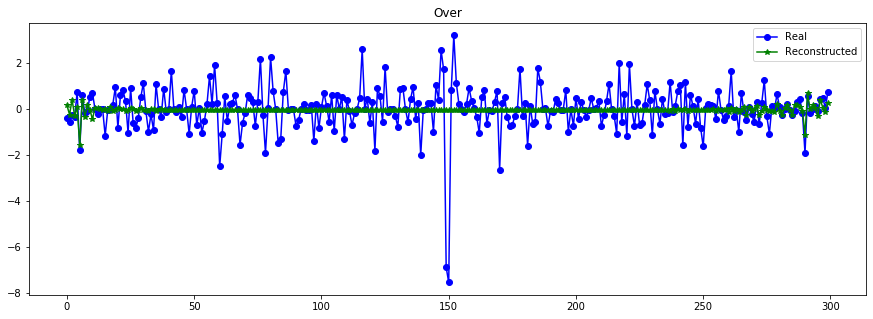

----------------------------------------------------------------


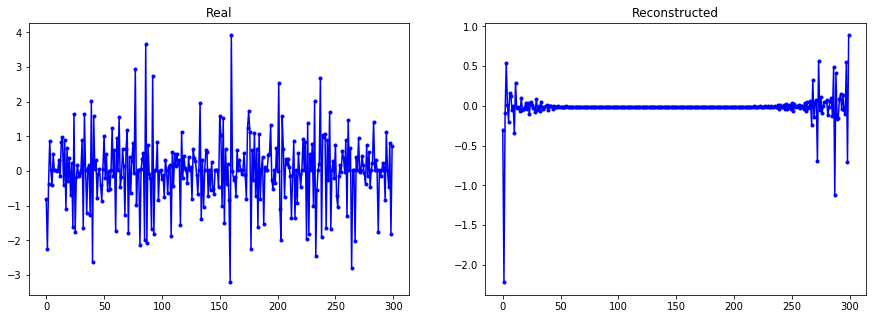

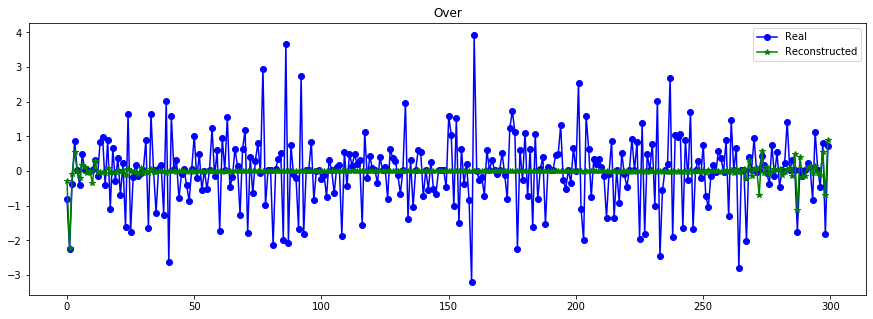

----------------------------------------------------------------


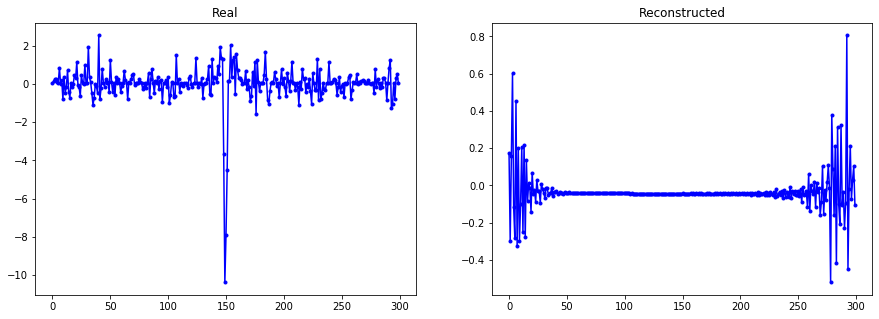

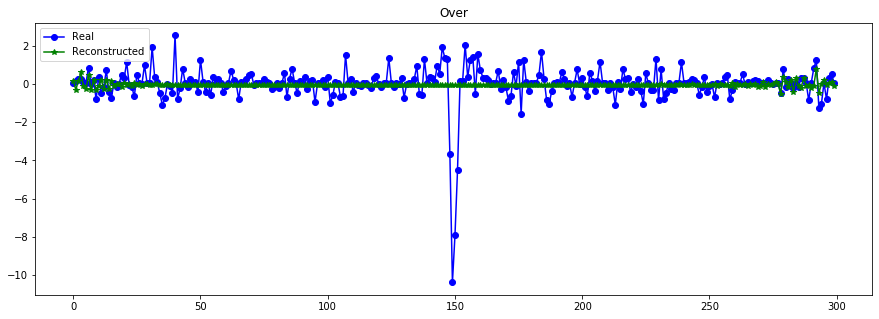

----------------------------------------------------------------


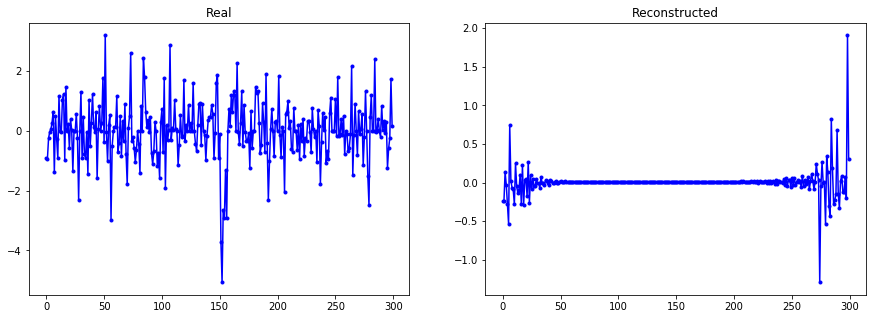

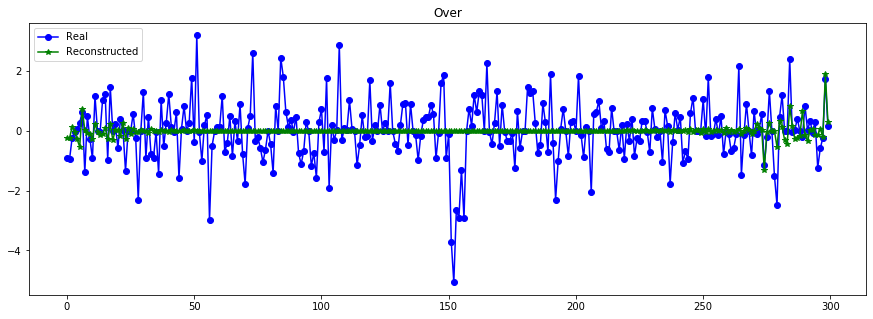

----------------------------------------------------------------


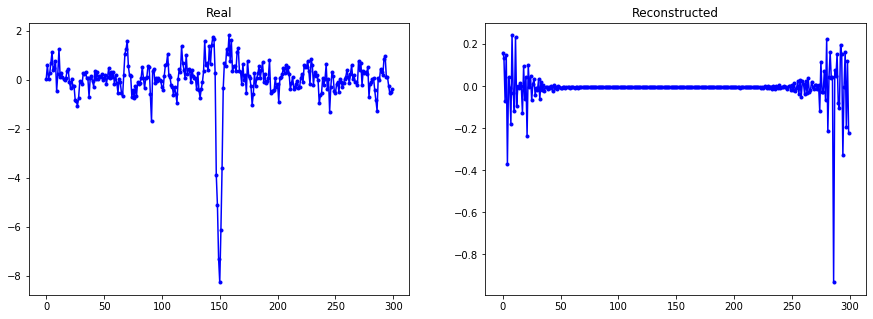

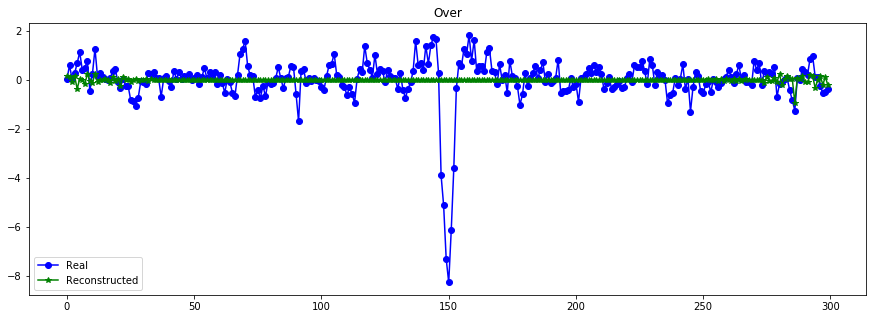

----------------------------------------------------------------


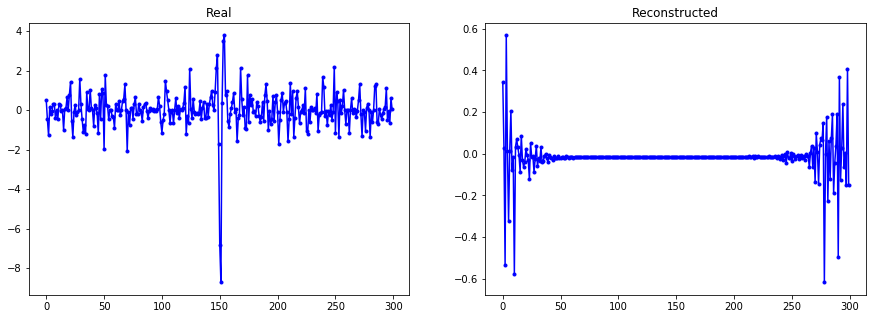

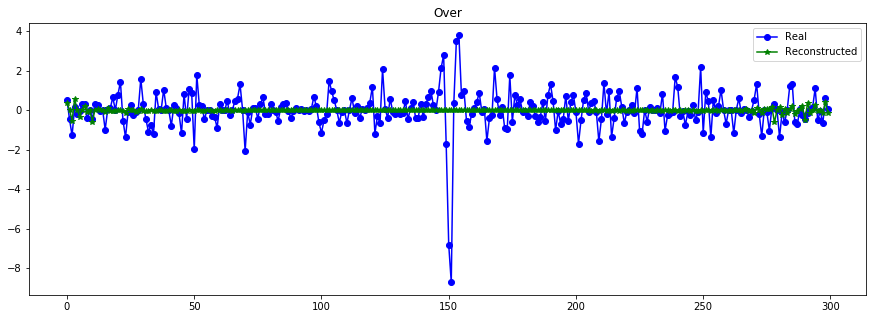

----------------------------------------------------------------


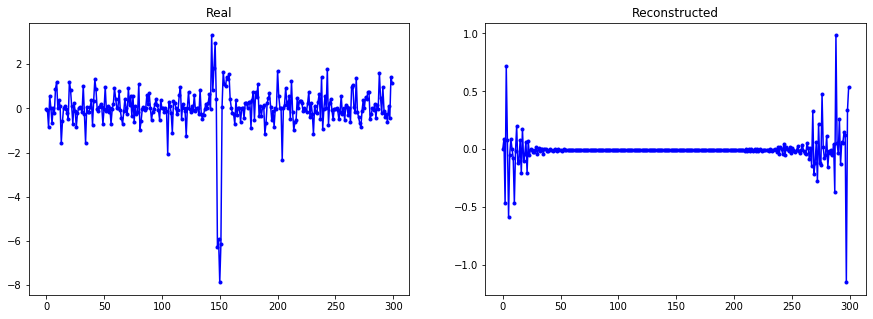

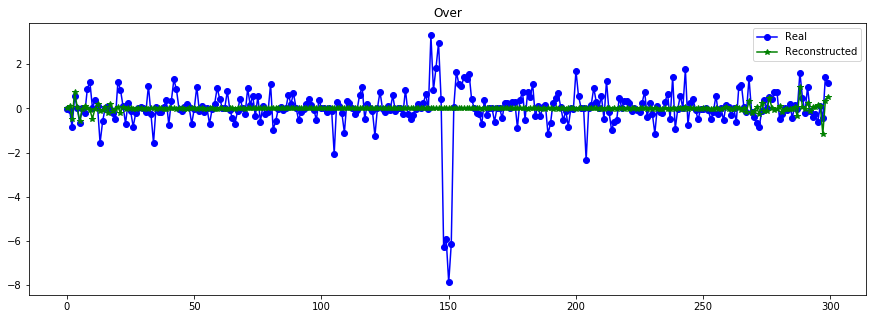

----------------------------------------------------------------


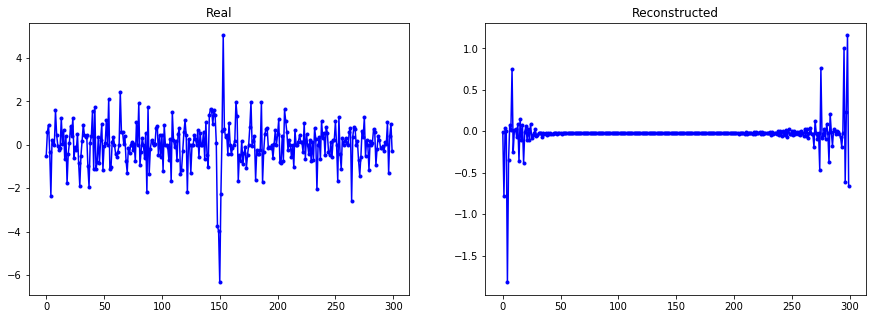

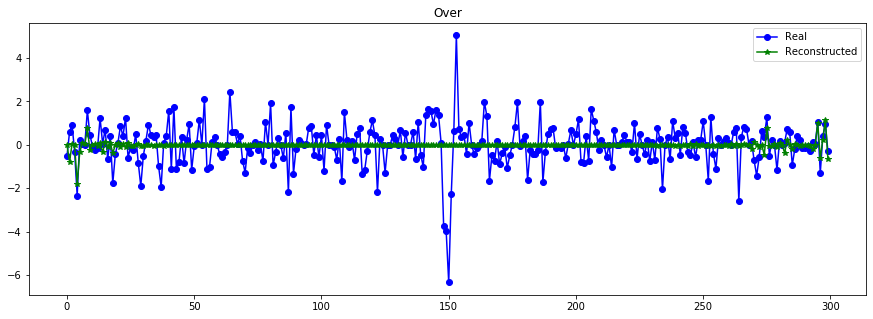

----------------------------------------------------------------


In [29]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10) #"300T_32D_0.001l_500e_VAE_glo.h5"

In [ ]:
X_train_hat = vae.predict([X_train_t,X_train], batch_size=512)
plot_n_lc(X_train, X_train_hat, n= 10) # con 500

In [26]:
import sys
print(sys.executable)
print(sys.version)

/opt/ohpc/pub/moduledeps/anaconda3/bin/python
3.7.3 (default, Mar 27 2019, 22:11:17) 
[GCC 7.3.0]


## CONDITIONAL VAE

In [ ]:
cond = Input(input_shape=(D_dim,))


In [ ]:
inputs = merge([X, cond], mode='concat', concat_axis=1) #en el encoder..


In [ ]:
z_cond = merge([z, cond], mode='concat', concat_axis=1) # <--- NEW! #o en el decode (RNN)

In [ ]:
#for generator
d_z = Input(shape=(latent_dim,))
d_cond = Input(shape=(D_dim,))
d_inputs = merge([d_z, d_cond], mode='concat', concat_axis=1)


## Semi-Supervised VAE

In [ ]:
### data augmentation with mandel-agol